<a href="https://colab.research.google.com/github/sameerkhansf/BioSoundSCape_SSU_Computer_Science/blob/RichardYocke/Copy_of_CombinedCNN_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# (Used for both 1D & 2D)

### Imports, Filepaths, & Mount Drive

In [1]:
!pip install gdal
!pip install rasterio
!pip install raster2xyz
!pip install matplotlib
!pip install scikit-learn
!pip install seaborn
!pip install tensorflow
!pip install tabulate
!pip install scikit-image
!pip install openpyxl
!pip install tifffile
!pip install imagecodecs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 99.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for raster2xyz: filename=raster2xyz-0.1.3-py3-none-any.whl size=5947 sha256=9485b712fb9408e591d10a3ae440e870207de82c2e5852c61ac2c9227e4f8468
  Stored in directory: /root/.cache/pip/wheels/f6/1c/6e/4d694e3b911d49fafc4d0fc79060efe23992d987a5076f7abe
Successfully built raster2xyz
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.6/45.6 MB 50.8 MB/s eta 0:00:00


In [2]:
!pip install tensorflow tensorflow_decision_forests

In [3]:
# File and directory handling
import os
import shutil
from os import listdir
from os.path import isfile, join

# Data handling and processing
import pandas as pd
import numpy as np
from collections import Counter
import random
import ast
from scipy import stats
from scipy.ndimage import zoom, generic_filter
from skimage.transform import resize
from skimage.morphology import (
    dilation, square, opening, closing, area_opening,
    area_closing, remove_small_objects, remove_small_holes
)

# Image processing
import rasterio
from rasterio.plot import show
from raster2xyz.raster2xyz import Raster2xyz
from tifffile import imread
import cv2

# Data preprocessing and metrics
from sklearn.utils import class_weight
from sklearn.decomposition import PCA
from sklearn.preprocessing import (
    StandardScaler, RobustScaler, LabelEncoder,
    Normalizer
)
from sklearn.model_selection import (
    train_test_split, KFold, StratifiedKFold,
    StratifiedShuffleSplit, GridSearchCV
)
from sklearn.metrics import (
    accuracy_score, f1_score, confusion_matrix,
    classification_report, ConfusionMatrixDisplay
)
from sklearn.utils.class_weight import compute_class_weight
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import VarianceThreshold

# CNN
import tensorflow as tf
from tensorflow.keras import models, layers, regularizers
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import (
    Input, Dense, Conv1D, Flatten, MaxPooling1D,
    AveragePooling2D, GlobalAveragePooling1D, Dropout,
    BatchNormalization, RandomFlip, Activation
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.utils import to_categorical

# Additional Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import colors
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
from tabulate import tabulate

# Outlier Detection/Removal
from scipy.stats import chi2
from scipy.spatial.distance import mahalanobis

# Debugging
import logging
logging.basicConfig(level=logging.INFO)  # Set to DEBUG or INFO as needed

# Enable inline plots for Jupyter notebooks
%matplotlib inline


In [4]:
# Connect to Google Drive
from google.colab import drive
drive.mount('/content/drive')

############## Update your 'mainDir' if your utlizing my code!!! ###############
mainDir = "/content/drive/My Drive/BioSCape/"
checkpointDir = "/content/drive/My Drive/BioSCape/1DCheckpoints/"
checkpointDir2D = "/content/drive/My Drive/BioSCape/2DCheckpoints/"
################################################################################

################################################################################
# Using Shared Directory
# Be careful not to override others Checkpoints! => Make unique to your name
################################################################################
# Example:
# checkpoint_path = mainDir + 'model_checkpoints_{Your_Name_Here}/my_weights.weights.h5'
# mainDir = "/content/drive/Shareddrives/Land_Classification_Training_shared/Land_Classification_training_work/"
################################################################################

# Define file paths
images_path = mainDir + "Data/avirisng_samples_combined"
samples_path = mainDir + "Data/samples.csv"
labels_path = mainDir + "Data/labels.csv"

# DEFINE YOUR MODEL CHECKPOINT
# MODEL CHECKPOINTS, ONLY USE TESTING TRAINING, OTHERWISE USE LOADING

# 1D Checkpoints
################################################################################
checkpoint_path = checkpointDir + 'Testing/my_weights.weights.h5'
best_checkpoint_path = checkpointDir + 'Best/my_weights.weights.h5'
checkpoint_path_class_weights = checkpointDir + 'Testing/my_weights_with_cw.weights.h5'
checkpoint_path_class_weights_oversampling = checkpointDir + 'Testing/my_weights_with_cw_oversampling.weights.h5'
################################################################################

# 2D Checkpoints
################################################################################
microcnn_checkpoint_path = checkpointDir2D + 'Testing/microcnn_best.weights.h5'
best_checkpoint_path2D = checkpointDir2D + 'Best/my_weights.weights.h5'
macrocnn_checkpoint_path = checkpointDir2D + 'Testing/macrocnn_best.weights.h5'
rgbcnn_checkpoint_path = checkpointDir2D + 'Testing/rgbcnn_best.weights.h5'

################################################################################

# Debugging
logging.basicConfig(
    level=logging.INFO,  # Set to logging.DEBUG for even more verbosity
    format='[%(levelname)s] %(message)s'
)

Mounted at /content/drive


### Data Loading, Preprocessing, Verification

In [5]:
def preprocess_data(samples_df):
  """
  Preprocess the samples DataFrame:
  1. Extract Sample_num
  2. Clean Labels
  3. Remove rows with 'Mixed or Not Classified'
  4. Replace NaNs and invalid values in frequency columns
  5. Label-encode the labels
  """
  samples_df['Sample_num'] = samples_df['File'].str.split('_').str[0].astype(int)
  samples_df['Label'] = samples_df['Label'].str.split('(').str[0].str.strip()

  # Remove "Mixed or Not Classified"
  samples_df = samples_df[samples_df['Label'] != 'Mixed or Not Classified']
  samples_df.reset_index(drop=True, inplace=True)

  # Handle frequency columns
  frequency_columns = [col for col in samples_df.columns if col.startswith('frq')]
  samples_df.loc[:, frequency_columns] = samples_df[frequency_columns].fillna(-9999)
  samples_df = samples_df[~samples_df[frequency_columns].eq(-9999).any(axis=1)]

  # Verify no invalid values remain
  nan_counts = samples_df[frequency_columns].isna().sum().sum()
  assert nan_counts == 0, "NaN values still exist in frequency columns after replacement"
  count_negative_9999 = (samples_df[frequency_columns] == -9999).sum().sum()
  assert count_negative_9999 == 0, "Rows with -9999 values remain after filtering"

  # Label Encoding
  label_encoder = LabelEncoder()
  samples_df['Label_Encoded'] = label_encoder.fit_transform(samples_df['Label'])

  return samples_df, label_encoder

In [6]:
def clean_img_pos_column(samples_df):
    """
    Ensures the 'img_pos' column contains tuples of integers.
    Converts string representations of tuples like '(0, 1)' into actual tuples.

    Parameters
    ----------
    samples_df : pandas.DataFrame
        The DataFrame containing the 'img_pos' column.

    Returns
    -------
    pandas.DataFrame
        The cleaned DataFrame with 'img_pos' as tuples of integers.
    """
    def parse_img_pos(value):
        if isinstance(value, str):
            # Remove parentheses and split by comma
            return tuple(map(int, value.strip('()').split(',')))
        elif isinstance(value, (tuple, list)):
            return tuple(value)
        else:
            raise ValueError(f"Invalid img_pos value: {value}")

    samples_df['img_pos'] = samples_df['img_pos'].apply(parse_img_pos)
    return samples_df


In [7]:
def combine_classes(samples_df, classes_to_combine, combined_class_name="Shrubs and Natural Grassland"):
  """
  Combines multiple classes into a single class.
  """
  samples_df['Label'] = samples_df['Label'].replace(
      dict.fromkeys(classes_to_combine, combined_class_name)
  )

  remaining_sample_classes = set(samples_df['Label'].unique())

  for c in classes_to_combine:
      if c in remaining_sample_classes:
          raise ValueError(f"Class '{c}' still present after combination.")
  if combined_class_name not in remaining_sample_classes:
      raise ValueError(f"Combined class '{combined_class_name}' not found after combination.")

  print("Classes combined successfully.")
  return samples_df

In [8]:
# @title
def remove_wetlands(samples_df):
  # Extract Sample_num from the File column in samples_df
  samples_df['Sample_num'] = samples_df['File'].str.split('_').str[0].astype(int)

  # Identify all Sample_num values associated with "Wetlands" in samples_df
  wetlands_samples = samples_df[samples_df['Label'].str.contains("Wetlands", na=False)]['Sample_num'].unique()

  # Remove rows in samples_df associated with the same Sample_num
  samples_df = samples_df[~samples_df['Sample_num'].isin(wetlands_samples)]

  # Verification
  # Check that no rows with the removed Sample_num values are present in samples_df
  assert not samples_df['Sample_num'].isin(wetlands_samples).any(), "Wetlands samples still present in samples_df."

  print("Successfully removed 'Wetlands' from the dataset.")
  return samples_df

In [9]:
def remove_planted_forest(samples_df):
    # Extract Sample_num from the File column in samples_df
    # (This step ensures that Sample_num is available and consistent)
    samples_df['Sample_num'] = samples_df['File'].str.split('_').str[0].astype(int)

    # Identify all Sample_num values associated with "Planted Forest" in samples_df
    planted_forest_samples = samples_df[samples_df['Label'].str.contains("Planted Forest", na=False)]['Sample_num'].unique()

    # Remove rows in samples_df associated with these Sample_num values
    samples_df = samples_df[~samples_df['Sample_num'].isin(planted_forest_samples)]

    # Verification:
    # Check that no rows with the removed Sample_num values are present in samples_df
    assert not samples_df['Sample_num'].isin(planted_forest_samples).any(), "Planted Forest samples still present in samples_df."

    print("Successfully removed 'Planted Forest' from the dataset.")
    return samples_df

### Training, Callbacks & Evaluation

In [10]:
def train_model(model, X_train, y_train_cat, X_test, y_test_cat, epochs, batch_size, checkpoint_path):
  history = model.fit(X_train,
      y_train_cat,
      validation_data=(X_test, y_test_cat),
      epochs=epochs,
      batch_size=batch_size,
      callbacks=define_callbacks(checkpoint_path)
    )
  return history

In [11]:
def define_callbacks(checkpoint_path):
  # Make sure path ebds with .h5
  assert checkpoint_path.endswith(".h5"), "checkpoint_path should end with '.h5' for ModelCheckpoint."

  early_stopping = EarlyStopping(monitor='val_accuracy',
                                 patience=5,
                                 mode='max',
                                 verbose=1)

  lr_scheduler = ReduceLROnPlateau(monitor='val_loss',
                                   factor=0.2,
                                   patience=3,
                                   verbose=1,
                                   min_lr=1e-6)

  checkpoint = ModelCheckpoint(filepath=checkpoint_path,
                               save_weights_only=True,
                               monitor='val_accuracy',
                               save_best_only=True,
                               verbose=1)

  return [checkpoint, early_stopping, lr_scheduler]

In [12]:
def evaluate_model(model, X_test, y_test_cat):
  test_loss, test_accuracy = model.evaluate(X_test, y_test_cat, verbose=1)
  print(f"Test Accuracy: {test_accuracy:.4f}")
  return test_accuracy

### Class Weights

In [13]:
def get_class_weights(y_train):
  classes = np.unique(y_train)
  weights = class_weight.compute_class_weight('balanced', classes=classes, y=y_train)
  class_weights_dict = dict(enumerate(weights))

  # Sort in desc. order
  sorted_weights = sorted(class_weights_dict.items(), key=lambda item: item[1], reverse=True)

  # Print formatted weights
  print("\nClass Weights:")
  for class_index, weight in sorted_weights:
    # Decode class index to label
    class_label = label_encoder.inverse_transform([class_index])[0]
    print(f"{class_label.ljust(22)} Weight: {str(weight).ljust(10)}")

  return class_weights_dict

In [14]:
def get_adjusted_class_weights(y_true, y_pred, label_encoder):
    # Ensure that label_encoder.classes_ includes all possible classes
    all_classes = np.union1d(np.unique(y_true), np.unique(y_pred))
    missing_classes = set(all_classes) - set(range(len(label_encoder.classes_)))
    if missing_classes:
        raise ValueError(f"Missing classes in label_encoder: {missing_classes}")

    # Compute F1-scores for each class
    f1_scores = f1_score(y_true, y_pred, average=None, labels=np.unique(y_true))
    classes = np.unique(y_true)

    # Map class indices to F1-scores
    class_f1_scores = dict(zip(classes, f1_scores))

    # Invert F1-scores to get weights (add small epsilon to avoid division by zero)
    epsilon = 1e-6
    inverted_f1_scores = {cls: 1 / (score + epsilon) for cls, score in class_f1_scores.items()}

    # Normalize weights to have a mean of 1
    mean_weight = np.mean(list(inverted_f1_scores.values()))
    normalized_weights = {cls: weight / mean_weight for cls, weight in inverted_f1_scores.items()}

    # Map class indices to weights
    class_weights_dict = {cls: normalized_weights[cls] for cls in classes}

    # Print formatted weights
    print("\nAdjusted Class Weights:")
    for class_index in classes:
      # Safely decode class labels
      if class_index >= len(label_encoder.classes_):
          class_label = f"Unknown (Index {class_index})"
      else:
          class_label = label_encoder.inverse_transform([class_index])[0]
      weight = class_weights_dict[class_index]
      print(f"{class_label.ljust(22)} Weight: {weight:.3f}")

    return class_weights_dict

In [15]:
def train_model_with_class_weights(model, X_train, y_train_cat, X_test, y_test_cat, class_weights, epochs=5, batch_size=32):
  history = model.fit(
    X_train,
    y_train_cat,
    validation_data=(X_test, y_test_cat),
    class_weight=class_weights,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=define_callbacks(checkpoint_path),
  )
  return history

### Augmentation

In [16]:
def data_generator(X, y, batch_size, augmentation_methods):
  """
  Generates batches of data with during training augmentations.
  """
  while True:
    # Shuffle the data at the beginning of each epoch
    indices = np.random.permutation(len(X))
    for start in range(0, len(X), batch_size):
      end = min(start + batch_size, len(X))
      batch_indices = indices[start:end]
      # Extract the batch data
      X_batch = X[batch_indices]
      y_batch = y[batch_indices]
      # Apply each augmentation method to the batch
      for method in augmentation_methods:
        X_batch = method(X_batch)
      yield X_batch, y_batch


In [17]:
def augment_data(samples_df, oversample_images, target_size_per_class, frequency_cols):
  augmented_samples = []

  for class_label, sample_nums in oversample_images.items():
    # Filter samples for the current class and specified sample_nums
    class_df = samples_df[
        (samples_df['Label'] == class_label) &
        (samples_df['Sample_num'].isin(sample_nums))
    ]

    total_class_size = len(samples_df[samples_df['Label'] == class_label])
    current_size = len(class_df)
    target_size = target_size_per_class.get(class_label, total_class_size)
    samples_needed = target_size - total_class_size

    print(f"\nAugmenting class '{class_label}':")
    print(f"Current total size: {total_class_size}, Target size: {target_size}, Samples needed: {samples_needed}")

    if samples_needed <= 0:
      continue
    if class_df.empty:
      print(f"No available samples to augment for class '{class_label}' from specified sample_nums.")
      continue

    # Randomly sample spectra to augment
    spectra_to_augment = class_df.sample(n=samples_needed, replace=True, random_state=42)

    # Apply augmentation
    augmented_spectra = spectra_to_augment[frequency_cols].apply(
        lambda row: augment_spectrum(row.values), axis=1
    )

    # Create augmented DataFrame
    augmented_df = spectra_to_augment.copy()
    augmented_df[frequency_cols] = np.stack(augmented_spectra.values)
    augmented_samples.append(augmented_df)

  # Combine original and augmented data
  augmented_samples_df = pd.concat([samples_df] + augmented_samples, ignore_index=True)

  return augmented_samples_df

In [18]:
def augment_spectrum(spectrum):
  spectrum = add_gaussian_noise(spectrum)
  spectrum = spectral_shift(spectrum)
  # spectrum = spectral_scaling(spectrum)
  # spectrum = random_band_dropout(spectrum)
  return spectrum

In [19]:
def add_gaussian_noise(spectrum, mean=0.0, std=0.01):
  noise = np.random.normal(mean, std, spectrum.shape)
  return spectrum + noise

In [20]:
def spectral_shift(spectrum, shift_range=0.01):
  shift = np.random.uniform(-shift_range, shift_range, spectrum.shape)
  return spectrum + shift

In [21]:
def spectral_scaling(spectrum, scale_range=0.05):
  scale = np.random.uniform(1 - scale_range, 1 + scale_range)
  return spectrum * scale

In [22]:
def random_band_dropout(spectrum, dropout_rate=0.1):
  spectrum = spectrum.copy()
  num_bands = spectrum.shape[0]
  num_dropout = int(num_bands * dropout_rate)
  dropout_indices = np.random.choice(num_bands, num_dropout, replace=False)
  spectrum[dropout_indices] = 0
  return spectrum

In [23]:
def train_model_with_generator(model, train_generator, steps_per_epoch, X_test, y_test_cat, epochs, callbacks):
  history = model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    validation_data=(X_test, y_test_cat),
    epochs=epochs,
    callbacks=callbacks
  )
  return history

### Oversampling

#### Oversampling Functions

In [24]:
def split_data_by_image_with_oversampling(samples_df, oversample_images, test_size=0.2, random_state=42):
  # Get all oversampling images
  oversample_image_nums = set(sum(oversample_images.values(), []))

  # Separate oversampling images from others
  oversample_images_df = samples_df[samples_df['Sample_num'].isin(oversample_image_nums)]
  remaining_images_df = samples_df[~samples_df['Sample_num'].isin(oversample_image_nums)]

  # Get unique images and their labels from the remaining data
  image_labels = remaining_images_df[['Sample_num', 'Label_Encoded']].drop_duplicates()

  # Stratified splitting at the image level
  sss = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=random_state)
  train_indices, test_indices = next(sss.split(image_labels['Sample_num'], image_labels['Label_Encoded']))

  train_image_nums = image_labels['Sample_num'].iloc[train_indices]
  test_image_nums = image_labels['Sample_num'].iloc[test_indices]

  # Create training and testing DataFrames
  train_df = remaining_images_df[remaining_images_df['Sample_num'].isin(train_image_nums)]
  test_df = remaining_images_df[remaining_images_df['Sample_num'].isin(test_image_nums)]

  # Add oversampling images back to the training set
  train_df = pd.concat([train_df, oversample_images_df], ignore_index=True)

  # Verify that all oversampling images are in the training set
  oversample_images_in_test = oversample_image_nums.intersection(set(test_df['Sample_num'].unique()))
  assert len(oversample_images_in_test) == 0, (
      f"Some oversampling images are in the test set: {oversample_images_in_test}"
  )

  print("All oversampling images are in the training set.")

  return train_df, test_df

In [25]:
def oversample_to_target_size(samples_df, oversample_images, percentage=30):
  """
  Oversample only the classes specified in oversample_images to a percentage of the largest class size.
  Classes with a current size larger than the target size are left unchanged.
  """
  oversampled_dfs = []

  # Determine the size of the largest class
  largest_class_size = samples_df['Label'].value_counts().max()
  target_size_per_class = {
    class_label: max(len(samples_df[samples_df['Label'] == class_label]),  # Ensure target size is >= current size
                      int(largest_class_size * (percentage / 100)))
    for class_label in oversample_images.keys()
  }

  for class_label in samples_df['Label'].unique():
    class_df = samples_df[samples_df['Label'] == class_label]
    current_class_size = len(class_df)

    # Only oversample classes in oversample_images
    if class_label in oversample_images:
      target_size = target_size_per_class.get(class_label, current_class_size)
    else:
      target_size = current_class_size  # Do not modify other classes

    samples_needed = target_size - current_class_size

    print(f"\nProcessing class '{class_label}':")
    print(f"Current size: {current_class_size}, Target size: {target_size}, Samples needed: {samples_needed}")

    if samples_needed > 0 and class_label in oversample_images:
      # Use all pixels from the specified sample numbers
      sample_nums = oversample_images[class_label]
      oversample_candidates = samples_df[
        (samples_df['Label'] == class_label) &
        (samples_df['Sample_num'].isin(sample_nums))
    ]

      if oversample_candidates.empty:
        print(f"Warning: No oversample candidates available for class '{class_label}'. Skipping oversampling.")
        oversampled_class_df = class_df
      else:
        num_candidates = len(oversample_candidates)
        if num_candidates < samples_needed:
          print(f"Note: Not enough candidates for class '{class_label}'. Sampling with replacement.")
        else:
          print(f"Sampling {samples_needed} samples from {num_candidates} candidates for class '{class_label}'.")

        # Sample with replacement
        additional_samples = oversample_candidates.sample(
          n=samples_needed, replace=True, random_state=42
        )
        oversampled_class_df = pd.concat([class_df, additional_samples], ignore_index=True)
    else:
        # Do not modify classes not in oversample_images
        oversampled_class_df = class_df

    # Verify class size matches target
    final_class_size = len(oversampled_class_df)
    if final_class_size != target_size and class_label in oversample_images:
      print(f"Warning: Class '{class_label}' final size ({final_class_size}) does not match target size ({target_size}).")

    oversampled_dfs.append(oversampled_class_df)



  oversampled_df = pd.concat(oversampled_dfs, ignore_index=True)

  # Final verification
  print("\nFinal class distributions after oversampling:")
  final_class_counts = oversampled_df['Label'].value_counts()
  for class_label in oversample_images.keys():
    target_size = target_size_per_class.get(class_label, final_class_counts[class_label])
    actual_size = final_class_counts.get(class_label, 0)
    if actual_size != target_size:
      print(f"Class '{class_label}' has {actual_size} samples, expected {target_size}.")
    else:
      print(f"Class '{class_label}' oversampled to target size {target_size}.")

  return oversampled_df


In [26]:
def verify_and_update_oversample_images(samples_df, oversample_images, target_count=100):
  """
  Verifies and updates the oversample_images dictionary.
  - Ensures original samples are found in samples_df.
  - Identifies missing samples and prints details.
  - Adds additional samples as needed to meet the target count per class.
  """
  updated_oversample_images = {}

  for class_label, sample_nums in oversample_images.items():
    print(f"\nProcessing class: {class_label}")

    # Convert to sets for easier manipulation
    current_samples = set(sample_nums)
    available_samples = set(samples_df[samples_df['Label'] == class_label]['Sample_num'])

    # Identify original samples found
    found_original_samples = current_samples.intersection(available_samples)

    # Identify missing samples
    missing_from_samples_df = current_samples - set(samples_df['Sample_num'])

    # Log missing sample details
    if missing_from_samples_df:
      print(f"Missing from samples_df: {missing_from_samples_df}")

    # Calculate additional samples needed
    additional_samples_needed = target_count - len(found_original_samples)
    additional_samples = []
    if additional_samples_needed > 0:
      remaining_samples = list(available_samples - current_samples)
      additional_samples = random.sample(
          remaining_samples, min(len(remaining_samples), additional_samples_needed)
      )

    # Combine original found and additional samples
    updated_samples = list(found_original_samples.union(additional_samples))

    # Store updated samples in the dictionary
    updated_oversample_images[class_label] = updated_samples

    # Print summary for the class
    print(f"Original samples found: {len(found_original_samples)}")
    print(f"Additional samples added: {len(additional_samples)}")
    print(f"Total samples for class '{class_label}': {len(updated_samples)}")

  return updated_oversample_images

#### Verification of Oversampling

In [27]:
def verify_oversampling(original_df, oversampled_df):
  """
  Check out the distribution of classes after oversampling.
  """
  # Reset indices for a resonable comparison
  original_df = original_df.reset_index(drop=True)
  oversampled_df = oversampled_df.reset_index(drop=True)

  # Count class distributions before and after oversampling
  original_counts = original_df['Label'].value_counts()
  oversampled_counts = oversampled_df['Label'].value_counts()

  # Align indices for consistent comparison
  all_classes = set(original_counts.index).union(set(oversampled_counts.index))
  original_counts = original_counts.reindex(all_classes, fill_value=0)
  oversampled_counts = oversampled_counts.reindex(all_classes, fill_value=0)

  # Print counts before and after
  print("\nClass distribution before oversampling:")
  print(original_counts)

  print("\nClass distribution after oversampling:")
  print(oversampled_counts)

  # Plot distributions before and after oversampling
  plt.figure(figsize=(12, 6))
  bar_width = 0.35  # Bar width for side-by-side comparison
  x_labels = list(all_classes)
  x = range(len(x_labels))

  plt.bar(x, original_counts.values, width=bar_width, alpha=0.6, label='Before Oversampling')
  plt.bar([i + bar_width for i in x], oversampled_counts.values, width=bar_width, alpha=0.6, label='After Oversampling')

  plt.xlabel('Class Labels')
  plt.ylabel('Number of Pixels')
  plt.title('Class Distribution Before and After Oversampling')
  plt.xticks([i + bar_width / 2 for i in x], x_labels, rotation=45)
  plt.legend()
  plt.tight_layout()
  plt.show()

  # Check the difference in distributions
  print("\nDifference in class distributions:")
  difference = oversampled_counts - original_counts
  print(difference)


In [28]:
def print_missing_samples_details(samples_df, oversample_images):
  """
  Verifies if the sample numbers in oversample_images are present in both samples_df.
  For missing sample numbers, prints all rows associated with them in samples_df.
  """
  for class_label, sample_nums in oversample_images.items():
    print(f"\nChecking missing samples for class: {class_label}")
    missing_found = False
    for sample_num in sample_nums:
      found_in_samples = sample_num in samples_df["Sample_num"].values

      if not found_in_samples:
        missing_found = True
        print(f"\nSample_num {sample_num} is missing:")
        print(f"  - samples_df: {'FOUND' if found_in_samples else 'MISSING'}")

        if found_in_samples:
          print(f"\nRows in samples_df for Sample_num {sample_num}:")
          print(samples_df[samples_df["Sample_num"] == sample_num])

    if not missing_found:
        print(f"All sample numbers for class '{class_label}' are present in both DataFrames.")

In [29]:
def verify_oversample_images_in_training_set(oversample_images, train_images):
  """
  Verify that all images used for oversampling are in the training set.
  Remove any images in `oversample_images` that are not in the training set.
  """
  oversample_image_nums = set(sum(oversample_images.values(), []))
  train_image_nums = set(train_images)

  # Images used for oversampling that are not in the training set
  oversample_images_in_test = oversample_image_nums - train_image_nums

  if oversample_images_in_test:
    print("Warning: The following oversampling images are in the testing set and should not be used for oversampling:")
    print(oversample_images_in_test)
    # Remove these images from the oversample_images dictionary
    for class_label, sample_nums in oversample_images.items():
      oversample_images[class_label] = [num for num in sample_nums if num in train_image_nums]
  else:
    print("All oversampling images are in the training set.")

  return oversample_images


In [30]:
def verify_samples_in_samples_df(samples_df, oversample_images):
  """
  Verify that the sample numbers in oversample_images are present in samples_df and correspond to the correct class labels.
  """
  for class_label, sample_nums in oversample_images.items():
    # Filter the DataFrame for matching samples and the specified class
    matching_samples = samples_df[
      (samples_df['Sample_num'].isin(sample_nums)) &
      (samples_df['Label'] == class_label)
    ]
    # Assert that there are matching rows for the given sample numbers and class
    try:
      assert not matching_samples.empty, (
          f"No matching samples found in `samples_df` for class '{class_label}' with provided Sample_num values."
      )
      print(f"Class: {class_label}, Provided Samples: {sample_nums}")
      print(f"Matching Samples in `samples_df`: {len(matching_samples)}")
    except AssertionError as e:
      print(f"Assertion Error: {e}")


### Data Visualization

In [31]:
def plot_class_distribution(y, class_names, title="Class Distribution"):
  """
  Plots a histogram showing the distribution of samples across classes.

  Parameters:
  - y: array-like, labels (as strings or integers)
  - class_names: list, names of the classes
  - title: str, title for the plot
  """
  # Convert to numpy array for consistency
  y = np.array(y)

  # Count occurrences of each class
  if y.dtype.kind in ['i', 'u']:  # If numeric labels
      class_counts = Counter(y)
      counts = [class_counts.get(i, 0) for i in range(len(class_names))]
  else:  # If string labels
      class_counts = Counter(y)
      counts = [class_counts.get(name, 0) for name in class_names]

  plt.figure(figsize=(10, 6))
  plt.bar(class_names, counts)
  plt.xlabel('Class')
  plt.ylabel('Number of Samples')
  plt.title(title)
  plt.xticks(rotation=45, ha='right')
  plt.grid(axis='y')
  plt.tight_layout()
  plt.show()

In [32]:
def plot_image_level_distribution(aggregated_counts, title="Class Distribution (Image-level)"):
    """
    Plots a histogram showing the distribution of images across classes.

    Parameters:
    - aggregated_counts: pd.Series, aggregated counts of unique Sample_num per class
    - title: str, title for the plot
    """
    class_names = aggregated_counts.index.tolist()
    counts = aggregated_counts.values

    plt.figure(figsize=(10, 6))
    plt.bar(class_names, counts, alpha=0.8)
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title(title)
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

In [33]:
def plot_training_curves(history, model_name="Model"):
  plt.figure(figsize=(12, 5))
  plt.subplot(1, 2, 1)
  plt.plot(history.history['accuracy'], label='Train Accuracy', marker='o')
  plt.plot(history.history['val_accuracy'], label='Val Accuracy', marker='o')
  plt.title(f'{model_name} Accuracy')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')
  plt.legend()
  plt.grid(True)

  plt.subplot(1, 2, 2)
  plt.plot(history.history['loss'], label='Train Loss', marker='o')
  plt.plot(history.history['val_loss'], label='Val Loss', marker='o')
  plt.title(f'{model_name} Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.legend()
  plt.grid(True)

  plt.tight_layout()
  plt.show()

In [34]:
def plot_confusion_matrix(y_true, y_pred, label_encoder):
  # Convert labels to integer indices
  y_true_int = label_encoder.transform(y_true)
  y_pred_int = label_encoder.transform(y_pred)

  # Generate the confusion matrix
  conf_matrix = confusion_matrix(y_true_int, y_pred_int, labels=range(len(label_encoder.classes_)))

  # Plot the confusion matrix
  plt.figure(figsize=(12, 10))
  sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
              xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
  plt.xlabel("Predicted Labels")
  plt.ylabel("True Labels")
  plt.title("Confusion Matrix")
  plt.show()

In [35]:
def plot_confusion_matrices_with_counts_and_normalized(
    y_true,
    y_pred,
    label_encoder,
    title_counts="Confusion Matrix (Counts)",
    title_normalized="Confusion Matrix (Normalized)",
    figsize=(18, 7)
):
    """
    Plots two confusion matrices side by side:
      1) Raw counts (pixel or polygon counts)
      2) Normalized by true class (accuracy/proportion per row)

    Parameters:
    -----------
    y_true : array-like
        True class labels (strings or already integer-encoded).
    y_pred : array-like
        Predicted class labels (strings or already integer-encoded).
    label_encoder : LabelEncoder
        Fitted LabelEncoder instance used to encode the class labels.
    title_counts : str
        Title for the raw counts confusion matrix.
    title_normalized : str
        Title for the normalized confusion matrix.
    figsize : tuple
        Figure size for the two subplots.
    """

    # `y_true` or `y_pred` are strings, convert to integer indices.
    y_true_int = label_encoder.transform(y_true)
    y_pred_int = label_encoder.transform(y_pred)

    class_labels = label_encoder.classes_
    num_classes = len(class_labels)

    # 1) Raw counts confusion matrix
    conf_mat_counts = confusion_matrix(
        y_true_int,
        y_pred_int,
        labels=range(num_classes),
        normalize=None
    )

    # 2) Normalized confusion matrix (row-wise, i.e., 'true')
    conf_mat_normalized = confusion_matrix(
        y_true_int,
        y_pred_int,
        labels=range(num_classes),
        normalize='true'
    )

    # Create figure with 2 subplots
    fig, axes = plt.subplots(1, 2, figsize=figsize)

    # -- Left subplot: Raw Counts --
    sns.heatmap(
        conf_mat_counts,
        annot=True,
        fmt="d",
        cmap="Blues",
        xticklabels=class_labels,
        yticklabels=class_labels,
        ax=axes[0]
    )
    axes[0].set_title(title_counts, fontsize=14)
    axes[0].set_xlabel("Predicted Labels")
    axes[0].set_ylabel("True Labels")

    # -- Right subplot: Normalized (row-wise) --
    sns.heatmap(
        conf_mat_normalized,
        annot=True,
        fmt=".2f",
        cmap="Blues",
        xticklabels=class_labels,
        yticklabels=class_labels,
        ax=axes[1]
    )
    axes[1].set_title(title_normalized, fontsize=14)
    axes[1].set_xlabel("Predicted Labels")
    axes[1].set_ylabel("True Labels")

    plt.tight_layout()
    plt.show()

    return conf_mat_counts, conf_mat_normalized

In [36]:
def plot_sample_predictions(X, y_true, y_pred, num_samples=5):
  plt.figure(figsize=(15, num_samples * 2))
  indices = np.random.choice(len(X), num_samples, replace=False)
  for i, idx in enumerate(indices):
    plt.subplot(num_samples, 1, i + 1)
    plt.plot(X[idx].flatten(), label="Spectral Data")
    plt.title(f"True Label: {y_true[idx]} | Predicted: {y_pred[idx]}")
    plt.legend()
  plt.tight_layout()
  plt.show()

In [37]:
def get_predictions(model, X_test, y_test_cat, label_encoder):
  y_pred_probs = model.predict(X_test)
  y_pred_int = np.argmax(y_pred_probs, axis=1)
  y_true_int = np.argmax(y_test_cat, axis=1)

  # Use inverse_transform only when you need class labels (strings)
  y_pred_labels = label_encoder.inverse_transform(y_pred_int)
  y_true_labels = label_encoder.inverse_transform(y_true_int)

  return y_true_labels, y_pred_labels, y_true_int, y_pred_int

In [38]:
def load_predict_and_visualize(image_path, ground_truth_label, model, label_encoder, sample_num=None):
    """
    Loads an image (raster), predicts pixel-level classes,
    and shows a side-by-side comparison of predicted vs. ground truth.
    Displays the Sample_num in the title if provided.
    Uses a custom color mapping for visualization.
    Returns the final predicted label for the image based on majority voting.
    """
    import matplotlib.patches as mpatches
    from matplotlib.colors import ListedColormap

    # Custom color mapping for the labels
    label_to_color = {
        "Natural Grassland": "#d3edbe",            # Yellow-Green
        "Shrubs": "#11734c",                       # Dark Green
        "Annual Crops": "#fdd1be",                 # Orchid
        "Built-up": "#FF0000",                     # Red
        "Consolidated Barren": "#3a3d38",          # Gray
        "Natural Wooded Land": "#1d576b",          # Green
        "Permanent Crops": "#eacff6",              # Blue
        "Planted Forest": "#5a3386",               # Purple
        "Unconsolidated Barren": "#753800",        # Brown
        "Wetlands": "#ffd0ca",                     # Saddle
        "Waterbodies": "#0a54a5",                  # Blue
    }

    # Generate color mapping for label indices
    class_names = label_encoder.classes_
    colors = [label_to_color.get(lbl, "#11734c") for lbl in class_names]  # fallback to green if missing
    cmap = ListedColormap(colors)

    # --- READ & PREDICT ---
    with rasterio.open(image_path) as img:
        img_data = img.read()
        # shape => (bands, rows, cols)

        # Reshape => (num_pixels, bands, 1)
        img_reshaped = img_data.transpose(1, 2, 0).reshape(-1, img_data.shape[0])
        img_reshaped = img_reshaped.reshape(-1, img_data.shape[0], 1)

        # Predict at the pixel level
        img_pred = model.predict(img_reshaped)
        img_pred_labels = np.argmax(img_pred, axis=1)
        img_pred_labels_reshaped = img_pred_labels.reshape(img_data.shape[1], img_data.shape[2])

    # --- MAJORITY VOTE ---
    unique_labels, counts = np.unique(img_pred_labels, return_counts=True)
    majority_idx = unique_labels[np.argmax(counts)]  # the label index with the most votes

    # Sanity-check: ensure the index is within range
    if majority_idx < 0 or majority_idx >= len(class_names):
        raise ValueError(
            f"Majority label index {majority_idx} is out of range for the LabelEncoder "
            f"(which has {len(class_names)} classes). "
            "Possible mismatch between model output and label_encoder!"
        )

    # If it's valid, decode to string label
    final_predicted_label = label_encoder.classes_[majority_idx]
    # Alternatively:
    # final_predicted_label = label_encoder.inverse_transform([majority_idx])[0]

    # --- PLOTTING ---
    fig, ax = plt.subplots(1, 2, figsize=(14, 7))

    # Title includes sample_num (if passed in), plus final predicted label
    left_title = f"Predicted Labels for Each Pixel\nFinal Predicted Label: {final_predicted_label}"
    if sample_num is not None:
        left_title = f"Sample_num: {sample_num}\n{left_title}"

    ax[0].imshow(img_pred_labels_reshaped, cmap=cmap,
                 vmin=0, vmax=len(class_names) - 1)
    ax[0].set_title(left_title, fontsize=12)
    ax[0].axis("off")

    # Ground truth
    ground_truth_index = label_encoder.transform([ground_truth_label])[0]
    right_title = f"Ground Truth Label: {ground_truth_label}"
    if sample_num is not None:
        right_title = f"Sample_num: {sample_num}\n{right_title}"

    ax[1].imshow(
        np.ones_like(img_pred_labels_reshaped) * ground_truth_index,
        cmap=cmap,
        vmin=0, vmax=len(class_names) - 1
    )
    ax[1].set_title(right_title, fontsize=12)
    ax[1].axis("off")

    # Create a legend for the color mapping
    handles = [
        mpatches.Patch(color=color, label=f"{i}: {lbl}")
        for i, (lbl, color) in enumerate(zip(class_names, colors))
    ]
    plt.legend(handles=handles, title="Class Labels", bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

    return final_predicted_label


In [39]:
def compute_and_plot_image_level_confusion_matrix_with_returns(model, test_df, label_encoder):
  """
  Computes image-level predictions by aggregating pixel-level predictions and
  generates a normalized confusion matrix and classification report.

  Parameters:
  - model: Trained model for prediction.
  - test_df: DataFrame containing test samples with features and labels.
  - label_encoder: LabelEncoder instance used for encoding labels.

  Returns:
  - image_accuracy: Accuracy at the image level.
  - image_conf_matrix_normalized: Normalized confusion matrix at the image level.
  """

  # Extract feature columns for prediction
  frequency_cols = [col for col in test_df.columns if 'frq' in col]
  X_test = test_df[frequency_cols].values
  X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))  # Reshape for Conv1D

  # Predict pixel-level probabilities
  y_pred_probs = model.predict(X_test, verbose=0)

  # Convert probabilities to predicted class indices
  test_df['Predicted_Pixel_Label'] = np.argmax(y_pred_probs, axis=1)

  # Aggregate predictions per `Sample_num` by majority vote
  image_predictions = (
    test_df.groupby('Sample_num')['Predicted_Pixel_Label']
    .apply(lambda x: np.bincount(x).argmax())  # Majority vote
    .reset_index()
    .rename(columns={'Predicted_Pixel_Label': 'Predicted_Image_Label'})
  )

  # Use `Ground_Truth` from `test_df` for comparison
  ground_truth_mapping = test_df[['Sample_num', 'Label']].drop_duplicates()
  image_predictions = image_predictions.merge(
    ground_truth_mapping,
    on='Sample_num',
    how='left'
  )

  # Encode ground truth and predicted image labels
  image_predictions['Encoded_Label'] = label_encoder.transform(image_predictions['Label'])
  image_predictions['Encoded_Predicted_Label'] = image_predictions['Predicted_Image_Label']

  # Compute image-level accuracy
  correct_predictions = image_predictions['Encoded_Label'] == image_predictions['Encoded_Predicted_Label']
  image_accuracy = correct_predictions.mean()
  print(f"Image-Level Accuracy: {image_accuracy:.4f}")

  # Compute normalized confusion matrix
  image_conf_matrix = confusion_matrix(
    image_predictions['Encoded_Label'],
    image_predictions['Encoded_Predicted_Label'],
    labels=range(len(label_encoder.classes_)),
    normalize='true'  # Normalize rows to sum to 1
  )

  # Plot normalized confusion matrix
  plt.figure(figsize=(12, 10))
  sns.heatmap(image_conf_matrix, annot=True, fmt=".2f", cmap="Blues",
              xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)

  plt.xlabel("Predicted Labels")
  plt.ylabel("True Labels")
  plt.title("Image-Level Normalized Confusion Matrix")
  plt.show()

  # Print classification report
  y_true_images = label_encoder.inverse_transform(image_predictions['Encoded_Label'])
  y_pred_images = label_encoder.inverse_transform(image_predictions['Encoded_Predicted_Label'])

  print("Image-Level Classification Report:")
  print(classification_report(y_true_images, y_pred_images, target_names=label_encoder.classes_))

  return image_accuracy, image_conf_matrix, image_predictions

In [40]:
def compute_accuracy_and_confusion_matrices(
  total_correct_before, total_correct_after, total_pixels,
  y_true_pixels, y_pred_pixels_before, y_pred_pixels_after,
  y_true_images, y_pred_images_before, y_pred_images_after, label_encoder):

  # Get overall per-pixel accuracy before and after morphology
  accuracy_before = total_correct_before / total_pixels if total_pixels > 0 else 0
  accuracy_after = total_correct_after / total_pixels if total_pixels > 0 else 0

  print(f"\nOverall per-pixel accuracy before morphology: {accuracy_before:.4f}")
  print(f"Overall per-pixel accuracy after morphology: {accuracy_after:.4f}")

  # MAke confusion matrices
  conf_matrix_pixels_after = confusion_matrix(y_true_pixels, y_pred_pixels_after, labels=range(len(label_encoder.classes_)))

  # Plot confusion matrices
  plot_confusion_matrix_from_confusion_matrix(conf_matrix_pixels_after, label_encoder, title="Per-pixel Confusion Matrix After Morphology")

  # Print classification reports
  print("\nPer-pixel Classification Report After Morphology:")
  print(classification_report(y_true_pixels, y_pred_pixels_after, target_names=label_encoder.classes_))

  # Return metrics
  return {
    'accuracy_before': accuracy_before,
    'accuracy_after': accuracy_after,
    'conf_matrix_pixels_after': conf_matrix_pixels_after,
  }

# Outlier Detection/Revoval

In [41]:
def compute_chi_square_threshold(dof, alpha=0.05):
  """
  Computes the chi-square threshold for the specified degrees of freedom (dof)
  at the given alpha significance level. Any Mahalanobis^2 distance above
  this threshold is considered an outlier.

  Parameters
  ----------
  dof : int
    Degrees of freedom (# of features).
  alpha : float
    Significance level for chi-square (e.g., 0.05 => 95% confidence).

  Returns
  -------
  float
    The chi-square cutoff value.
  """
  threshold = chi2.ppf(1 - alpha, dof)
  logging.info(
    f"[compute_chi_square_threshold] dof={dof}, alpha={alpha}, threshold={threshold:.4f}"
  )
  return threshold

In [42]:
def apply_pca_for_outlier_detection(
  df,
  frequency_cols,
  pca_variance=0.95,
  enable_debug=True
):
  """
  Scales the data (RobustScaler) and applies PCA to the given frequency columns
  to retain 'pca_variance' fraction of total variance. The PCA columns are appended
  to a copy of the original DataFrame with column names 'pca_0', 'pca_1', etc.

  Parameters
  ----------
  df : pandas.DataFrame
    The original DataFrame containing frequency columns.
  frequency_cols : list
    The list of frequency column names, e.g. ['frq0', 'frq1', ..., 'frqN'].
  pca_variance : float, optional
    Fraction of total variance to retain in PCA, e.g., 0.95 => 95%.
  enable_debug : bool, optional
    If True, prints debug statements.

  Returns
  -------
  df_pca : pandas.DataFrame
    A copy of the original DataFrame with new PCA columns appended (named 'pca_0', 'pca_1', ...).
  pca : PCA object
    The fitted PCA transformer (for reference, if desired).
  scaler : RobustScaler object
    The fitted scaler (for reference, if desired).
  """
  df_pca = df.copy()  # I dont want to modify original

  # Get the raw frequency data
  X = df_pca[frequency_cols].values

  # Using Robust scaling
  scaler = RobustScaler()
  X_scaled = scaler.fit_transform(X)

  # PCA
  pca = PCA(n_components=pca_variance)
  X_pca = pca.fit_transform(X_scaled)

  # Creating new PCA columns
  pca_col_names = [f"pca_{i}" for i in range(X_pca.shape[1])]
  for i, col_name in enumerate(pca_col_names):
    df_pca[col_name] = X_pca[:, i]

  if enable_debug:
    logging.info("[apply_pca_for_outlier_detection] PCA columns added => %s", pca_col_names)
    logging.info("[apply_pca_for_outlier_detection] Explained variance ratio => %s", pca.explained_variance_ratio_)

  return df_pca, pca, scaler

In [43]:
def remove_outliers_mahalanobis_pca(
    df_pca,
    pca_columns,
    alpha=0.05,
    min_pixels=5,
    enable_debug=True
):
    """
    Performs per-sample outlier detection in PCA space using Mahalanobis distance
    and a chi-square threshold at (1 - alpha) confidence. Returns the set of row
    indices that are flagged as outliers and summary stats.

    Parameters
    ----------
    df_pca : pandas.DataFrame
        The DataFrame containing both original columns plus newly appended PCA columns.
    pca_columns : list
        The list of PCA column names, e.g. ['pca_0', 'pca_1', ...].
    alpha : float, optional
        Significance level (0.05 => 95% confidence).
    min_pixels : int, optional
        Skip outlier detection for any sample with fewer pixels than this.
    enable_debug : bool, optional
        If True, logs debug messages.

    Returns
    -------
    outlier_indices : set
        The set of all row indices in df_pca that are flagged as outliers.
    stats_dict : dict
        Summary stats => {
            'total_outliers': (int),
            'per_sample': {sample_num: outlier_count, ...},
            'per_class': {class_label: outlier_count, ...}
        }
    """
    # Compute the chi-square cutoff
    dof = len(pca_columns)
    chi_square_cutoff = compute_chi_square_threshold(dof=dof, alpha=alpha)

    # Prepare dictionaries to store outliers by sample, plus class counts
    sample_outlier_indices = {}
    per_sample_count = {}
    per_class_count = {}

    unique_samples = df_pca['Sample_num'].unique()

    for sample_num in unique_samples:
        sub = df_pca[df_pca['Sample_num'] == sample_num]
        n_pixels = len(sub)

        # If too few pixels, skip outlier detection for this sample
        if n_pixels < min_pixels:
            if enable_debug:
                logging.debug(
                    f"[remove_outliers_mahalanobis_pca] sample={sample_num}, "
                    f"pixels={n_pixels} (<{min_pixels}). Skipping."
                )
            continue

        # Extract the PCA columns for this sample
        X_sub = sub[pca_columns].values
        mean_sub = np.mean(X_sub, axis=0)
        cov_sub = np.cov(X_sub, rowvar=False)

        # Invert covariance matrix
        try:
            cov_inv_sub = np.linalg.pinv(cov_sub)
        except np.linalg.LinAlgError:
            if enable_debug:
                logging.warning(f"Covariance inversion error. Skipping sample {sample_num}.")
            continue

        # Compute Mahalanobis^2 distances for each pixel in this sample
        dist_sq = []
        for row_idx in range(n_pixels):
            diff = X_sub[row_idx] - mean_sub
            dist_sq.append(diff @ cov_inv_sub @ diff.T)

        dist_sq = np.array(dist_sq)
        # Compare each distance^2 to the chi-square cutoff
        is_outlier = dist_sq > chi_square_cutoff
        outlier_idx_this_sample = sub.index[is_outlier]

        # If any outliers found, store them
        if len(outlier_idx_this_sample) > 0:
            sample_outlier_indices[sample_num] = set(outlier_idx_this_sample)
            per_sample_count[sample_num] = len(outlier_idx_this_sample)

            # Count outliers by class
            classes_removed = sub.loc[outlier_idx_this_sample, 'Label'].value_counts()
            for class_label, ccount in classes_removed.items():
                per_class_count[class_label] = per_class_count.get(class_label, 0) + ccount

        if enable_debug and len(outlier_idx_this_sample) > 0:
            logging.debug(
                f"[remove_outliers_mahalanobis_pca] sample={sample_num}, "
                f"outliers={len(outlier_idx_this_sample)}, #pixels={n_pixels}"
            )

    # Collect all outlier row indices from all samples
    all_outliers = set()
    for idx_set in sample_outlier_indices.values():
        all_outliers.update(idx_set)

    # Build a final stats dictionary
    stats_dict = {
        'total_outliers': len(all_outliers),
        'per_sample': per_sample_count,
        'per_class': per_class_count
    }
    return all_outliers, stats_dict


In [44]:
def visualize_removed_pixels_pca(
  df_pca_before,
  df_pca_after,
  sample_outlier_indices,
  sample_num_col='Sample_num',
  label_col='Label',
  label_encoded_col='Label_Encoded',
  img_pos_col='img_pos',
  color_map=None,
  max_debug_pixels=5
):
  """
  Visualizes which pixels were removed during PCA-based outlier detection (Mahalanobis).
  Replicates the logic from your original `visualize_chi_square_removal`,
  marking removed pixels as black and coloring the others by their label.

  Parameters
  ----------
  df_pca_before : pandas.DataFrame
    DataFrame with PCA columns, before outlier removal.
  df_pca_after : pandas.DataFrame
    DataFrame with PCA columns, after outlier removal.
  sample_outlier_indices : dict
    sample_num -> set of row indices flagged as outliers for that sample.
  sample_num_col : str
    Column name identifying the sample, default 'Sample_num'.
  label_col : str
    Column name for string label, e.g. 'Label'.
  label_encoded_col : str
    Column name for integer label encoding, e.g. 'Label_Encoded'.
  img_pos_col : str
    Column name for (row, col) pixel coordinates, e.g. 'img_pos'.
  color_map : dict or None
    I have defined one below which maps label strings to hex color codes.
  max_debug_pixels : int, optional
    Number of random "kept" pixels to log for debugging in each image.
  """
  # Defining a color map to display the different classes per pixel
  my_custom_color_map = {
      "Unconsolidated Barren": "#753800",
      "Natural Grassland": "#d3edbe",
      "Shrubs": "#11734c",
      "Annual Crops": "#fdd1be",
      "Built-up": "#FF0000",
      "Consolidated Barren": "#3a3d38",
      "Natural Wooded Land": "#1d576b",
      "Permanent Crops": "#eacff6",
      "Planted Forest": "#5a3386",
      "Wetlands": "#ffd0ca",
      "Waterbodies": "#0a54a5"
  }

  logging.info("[visualize_removed_pixels_pca] Visualizing outlier removal in PCA pipeline...")

  unique_samples = df_pca_before[sample_num_col].unique()

  for sample_id in unique_samples:
    # Slice out the data for this sample
    df_before = df_pca_before[df_pca_before[sample_num_col] == sample_id]
    df_after = df_pca_after[df_pca_after[sample_num_col] == sample_id]

    if df_before.empty:
      continue

    n_before = len(df_before)
    n_after = len(df_after)
    df_removed_count = n_before - n_after

    # Identify outliers for this sample
    outlier_set_all = sample_outlier_indices.get(sample_id, set())

    # Intersect with the actual rows in df_before
    outlier_set = outlier_set_all.intersection(df_before.index)
    n_outliers_for_sample = len(outlier_set)

    logging.debug("-----------------------------------------------------")
    logging.debug(f"Sample {sample_id}")
    logging.debug(f" - #Pixels (before)={n_before}, #Pixels (after)={n_after}")
    logging.debug(f" - DF-based removed count={df_removed_count}")
    logging.debug(f" - OutlierSet flagged indices={len(outlier_set_all)}, intersect={n_outliers_for_sample}")

    # Quick preview
    if n_outliers_for_sample > 0:
      sample_preview = list(outlier_set)[:5]
      logging.debug(f"   preview outlier indices => {sample_preview} ...")

    # Compute image shape
    max_row = df_before[img_pos_col].apply(lambda x: x[0]).max()
    max_col = df_before[img_pos_col].apply(lambda x: x[1]).max()

    if pd.isna(max_row) or pd.isna(max_col) or max_row < 0 or max_col < 0:
      logging.warning(
        f"Sample {sample_id} => invalid image shape (max_row={max_row}, max_col={max_col}). Skipping."
      )
      continue

    image_shape = (int(max_row) + 1, int(max_col) + 1)

    # Prepare masks
    removed_mask = np.zeros(image_shape, dtype=bool)
    kept_mask = np.zeros(image_shape, dtype=int)

    # Init a counter for debugging out-of-bounds outliers
    out_of_bounds_count = 0

    # Fill the masks
    for idx in df_before.index:
      r, c = df_before.at[idx, img_pos_col]

      # Check for out-of-bounds pixels
      if (r < 0 or c < 0 or r >= image_shape[0] or c >= image_shape[1]):
        if idx in outlier_set:  # If this outlier cannot be masked
          out_of_bounds_count += 1
          logging.debug(f"Out-of-bounds outlier => idx={idx}, (r={r}, c={c}), sample={sample_id}")
        continue  # Skip to the next pixel

      # Fill the masks
      if idx in outlier_set:
        removed_mask[r, c] = True
      else:
        kept_mask[r, c] = df_before.at[idx, label_encoded_col]

    mask_removed_count = removed_mask.sum()

    # Build a color-coded output image
    out_image = np.ones((image_shape[0], image_shape[1], 3), dtype=float)  # start white

    # I am assuming the use of the defined custom color_map
    for rr in range(image_shape[0]):
      for cc in range(image_shape[1]):
        if removed_mask[rr, cc]:
          out_image[rr, cc] = [0, 0, 0]  # black for outliers
        else:
          # find label in df_before
          pixel_row = df_before.loc[
            (df_before[img_pos_col].apply(lambda x: x == (rr, cc)))
          ]
          if len(pixel_row) > 0:
            lbl_str = pixel_row.iloc[0][label_col]
            color_hex = my_custom_color_map.get(lbl_str, '#ffffff')
            out_image[rr, cc] = colors.to_rgb(color_hex)
          else:
            # If the row cannot be found, default to black
            out_image[rr, cc] = [0, 0, 0]

    # Debug: show the pixels which have/havemt been removed
    kept_coords = np.argwhere(~removed_mask)
    np.random.shuffle(kept_coords)
    debug_samples_coords = kept_coords[:max_debug_pixels]
    for (rr, cc) in debug_samples_coords:
      px_data = df_before[df_before[img_pos_col].apply(lambda x: x == (rr, cc))]
      if not px_data.empty:
        lbl_str = px_data.iloc[0][label_col]
        assigned_color = out_image[rr, cc]
        logging.debug(
          f"    Pixel => (r={rr}, c={cc}), label='{lbl_str}', color={assigned_color}"
        )

    # Plot
    fig, ax = plt.subplots(figsize=(5, 4))
    ax.imshow(out_image)
    ax.set_title(
      f"Sample {sample_id}: Before={n_before}, After={n_after}, Removed={mask_removed_count}",
      fontsize=9
    )
    ax.axis('off')
    plt.tight_layout()
    plt.show()

In [45]:
def pca_chi_square_outlier_pipeline_keep_freq(
  df,
  frequency_cols,
  alpha=0.05,
  pca_variance=0.95,
  min_pixels=5,
  enable_debug=True,
  color_map=None
):
  """
  1) Apply PCA on the original frequency columns (for outlier detection only).
  2) Compute Mahalanobis^2 + chi-square threshold in PCA space (per-sample).
  3) Remove flagged pixels from the original DataFrame (df).
  4) Visualize which pixels were removed.
  5) Return the cleaned DataFrame (without PCA columns) and stats.

  Parameters
  ----------
  df : pandas.DataFrame
    Original DataFrame containing:
      - 'Sample_num'
      - 'Label'
      - 'Label_Encoded'
      - 'img_pos' => (row, col)
      - frequency columns => ['frq0', 'frq1', ...].
  frequency_cols : list
    The list of frequency columns in df.
  alpha : float, optional
    Significance level for chi-square outlier detection (0.05 => 95% confidence).
  pca_variance : float, optional
    Fraction of variance to keep in PCA (default 0.95).
  min_pixels : int, optional
    Skip outlier detection for samples with fewer than this # of pixels.
  enable_debug : bool, optional
    If True, logs debug info about outlier detection.
  color_map : dict or None, optional
    If provided, used for color-coding classes in the outlier visualization.

  Returns
  -------
  cleaned_df : pandas.DataFrame
    The DataFrame with outlier rows removed, retaining the original frequency columns.
  stats_dict : dict
    {
      'total_outliers': int,
      'per_sample': {sample_num: count_of_outliers, ...},
      'per_class': {class_label: count_of_outliers, ...}
    }
  """
  logging.info("[pca_chi_square_outlier_pipeline_keep_freq] Starting pipeline...")

  # Creating a DF copy with PCA columns
  df_pca, pca_obj, scaler = apply_pca_for_outlier_detection(
    df=df,
    frequency_cols=frequency_cols,
    pca_variance=pca_variance,
    enable_debug=enable_debug
  )
  pca_columns = [col for col in df_pca.columns if col.startswith('pca_')]

  # Finding the outliers in PCA space
  outlier_indices, stats_dict = remove_outliers_mahalanobis_pca(
    df_pca=df_pca,
    pca_columns=pca_columns,
    alpha=alpha,
    min_pixels=min_pixels,
    enable_debug=enable_debug
  )

  # Removing the outliers from the original DF (keeping original freq columns for the pixels that havent been removed)
  original_len = len(df)
  cleaned_df = df.drop(index=list(outlier_indices), errors='ignore').reset_index(drop=True)
  final_len = len(cleaned_df)
  total_removed = original_len - final_len
  stats_dict['total_outliers'] = total_removed

  logging.info(
    f"[pca_chi_square_outlier_pipeline_keep_freq] Outliers removed={total_removed}, "
    f"original_len={original_len}, final_len={final_len}"
  )

  # Visualization: show removed pixels
  # Create a version of df_pca with outliers removed
  df_pca_after = df_pca.drop(index=list(outlier_indices)).reset_index(drop=True)

  # Build a dictionary: sample_num -> set of outlier indices
  # for easy usage in the visualization
  # but we already have sample_outlier_indices from remove_outliers_mahalanobis_pca
  # but that dictionary doesn't necessarily have "non-outlier" samples. Let's rebuild:
  sample_outlier_dict = {}
  for s_num, idx_array in df_pca.groupby('Sample_num').groups.items():
    # idx_array is an Index of row indices in df_pca for sample s_num
    # intersect it with outlier_indices
    flagged = set(idx_array).intersection(outlier_indices)
    if flagged:
      sample_outlier_dict[s_num] = flagged

  if color_map or enable_debug:  # Just a small check
    logging.info("[pca_chi_square_outlier_pipeline_keep_freq] Visualizing outliers per sample...")

  # Comment out if needed for this makes it very intensive, Just for debugging...
  # visualize_removed_pixels_pca(
  #   df_pca_before=df_pca,
  #   df_pca_after=df_pca_after,
  #   sample_outlier_indices=sample_outlier_dict,
  #   sample_num_col='Sample_num',
  #   label_col='Label',
  #   label_encoded_col='Label_Encoded',
  #   img_pos_col='img_pos',
  #   color_map=color_map,
  #   max_debug_pixels=5
  # )

  logging.info("[pca_chi_square_outlier_pipeline_keep_freq] Done.")
  return cleaned_df, stats_dict

# 1D - CNN Pipeline functions

### Model Definition

In [46]:
# Define a 1D CNN model architecture for multi-class classification.
def get_cnn_model(input_shape, num_classes, wd, drop_rate, learning_rate):
  model = Sequential([
    Input(shape=input_shape),
    Conv1D(512, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Conv1D(256, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Conv1D(256, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Conv1D(128, kernel_size=3, activation='relu'),
    BatchNormalization(),
    Flatten(name="feature_layer"),
    Dense(128, activation='relu'),
    Dropout(drop_rate),
    Dense(64, activation='relu'),
    Dropout(drop_rate),
    Dense(32, activation='relu'),
    Dropout(drop_rate),
    Dense(num_classes, activation='softmax')
  ])

  model.compile(optimizer=Adam(learning_rate=learning_rate),
                loss='categorical_crossentropy',
                metrics=['accuracy'])
  return model

### Morphology

In [47]:
def generate_colors_for_labels_combined_classes(label_encoder):
  label_to_color = {
    "Shrubs and Natural Grassland": "#11734c", # Green
    "Annual Crops": "#fdd1be",                 # Orchid
    "Built-up": "#FF0000",                     # Red
    "Consolidated Barren": "#3a3d38",          # Gray
    "Natural Wooded Land": "#1d576b",          # Green
    "Permanent Crops": "#eacff6",              # Blue
    "Planted Forest": "#5a3386",               # Purple
    "Unconsolidated Barren": "#753800",        # Brown
    "Wetlands": "#ffd0ca",                     # Saddle
    "Waterbodies": "#0a54a5",                  # Blue
  }

  # Map colors based on label_encoder.classes_
  colors = [label_to_color[label] for label in label_encoder.classes_]
  return {i: colors[i] for i in range(len(label_encoder.classes_))}

In [48]:
def generate_colors_for_labels(label_encoder):
  label_to_color = {
    "Natural Grassland": "#d3edbe",            # Yellow-Green
    "Shrubs": "#11734c",                       # Dark Green
    "Annual Crops": "#fdd1be",                 # Orchid
    "Built-up": "#FF0000",                     # Red
    "Consolidated Barren": "#3a3d38",          # Gray
    "Natural Wooded Land": "#1d576b",          # Green
    "Permanent Crops": "#eacff6",              # Blue
    "Planted Forest": "#5a3386",               # Purple
    "Unconsolidated Barren": "#753800",        # Brown
    "Wetlands": "#ffd0ca",                     # Saddle
    "Waterbodies": "#0a54a5",                  # Blue
  }

  # Map colors based on label_encoder.classes_
  colors = [label_to_color[label] for label in label_encoder.classes_]
  return {i: colors[i] for i in range(len(label_encoder.classes_))}

In [49]:
def get_mode_or_default(values, default=-1):
  """
  Returns the mode of the given array or a default value if the array is empty.
  """
  if len(values) == 0:
    return default

  mode_result = stats.mode(values, axis=None)

  # Handle both scalar and array-like mode results
  if hasattr(mode_result.mode, "__len__") and len(mode_result.mode) > 0:
    return mode_result.mode[0]
  elif not hasattr(mode_result.mode, "__len__") and mode_result.mode is not None:
    return mode_result.mode
  else:
    return default

In [50]:
def clean_img_pos_column(samples_df):
  """
  Makes sure that the img_pos column contains tuples of integers (it was strings lol).
  """
  def parse_img_pos(value):
    if isinstance(value, str):
      # Remove brackets and split by comma
      return tuple(map(int, value.strip('()').split(',')))
    elif isinstance(value, (tuple, list)):
      return tuple(value)
    else:
      raise ValueError(f"Invalid img_pos value: {value}")

  samples_df['img_pos'] = samples_df['img_pos'].apply(parse_img_pos)
  return samples_df

In [51]:
def predict_labels_for_sample(sample_pixels, model, label_encoder):
  spectral_data = sample_pixels[[f'frq{i}' for i in range(368)]].values
  spectral_data = spectral_data.reshape(-1, 373, 1)
  predictions = model.predict(spectral_data)
  predicted_labels = np.argmax(predictions, axis=1)

  unique_predicted_labels = np.unique(predicted_labels)
  print(f"Unique predicted labels: {unique_predicted_labels}")

  max_label_index = predicted_labels.max()
  num_classes = len(label_encoder.classes_)
  print(f"Max label index: {max_label_index}")
  print(f"Number of classes in label_encoder: {num_classes}")

  # Check if labels are out of bounds
  if max_label_index >= num_classes:
    raise ValueError(f"Predicted label index {max_label_index} exceeds the number of classes in label_encoder ({num_classes}).")

  # Get image shape from 'img_pos' (thanks sam)
  max_row = sample_pixels['img_pos'].apply(lambda x: x[0]).max()
  max_col = sample_pixels['img_pos'].apply(lambda x: x[1]).max()
  img_shape = (max_row + 1, max_col + 1)

  # Create empty grid for image
  full_image = np.zeros(img_shape, dtype=int)

  # Map pred labels to positions using 'img_pos'
  for idx, label in zip(sample_pixels.index, predicted_labels):
    pos = sample_pixels.at[idx, 'img_pos']
    if 0 <= pos[0] < img_shape[0] and 0 <= pos[1] < img_shape[1]:
        full_image[pos[0], pos[1]] = label
    else:
        print(f"Warnig: Pos. {pos} out of bounds for shape {img_shape}. Skipping...")

  return full_image, img_shape, predicted_labels

In [52]:
def apply_morphology_majority_only(full_image, window_size=3):
  """
  Apply dilation only to majority class in image.
  window_size: Size of element for dilation.
  filtered_image: Image after applying dilation.
  """
  from skimage.morphology import dilation, square
  import numpy as np

  # Dilation square
  selem = square(window_size)

  # Copy original img to preserve other classes
  filtered_image = np.copy(full_image)

  # Get majority class
  unique_labels, label_counts = np.unique(full_image, return_counts=True)
  majority_class = unique_labels[np.argmax(label_counts)]

  print(f"Majority class: {majority_class} with {np.max(label_counts)} pixels")

  # Get mask for majority class
  majority_mask = (full_image == majority_class)

  # Dilate majority class
  dilated_mask = dilation(majority_mask, selem)

  # Update filtered image: Only modify pixels where dilation happens
  filtered_image[dilated_mask] = majority_class

  return filtered_image

In [53]:
def visualize_results(full_image, filtered_image, sample_num, ground_truth_label, label_encoder, color_mapping, colormap):
  fig, ax = plt.subplots(1, 3, figsize=(20, 6))
  ax[0].imshow(full_image, cmap=colormap, vmin=0, vmax=len(label_encoder.classes_) - 1)
  ax[0].set_title(f"Original Pred Labels\nSample_num: {sample_num}\nGround Truth: {ground_truth_label}")
  ax[0].axis("off")

  ax[1].imshow(filtered_image, cmap=colormap, vmin=0, vmax=len(label_encoder.classes_) - 1)
  ax[1].set_title(f"Filtered Pred Labels\nSample_num: {sample_num}\nGround Truth: {ground_truth_label}")
  ax[1].axis("off")

  # legend for color mapping
  unique_labels = np.unique(filtered_image)
  handles = []
  for label in unique_labels:
    try:
      label_name = label_encoder.inverse_transform([label])[0]
      color = color_mapping[label]
      handles.append(mpatches.Patch(color=color, label=f"{label}: {label_name}"))
    except IndexError:
      print(f"Label index {label} out of bounds for label_encoder.classes_. Skipping..")
    except KeyError:
      print(f"Label index {label} not found in color_mapping. Skipping...")

  ax[2].axis("off")
  fig.legend(handles=handles, loc='center', bbox_to_anchor=(1.1, 0.5), title="Label Color Mapping")

  plt.tight_layout()
  plt.show()

In [54]:
def plot_confusion_matrix_from_confusion_matrix(conf_matrix, label_encoder, title="Confusion Matrix"):
  plt.figure(figsize=(12, 10))
  sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
              xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
  plt.xlabel("Predicted Labels")
  plt.ylabel("True Labels")
  plt.title(title)
  plt.show()

In [55]:
#####################################################
### THIS TAKES A LONG TIME AS ONE WOULD IMAGINE! ####
#####################################################
def process_samples_with_morphology(samples_df, model, label_encoder, color_mapping, window_size=3):
  # 'img_pos' column is "cleaned" (turning to int)
  samples_df = clean_img_pos_column(samples_df)

  # Debugging to confirm column transformation
  print("Checking 'img_pos' column after cleaning:")
  print(samples_df['img_pos'].apply(type).value_counts())


  # Init total count for acc.
  total_correct_before = 0
  total_correct_after = 0
  total_pixels = 0

  # Using for the confusion matrices
  y_true_pixels = []
  y_pred_pixels_before = []
  y_pred_pixels_after = []

  y_true_images = []
  y_pred_images_before = []
  y_pred_images_after = []

  # Init counter to track num of img's
  image_counter = 0

  # Make a color mapping
  colormap = ListedColormap([color_mapping[label] for label in sorted(color_mapping.keys())])

  # Process each sample based on 'Sample_num'
  unique_samples = samples_df['Sample_num'].unique()

  for sample_num in unique_samples:
    image_counter += 1  # Increment image counter

    # Get rows corresponding to the current 'Sample_num'
    sample_pixels = samples_df[samples_df['Sample_num'] == sample_num]

    # Makin syre there are rows to process
    if sample_pixels.empty:
      print(f"Sample_num {sample_num} has no associated data. Skipping.")
      continue

    # Get ground truth label
    ground_truth_label = sample_pixels.iloc[0]['Label']
    ground_truth_encoded = label_encoder.transform([ground_truth_label])[0]
    print(f"\nProcessing Sample_num: {sample_num}")
    print(f"  - Ground Truth Label: {ground_truth_label}")

    # Predict labels and make the full_image
    try:
      full_image, img_shape, predicted_labels = predict_labels_for_sample(sample_pixels, model, label_encoder)
    except Exception as e:
      print(f"  - Error procesig Sample_num {sample_num}: {e}")
      continue

    total_pixels_in_image = full_image.size
    total_pixels += total_pixels_in_image

    # Collect per-pixel predictions before morphology
    valid_predicted_labels_before = full_image.flatten()
    y_true_pixels.extend([ground_truth_encoded] * total_pixels_in_image)
    y_pred_pixels_before.extend(valid_predicted_labels_before)

    # Apply morphology
    filtered_image = apply_morphology_majority_only(full_image, window_size)

    # Collect per-pixel predictions after morphology
    valid_predicted_labels_after = filtered_image.flatten()
    y_pred_pixels_after.extend(valid_predicted_labels_after)

    # Compute per-pixel accuracy before morphology
    correct_predictions_before = np.sum(valid_predicted_labels_before == ground_truth_encoded)
    total_correct_before += correct_predictions_before

    # Compute per-pixel accuracy after morphology
    correct_predictions_after = np.sum(valid_predicted_labels_after == ground_truth_encoded)
    total_correct_after += correct_predictions_after

    # Compute per-image predictions before and after morphology
    pred_label_before = get_mode_or_default(valid_predicted_labels_before)
    pred_label_after = get_mode_or_default(valid_predicted_labels_after)

    y_true_images.append(ground_truth_encoded)
    y_pred_images_before.append(pred_label_before)
    y_pred_images_after.append(pred_label_after)

    # Show results every 10th image or the last image (Sedel you can change this for more!)
    if image_counter % 10 == 0 or image_counter == len(unique_samples):
      visualize_results(
        full_image, filtered_image, sample_num, ground_truth_label,
        label_encoder, color_mapping, colormap
      )

  results = {
      'total_correct_before': total_correct_before,
      'total_correct_after': total_correct_after,
      'total_pixels': total_pixels,
      'y_true_pixels': y_true_pixels,
      'y_pred_pixels_before': y_pred_pixels_before,
      'y_pred_pixels_after': y_pred_pixels_after,
      'y_true_images': y_true_images,
      'y_pred_images_before': y_pred_images_before,
      'y_pred_images_after': y_pred_images_after,
      'label_encoder': label_encoder
  }

  return results

# 1D - CNN

## 1D - CNN

### Load Data

In [56]:
# Load Data
samples_df = pd.read_csv(samples_path)
labels_df = pd.read_csv(labels_path)

### PreProcessing

In [57]:
# Preprocess Data
samples_df, label_encoder = preprocess_data(samples_df)

# Clean the img_pos column
samples_df = clean_img_pos_column(samples_df)

# Define the frequency columns
freq_cols = [c for c in samples_df.columns if c.startswith('frq')]

In [58]:
samples_df

,frq0,frq1,frq2,frq3,frq4,frq5,frq6,frq7,frq8,frq9,...,frq367,frq368,Sample_num,Label,Shape,File_UID_Num,File,img_pxl_index,img_pos,Label_Encoded
0,0.029069,0.033152,0.035469,0.041350,0.043226,0.045428,0.048409,0.049431,0.052631,0.054922,...,0.173310,0.171577,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,0,"(0, 0)",8
1,0.030087,0.034019,0.035511,0.041382,0.042764,0.045505,0.049077,0.049998,0.052073,0.055954,...,0.170324,0.193503,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,1,"(0, 1)",8
2,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170450,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,2,"(0, 2)",8
3,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170449,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,3,"(0, 3)",8
4,0.031720,0.040508,0.042270,0.042718,0.043992,0.049516,0.051002,0.052987,0.057484,0.058246,...,0.189454,0.180372,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,4,"(0, 4)",8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329528,0.008262,0.007249,0.010430,0.013172,0.014590,0.016147,0.017221,0.016435,0.020677,0.020636,...,0.067343,0.070380,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,59,"(7, 3)",4
329529,0.002546,0.009940,0.010392,0.014686,0.015467,0.015819,0.018658,0.021157,0.020507,0.019907,...,0.065229,0.067679,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,60,"(7, 4)",4
329530,0.003634,0.012806,0.014233,0.018610,0.017898,0.017720,0.022039,0.023810,0.023159,0.022642,...,0.096255,0.102634,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,61,"(7, 5)",4
329531,0.002516,0.013354,0.012534,0.015690,0.016293,0.016206,0.020137,0.022669,0.020269,0.020936,...,0.085134,0.089147,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,62,"(7, 6)",4


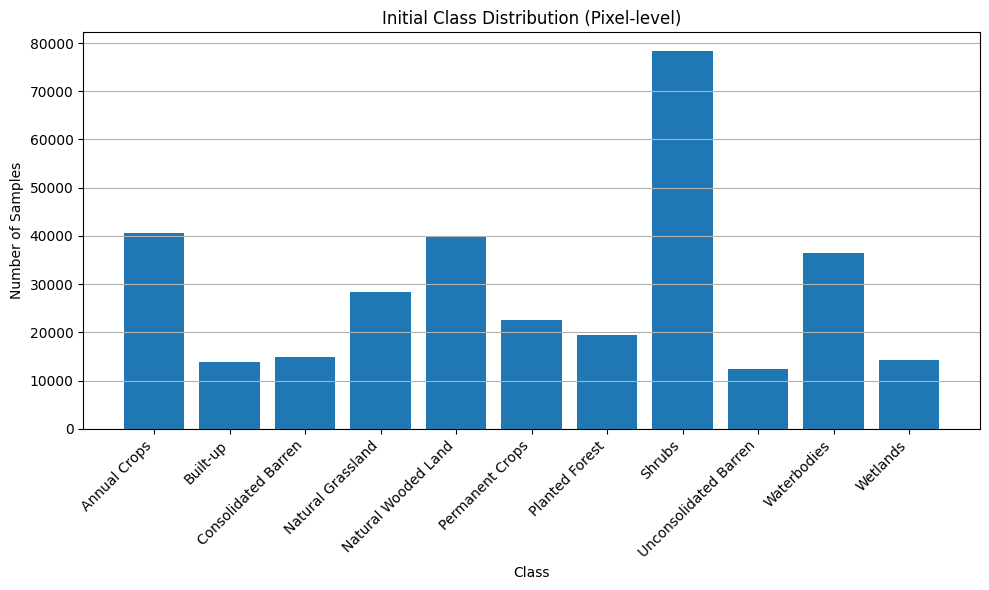

In [59]:
# Show initial class distribution at pixel-level
plot_class_distribution(samples_df['Label'].values, label_encoder.classes_, "Initial Class Distribution (Pixel-level)")

### Outlier detection and removal

In [60]:
cleaned_df, stats_info = pca_chi_square_outlier_pipeline_keep_freq(
    df=samples_df,
    frequency_cols=freq_cols,
    alpha=0.05,          # 95% confidence
    pca_variance=0.95,   # keep 95% variance in PCA
    min_pixels=30,
    enable_debug=True,
    color_map=None
)

print("Original DF shape =>", samples_df.shape)
print("Cleaned DF shape  =>", cleaned_df.shape)
print("Stats =>", stats_info)

Original DF shape => (320853, 377)
Cleaned DF shape  => (306075, 377)
Stats => {'total_outliers': 14778, 'per_sample': {np.int64(2): 7, np.int64(3): 11, np.int64(4): 4, np.int64(5): 7, np.int64(6): 6, np.int64(7): 13, np.int64(8): 3, np.int64(10): 8, np.int64(11): 4, np.int64(12): 5, np.int64(13): 5, np.int64(14): 10, np.int64(17): 7, np.int64(18): 3, np.int64(22): 6, np.int64(23): 8, np.int64(26): 8, np.int64(27): 5, np.int64(28): 5, np.int64(29): 3, np.int64(30): 8, np.int64(31): 3, np.int64(32): 2, np.int64(33): 12, np.int64(34): 8, np.int64(35): 6, np.int64(40): 4, np.int64(41): 6, np.int64(42): 2, np.int64(43): 8, np.int64(44): 7, np.int64(45): 4, np.int64(46): 10, np.int64(47): 6, np.int64(49): 3, np.int64(65): 7, np.int64(67): 7, np.int64(85): 12, np.int64(104): 11, np.int64(116): 8, np.int64(118): 11, np.int64(120): 14, np.int64(134): 6, np.int64(138): 2, np.int64(197): 6, np.int64(199): 4, np.int64(210): 8, np.int64(232): 5, np.int64(255): 6, np.int64(257): 6, np.int64(266): 1

In [61]:
cleaned_df

,frq0,frq1,frq2,frq3,frq4,frq5,frq6,frq7,frq8,frq9,...,frq367,frq368,Sample_num,Label,Shape,File_UID_Num,File,img_pxl_index,img_pos,Label_Encoded
0,0.029069,0.033152,0.035469,0.041350,0.043226,0.045428,0.048409,0.049431,0.052631,0.054922,...,0.173310,0.171577,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,0,"(0, 0)",8
1,0.030087,0.034019,0.035511,0.041382,0.042764,0.045505,0.049077,0.049998,0.052073,0.055954,...,0.170324,0.193503,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,1,"(0, 1)",8
2,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170450,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,2,"(0, 2)",8
3,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170449,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,3,"(0, 3)",8
4,0.031720,0.040508,0.042270,0.042718,0.043992,0.049516,0.051002,0.052987,0.057484,0.058246,...,0.189454,0.180372,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,4,"(0, 4)",8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306070,0.008262,0.007249,0.010430,0.013172,0.014590,0.016147,0.017221,0.016435,0.020677,0.020636,...,0.067343,0.070380,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,59,"(7, 3)",4
306071,0.002546,0.009940,0.010392,0.014686,0.015467,0.015819,0.018658,0.021157,0.020507,0.019907,...,0.065229,0.067679,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,60,"(7, 4)",4
306072,0.003634,0.012806,0.014233,0.018610,0.017898,0.017720,0.022039,0.023810,0.023159,0.022642,...,0.096255,0.102634,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,61,"(7, 5)",4
306073,0.002516,0.013354,0.012534,0.015690,0.016293,0.016206,0.020137,0.022669,0.020269,0.020936,...,0.085134,0.089147,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,62,"(7, 6)",4


### Data Split

In [62]:
# We'll base the split on 'cleaned_df'
image_samples_df = cleaned_df[['Sample_num', 'Label_Encoded']].drop_duplicates()

sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_indices, test_indices = next(sss.split(image_samples_df['Sample_num'], image_samples_df['Label_Encoded']))

train_sample_nums = image_samples_df['Sample_num'].iloc[train_indices]
test_sample_nums = image_samples_df['Sample_num'].iloc[test_indices]

train_df = cleaned_df[cleaned_df['Sample_num'].isin(train_sample_nums)]
test_df = cleaned_df[cleaned_df['Sample_num'].isin(test_sample_nums)]

# Re-check the freq_cols from the cleaned df
frequency_cols = [col for col in cleaned_df.columns if col.startswith('frq')]

# Build X, y
X_train = train_df[frequency_cols].values
y_train = train_df['Label_Encoded'].values

X_test = test_df[frequency_cols].values
y_test = test_df['Label_Encoded'].values

num_classes = len(cleaned_df['Label_Encoded'].unique())

# One-hot
y_train_cat = to_categorical(y_train, num_classes)
y_test_cat = to_categorical(y_test, num_classes)

# Reshape for Conv1D
X_train_cnn = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test_cnn  = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

print("X_train shape =>", X_train.shape)  # Should be (#pixels, #freq, 1)
print("X_test shape =>", X_test.shape)

X_train shape => (247189, 369)
X_test shape => (58886, 369)


### Data Visualization

In [63]:
# Aggregate counts of labels for each Sample_num in training data
train_aggregated_counts = train_df.groupby(['Sample_num', 'Label']).size().reset_index(name='Pixel_Count')
train_label_counts_per_sample = train_aggregated_counts.groupby('Label')['Sample_num'].nunique()

# Aggregate counts of labels for each Sample_num in testing data
test_aggregated_counts = test_df.groupby(['Sample_num', 'Label']).size().reset_index(name='Pixel_Count')
test_label_counts_per_sample = test_aggregated_counts.groupby('Label')['Sample_num'].nunique()

In [64]:
print("Aggregated Label Counts by Sample Number in Training Data:")
print(train_label_counts_per_sample)

print("\nAggregated Label Counts by Sample Number in Testing Data:")
print(test_label_counts_per_sample)

Aggregated Label Counts by Sample Number in Training Data:
Label
Annual Crops             197
Built-up                  76
Consolidated Barren       49
Natural Grassland        116
Natural Wooded Land      166
Permanent Crops          110
Planted Forest            90
Shrubs                   271
Unconsolidated Barren     58
Waterbodies              181
Wetlands                  69
Name: Sample_num, dtype: int64

Aggregated Label Counts by Sample Number in Testing Data:
Label
Annual Crops             49
Built-up                 19
Consolidated Barren      12
Natural Grassland        29
Natural Wooded Land      42
Permanent Crops          28
Planted Forest           22
Shrubs                   68
Unconsolidated Barren    15
Waterbodies              45
Wetlands                 17
Name: Sample_num, dtype: int64


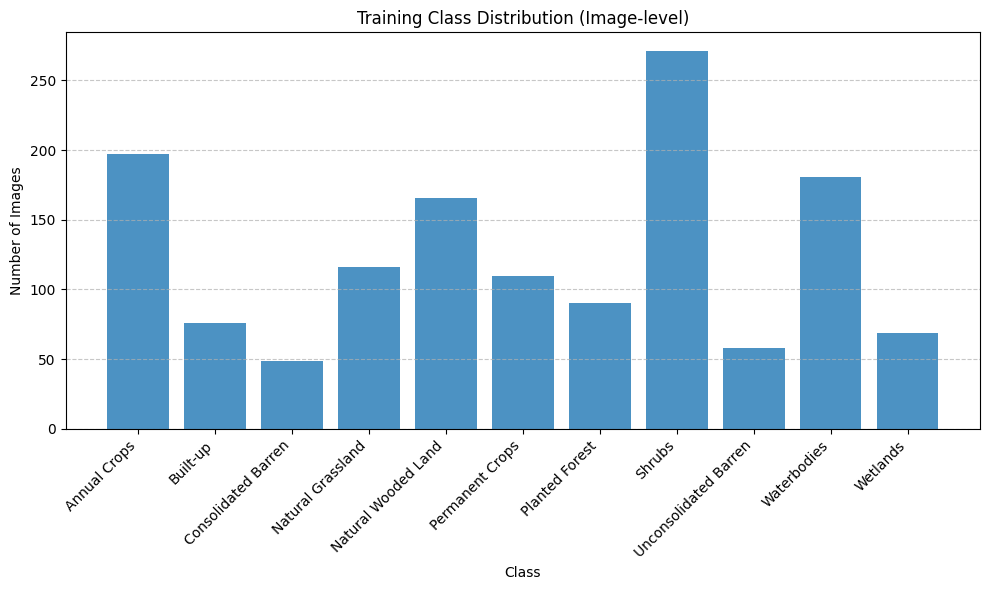

In [65]:
# Plot the training class distribution (Image-level)
plot_image_level_distribution(
    aggregated_counts=train_label_counts_per_sample,
    title="Training Class Distribution (Image-level)"
)

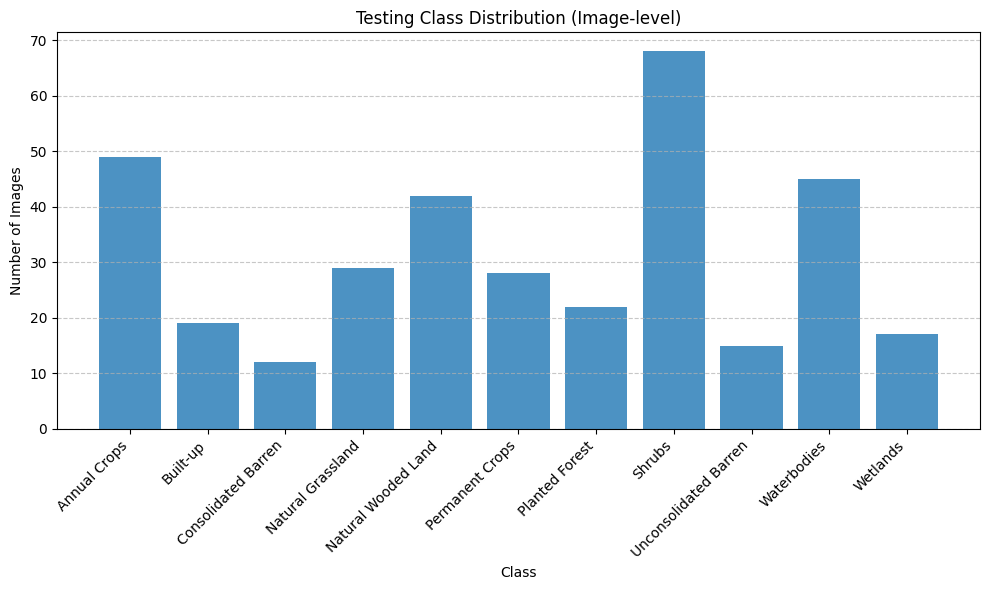

In [66]:
# Plot the testing class distribution (Image-level)
plot_image_level_distribution(
    aggregated_counts=test_label_counts_per_sample,
    title="Testing Class Distribution (Image-level)"
)

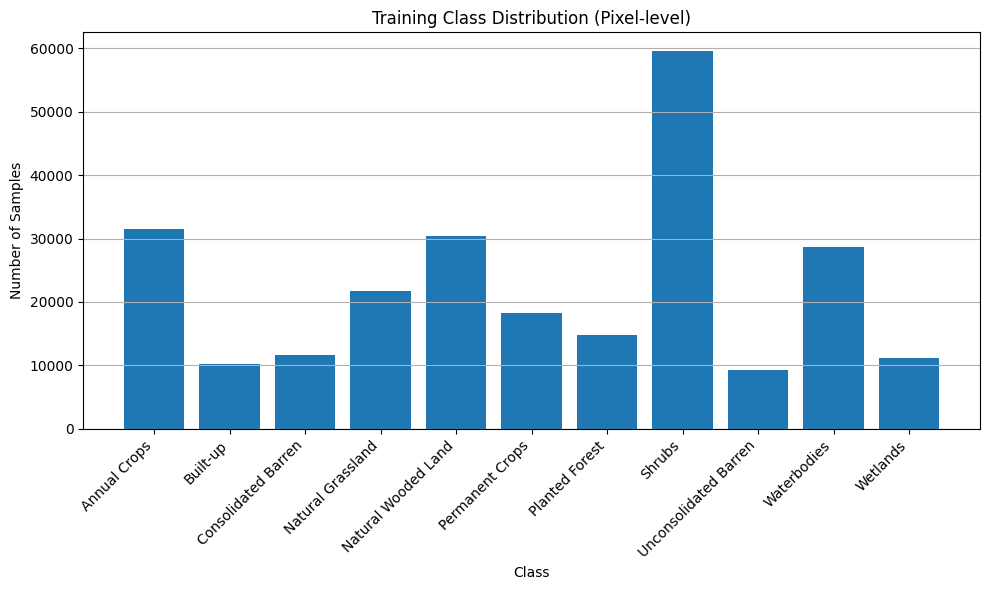

In [67]:
plot_class_distribution(train_df['Label'].values, label_encoder.classes_, "Training Class Distribution (Pixel-level)")

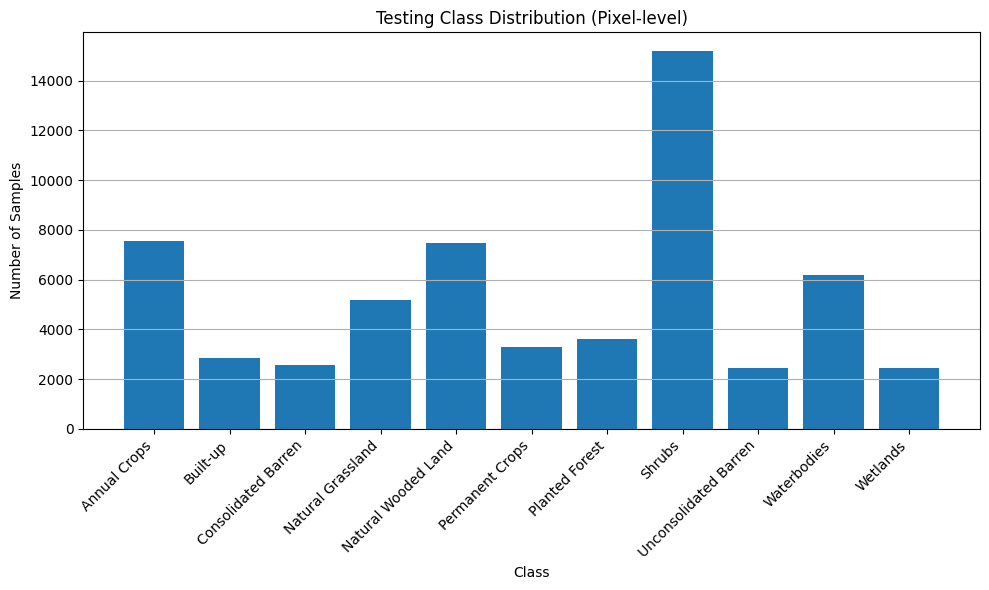

In [68]:
plot_class_distribution(test_df['Label'].values, label_encoder.classes_, "Testing Class Distribution (Pixel-level)")

In [69]:
print(X_train_cnn.shape, X_test_cnn.shape)
print(y_train_cat.shape, y_test_cat.shape)

(247189, 369, 1) (58886, 369, 1)
(247189, 11) (58886, 11)


### Define Model (Loading from weights)

In [70]:
 input_shape = (X_train.shape[1], 1)

 # Create new instance of model
 model = get_cnn_model(input_shape, num_classes, wd=1e-6, drop_rate=0.3, learning_rate=.0001)


 # Load weights
 checkpoint_path = checkpointDir + 'Testing/All_Classes_OutlierRemoval.weights.h5'
 model.load_weights(checkpoint_path)

 model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 38 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                 │ (None, 367, 512)       │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d (MaxPooling1D)    │ (None, 183, 512)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 181, 256)       │       393,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_1 (MaxPooling1D)  │ (None, 90, 256)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_2 (Conv1D)               │ (None, 88, 256)        │       196,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_2 (MaxPooling1D)  │ (None, 44, 256)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_3 (Conv1D)               │ (None, 42, 128)        │        98,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 42, 128)        │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ feature_layer (Flatten)         │ (None, 5376)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       688,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 11)             │           363 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,390,283 (5.30 MB)

 Trainable params: 1,390,027 (5.30 MB)

 Non-trainable params: 256 (1.00 KB)

### Define & Train CNN (If not loading from wieghts!)


In [71]:
# Define callbacks
#checkpoint_path = checkpointDir + 'Testing/All_Classes_OutlierRemoval_NewData.weights.h5'
#callbacks = define_callbacks(checkpoint_path)

#input_shape = (X_train_cnn.shape[1], 1)

# Initialize CNN model
#model = get_cnn_model(
 # input_shape=input_shape,
  #num_classes=num_classes,
  #wd=1e-6,
  #drop_rate=0.5,
  #learning_rate=1e-4
#)
#model.summary()

In [73]:
# Train the model
history = train_model(model, X_train_cnn, y_train_cat, X_test_cnn, y_test_cat, epochs=50, batch_size=32, checkpoint_path=checkpoint_path)

Epoch 1/50
7725/7725 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.9299 - loss: 0.2194
Epoch 1: val_accuracy improved from -inf to 0.73094, saving model to /content/drive/My Drive/BioSCape/1DCheckpoints/Testing/All_Classes_OutlierRemoval.weights.h5
7725/7725 ━━━━━━━━━━━━━━━━━━━━ 98s 12ms/step - accuracy: 0.9299 - loss: 0.2194 - val_accuracy: 0.7309 - val_loss: 374.1395 - learning_rate: 1.0000e-04
Epoch 2/50
7721/7725 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9298 - loss: 0.2179
Epoch 2: val_accuracy did not improve from 0.73094
7725/7725 ━━━━━━━━━━━━━━━━━━━━ 87s 11ms/step - accuracy: 0.9298 - loss: 0.2179 - val_accuracy: 0.7299 - val_loss: 1.7990 - learning_rate: 1.0000e-04
Epoch 3/50
7722/7725 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9317 - loss: 0.2119
Epoch 3: val_accuracy improved from 0.73094 to 0.73945, saving model to /content/drive/My Drive/BioSCape/1DCheckpoints/Testing/All_Classes_OutlierRemoval.weights.h5
7725/7725 ━━━━━━━━━━━━━━━━━━━━ 88s 11ms/step - accuracy

In [71]:
import os
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from tensorflow.keras.models import Model

# Set up directory for saving feature outputs
feature_output_dir = mainDir + "FeatureOutputs/"
os.makedirs(feature_output_dir, exist_ok=True)

# Get the output from the intermediate CNN layer
feature_layer_output = model.get_layer("feature_layer").output

# Create a new model that outputs from the feature layer
feature_model = Model(inputs=model.inputs, outputs=feature_layer_output)

# Run your CNN on the training and test data just once
X_train_features = feature_model.predict(X_train_cnn)
X_test_features = feature_model.predict(X_test_cnn)

# Save feature outputs so you don't need to rerun the CNN
np.save(feature_output_dir + "X_train_features.npy", X_train_features)
np.save(feature_output_dir + "X_test_features.npy", X_test_features)

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(32, 369, 1))
  warnings.warn(msg)


7718/7725 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(None, 369, 1))
  warnings.warn(msg)


7725/7725 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step
1841/1841 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step


In [72]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from tensorflow.keras.models import Model

feature_layer_output = model.get_layer("feature_layer").output
# Rebuild the feature model without explicitly referencing model.input
feature_model = Model(inputs=model.inputs, outputs=feature_layer_output)
X_train_features = feature_model.predict(X_train_cnn, batch_size=32, verbose=1)
X_test_features = feature_model.predict(X_test_cnn, batch_size=32, verbose=1)


# Define the parameter grid for tuning
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    #'min_samples_split': [2, 5],
    #'min_samples_leaf': [1, 2, 4],
    #'max_features': ['auto', 'sqrt', 'log2']
}

# Create the RandomForestClassifier
rf = RandomForestClassifier(random_state=42)

# Perform grid search with cross-validation
#grid_search = RandomizedSearchCV(estimator=rf, param_distributions=param_grid,
                                   #n_iter=4, cv=2, random_state=42, n_jobs=-1, verbose=2)
#grid_search.fit(X_train_features, y_train)

# Get the best parameters and score
#print(f"Best Parameters: {grid_search.best_params_}")
#print(f"Best Cross-validation Score: {grid_search.best_score_}")

# Use the best estimator to make predictions
#best_rf_model = randomForrest.best_estimator_
# Evaluate on test set
rf.fit(X_train_features, y_train)
test_accuracy = rf.score(X_test_features, y_test)

test_accuracy = rf.score(X_test_features, y_test)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

7725/7725 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step
1841/1841 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step
Test Accuracy: 72.87%


### Test Model Performance

In [ ]:
# Get the testing Acc. after training
test_accuracy = evaluate_model(model, X_test_cnn, y_test_cat)
print("Final Test Accuracy:", test_accuracy)

1841/1841 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.7207 - loss: 471.6756
Test Accuracy: 0.7225
Final Test Accuracy: 0.7225486636161804


### Post-Training Visualization

In [ ]:
# Get predictions on the test set
y_test_labels, y_pred_labels, _, _  = get_predictions(model, X_test_cnn, y_test_cat, label_encoder)

NameError: name 'y_test_cat' is not defined

In [ ]:
# Predict with the trained model
y_pred_probs = model.predict(test_ds)

# If performing classification, get predicted class indices
y_pred_int = np.argmax(y_pred_probs, axis=1)  # This is correct if y_pred_probs is a 2D array of class probabilities.

# Your true labels should be the integers from y_test, not one-hot encoded:
y_true_int = y_test  # Assuming y_test is already in integer form

# If you have a label encoder and need to transform integer labels back to original class names:
y_pred_labels = label_encoder.inverse_transform(y_pred_int)
y_true_labels = label_encoder.inverse_transform(y_true_int)

# Now you can compare y_true_labels and y_pred_labels for performance evaluation



59/59 [==============================] - 18s 287ms/step


KeyError: 'val_accuracy'

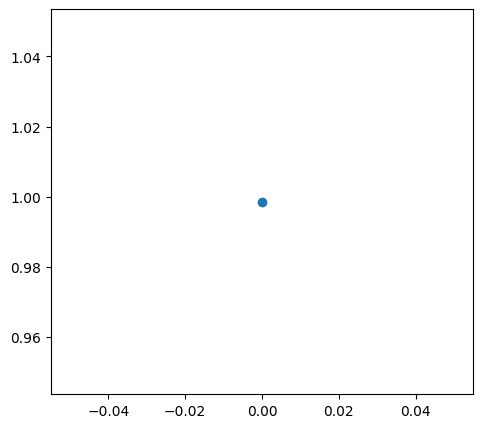

In [ ]:
# Plotting the training curves
plot_training_curves(history, "1D CNN")

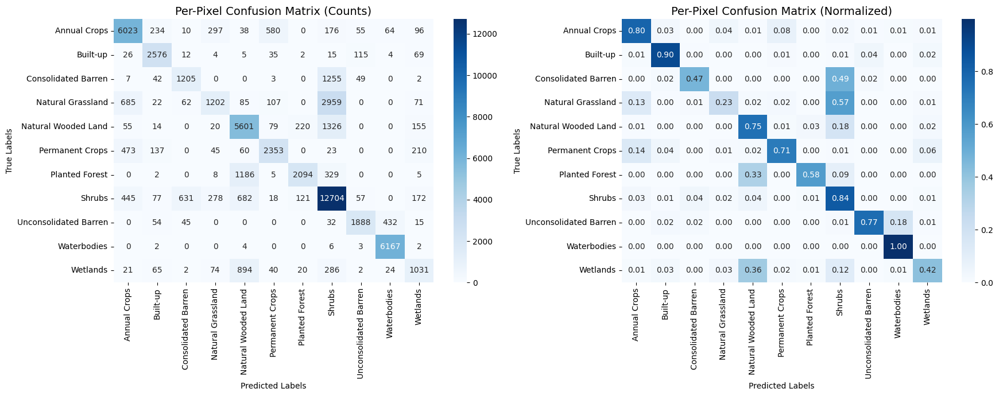

In [ ]:
# Create a CM
conf_mat_counts, conf_mat_normalized = plot_confusion_matrices_with_counts_and_normalized(
    y_true=y_test_labels,
    y_pred=y_pred_labels,
    label_encoder=label_encoder,
    title_counts="Per-Pixel Confusion Matrix (Counts)",
    title_normalized="Per-Pixel Confusion Matrix (Normalized)"
)

In [ ]:
# Get the Classification Report
print(classification_report(y_test_labels, y_pred_labels, target_names=label_encoder.classes_))

                       precision    recall  f1-score   support

         Annual Crops       0.78      0.80      0.79      7573
             Built-up       0.80      0.90      0.85      2863
  Consolidated Barren       0.61      0.47      0.53      2563
    Natural Grassland       0.62      0.23      0.34      5193
  Natural Wooded Land       0.65      0.75      0.70      7470
      Permanent Crops       0.73      0.71      0.72      3301
       Planted Forest       0.85      0.58      0.69      3629
               Shrubs       0.66      0.84      0.74     15185
Unconsolidated Barren       0.87      0.77      0.81      2466
          Waterbodies       0.92      1.00      0.96      6184
             Wetlands       0.56      0.42      0.48      2459

             accuracy                           0.73     58886
            macro avg       0.73      0.68      0.69     58886
         weighted avg       0.73      0.73      0.71     58886



4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


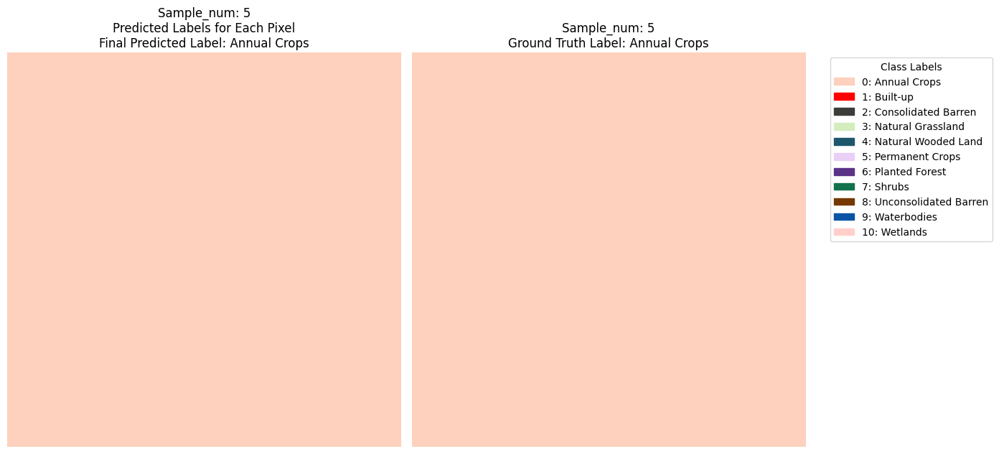

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


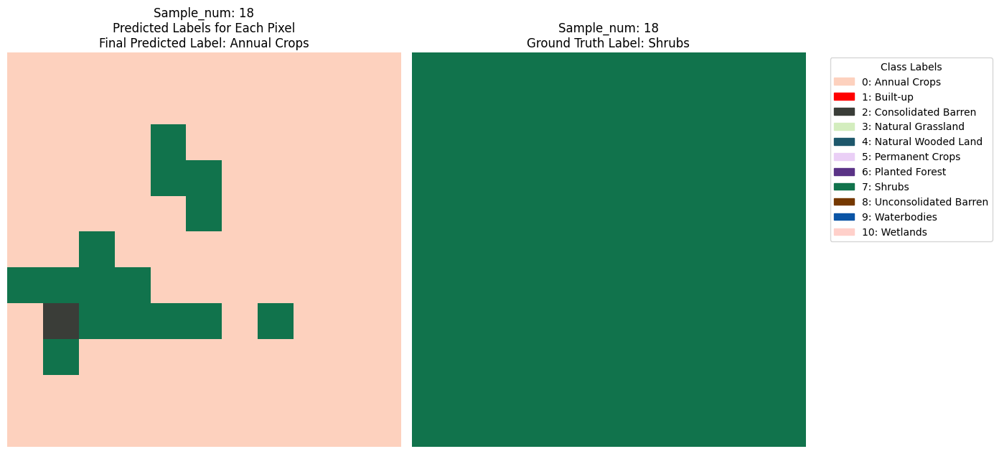

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


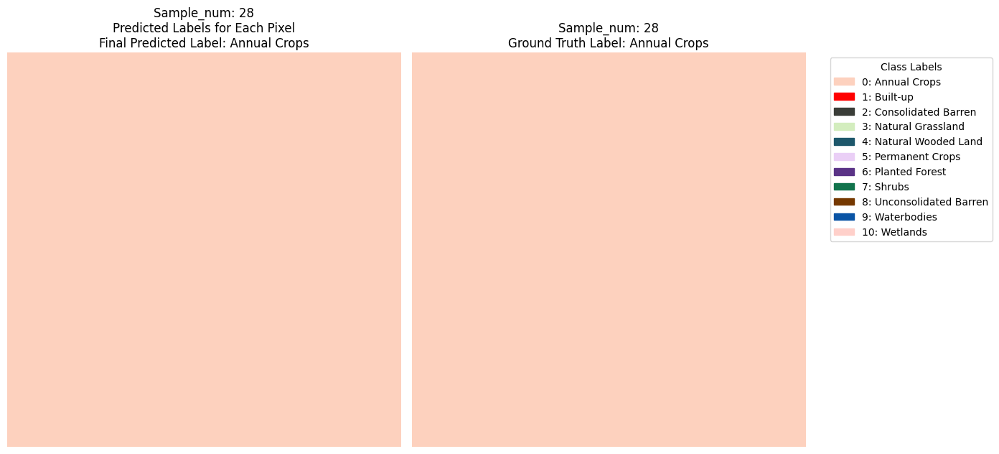

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


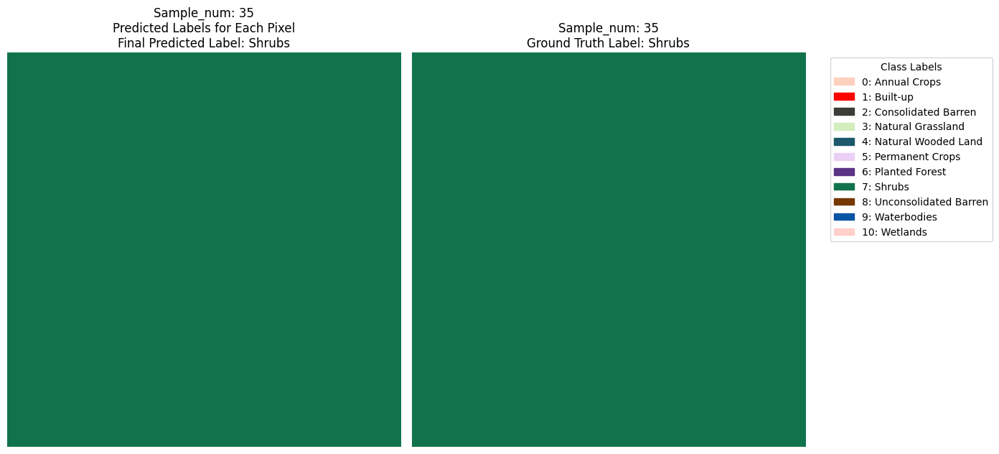

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


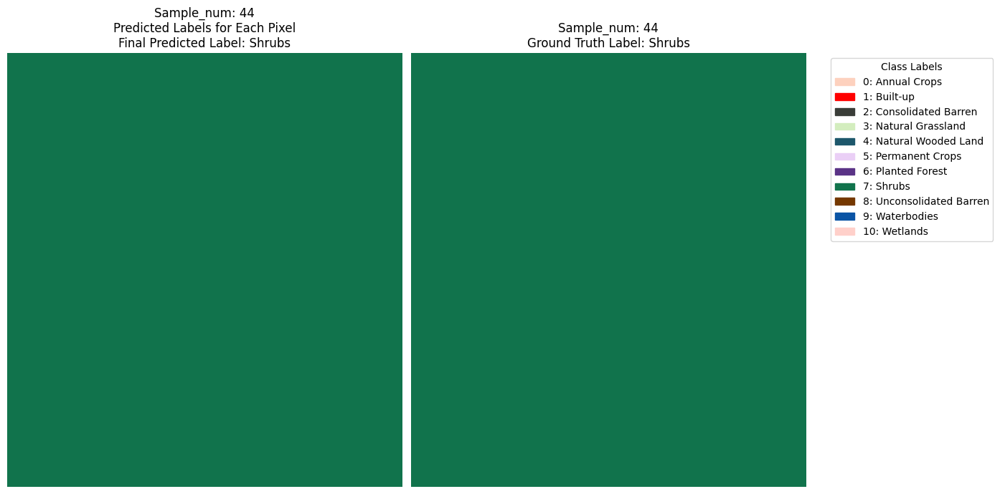

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


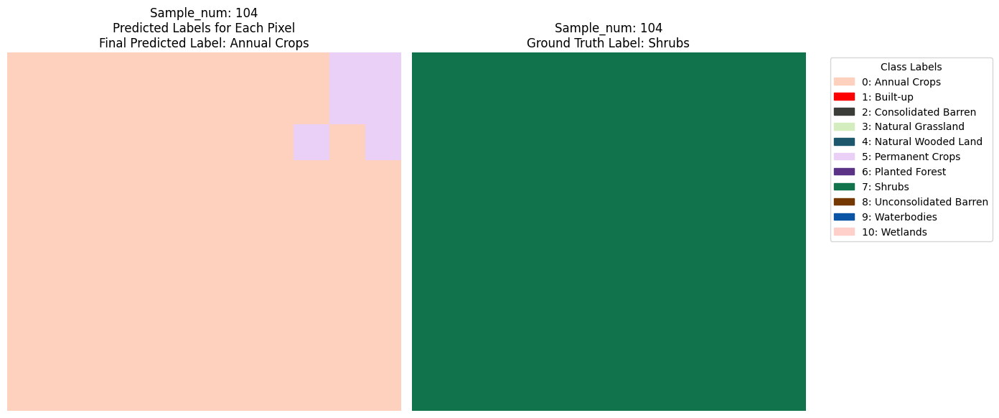

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


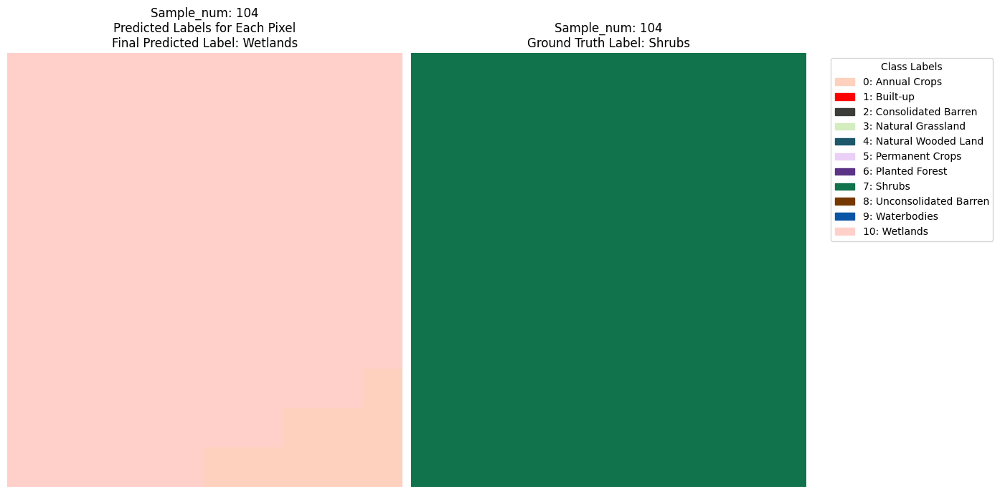

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step  


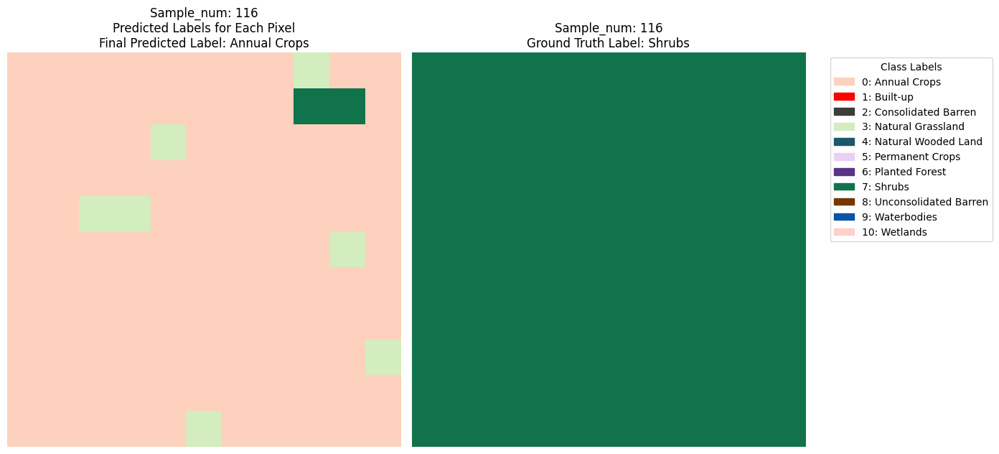

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


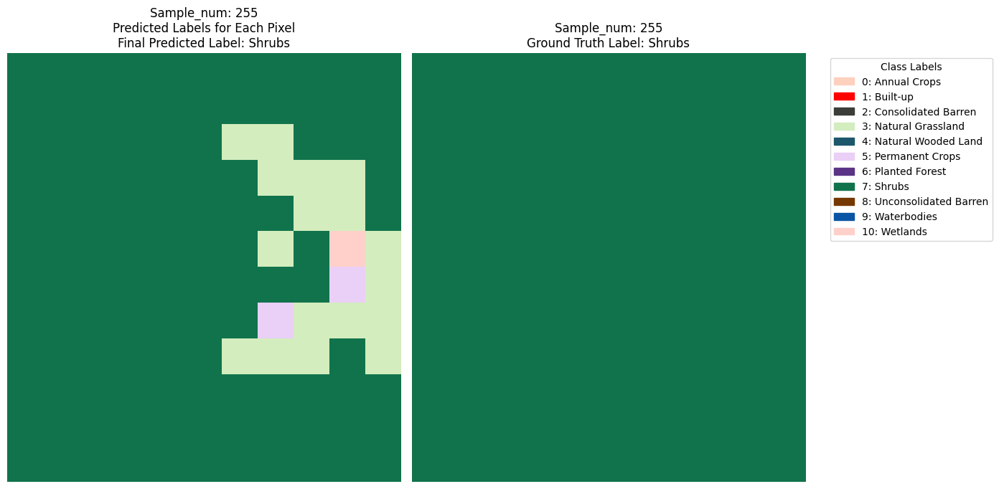

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


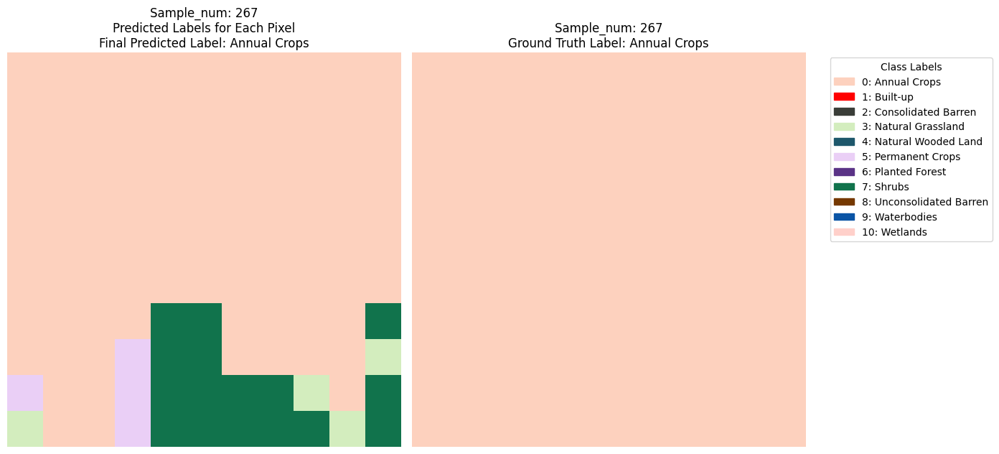

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


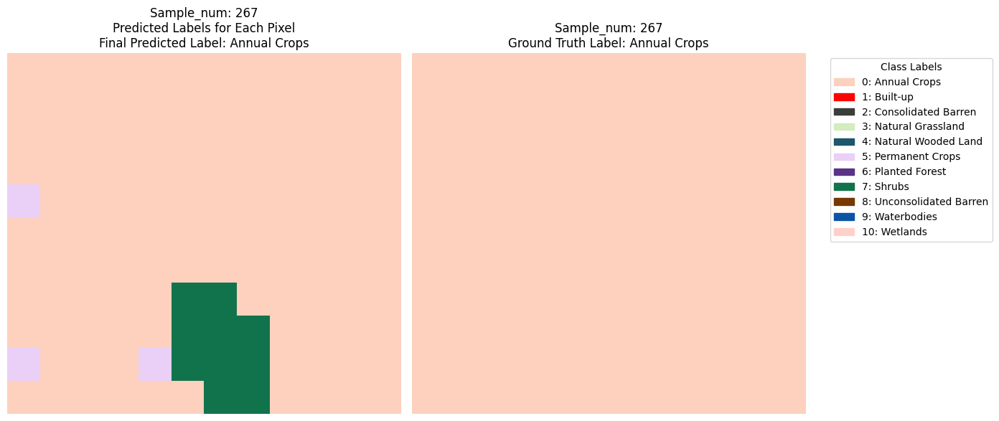

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


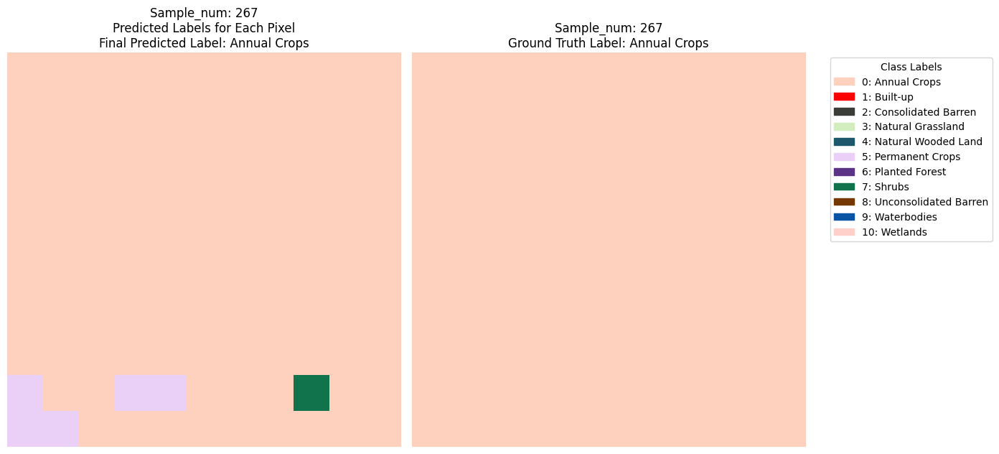

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


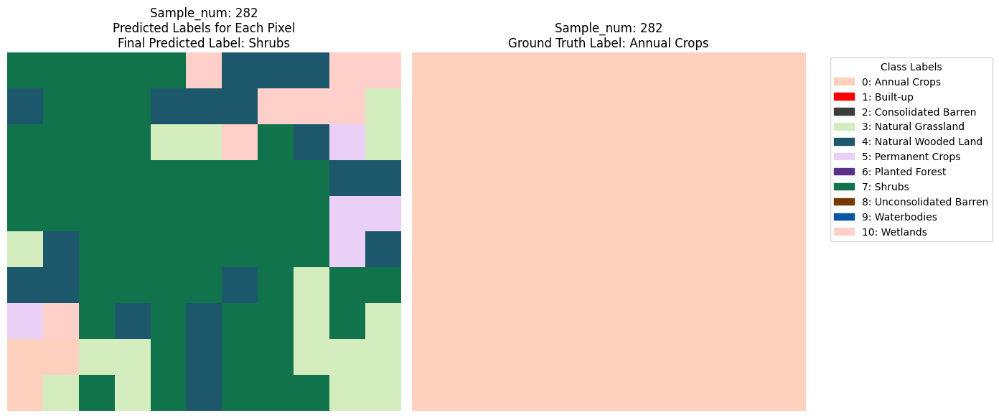

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


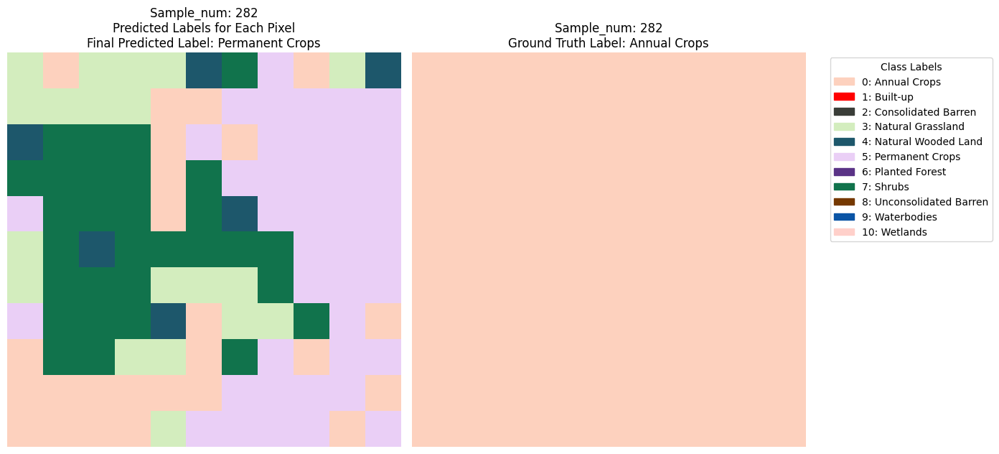

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


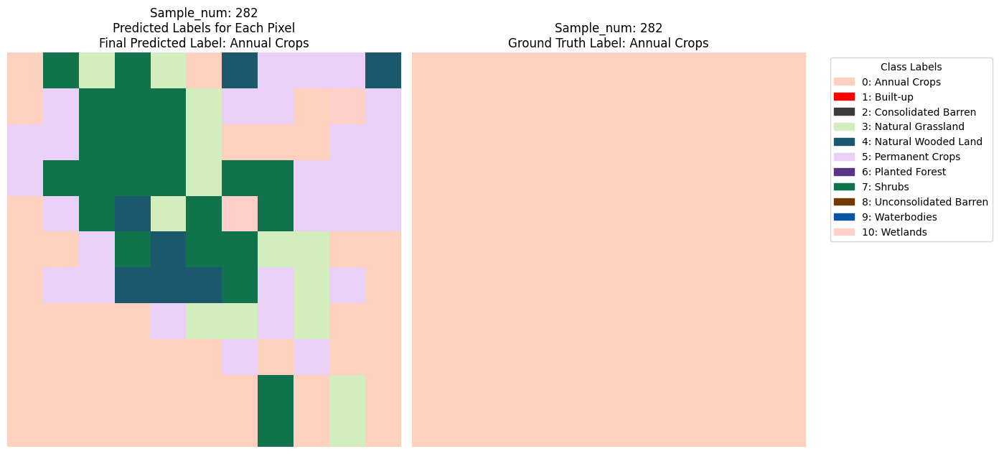

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


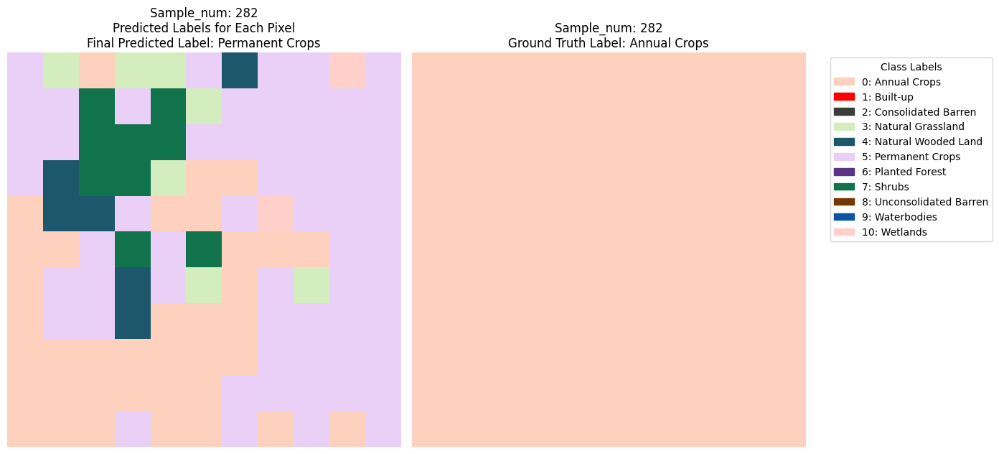

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


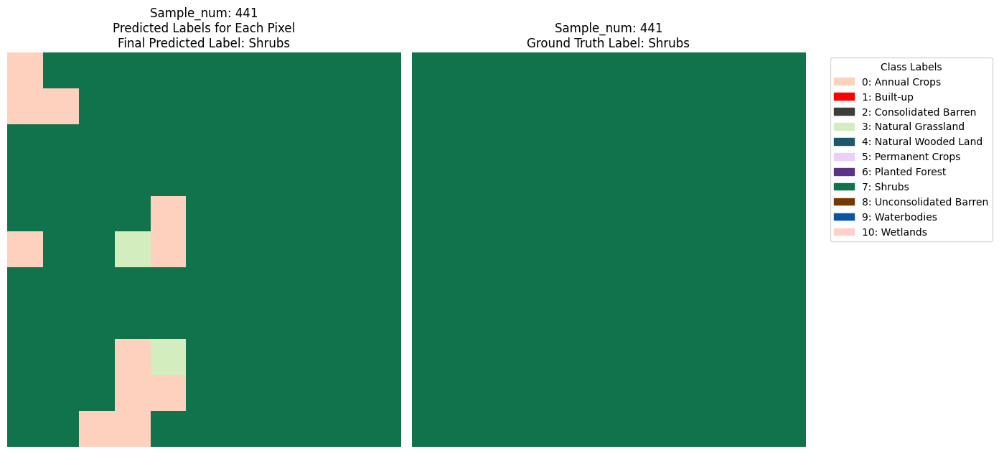

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


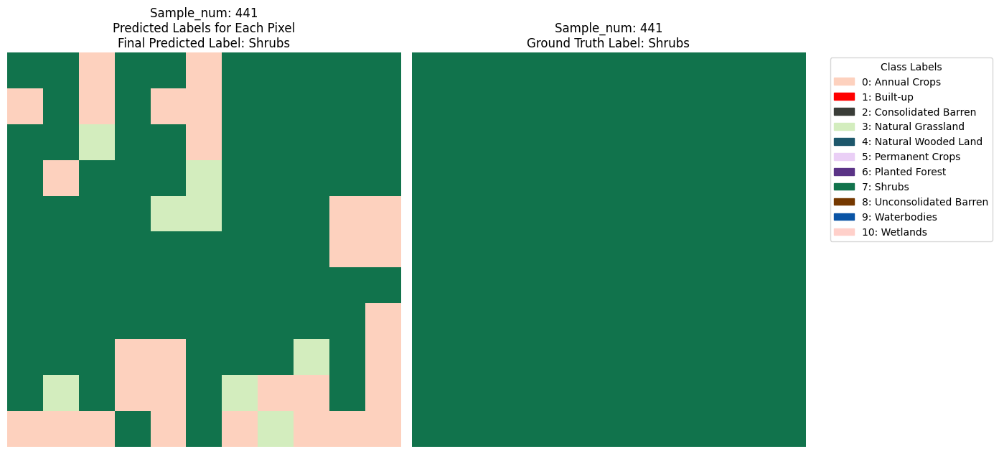

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


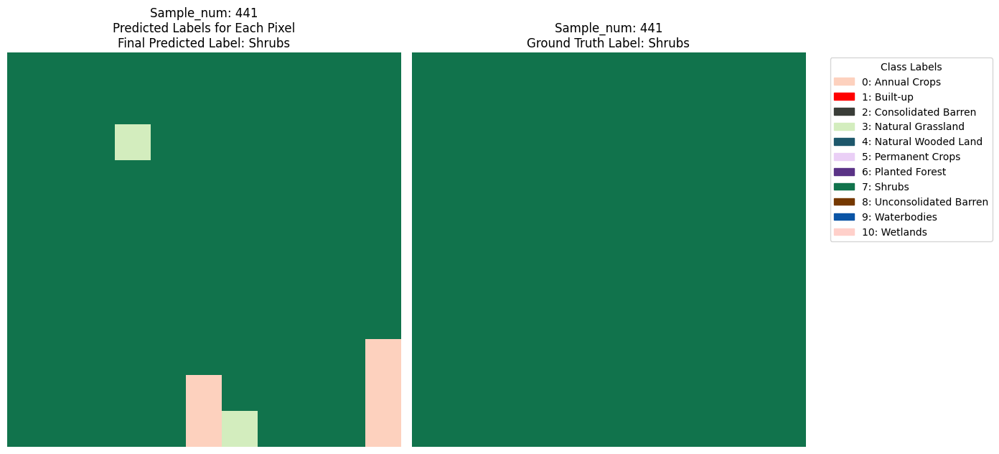

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


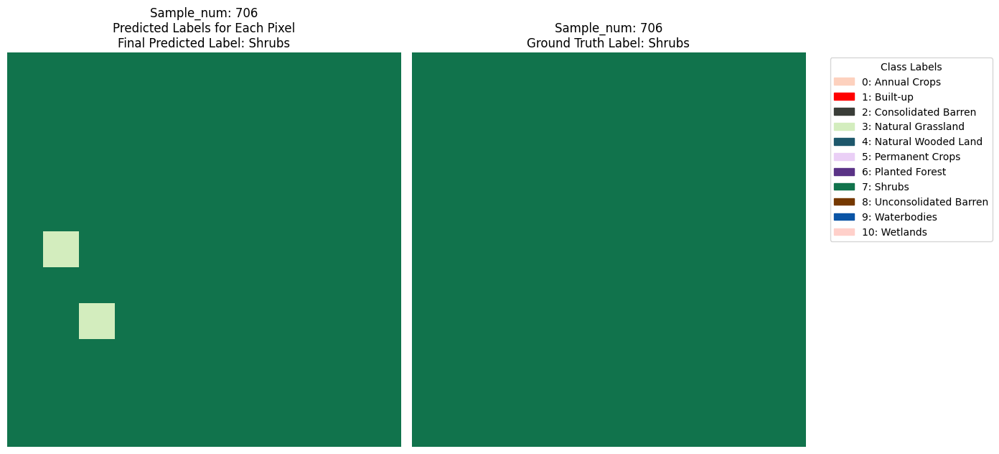

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


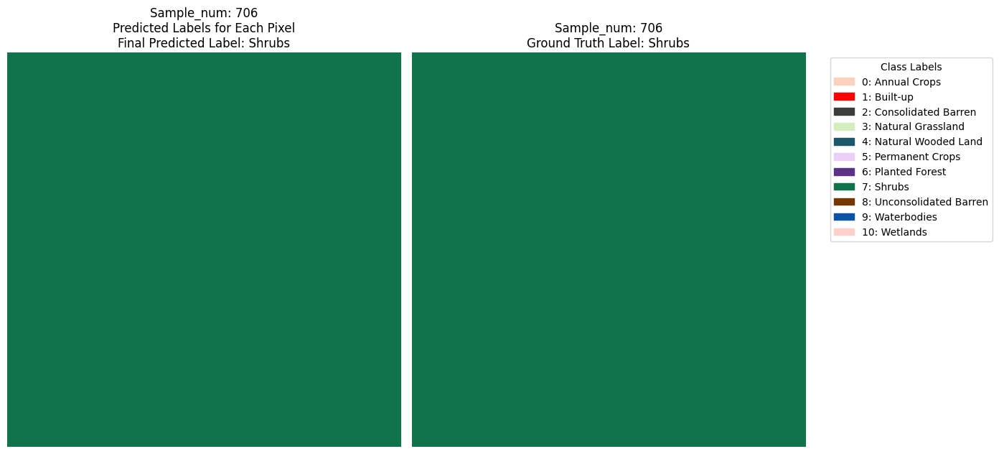

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


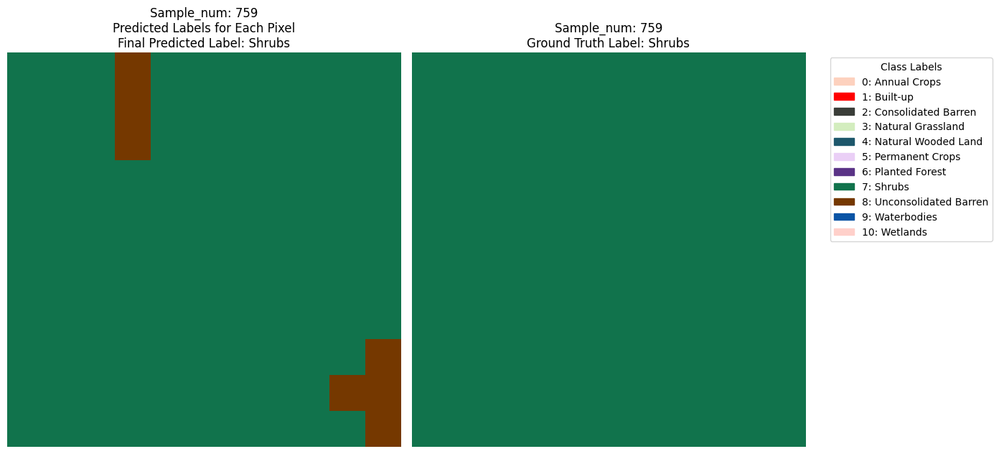

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


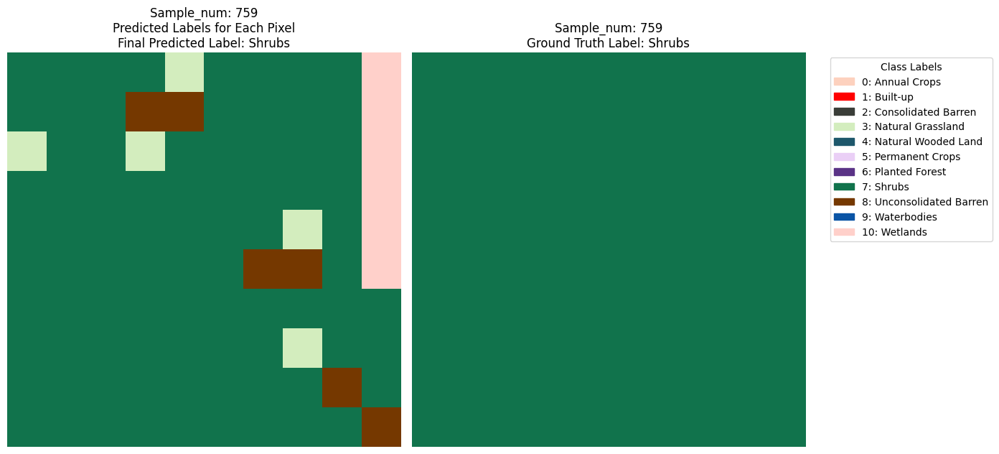

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


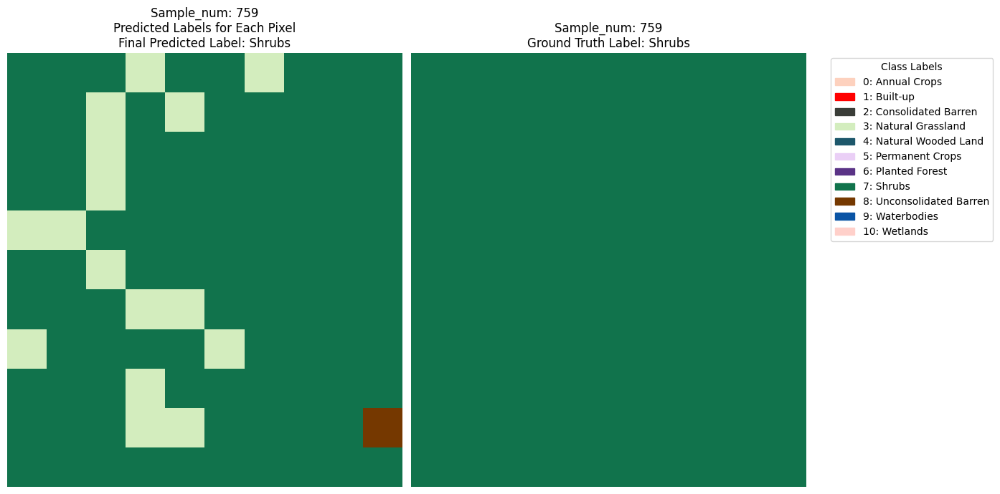

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


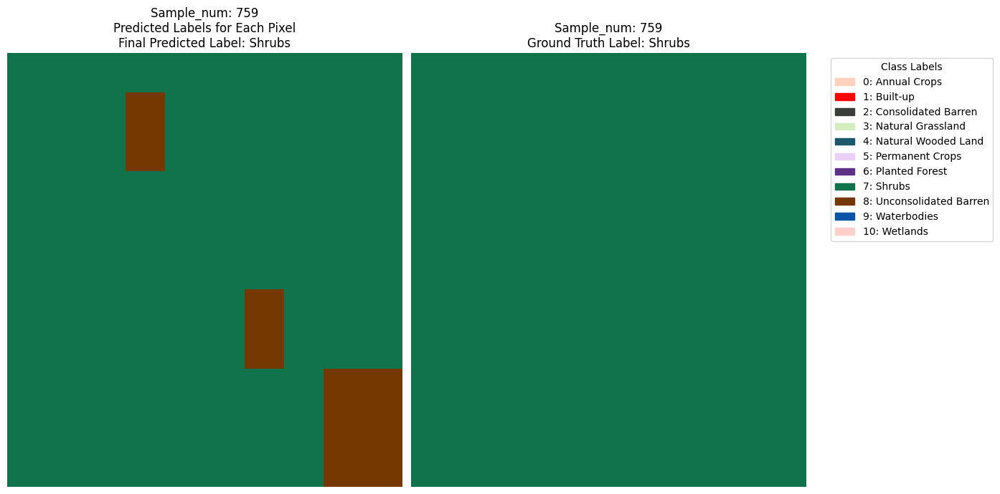

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


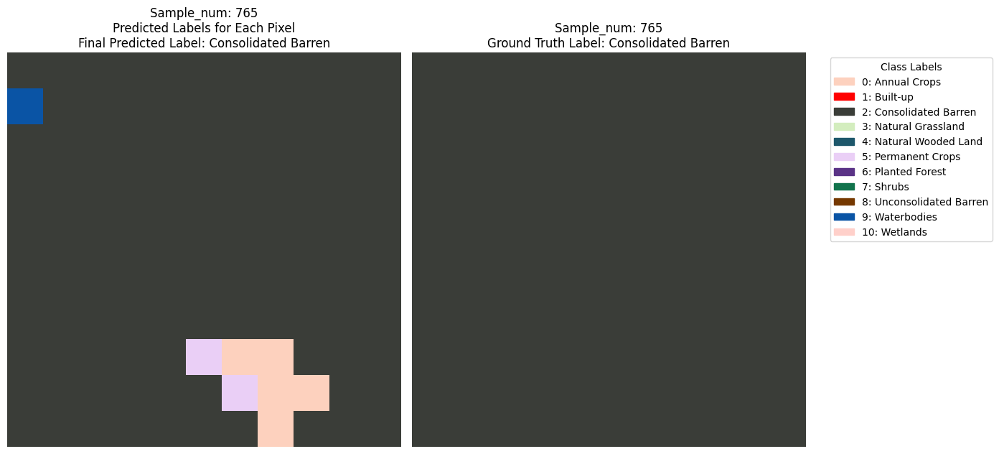

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


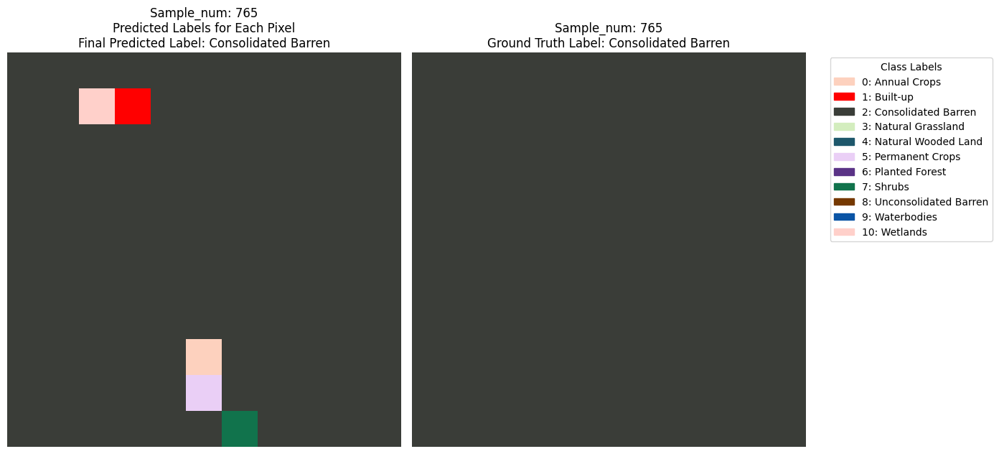

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


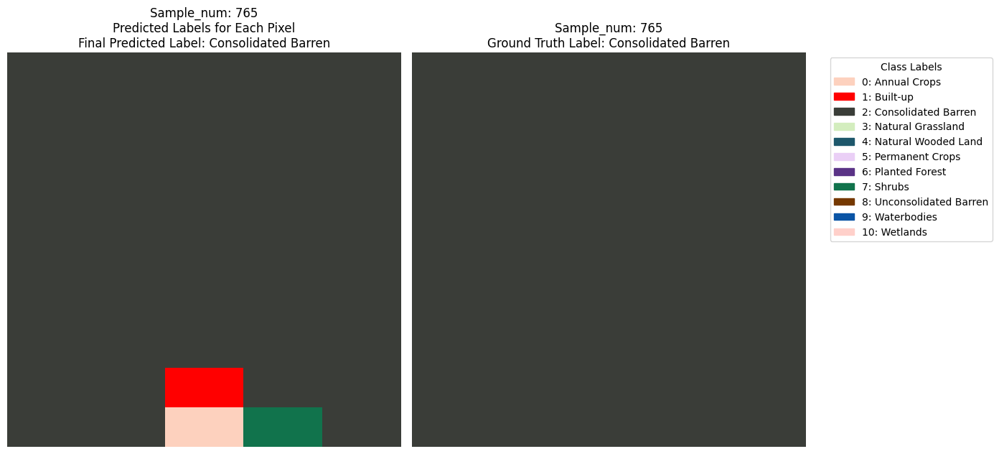

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


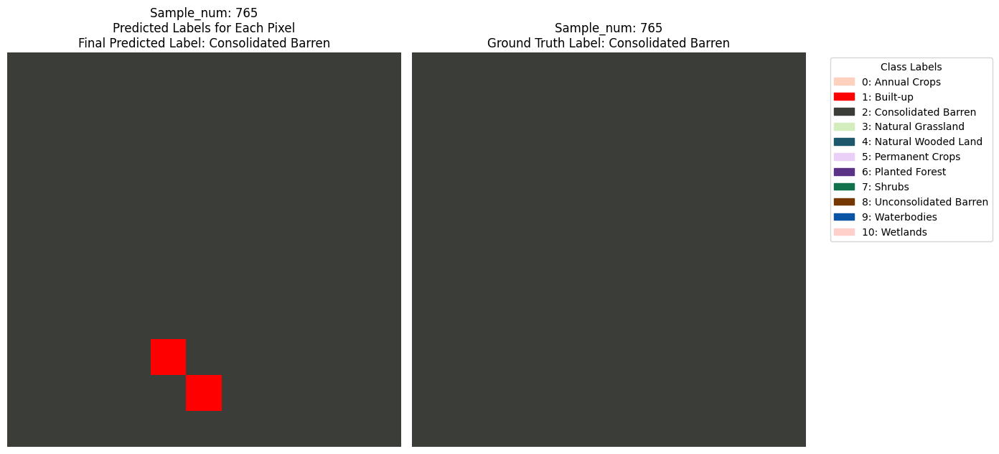

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


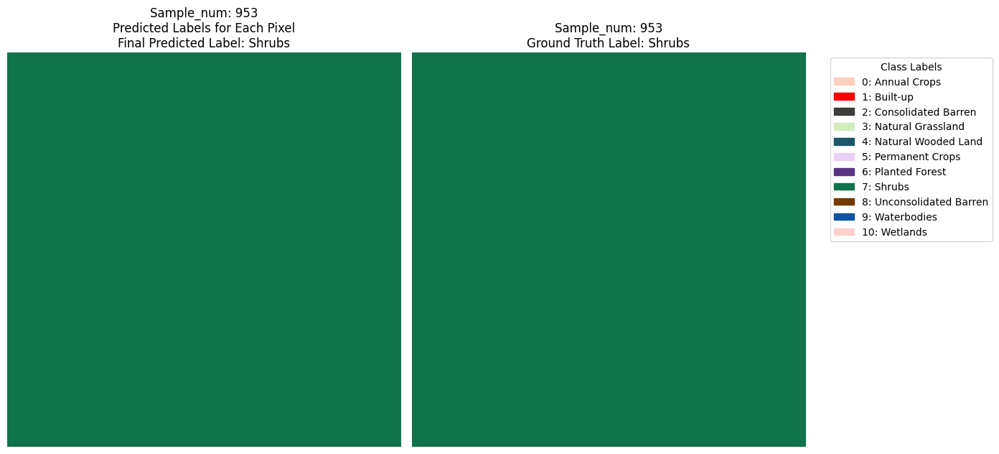

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


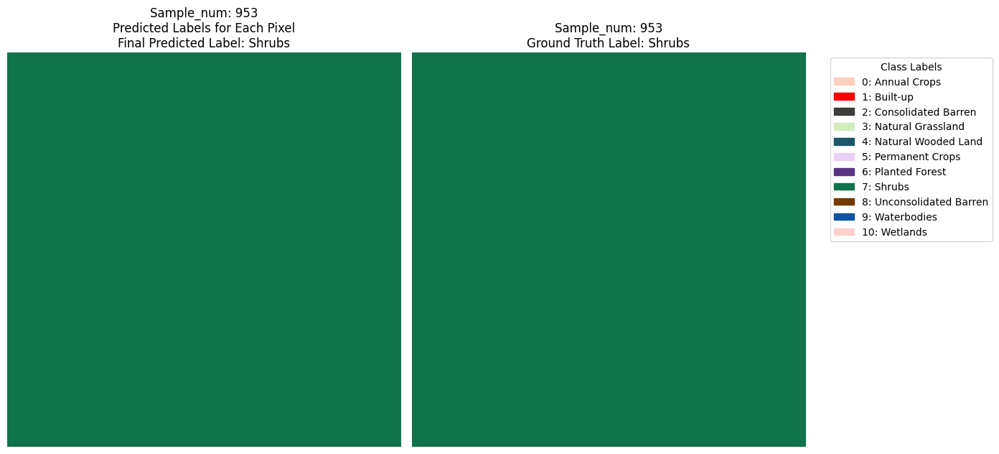

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


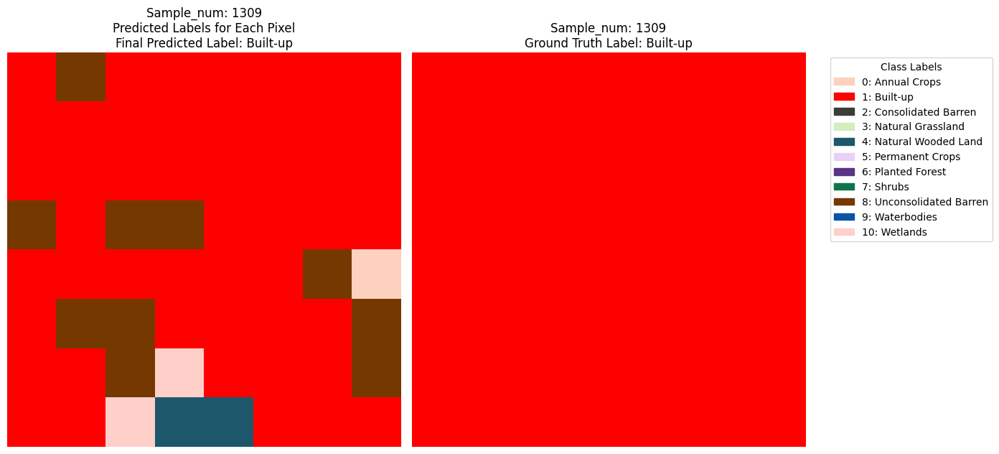

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


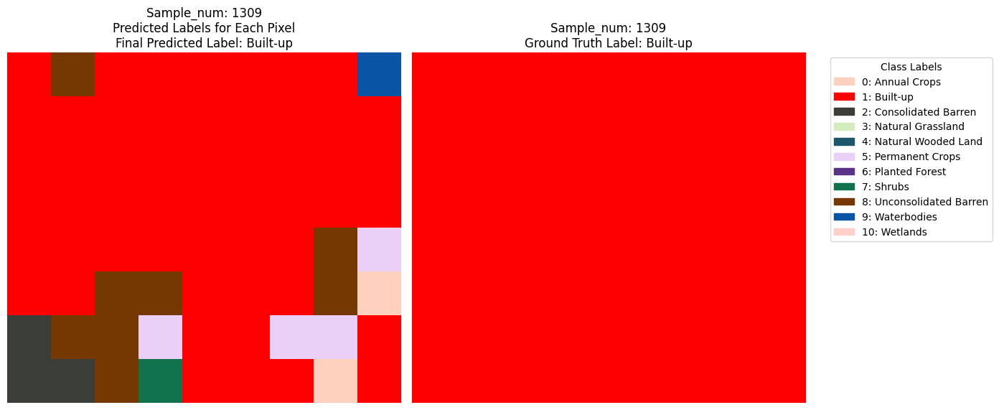

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


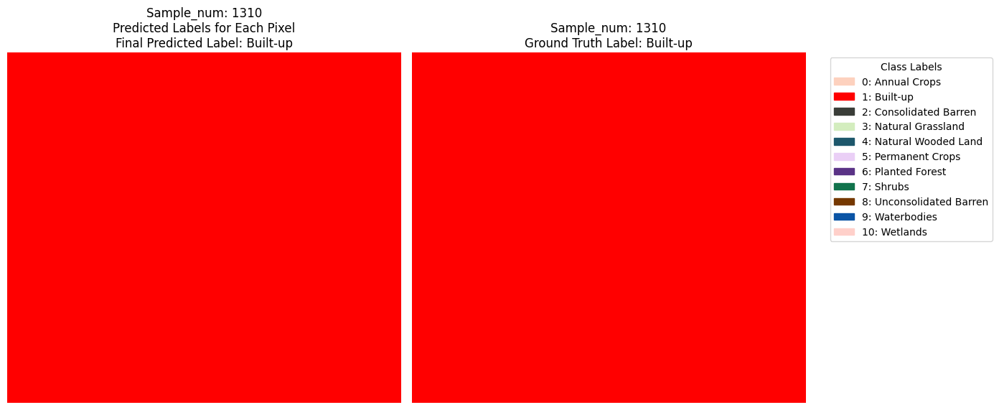

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


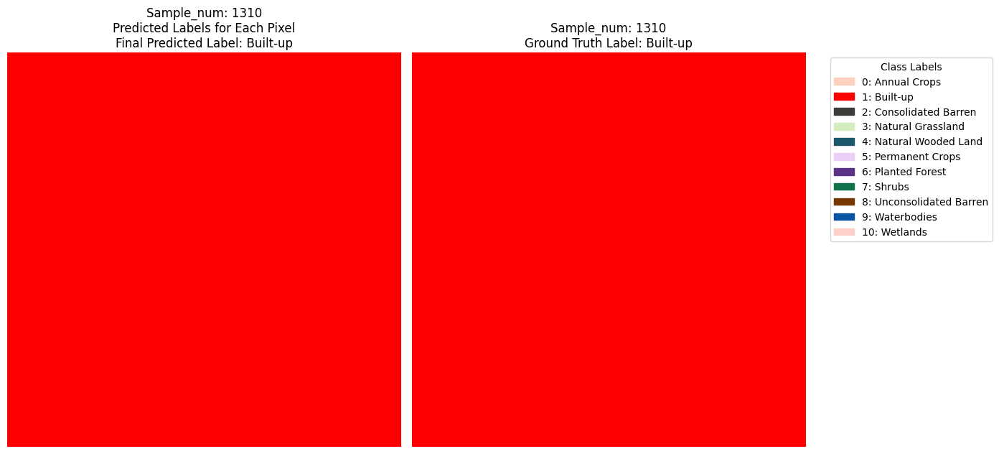

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


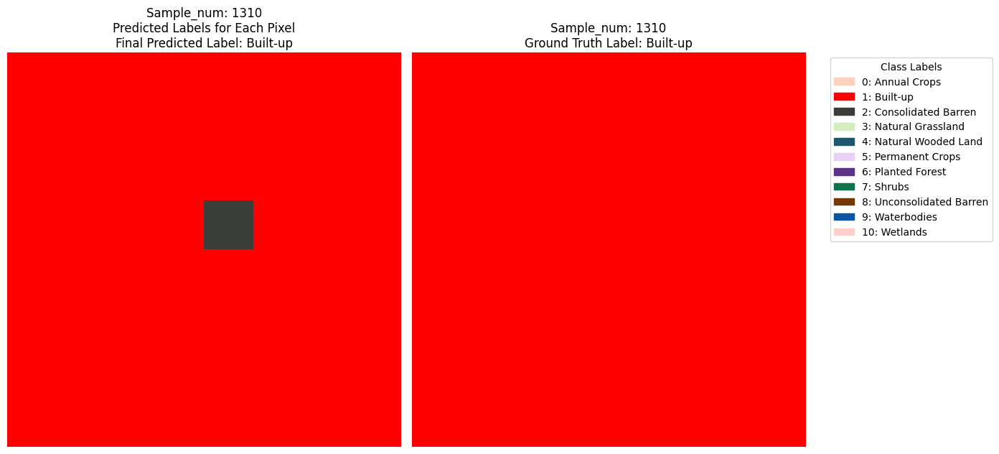

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


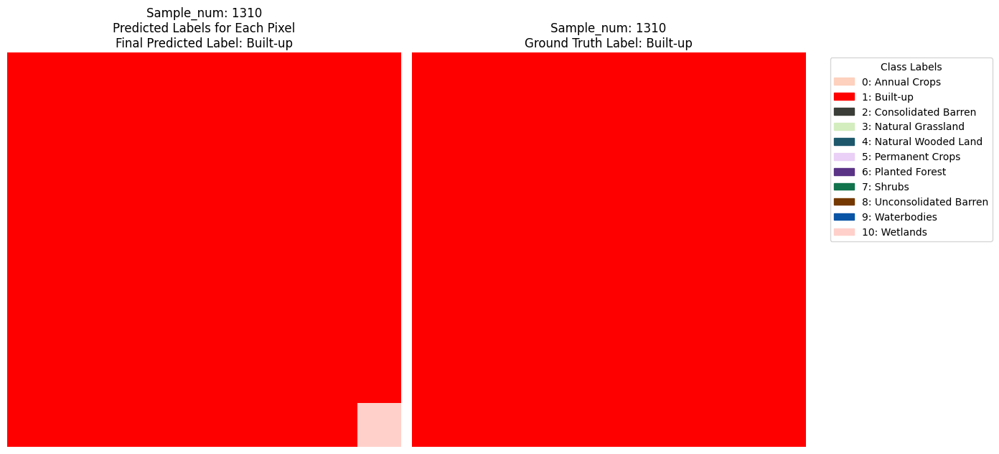

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


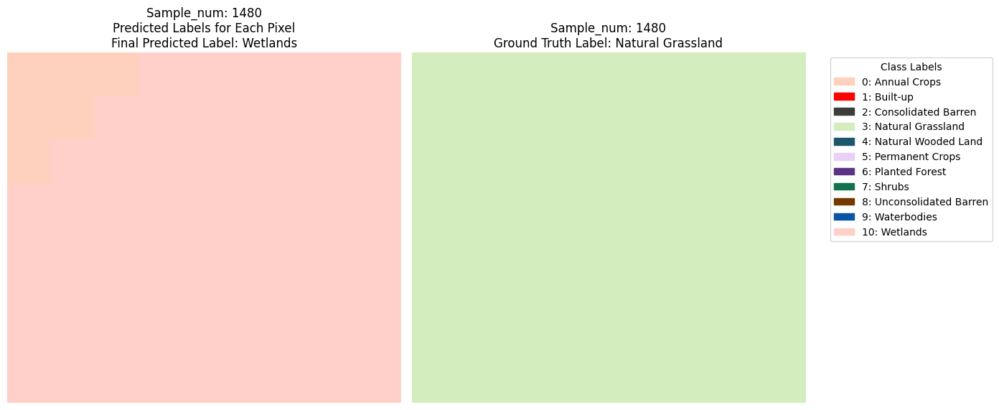

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


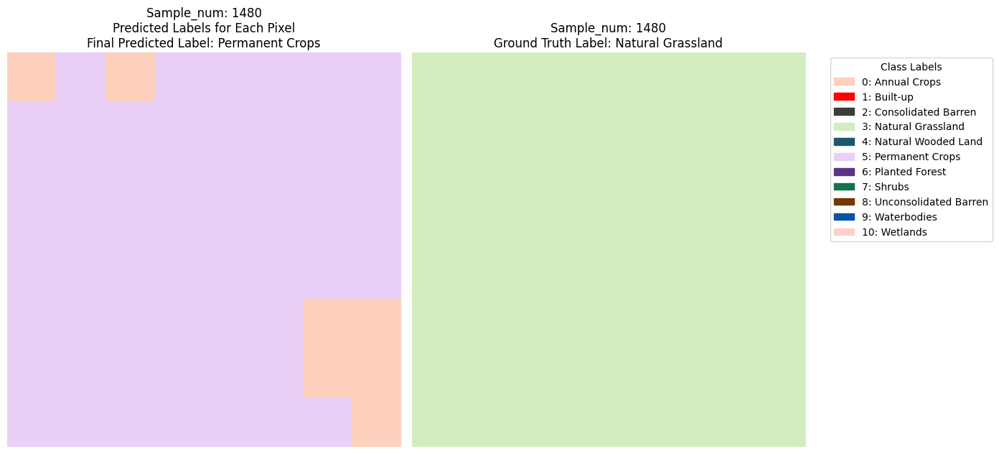

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


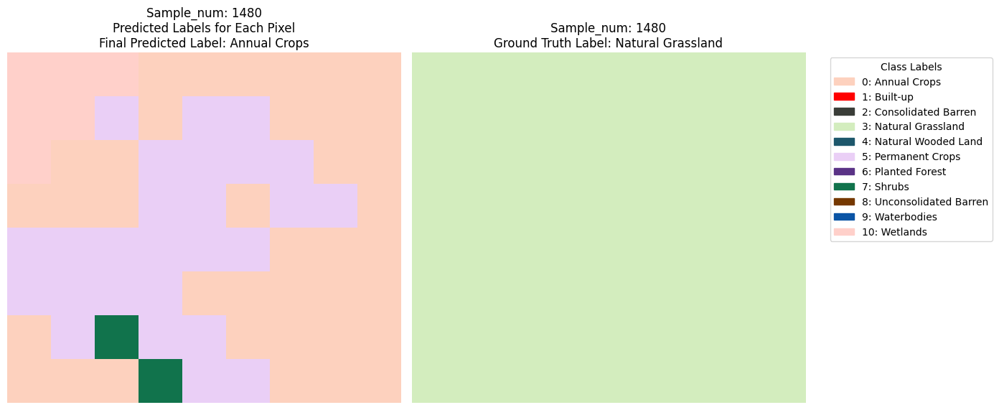

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


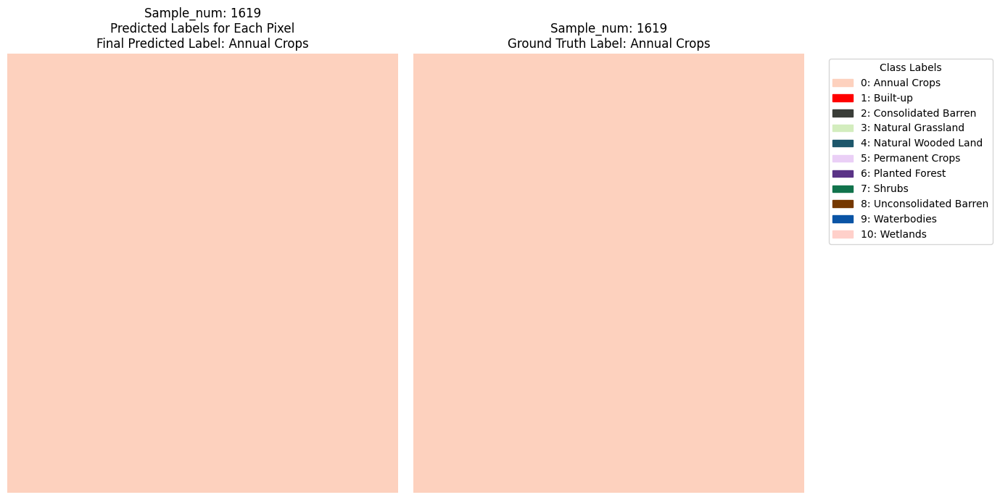

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


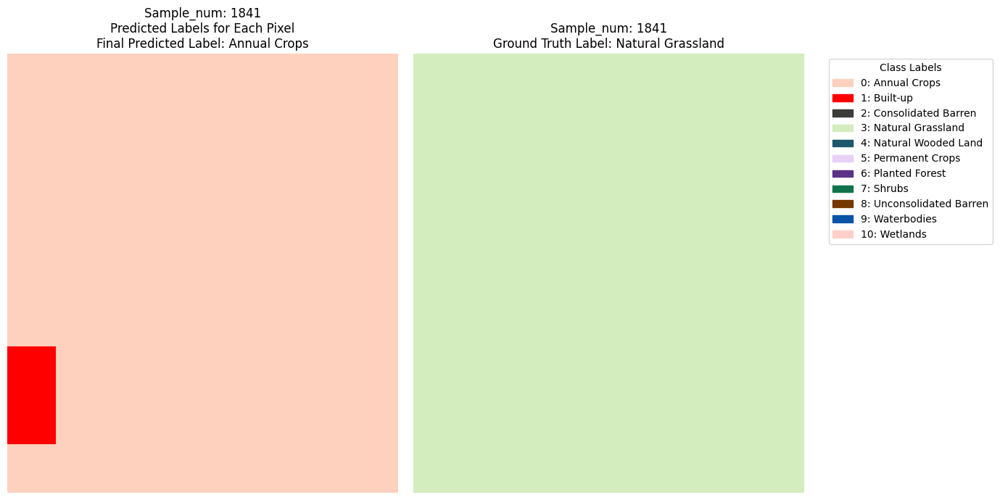

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


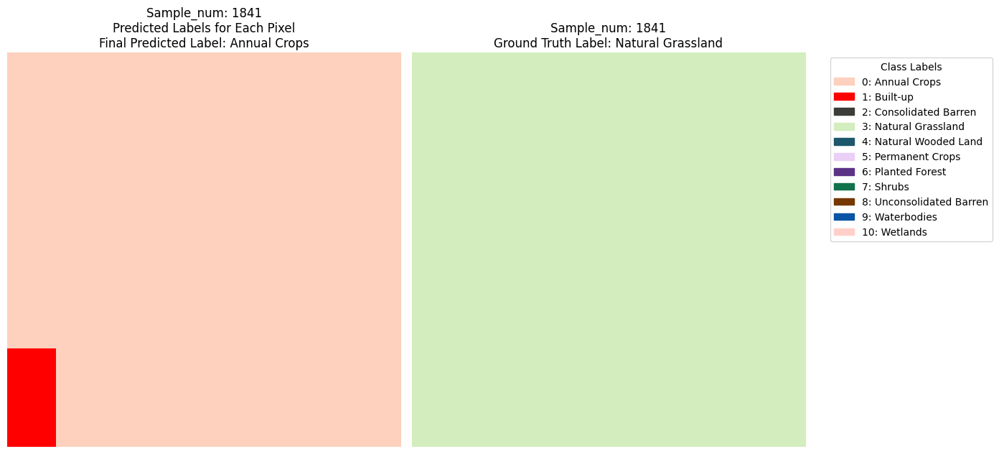

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


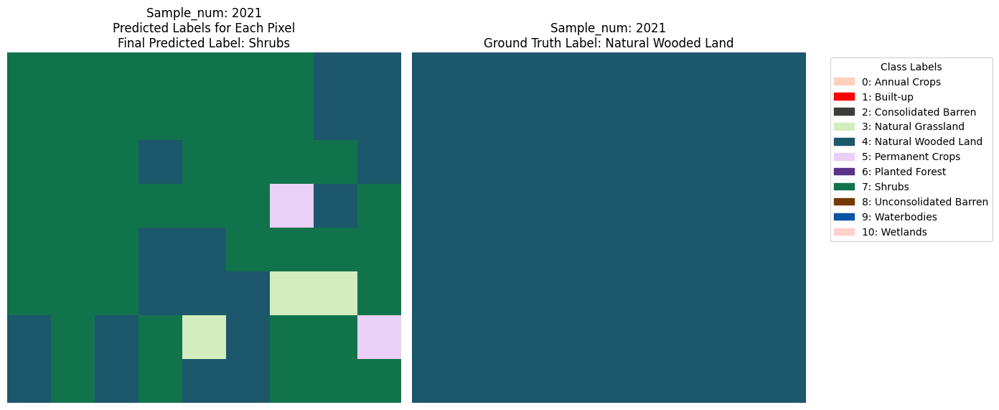

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


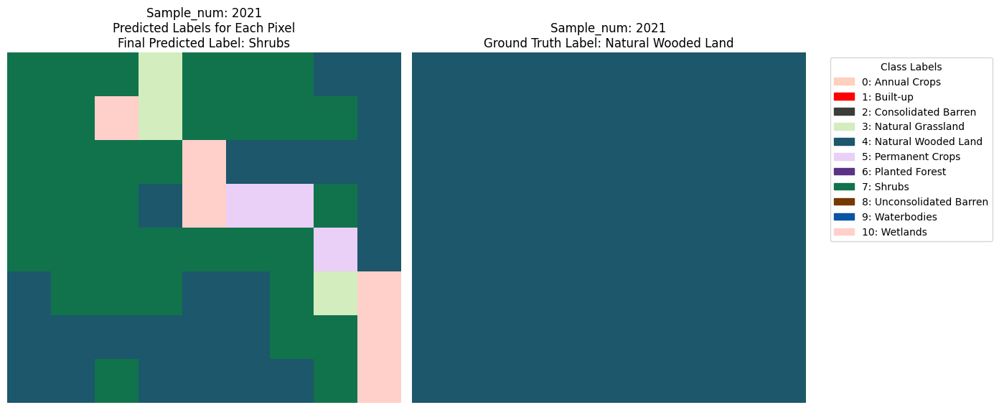

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


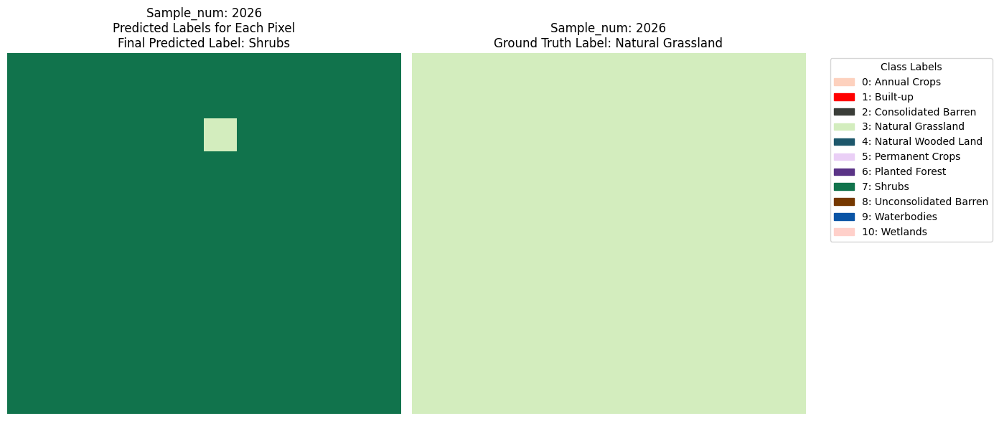

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


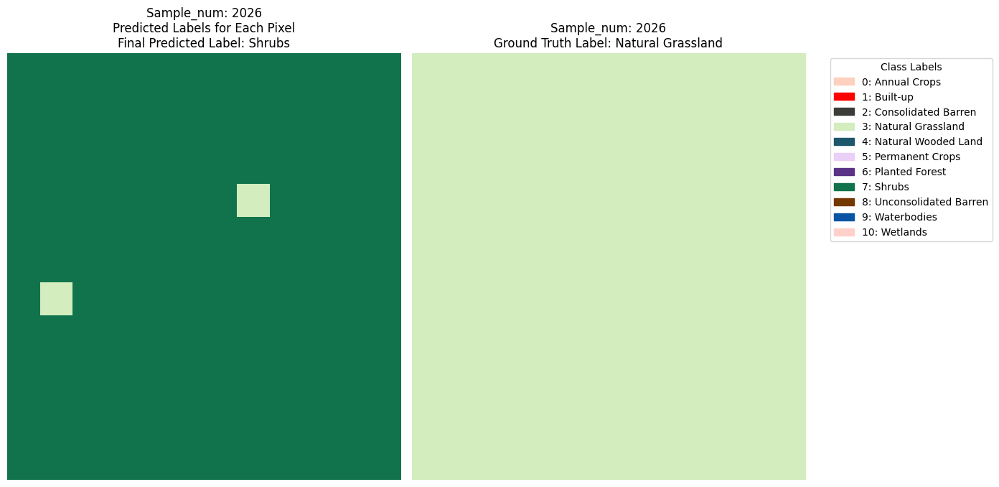

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


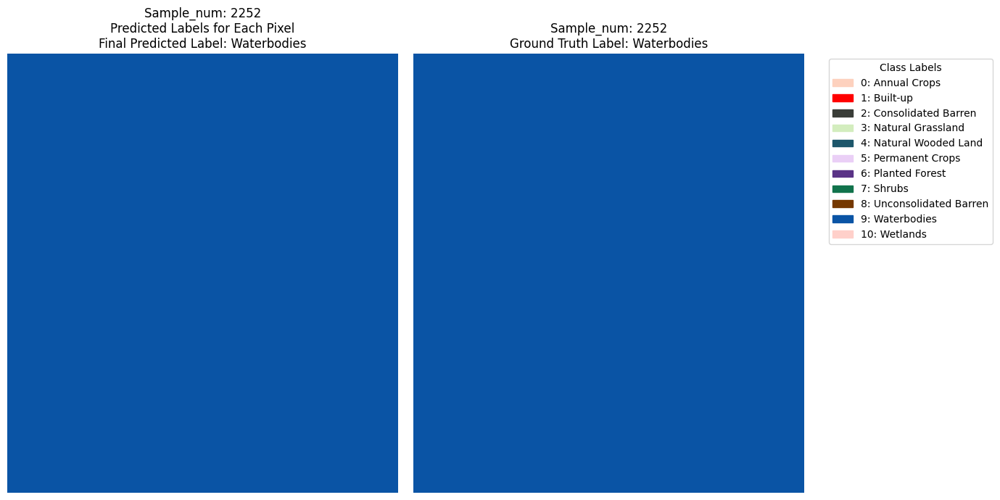

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


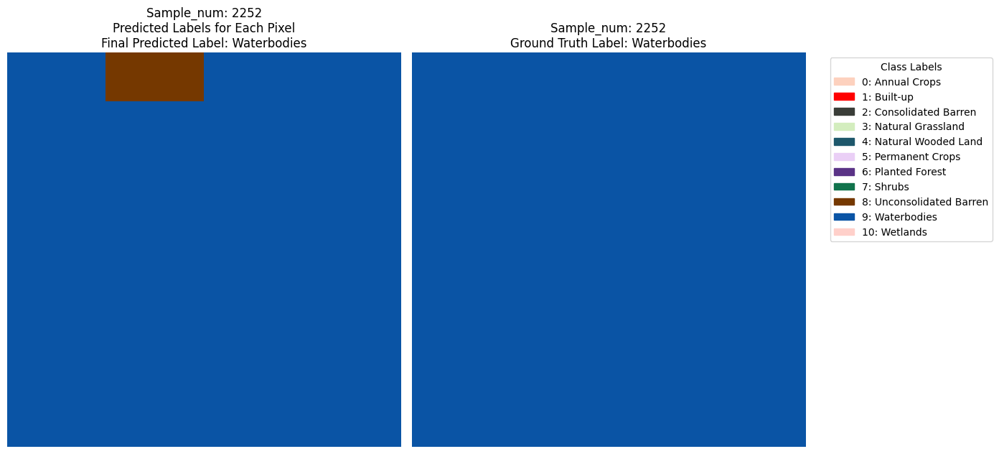

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


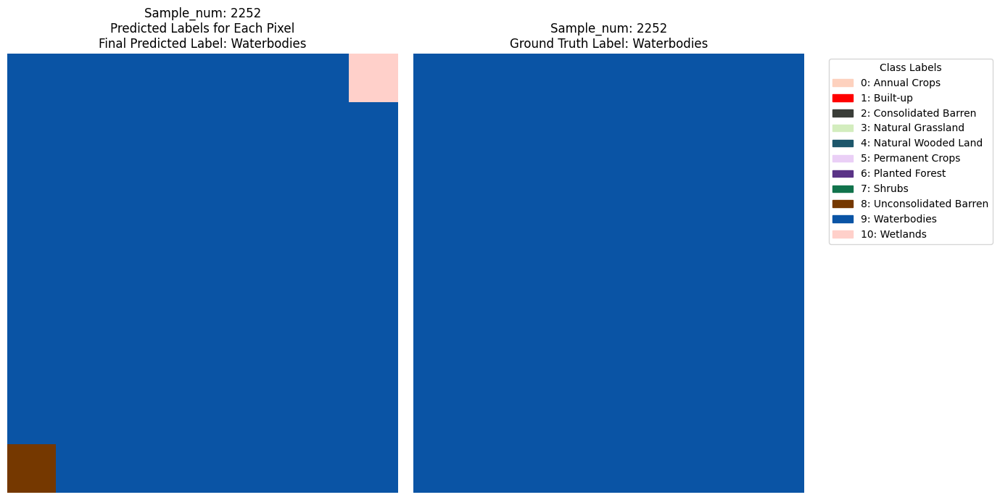

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


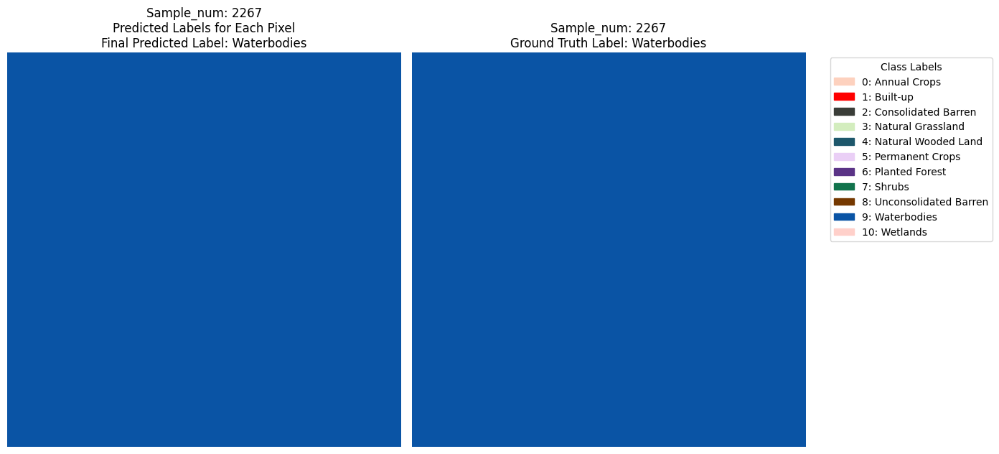

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


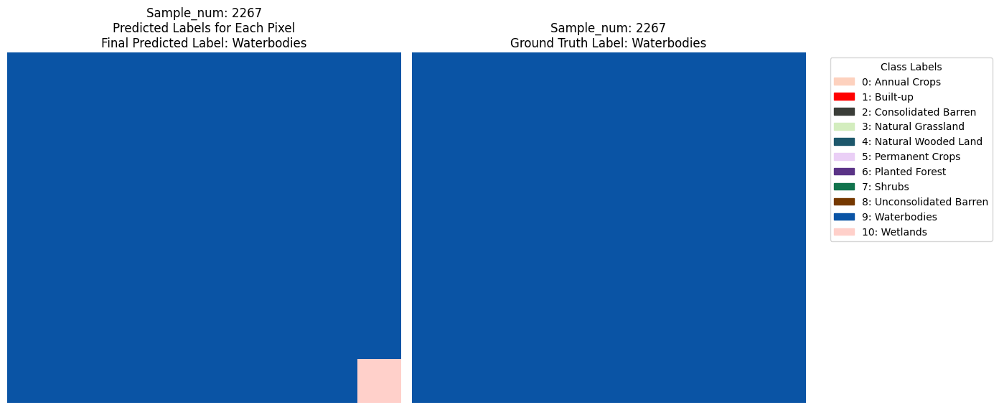

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


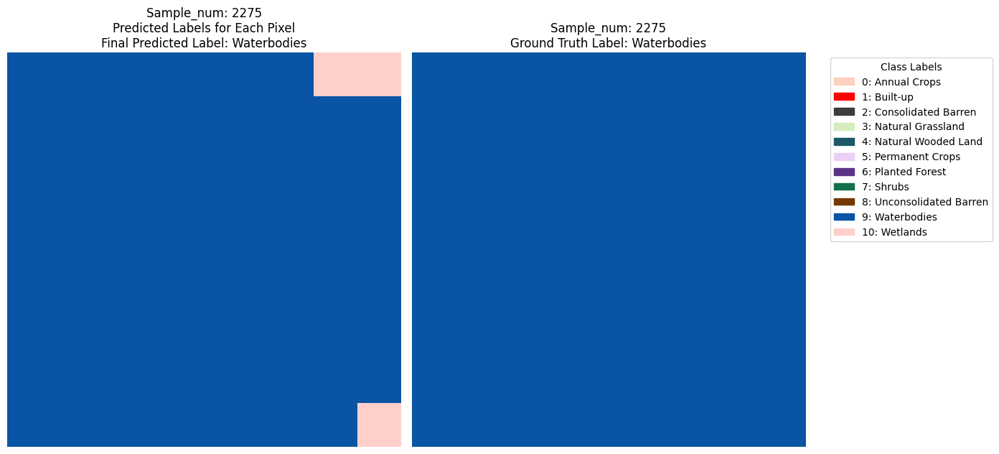

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


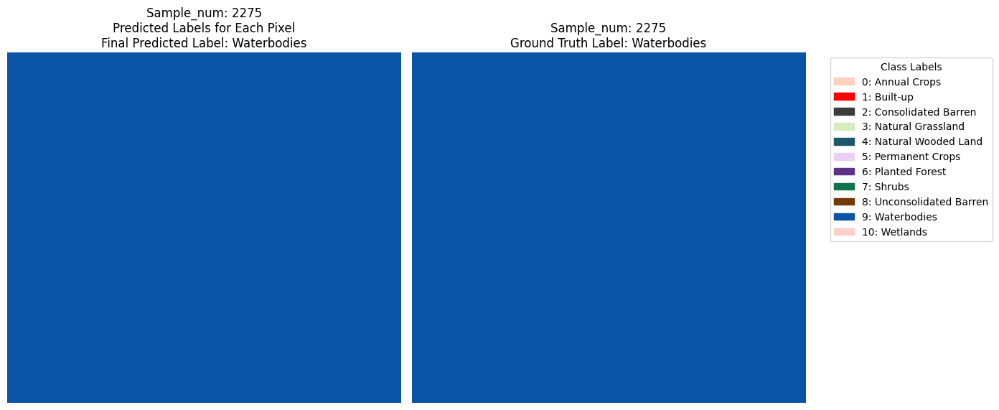

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


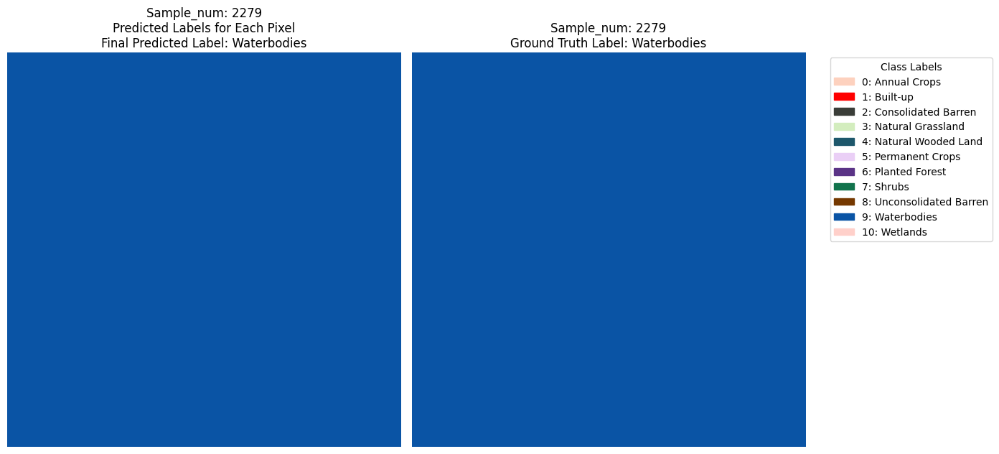

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


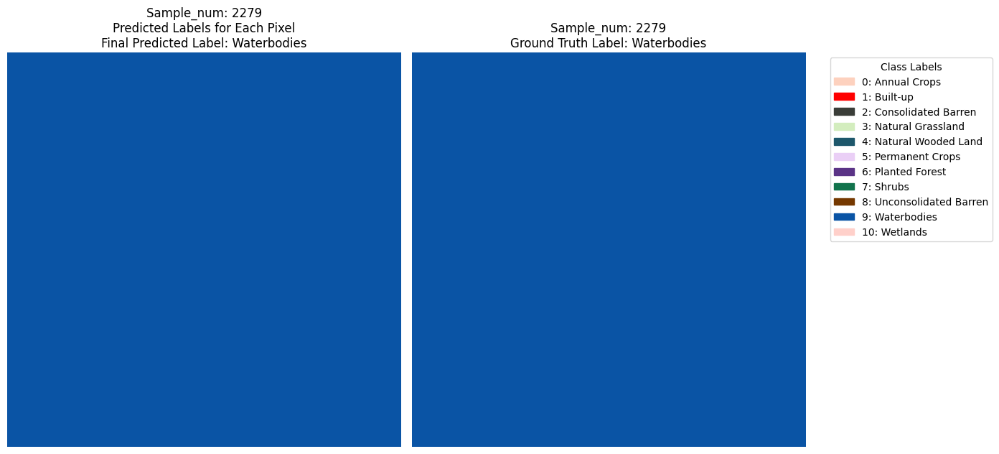

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


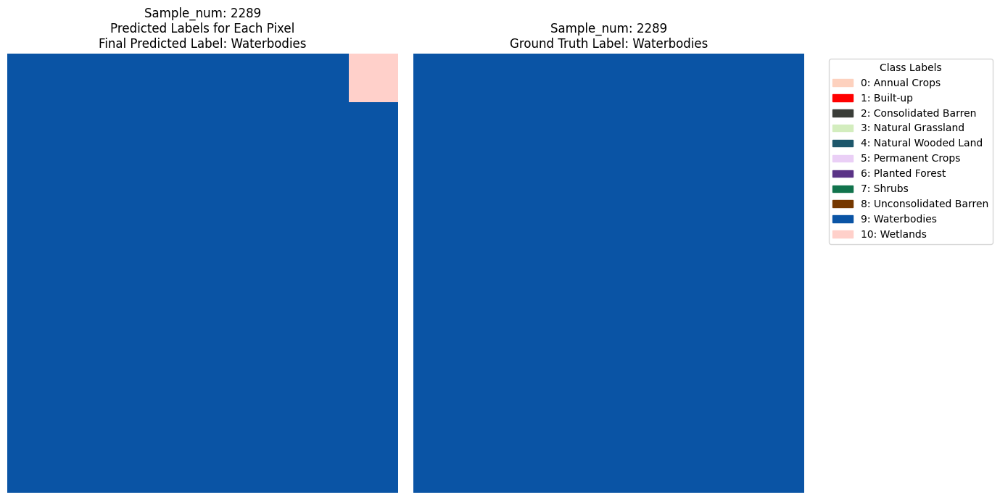

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


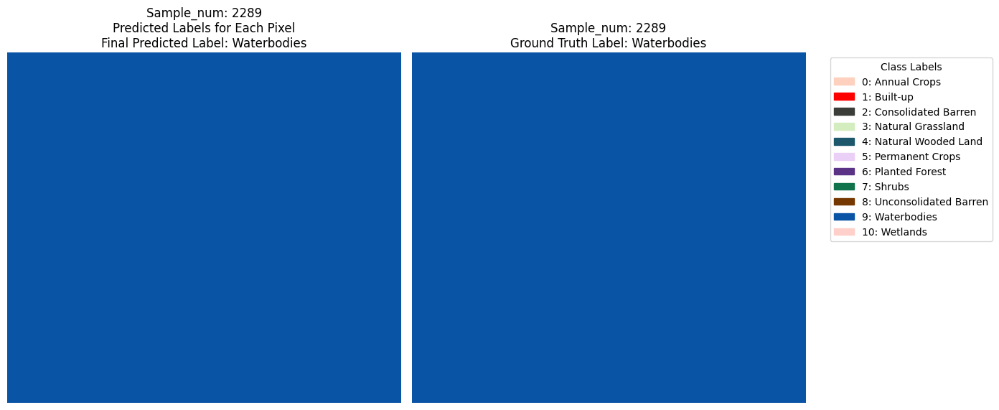

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


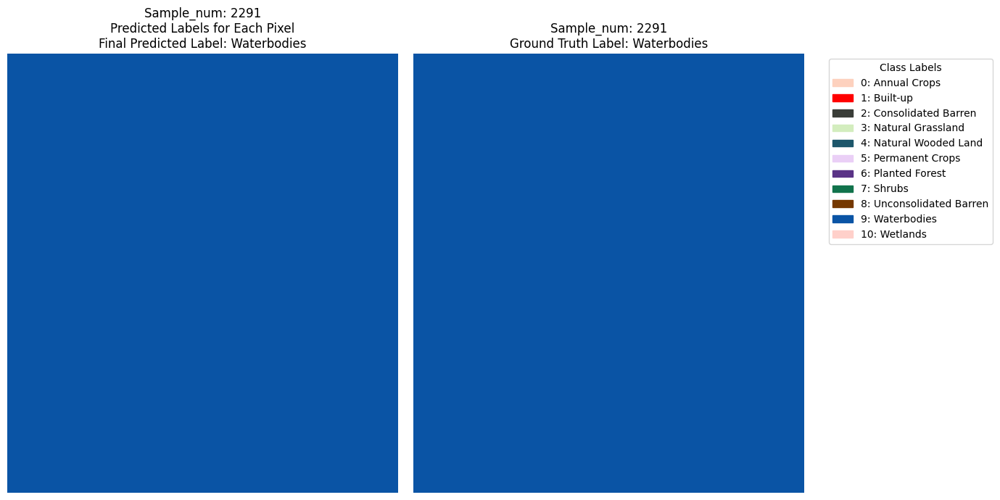

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


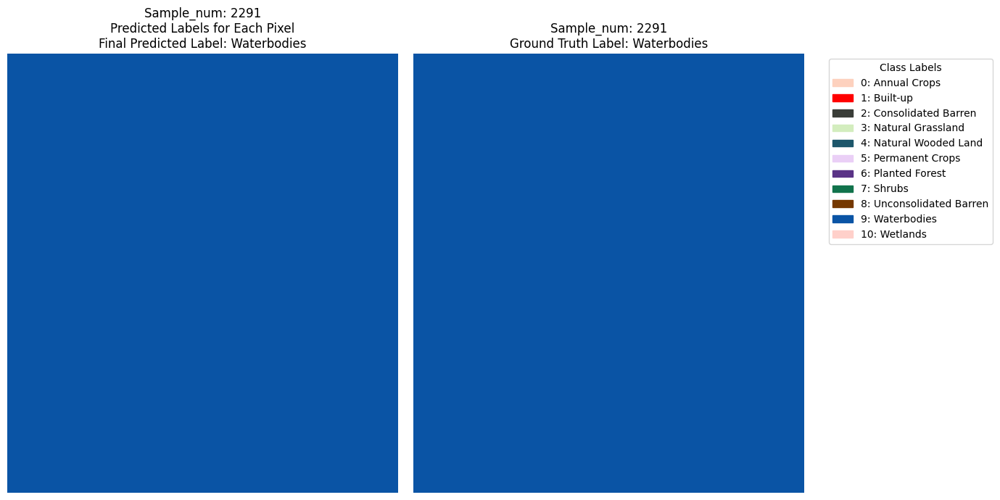

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


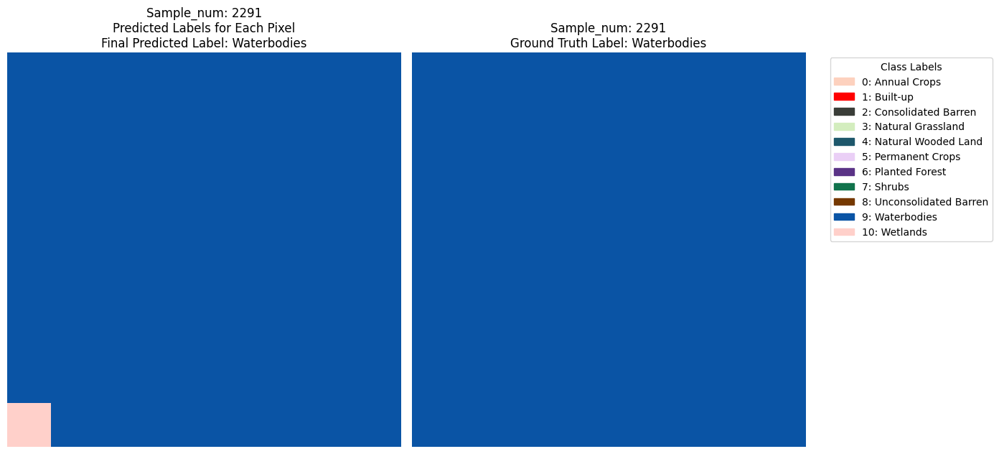

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


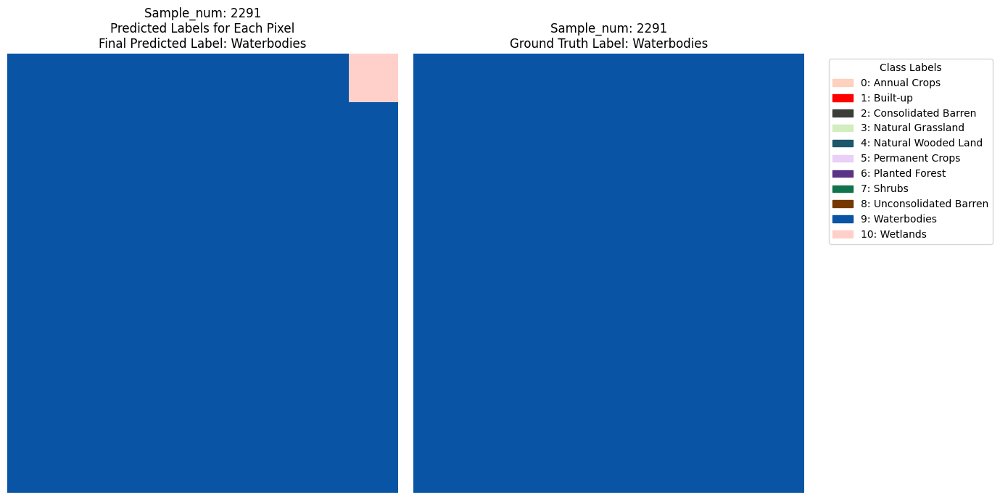

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


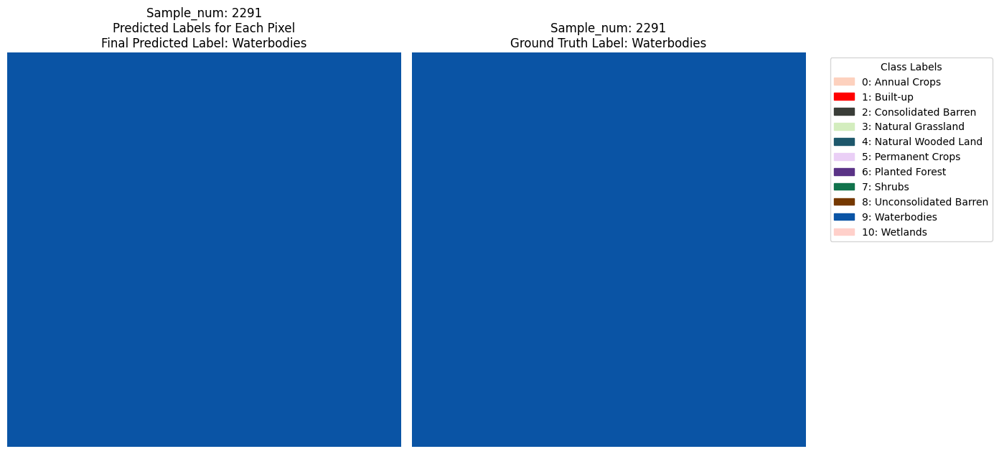

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


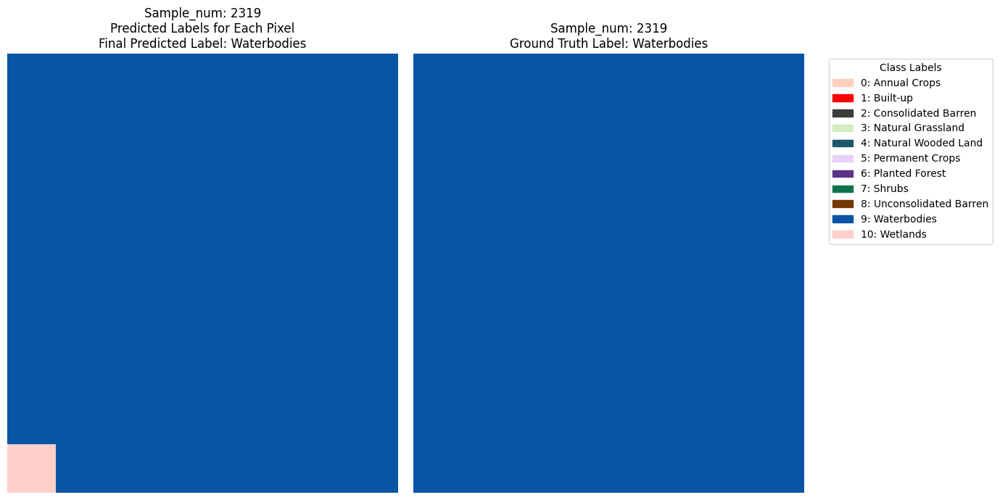

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


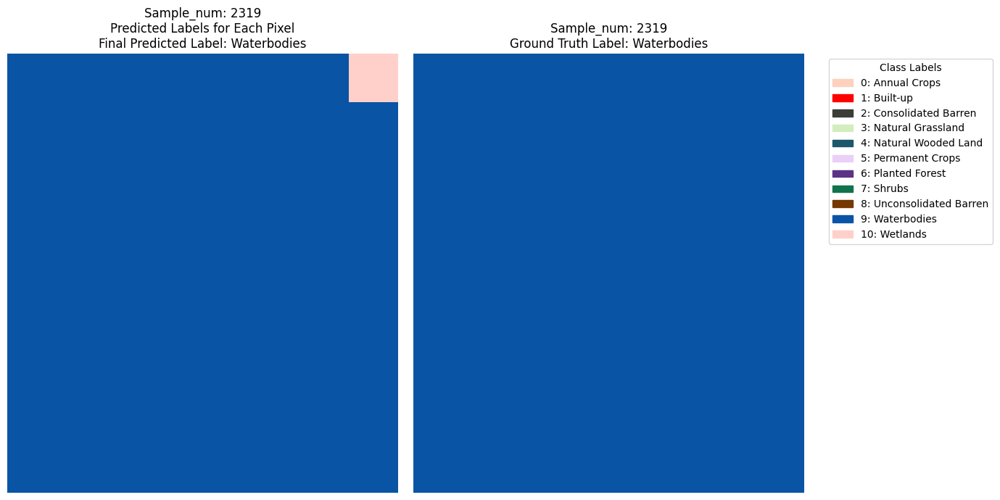

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


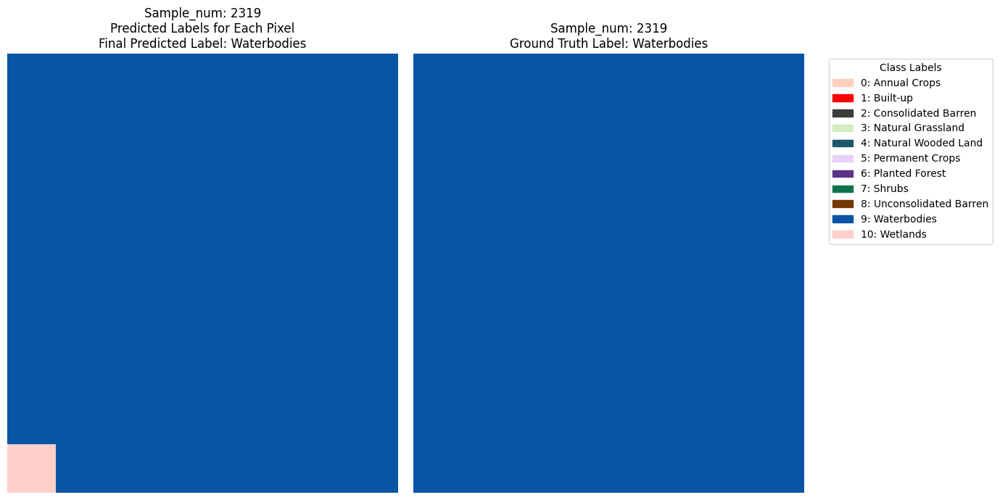

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


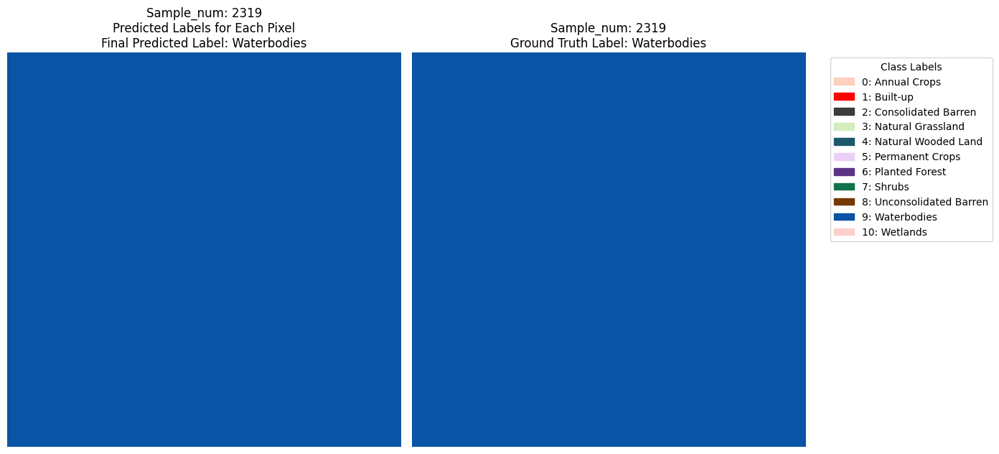

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


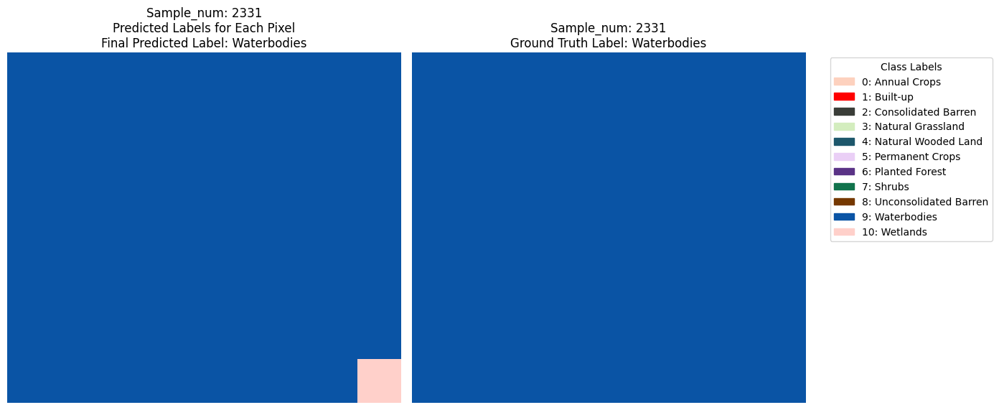

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


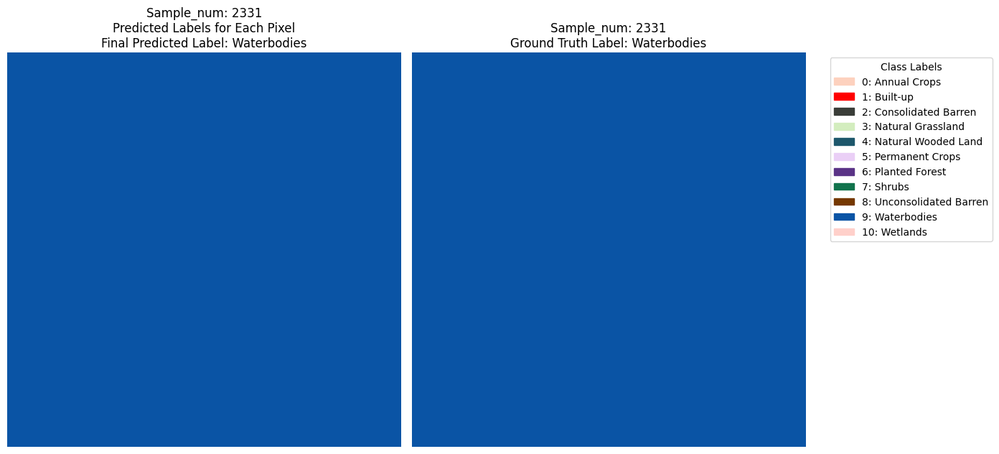

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


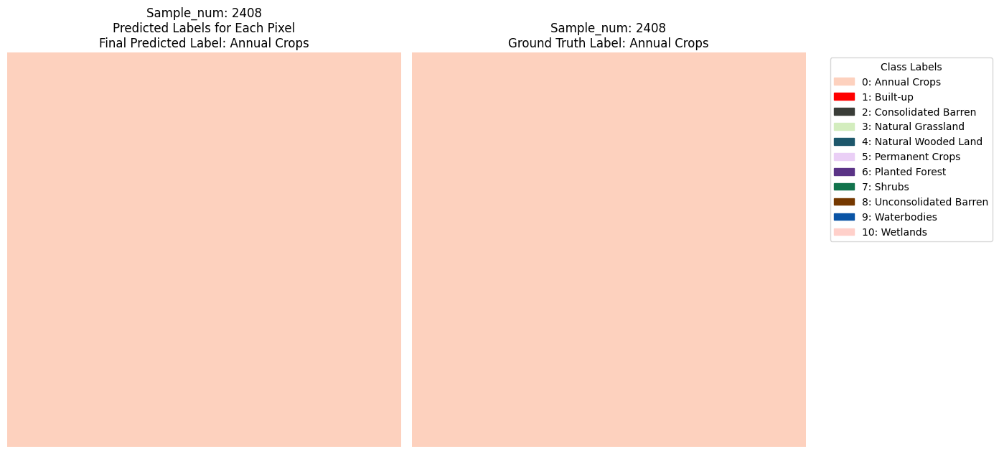

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


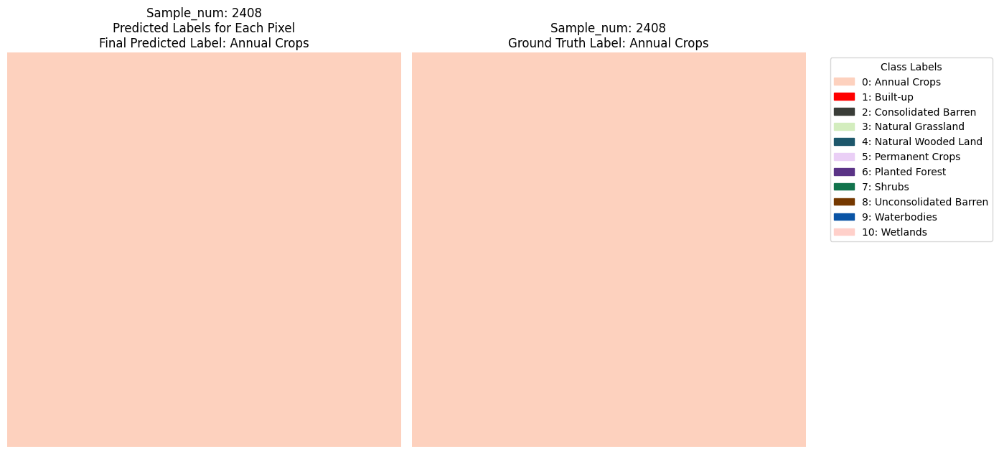

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


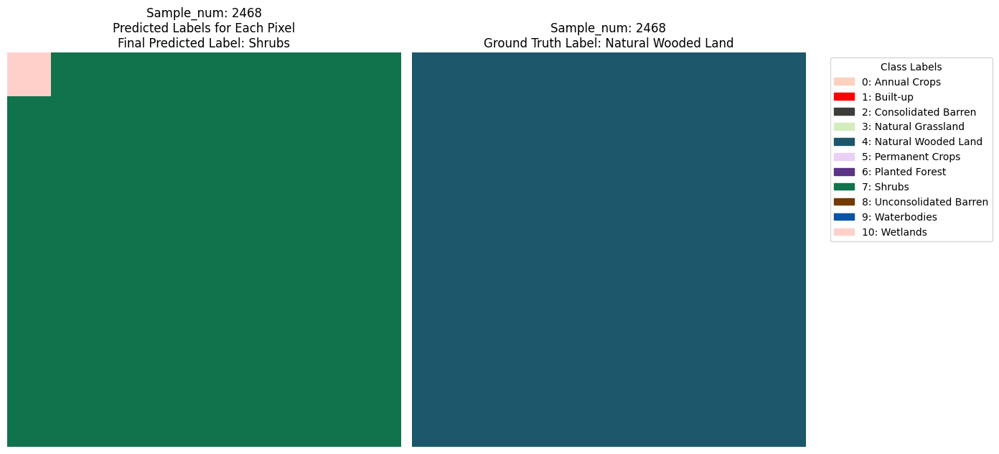

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


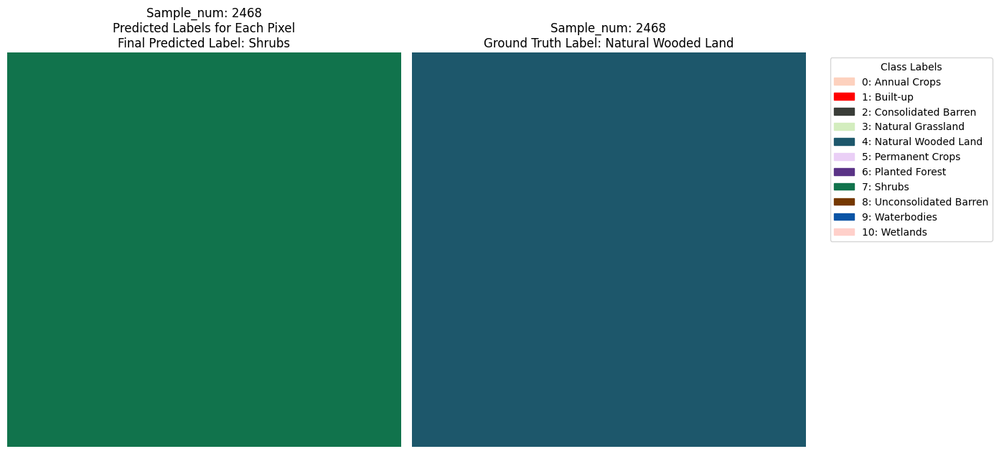

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


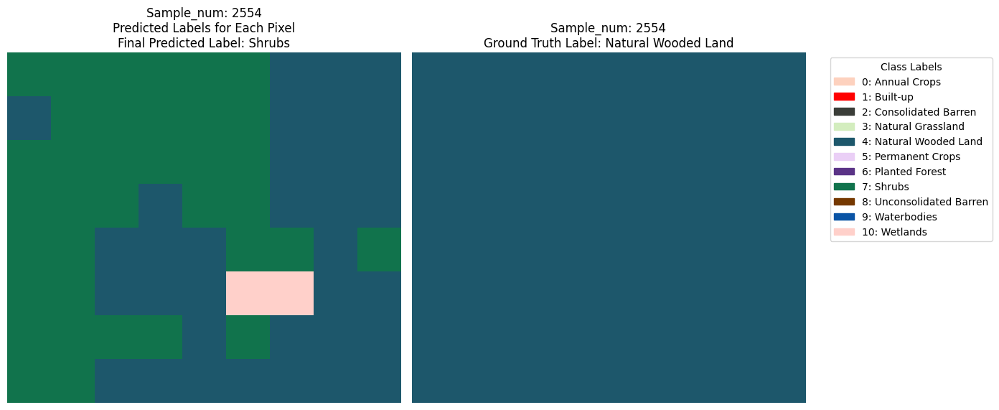

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


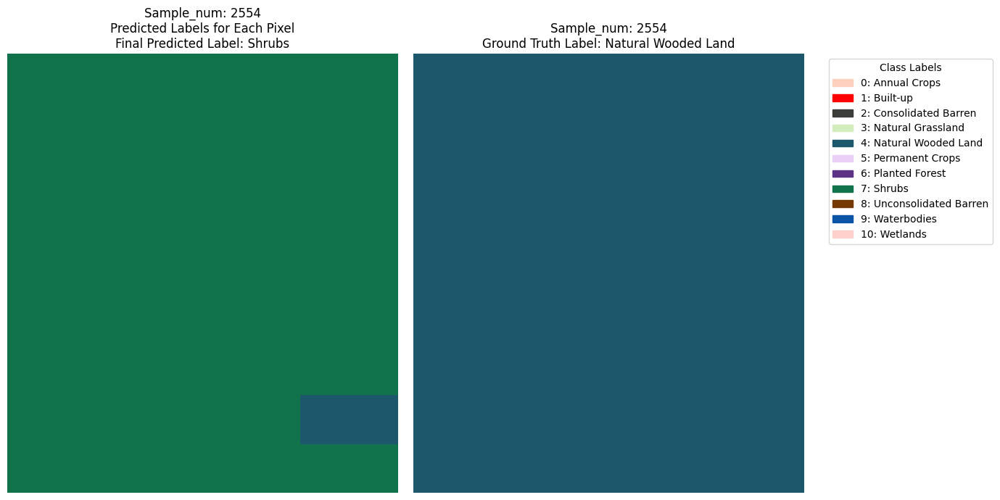

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


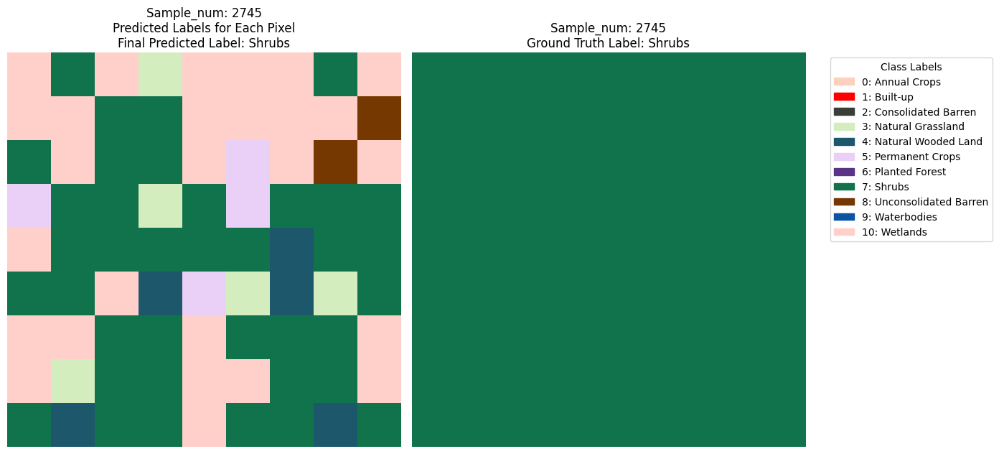

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


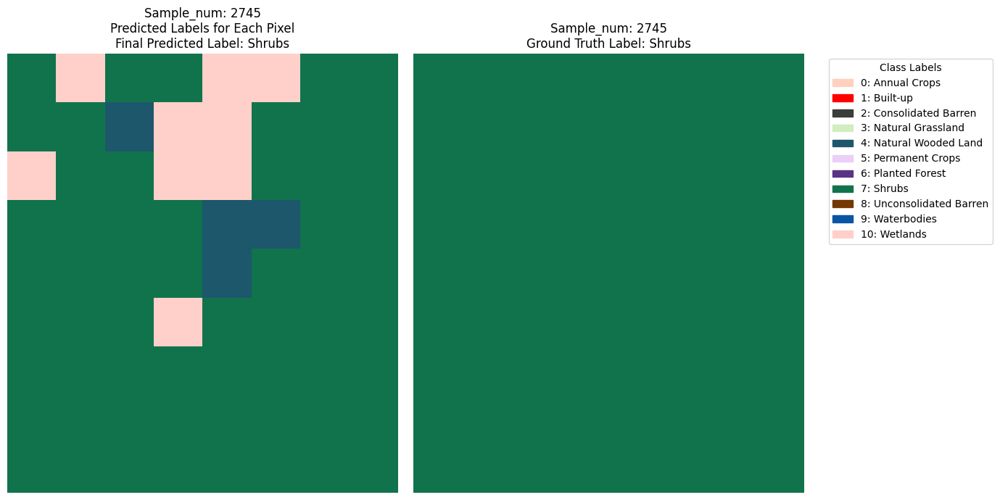

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


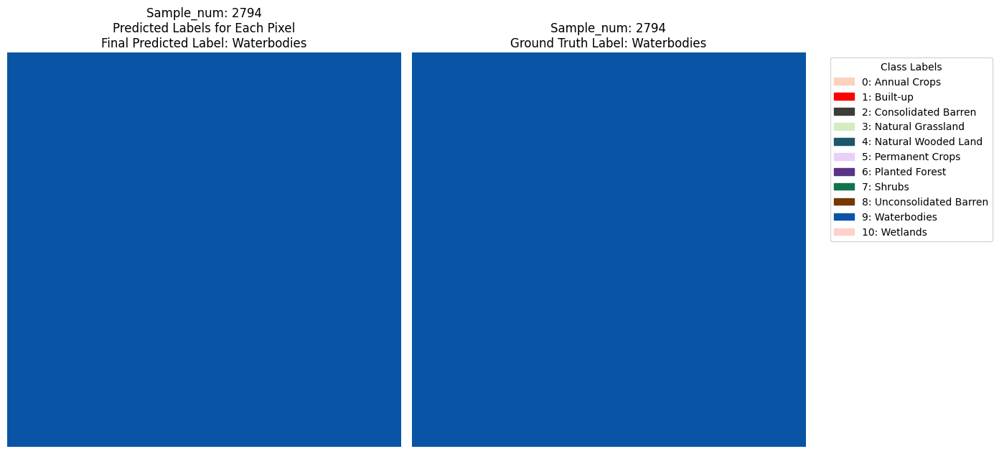

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


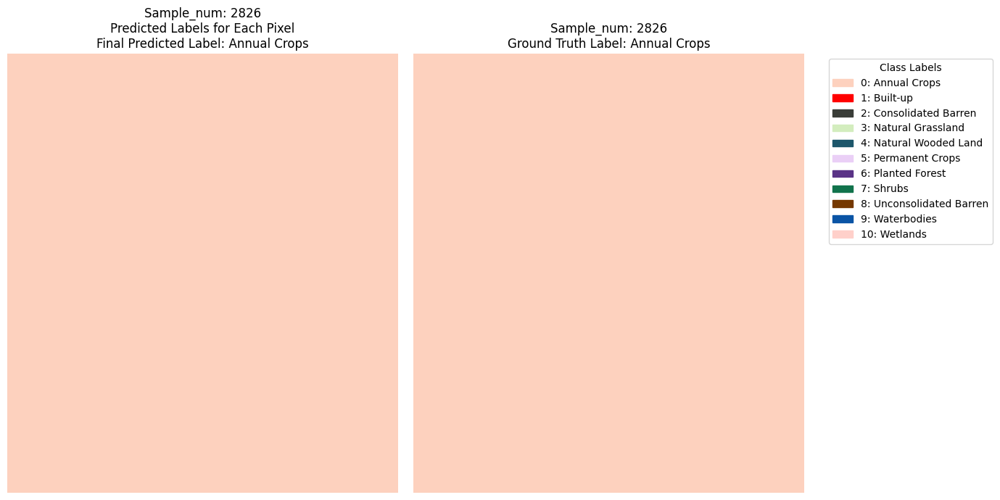

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


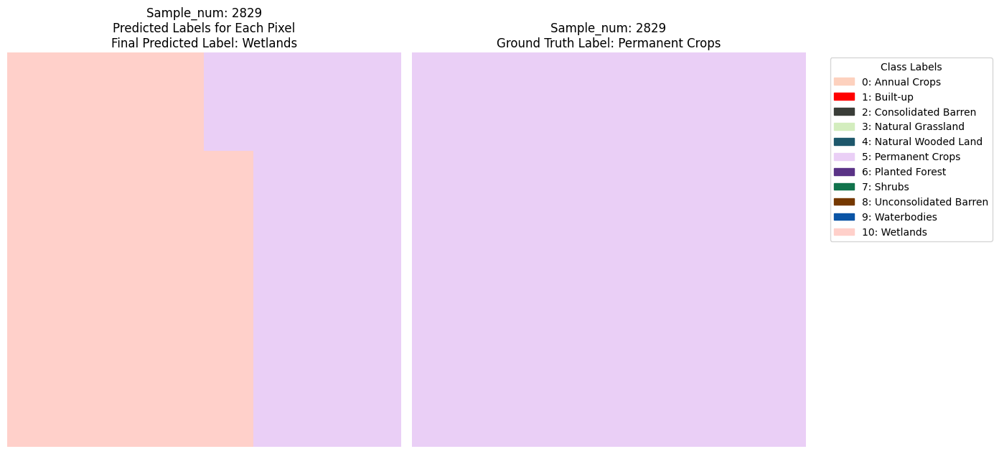

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


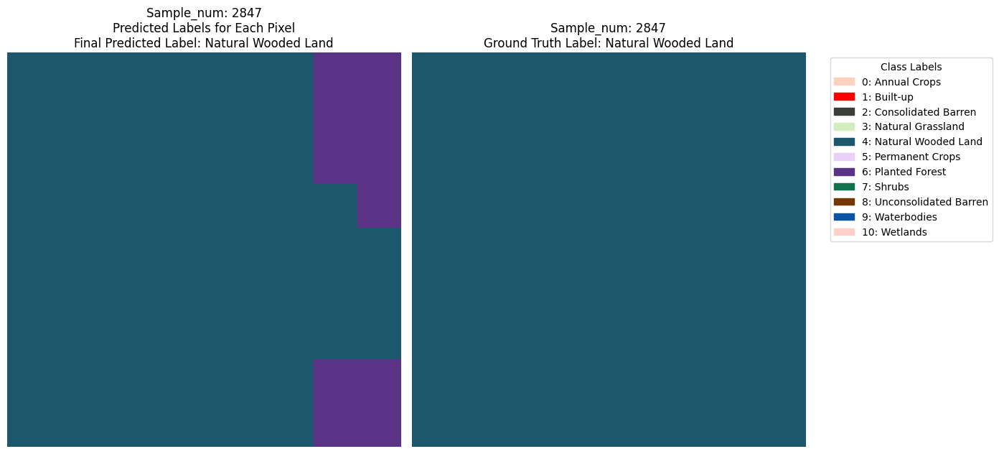

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


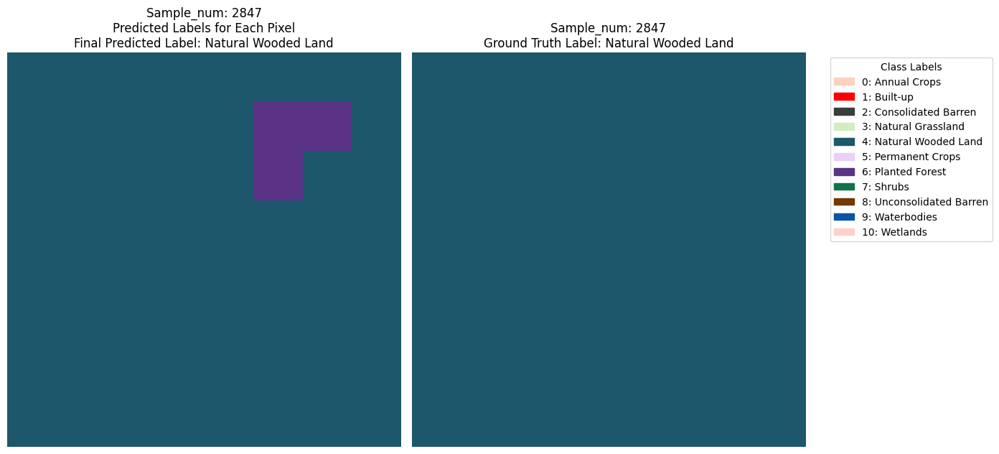

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


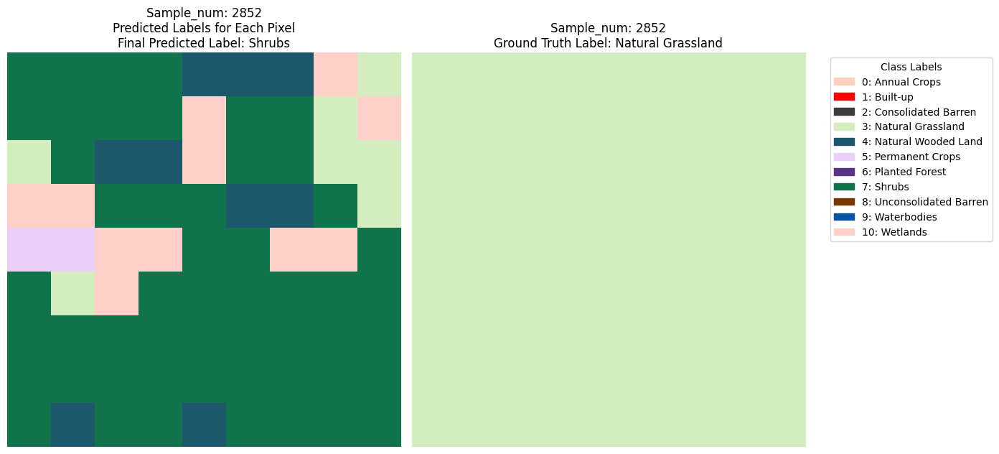

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


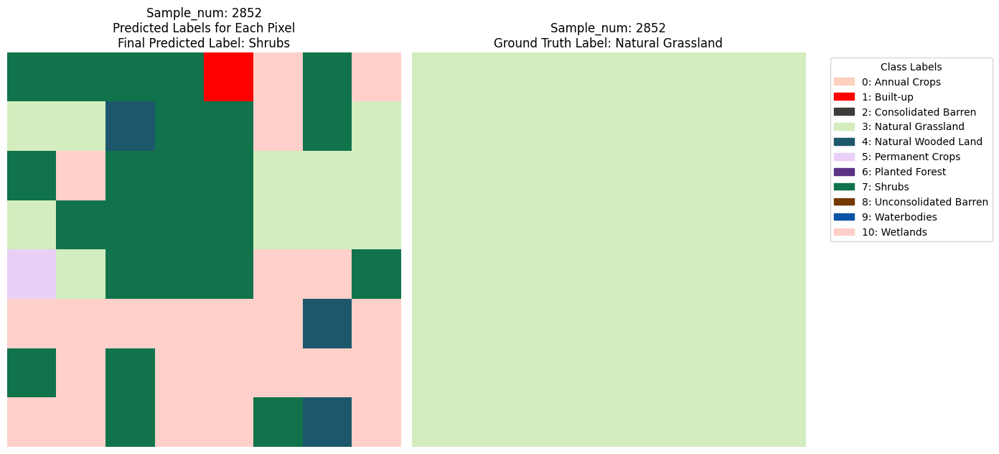

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


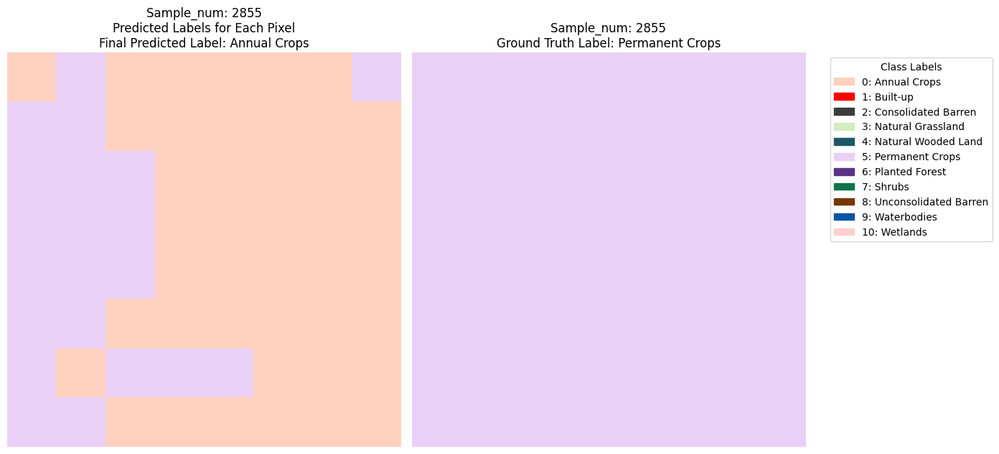

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


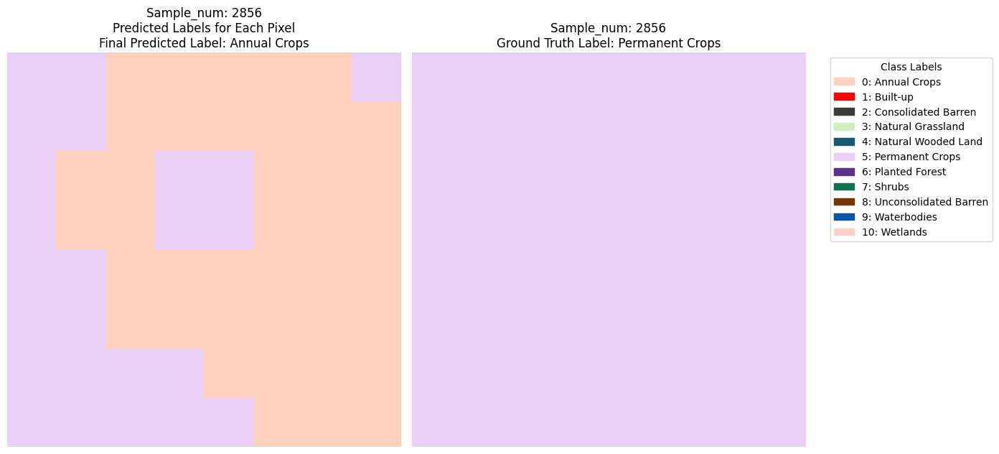

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


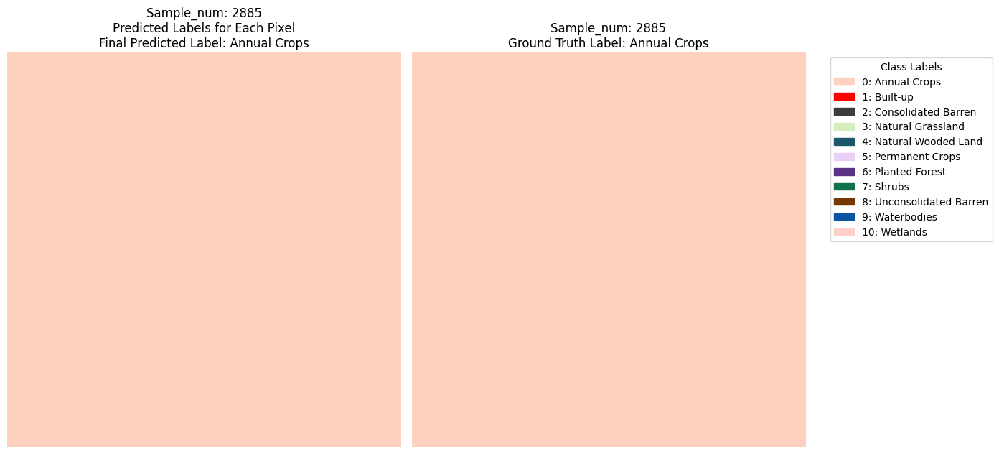

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


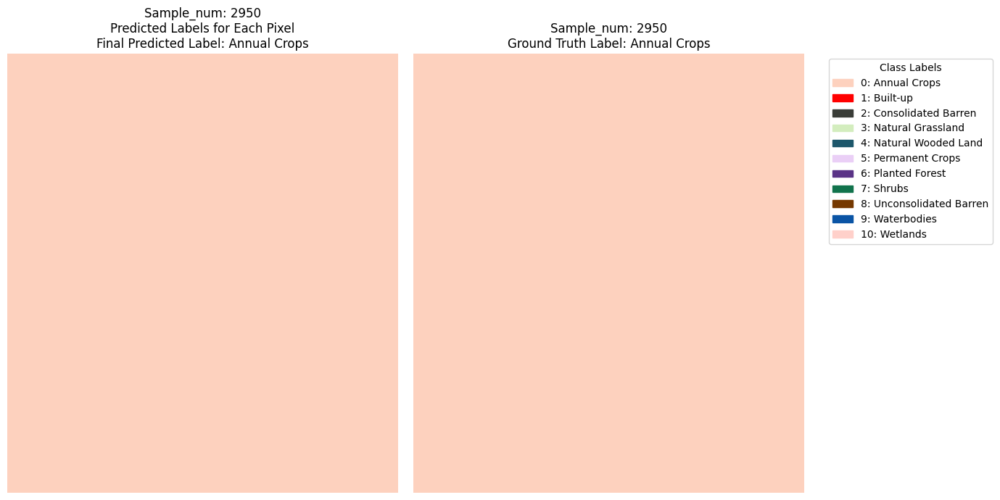

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


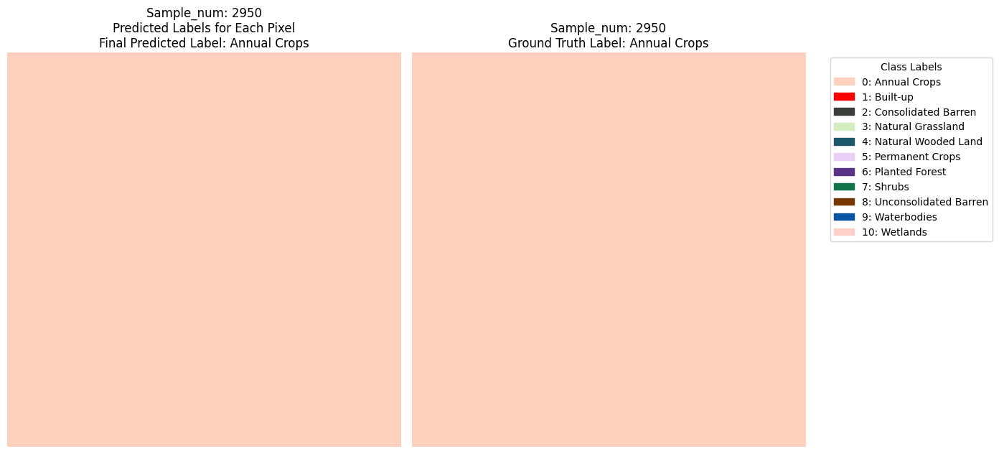

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


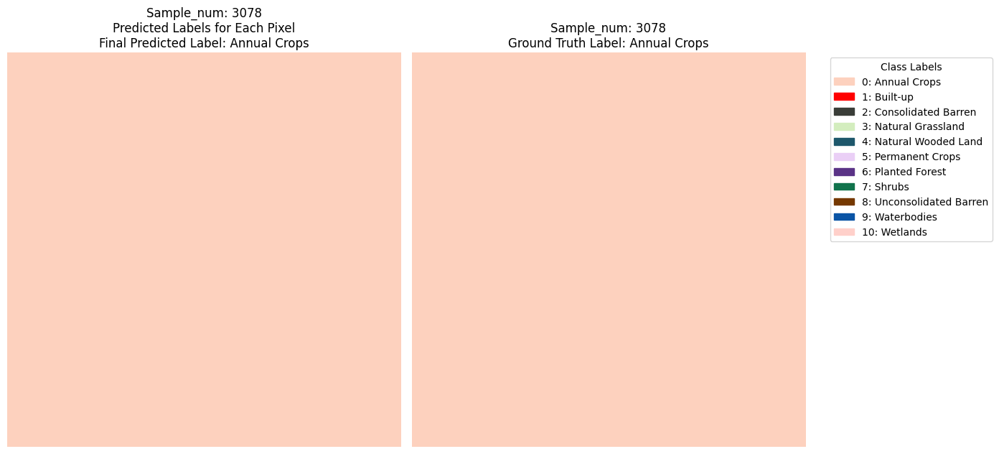

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


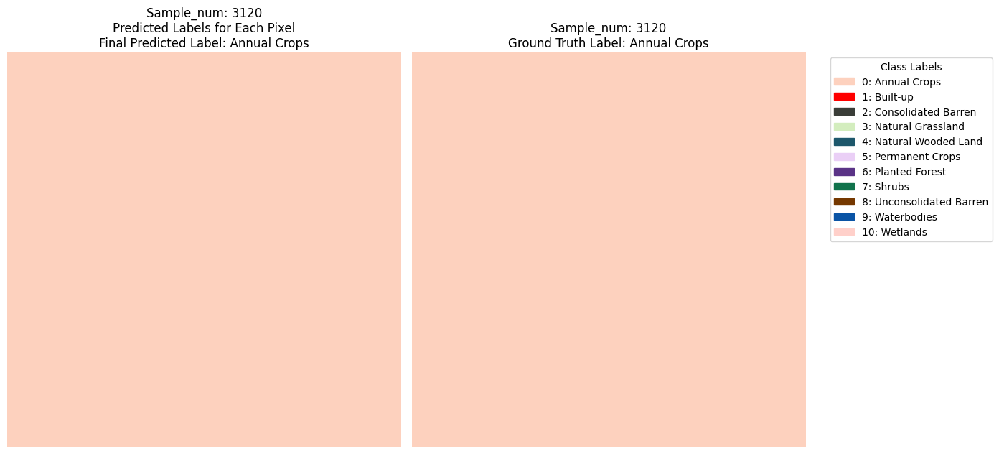

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


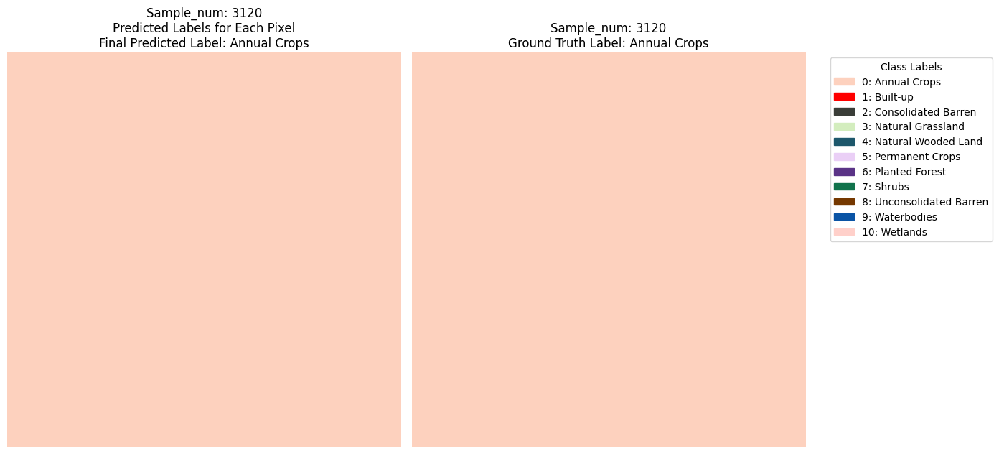

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


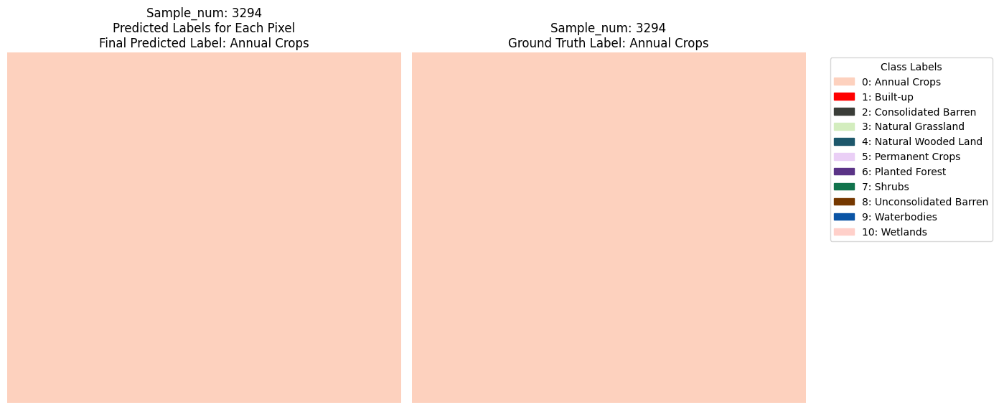

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


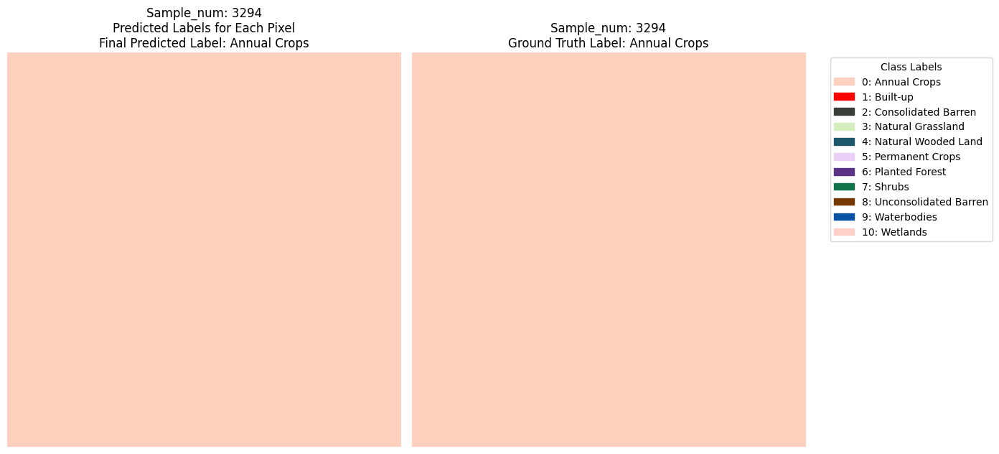

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


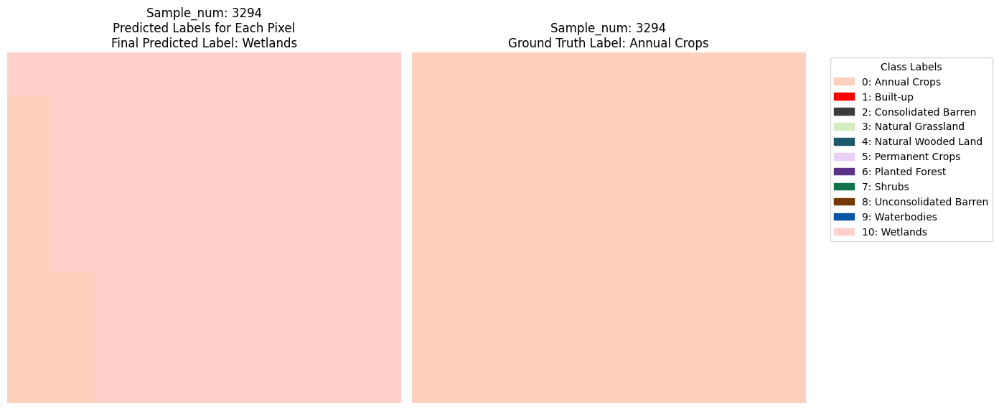

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


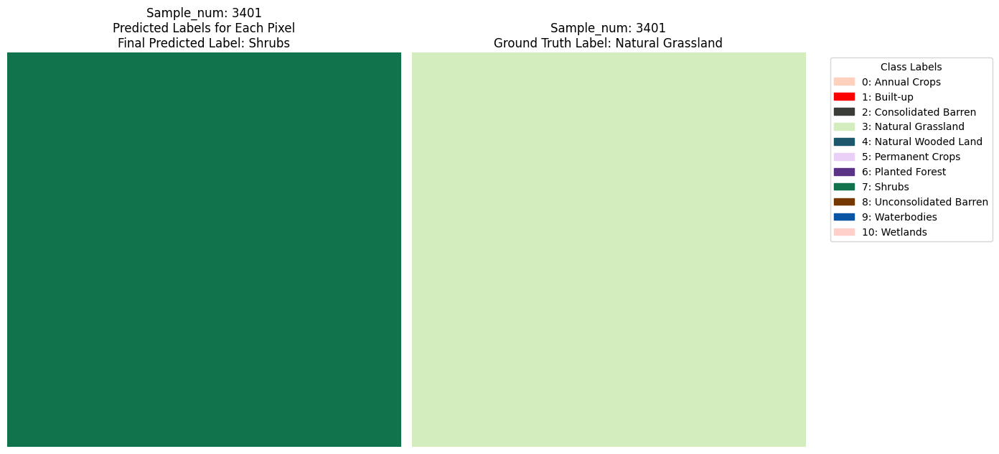

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


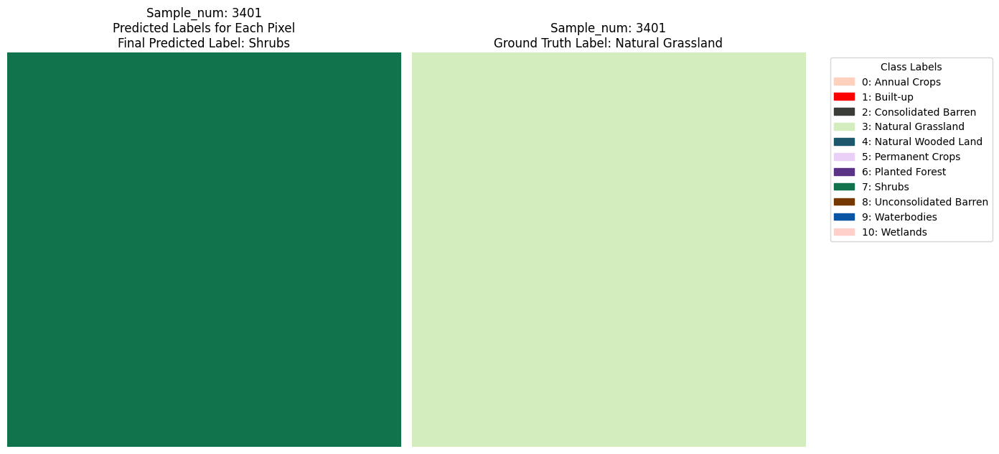

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


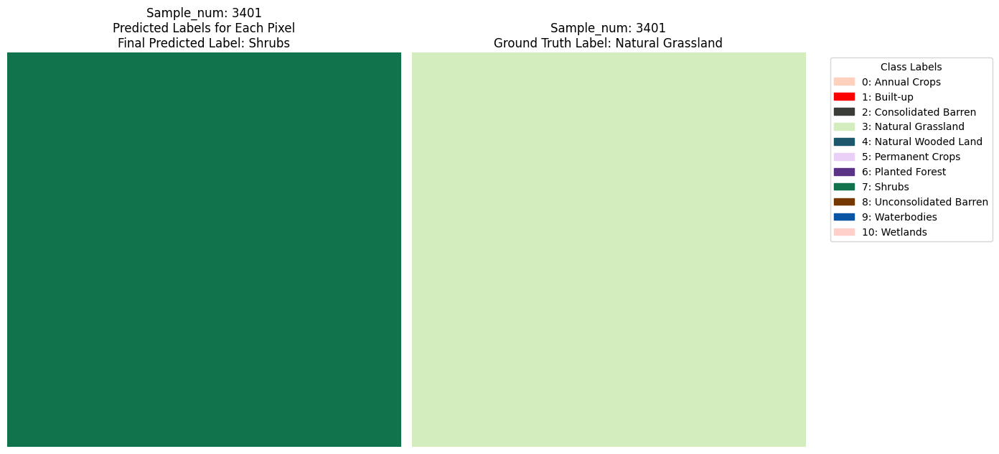

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


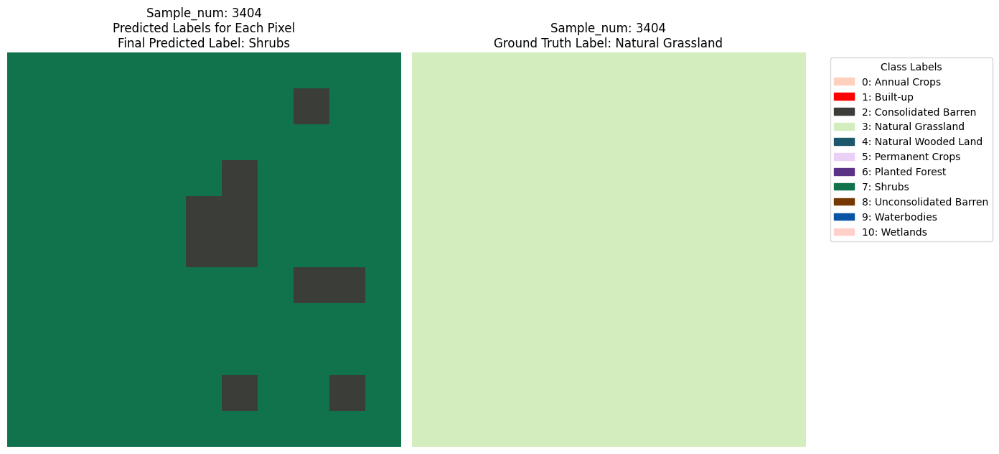

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


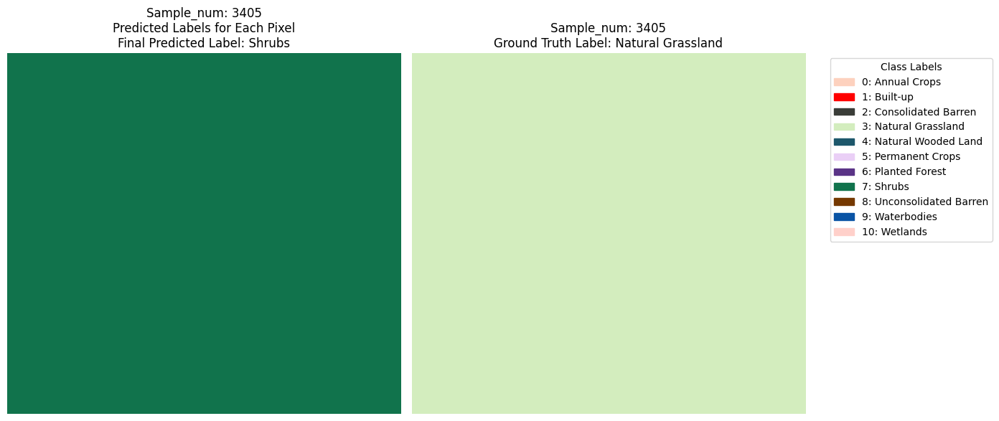

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


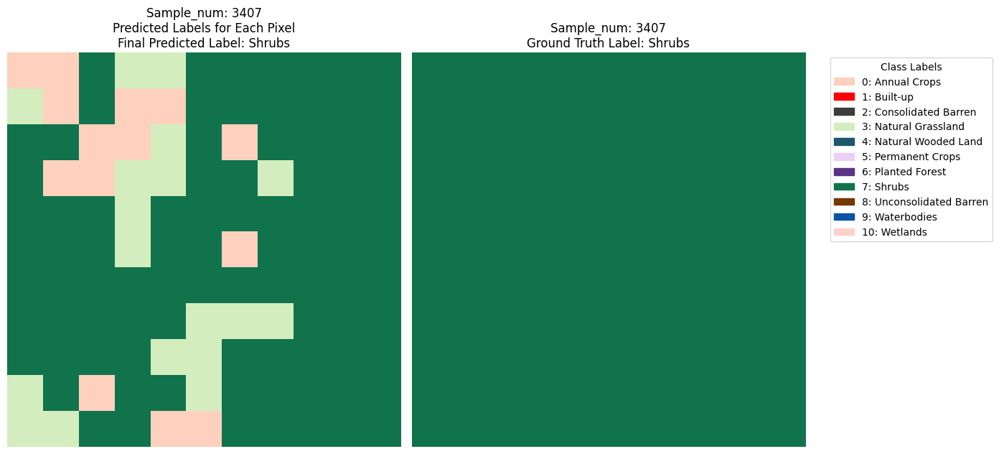

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


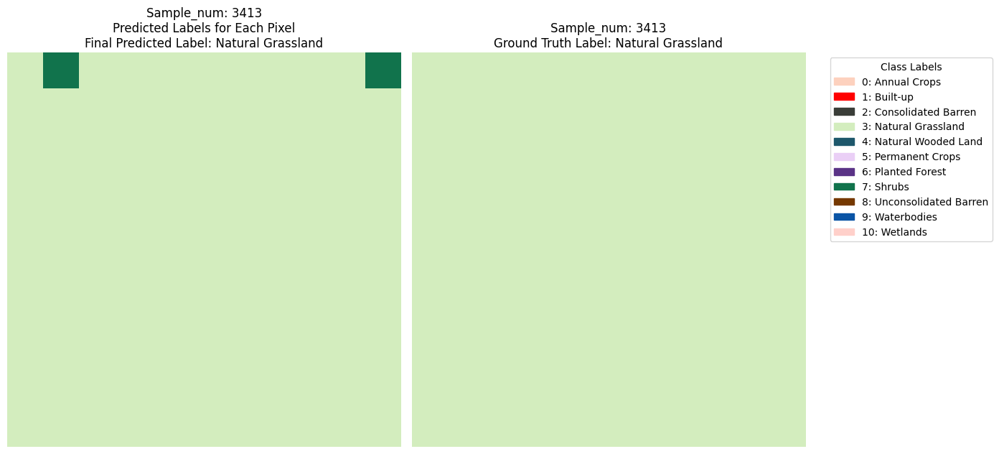

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


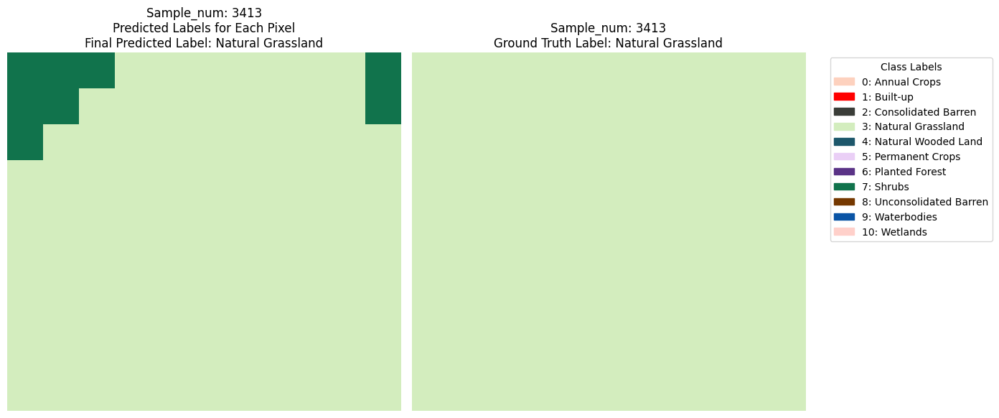

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


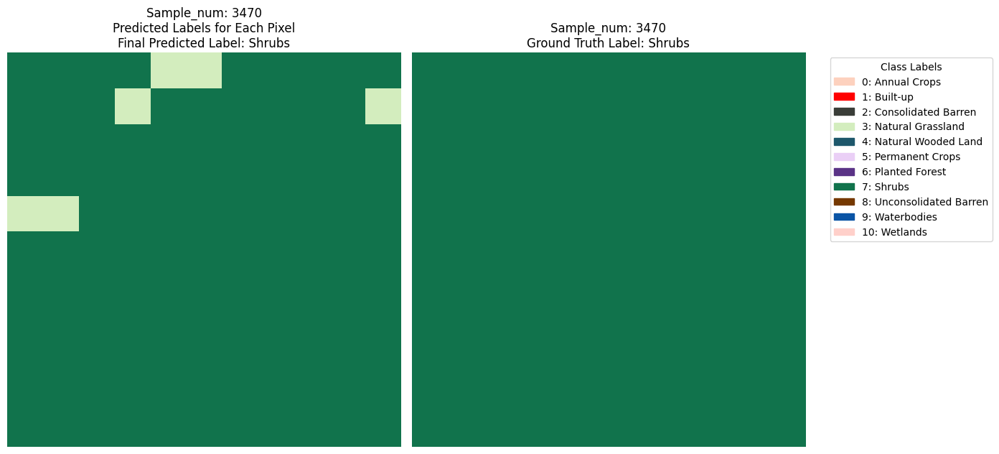

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


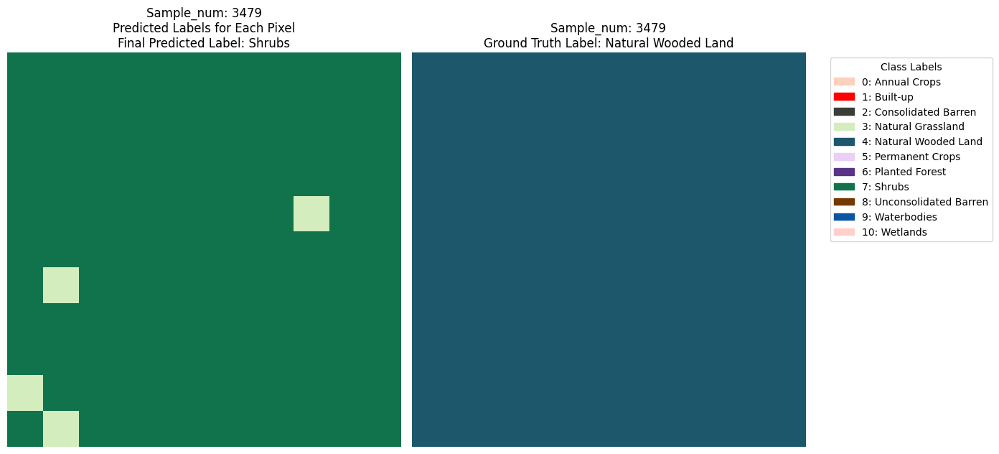

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


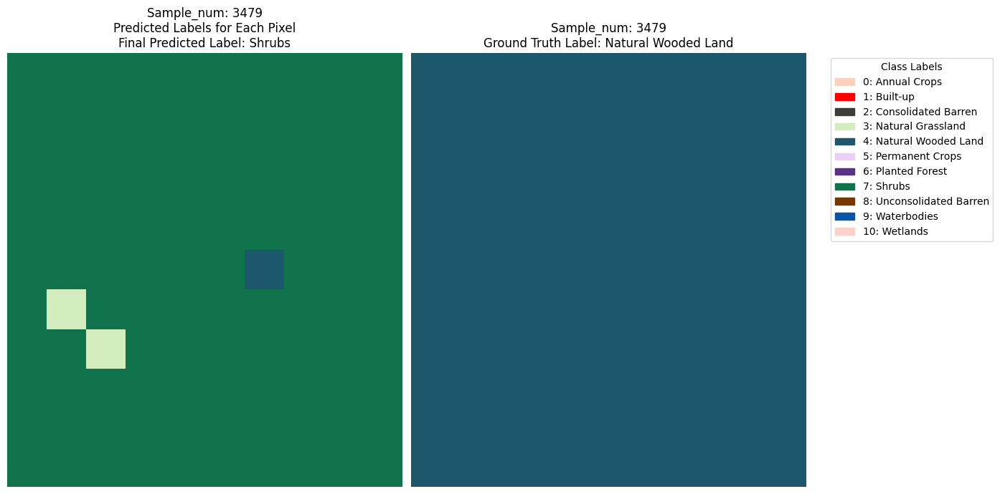

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


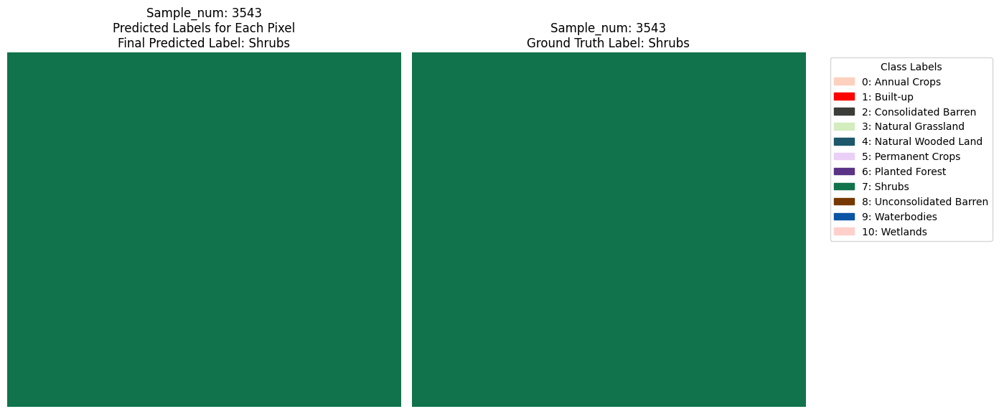

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


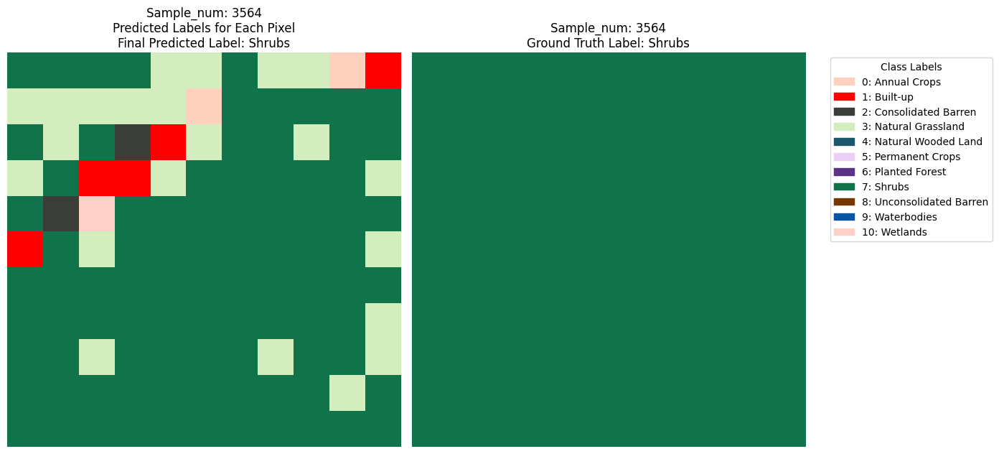

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


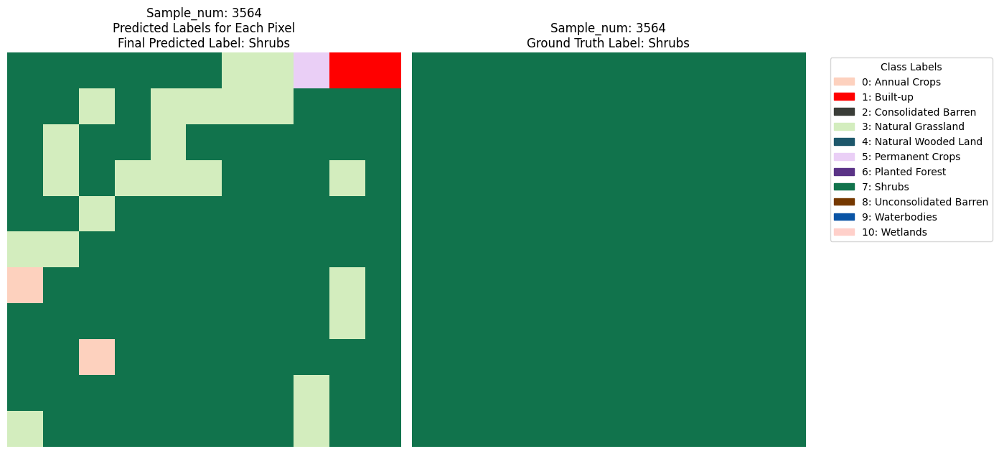

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


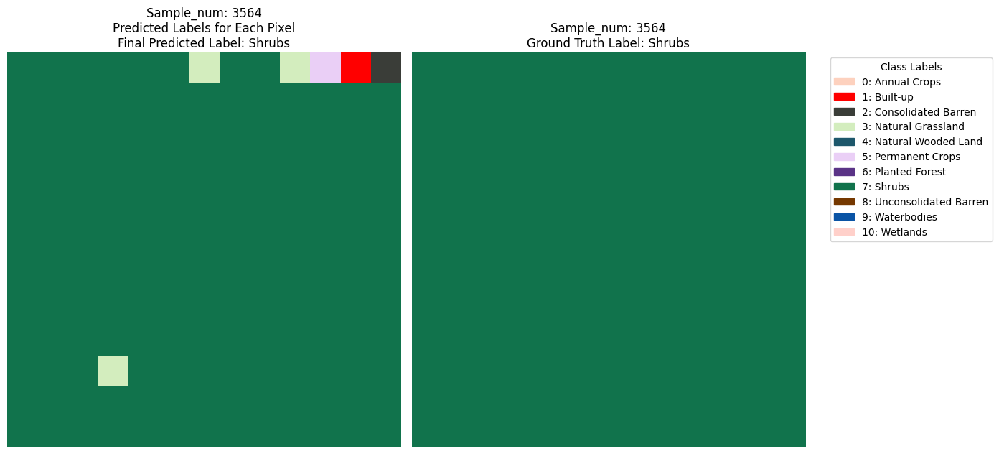

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


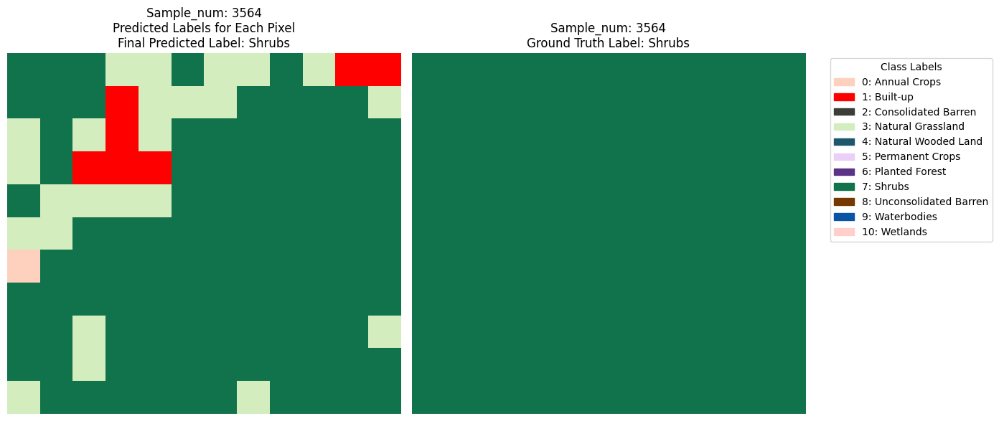

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


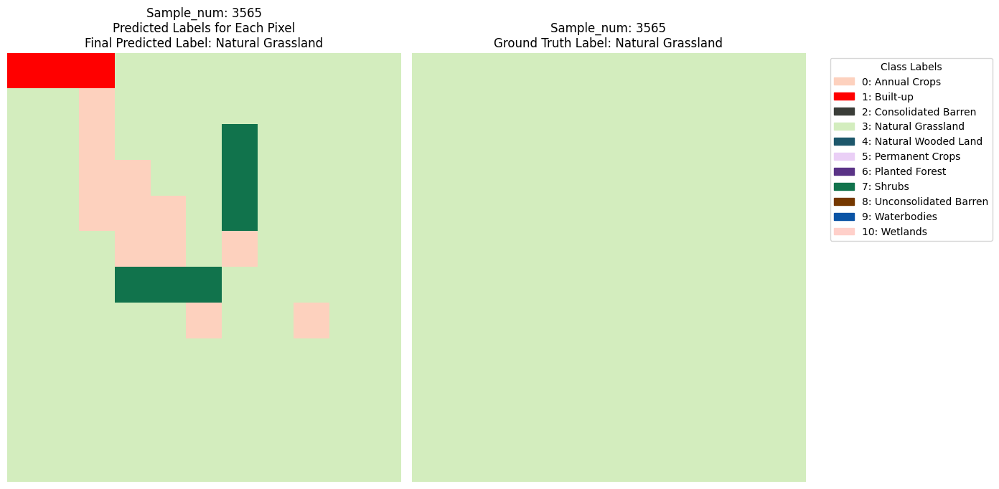

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


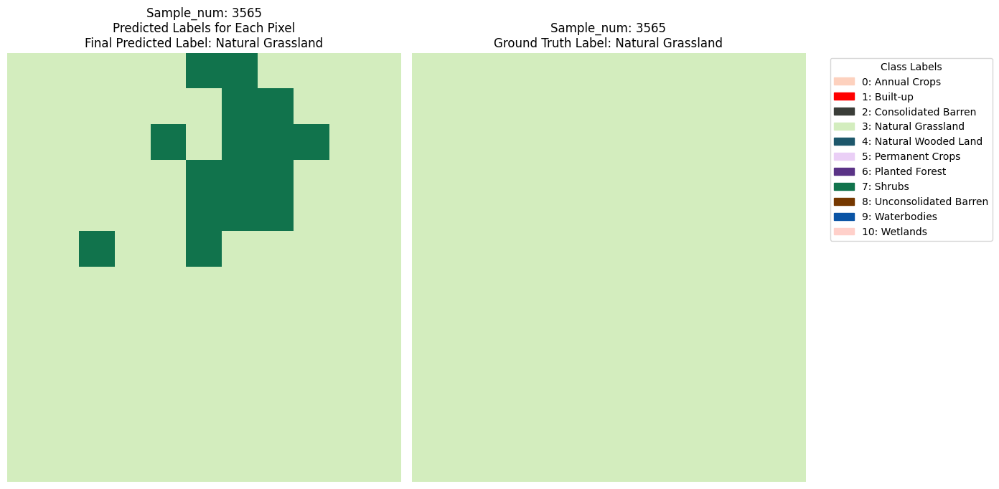

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


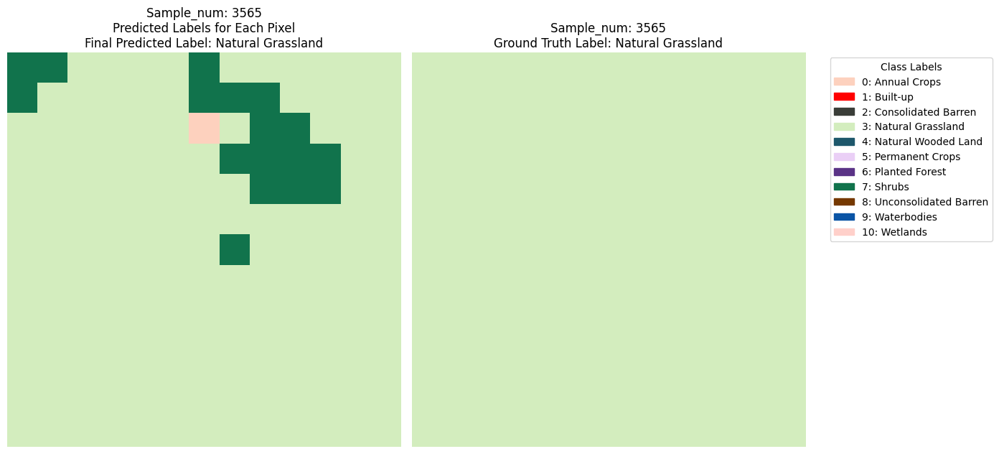

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


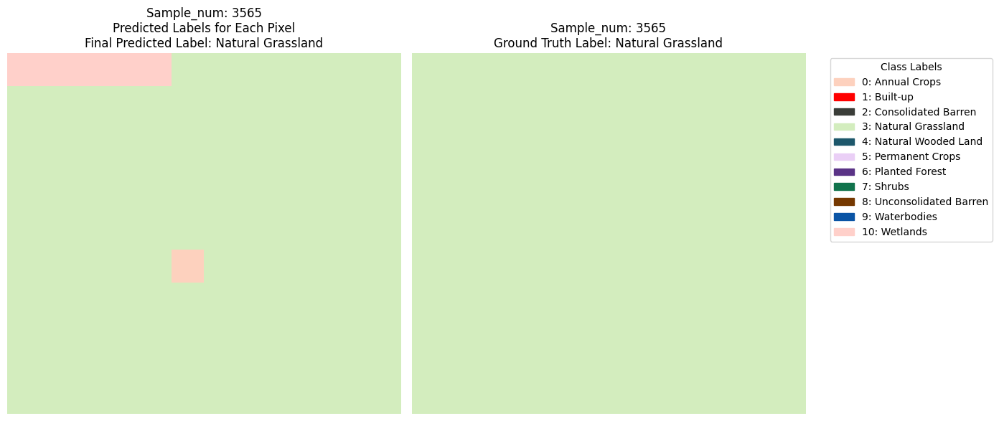

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


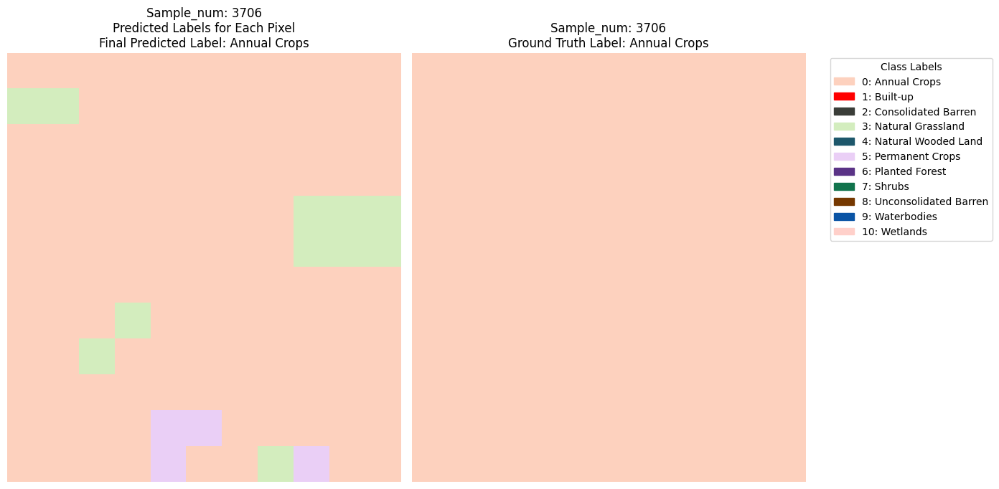

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


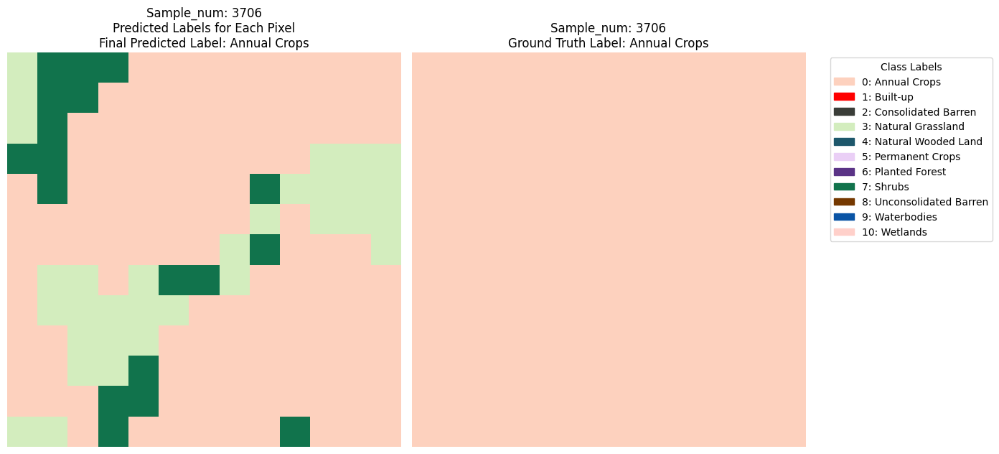

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


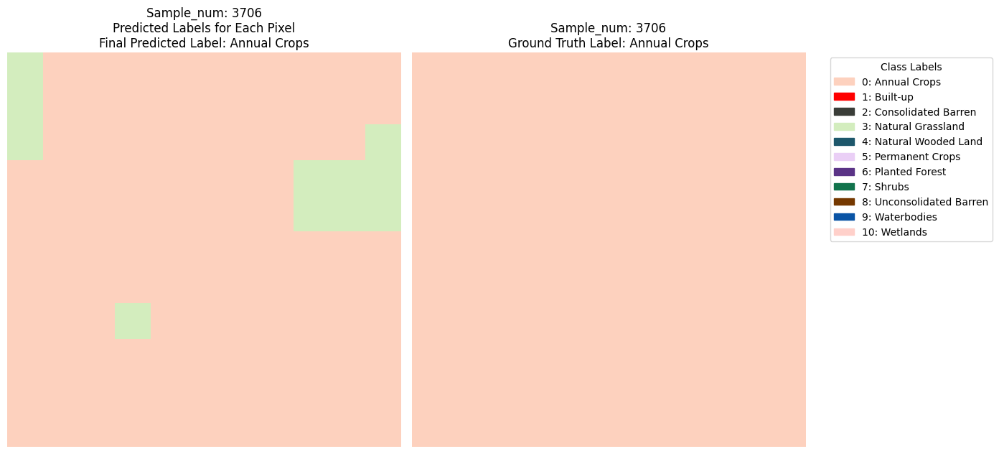

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


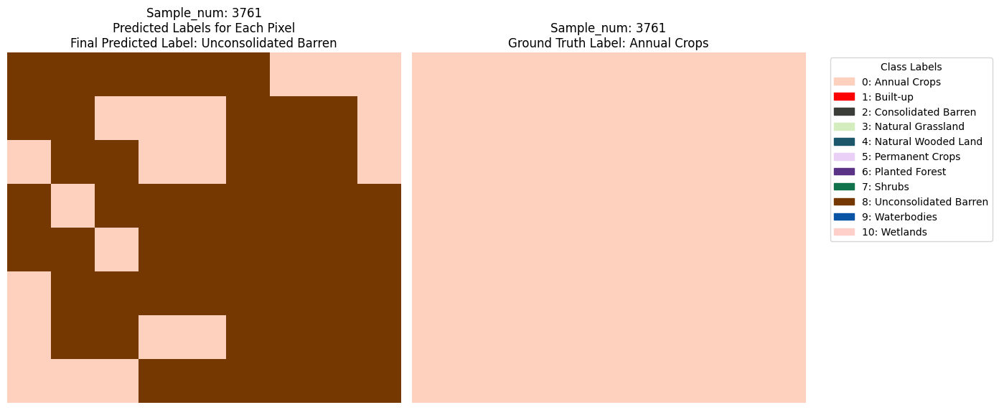

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


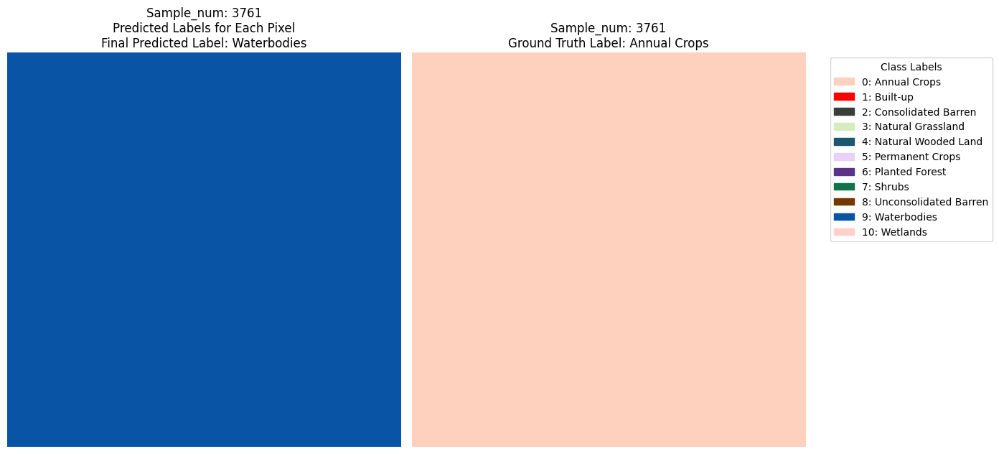

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


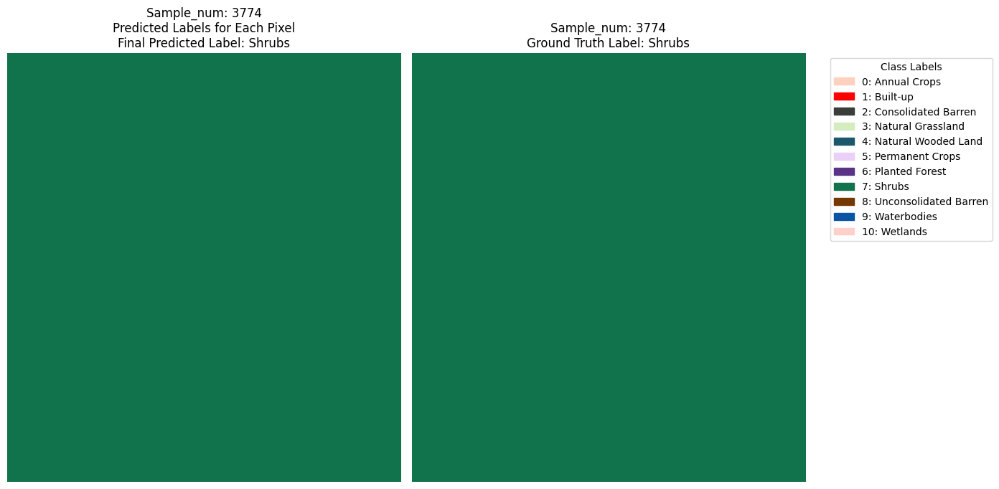

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


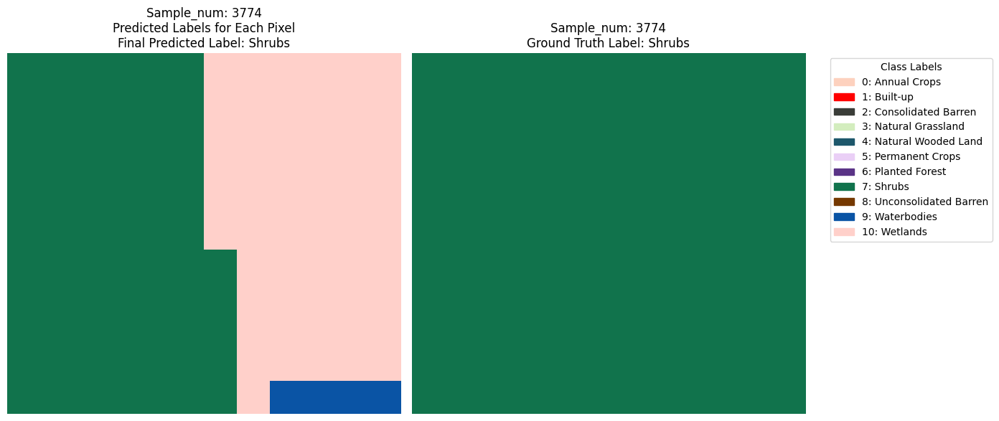

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


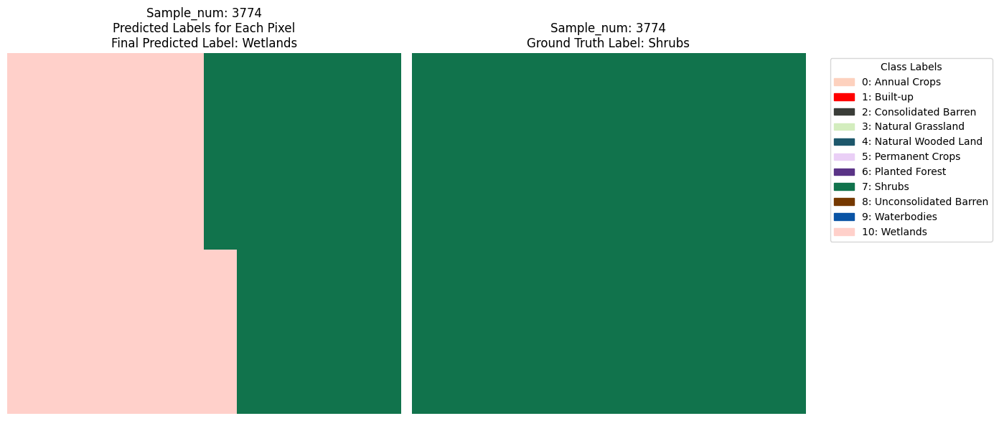

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


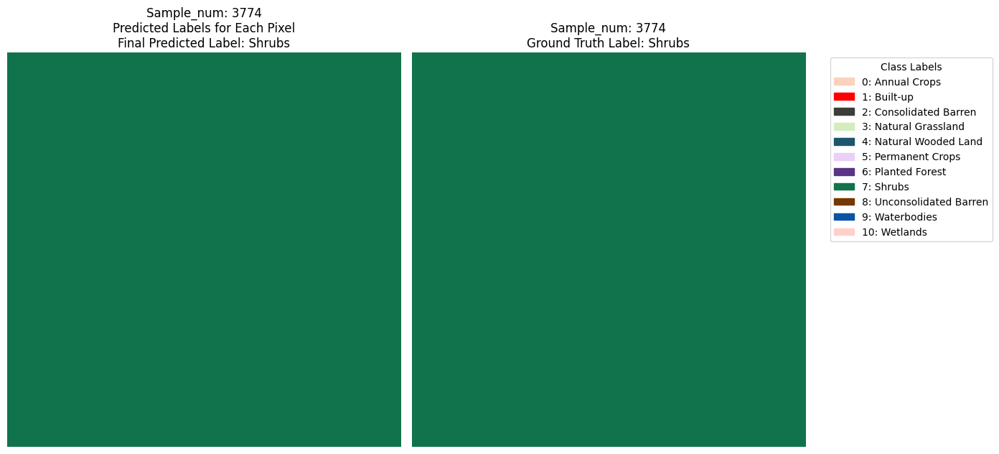

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


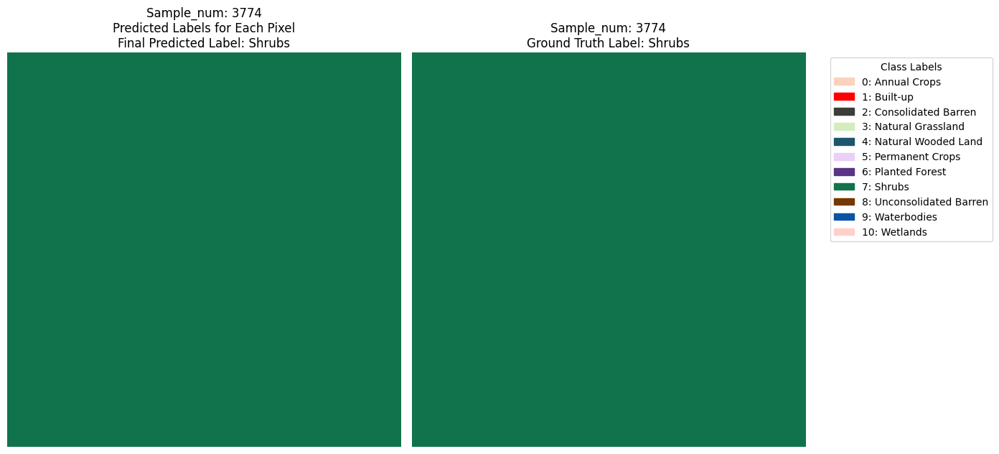

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


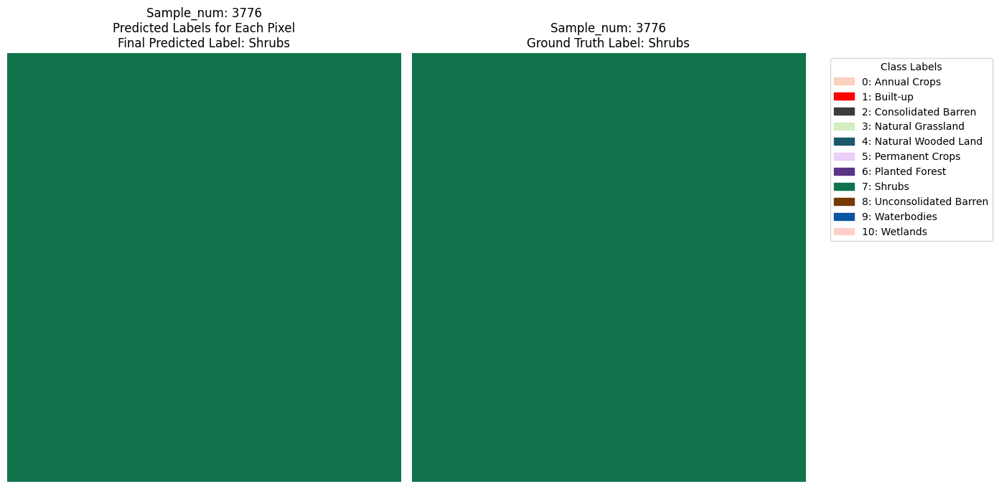

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


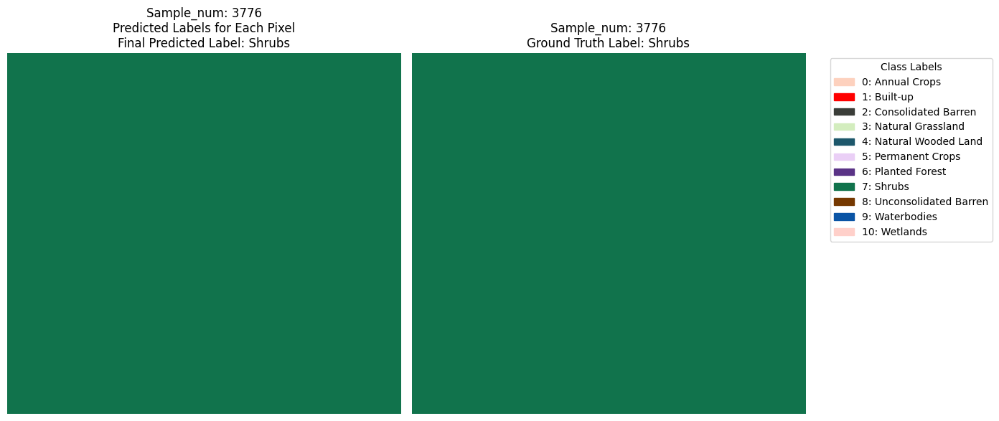

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


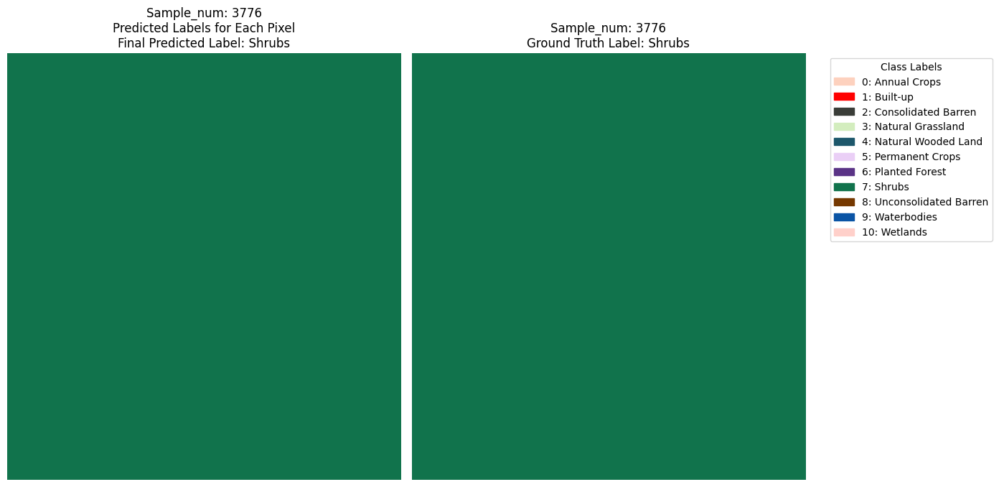

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


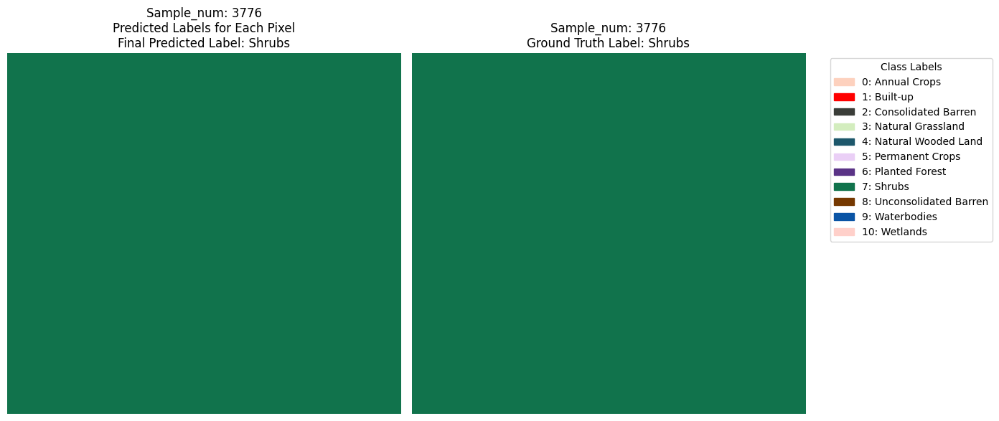

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


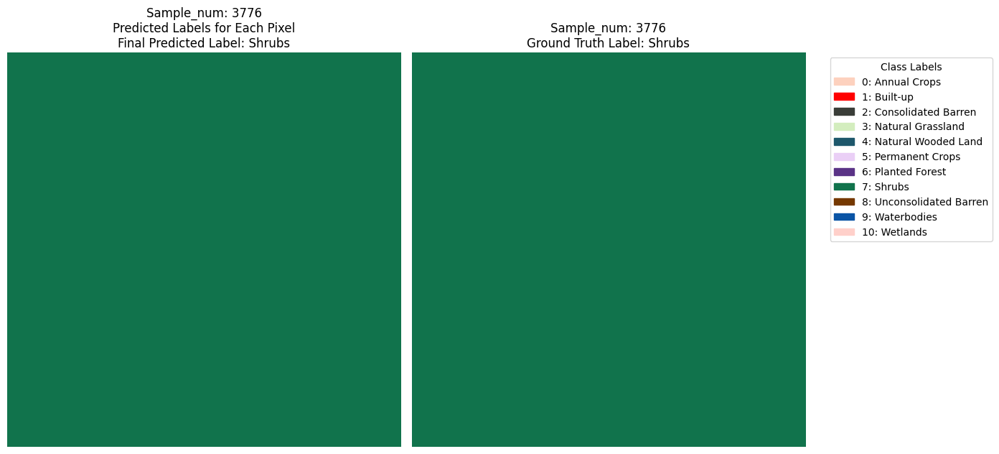

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


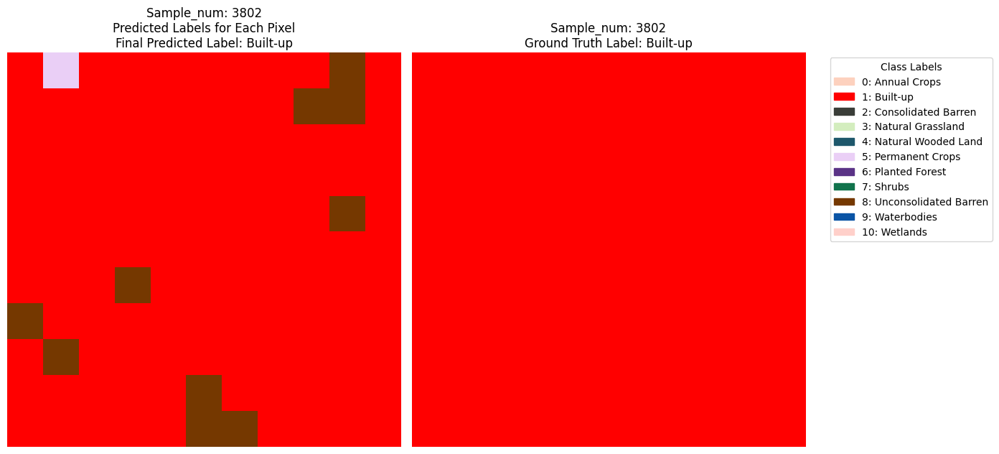

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


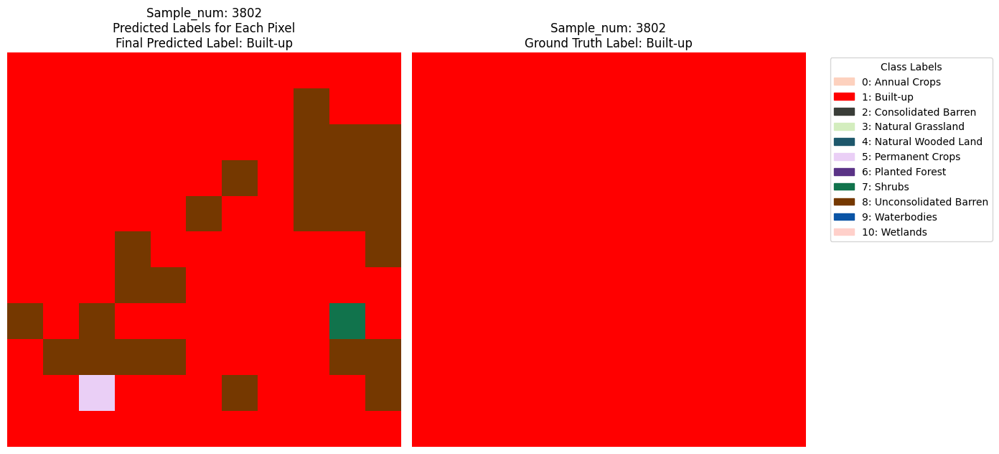

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


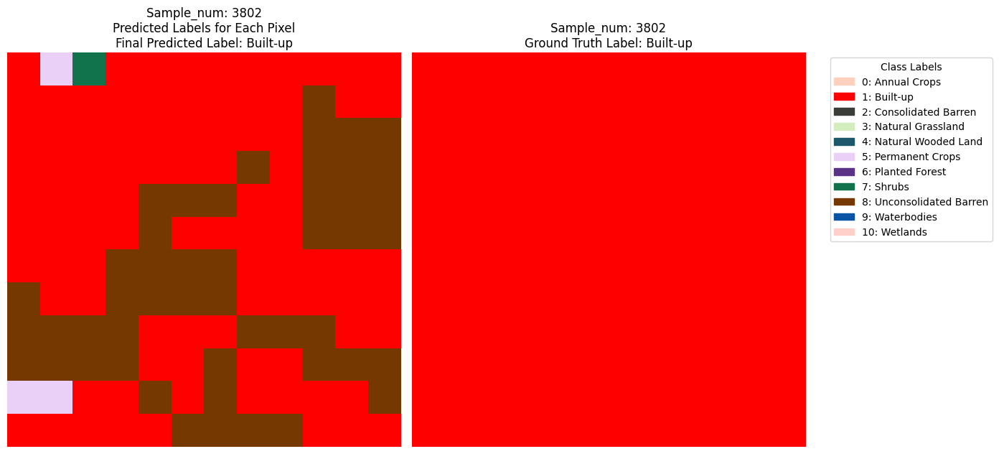

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


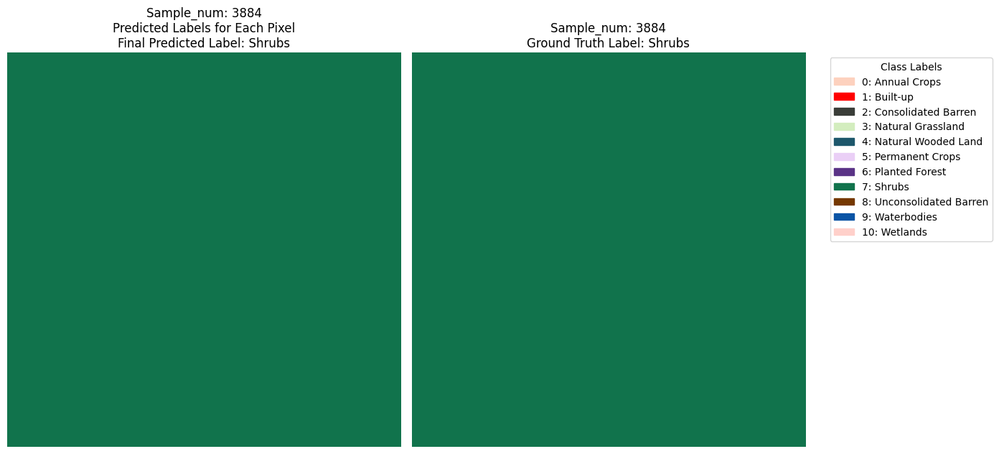

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


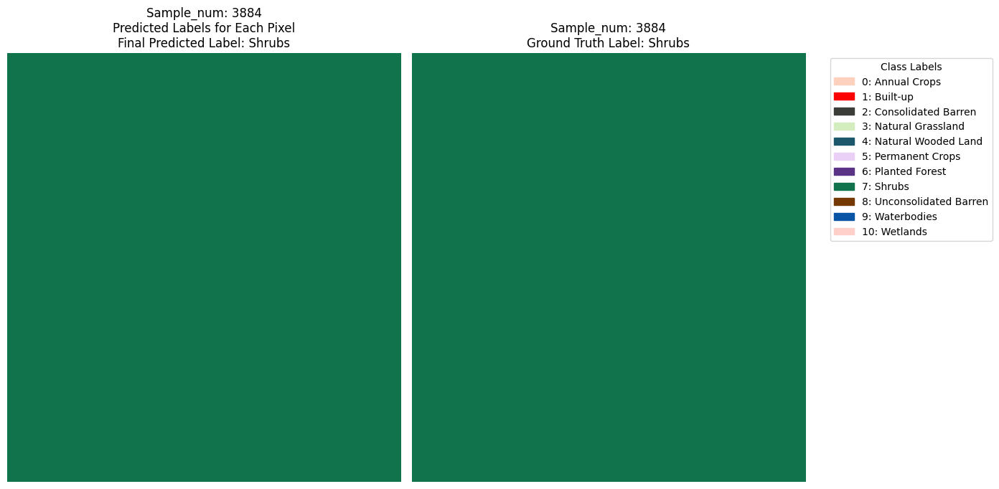

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


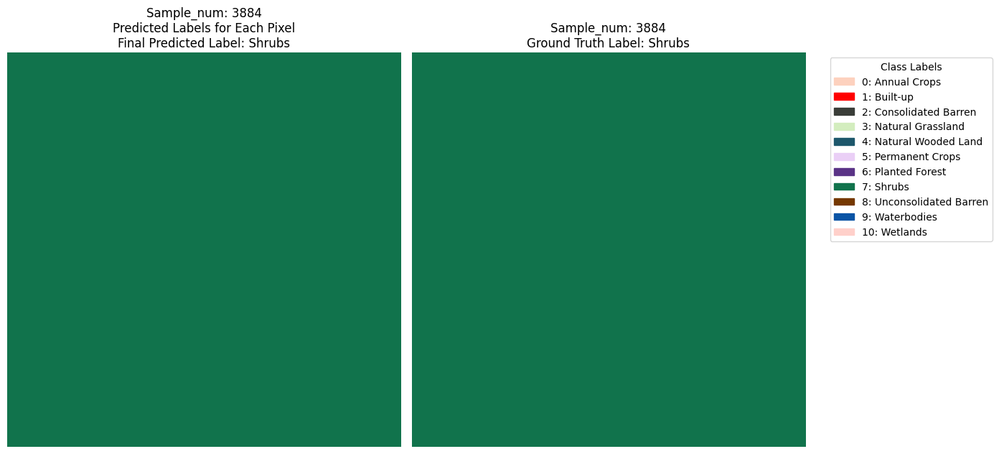

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


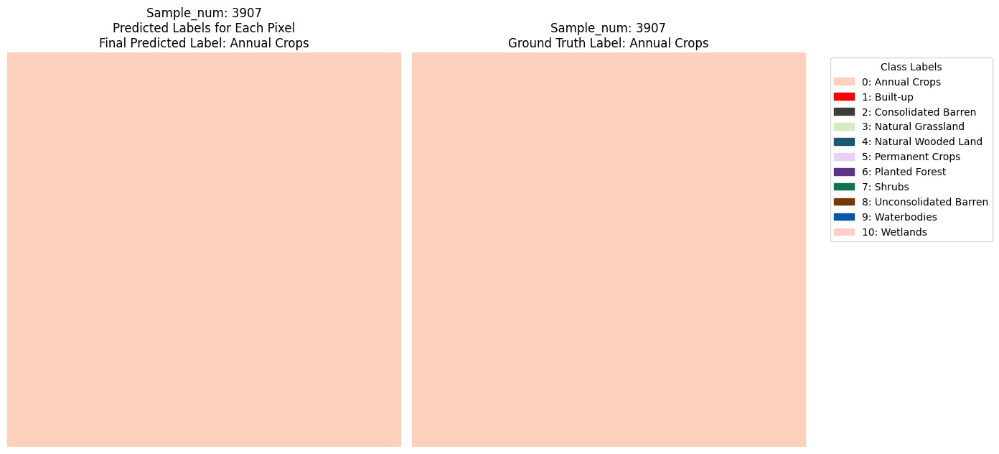

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


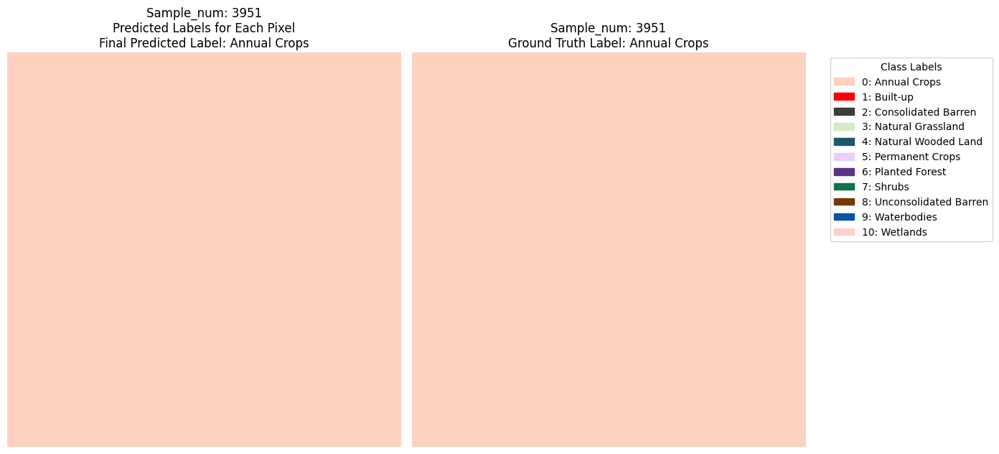

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


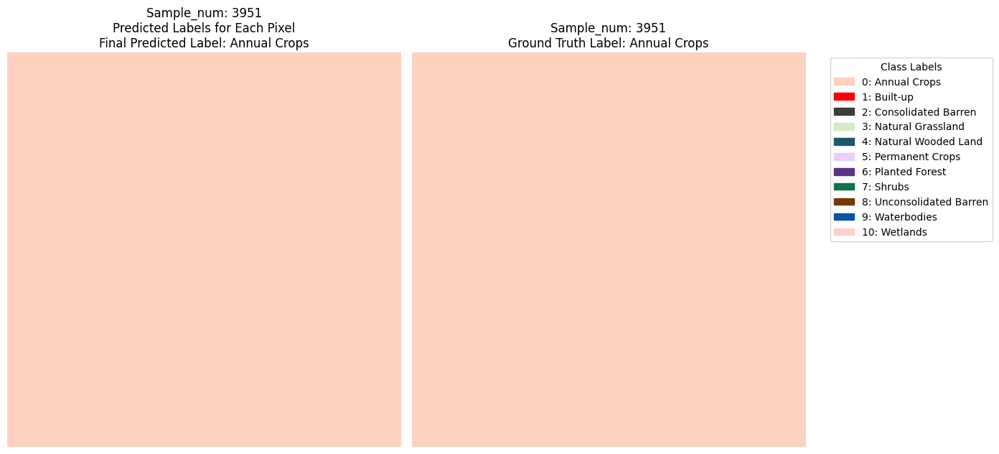

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


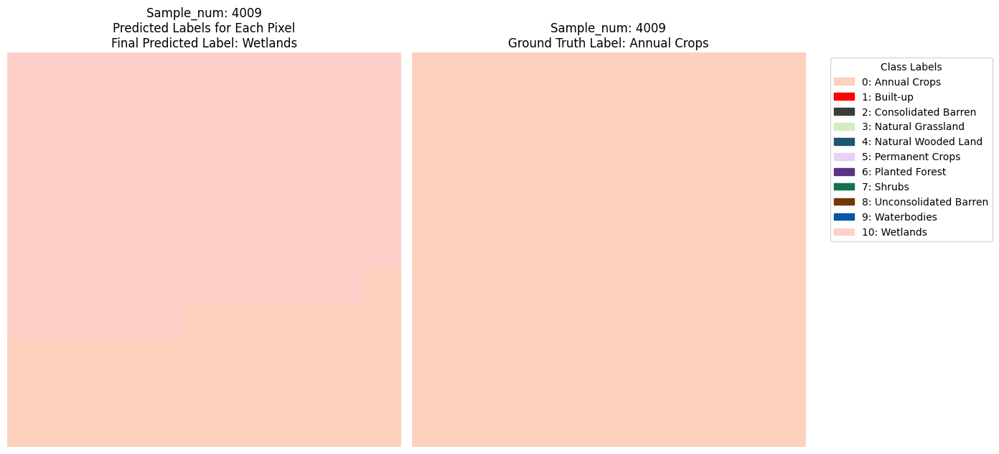

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


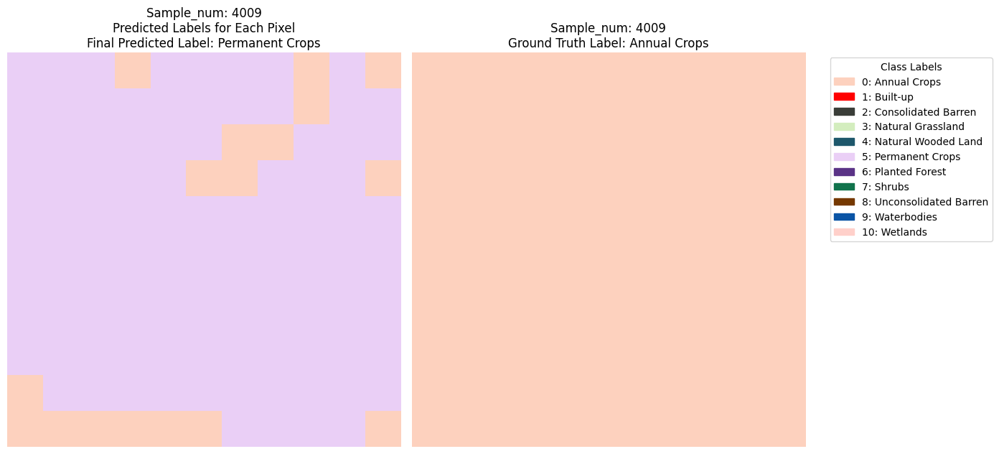

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


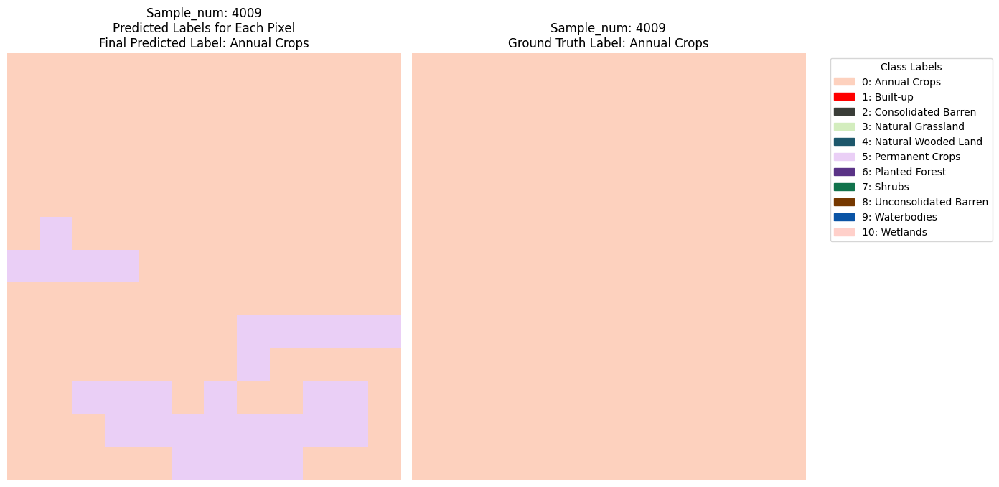

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


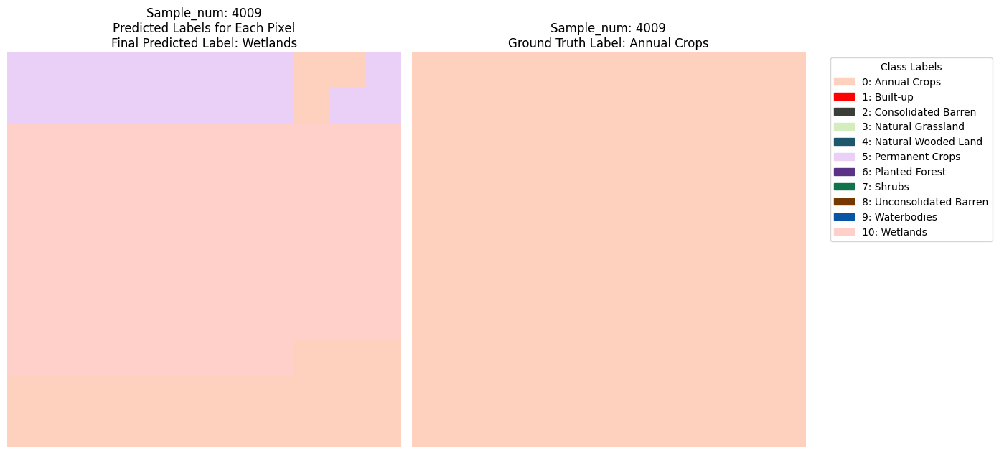

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


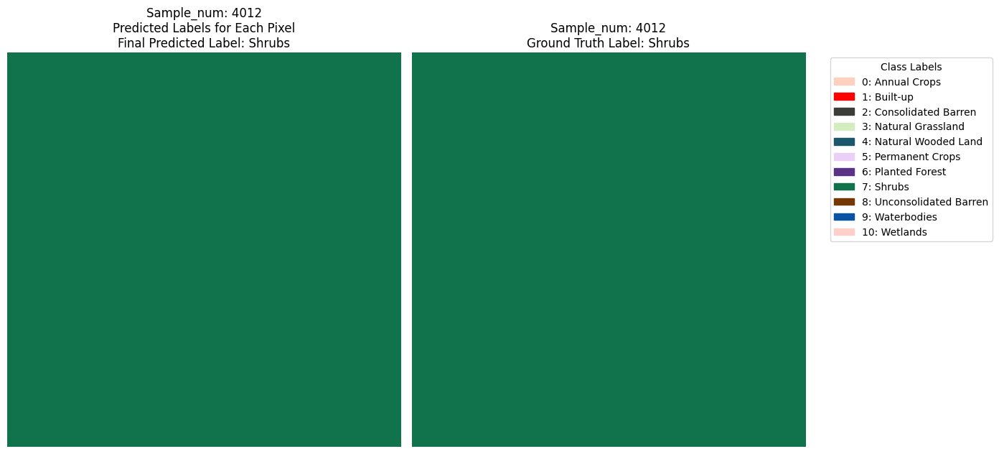

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


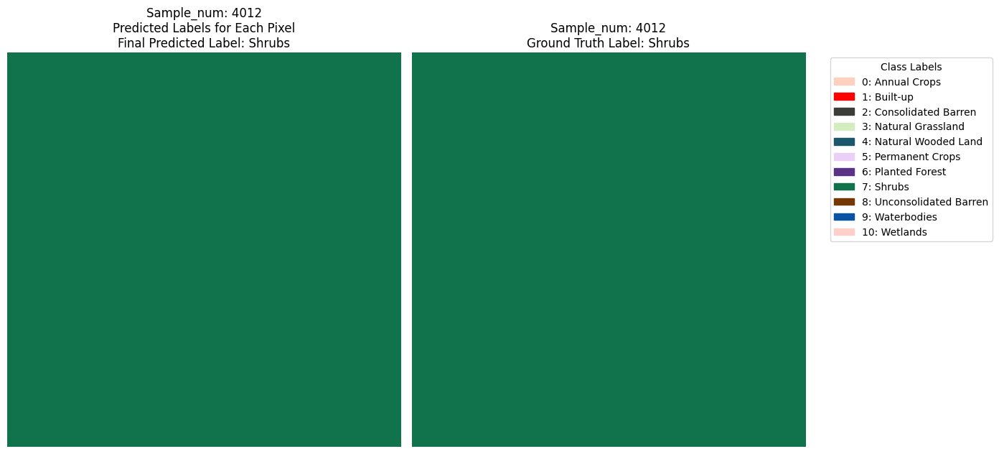

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


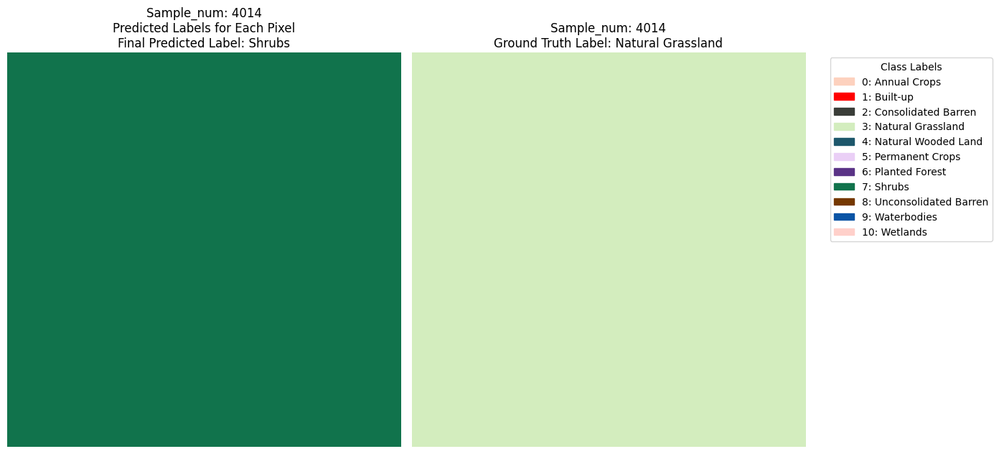

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


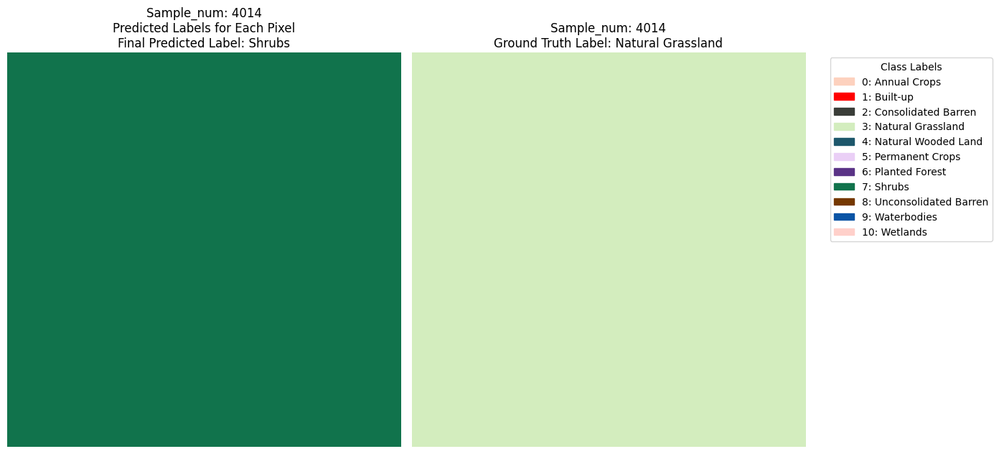

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


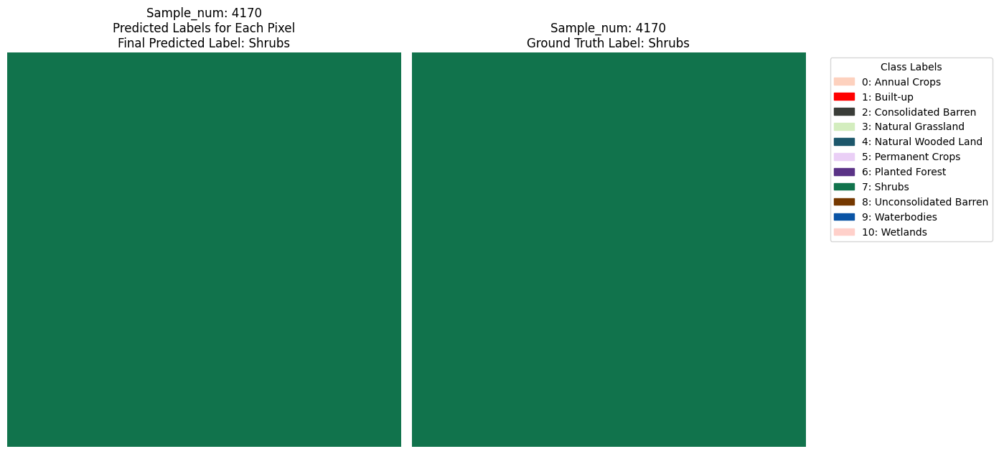

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


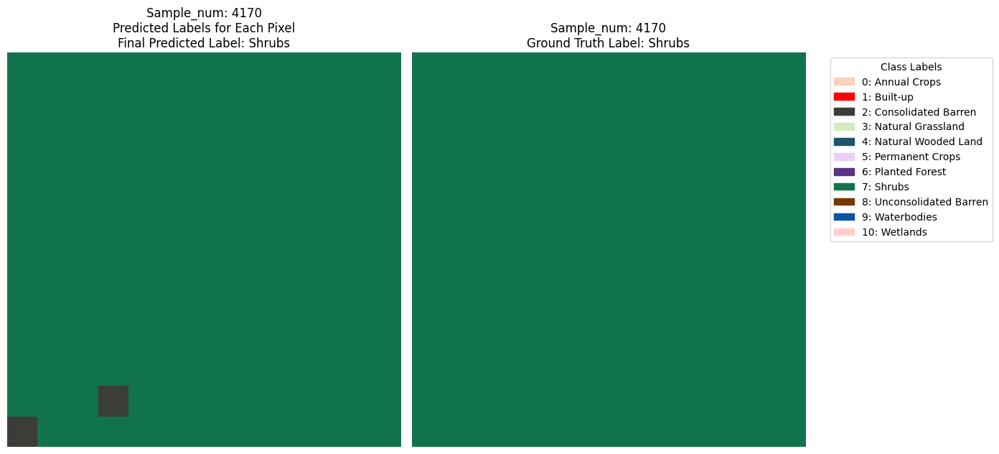

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


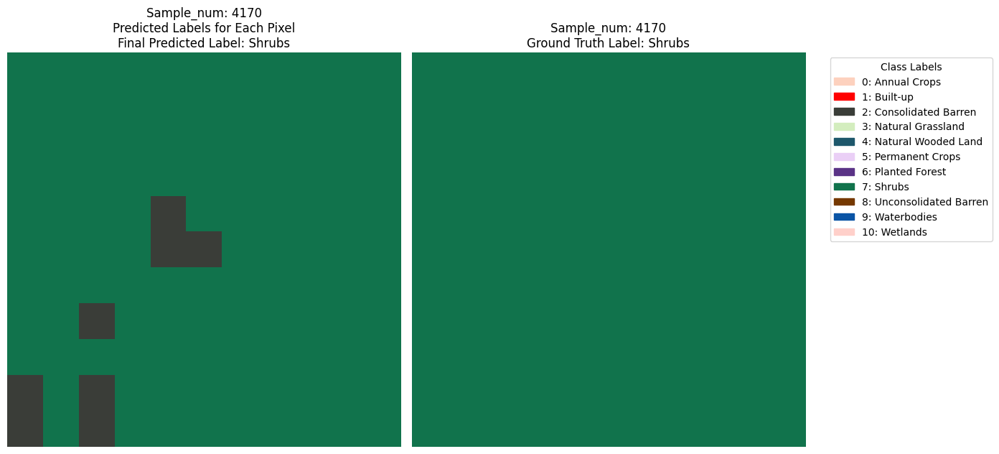

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


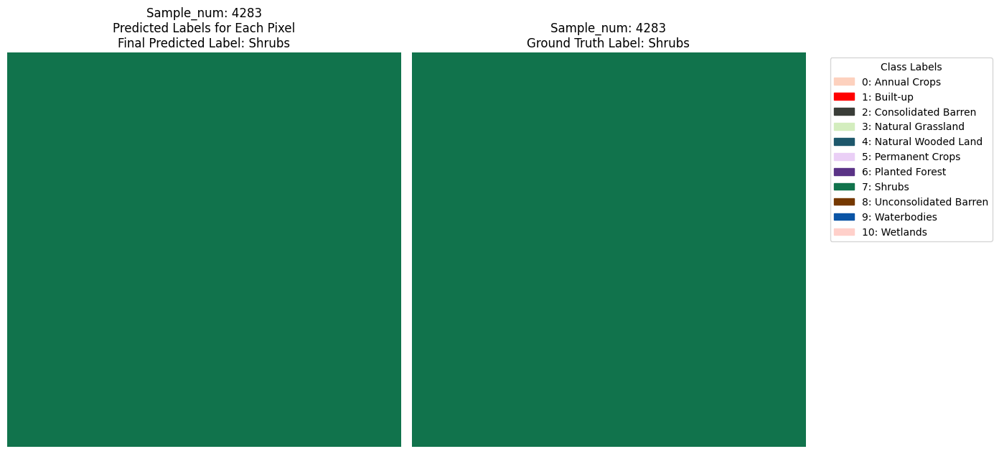

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


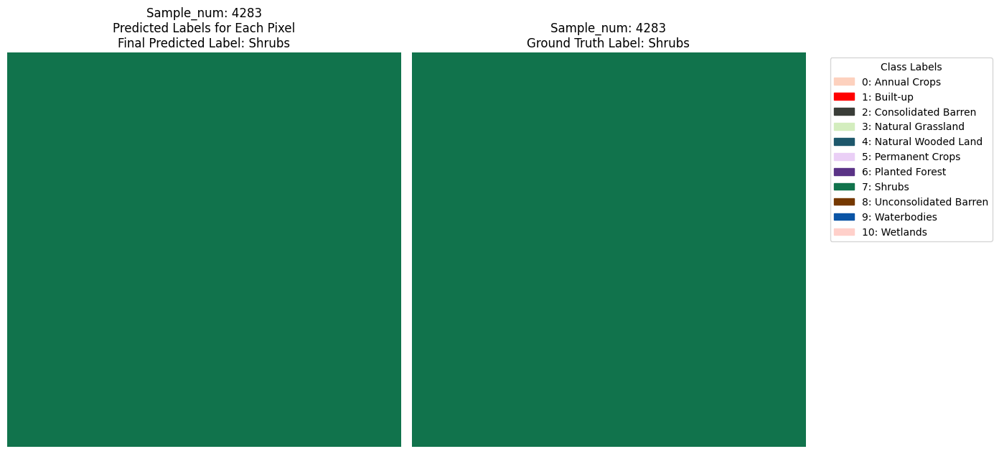

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


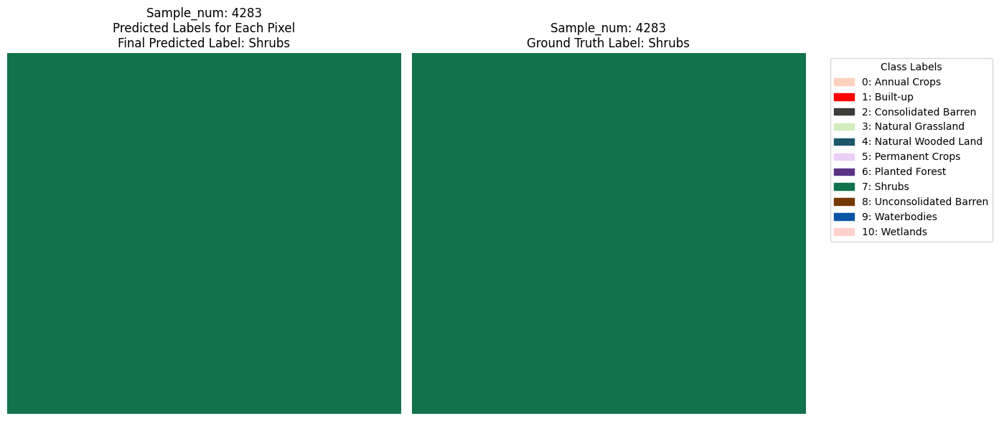

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


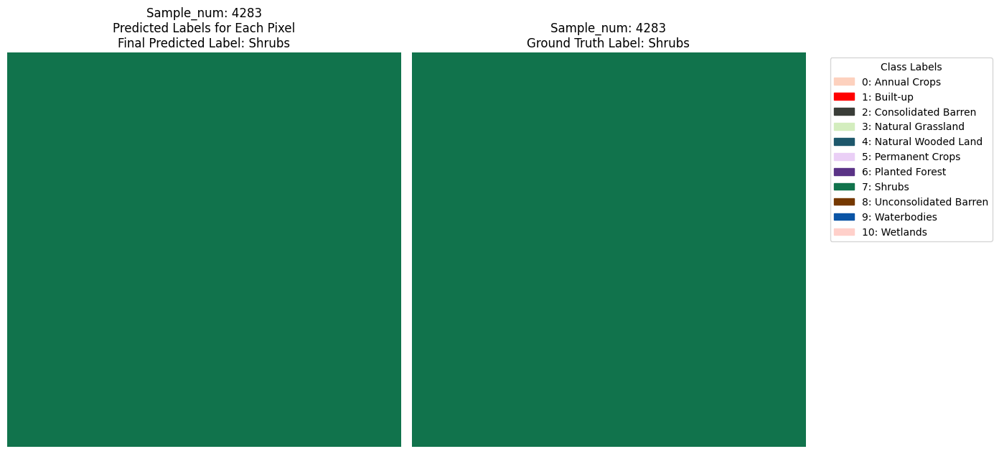

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


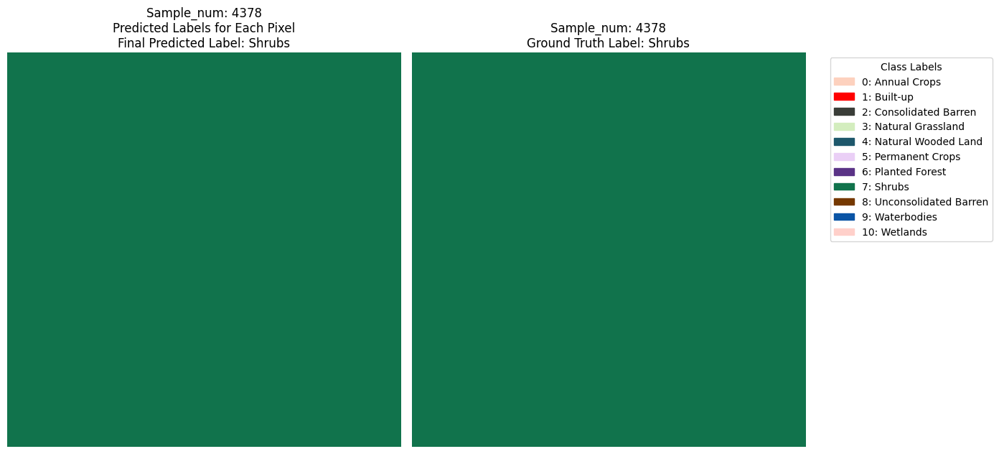

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


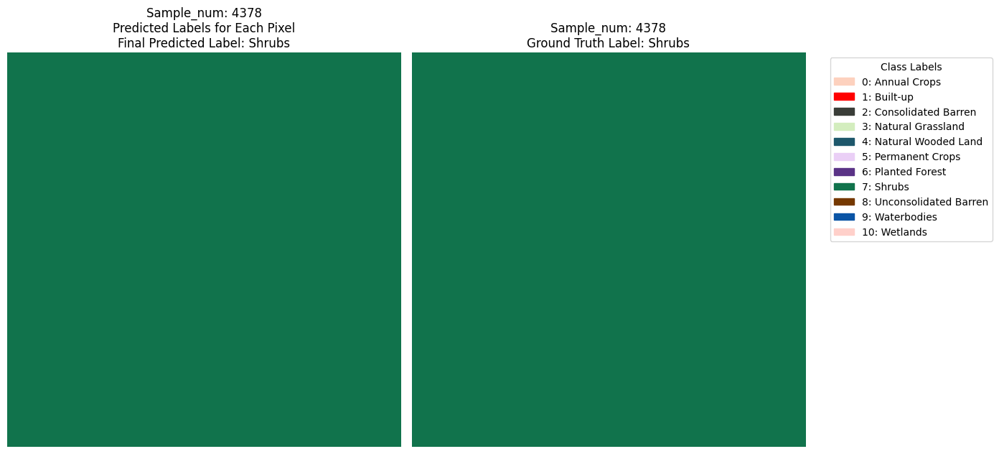

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


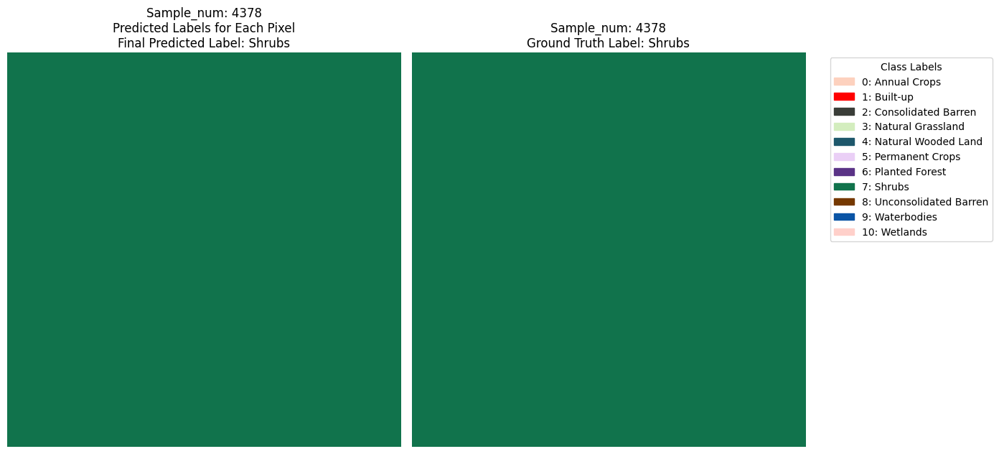

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


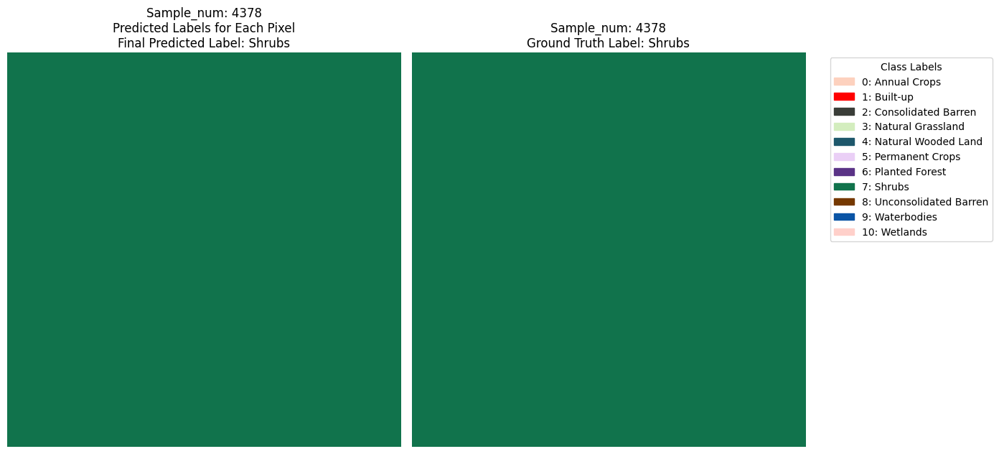

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


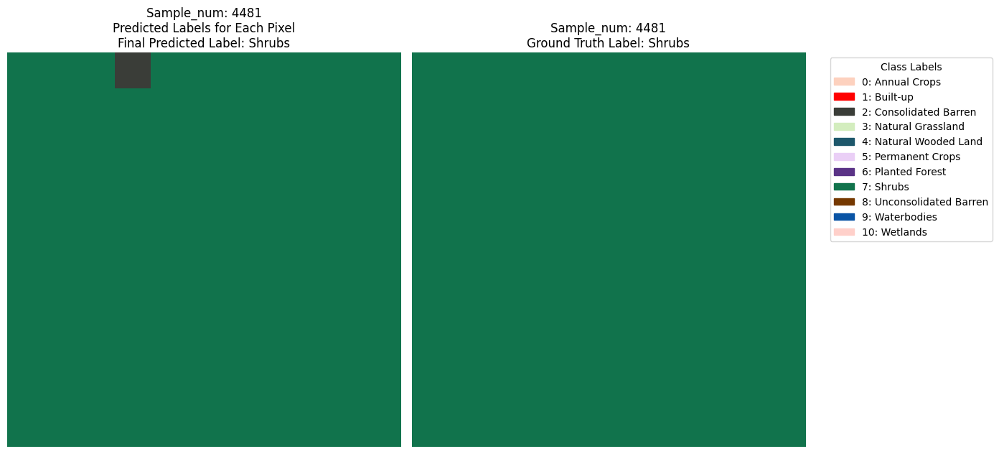

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


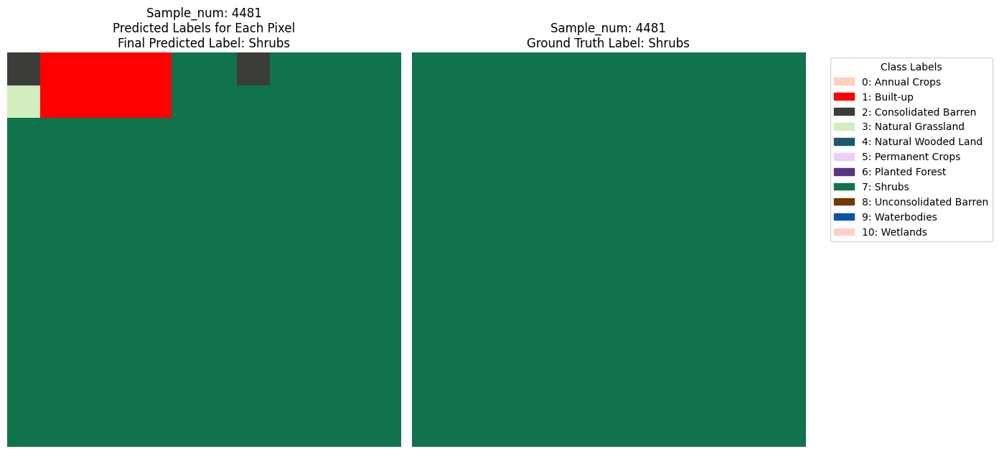

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


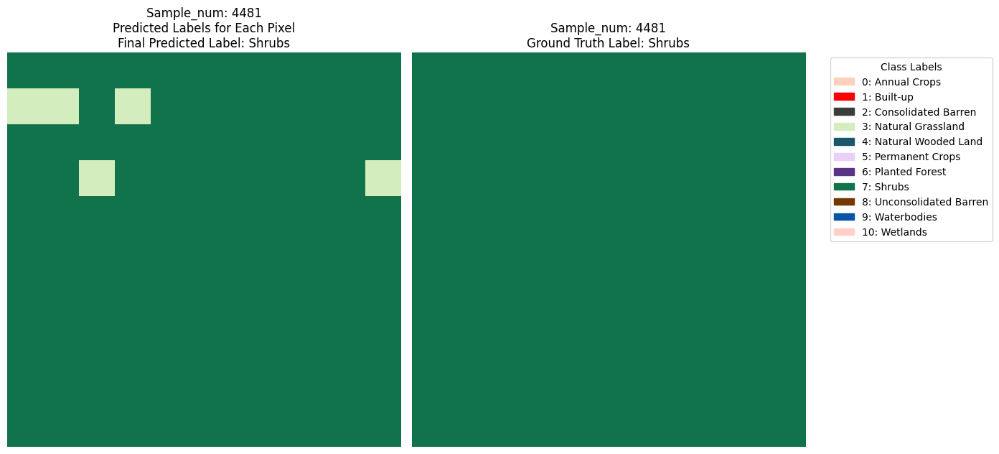

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


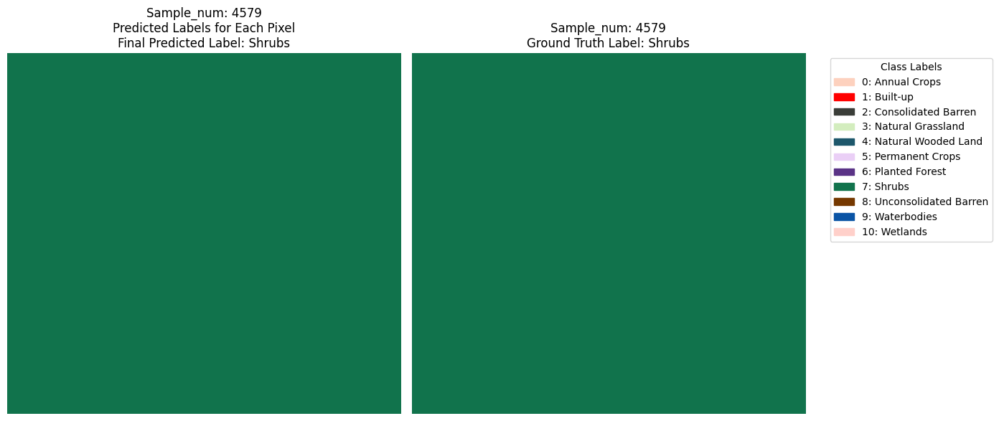

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


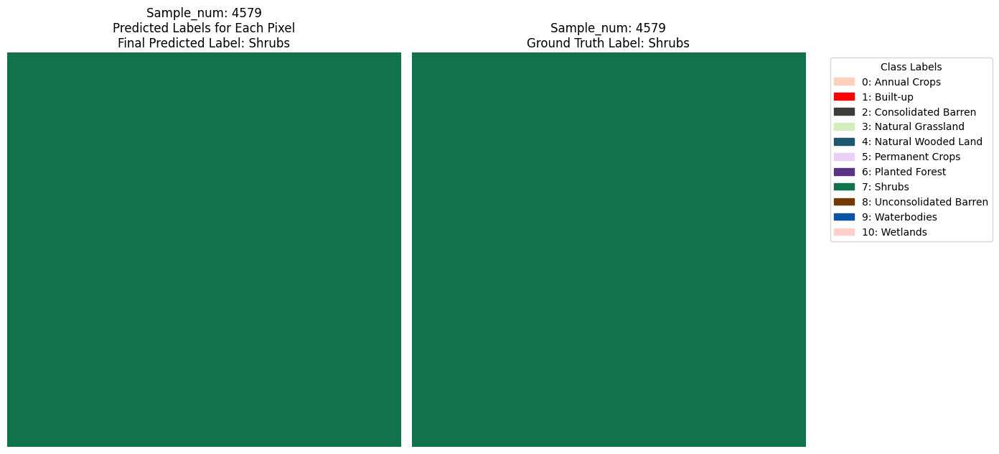

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


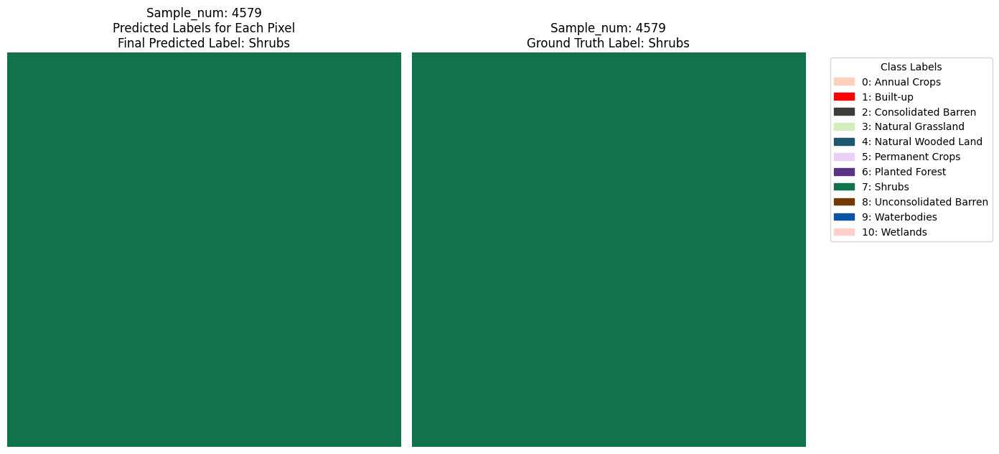

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


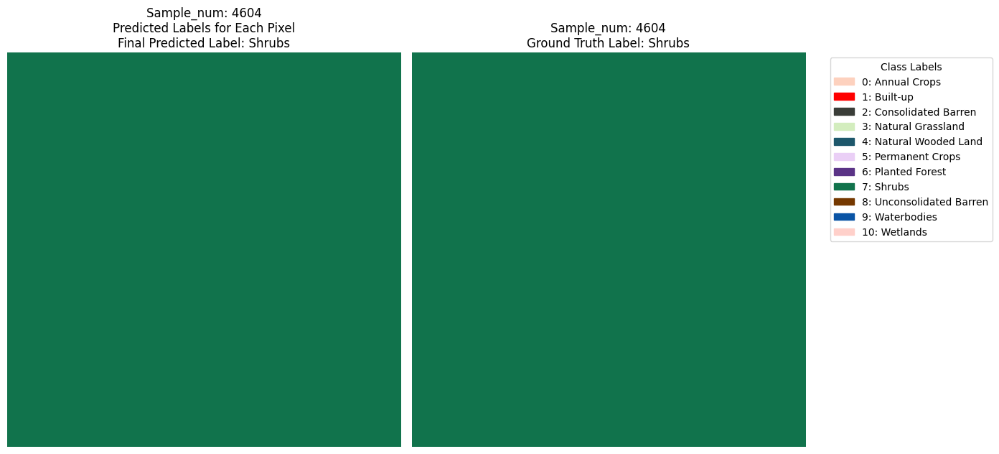

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


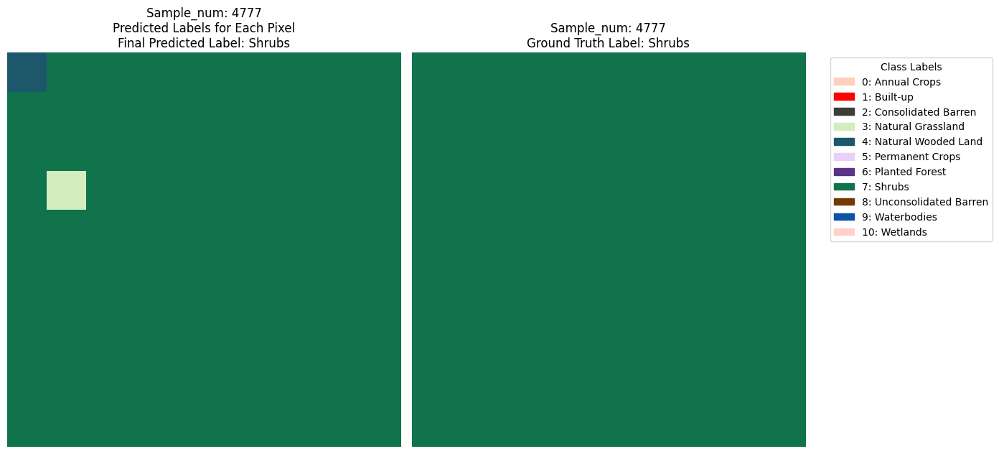

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


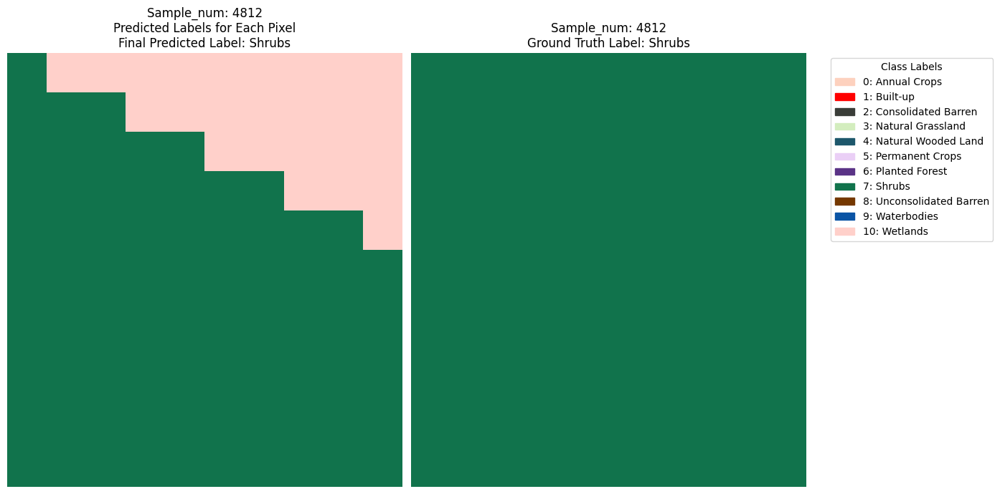

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


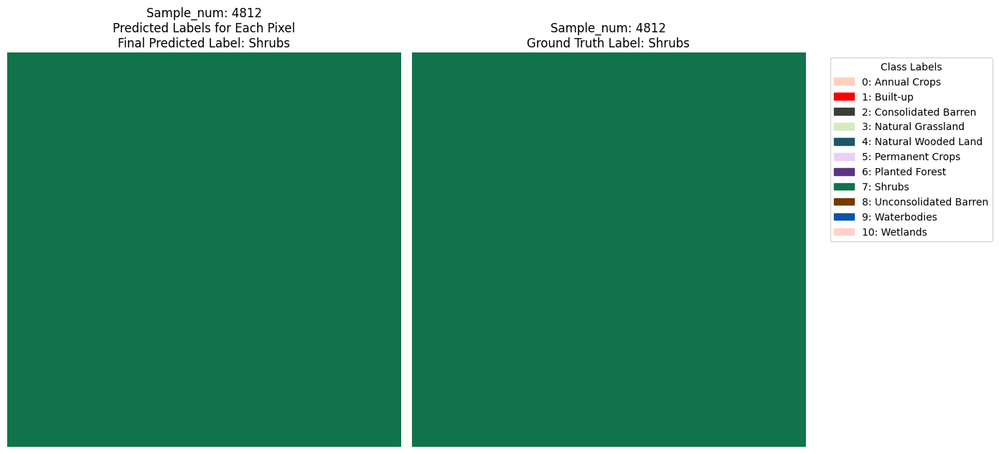

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


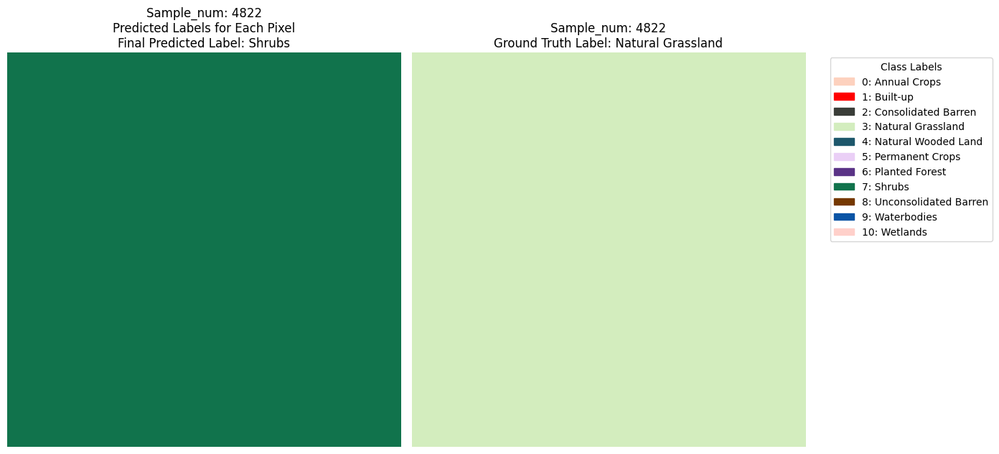

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


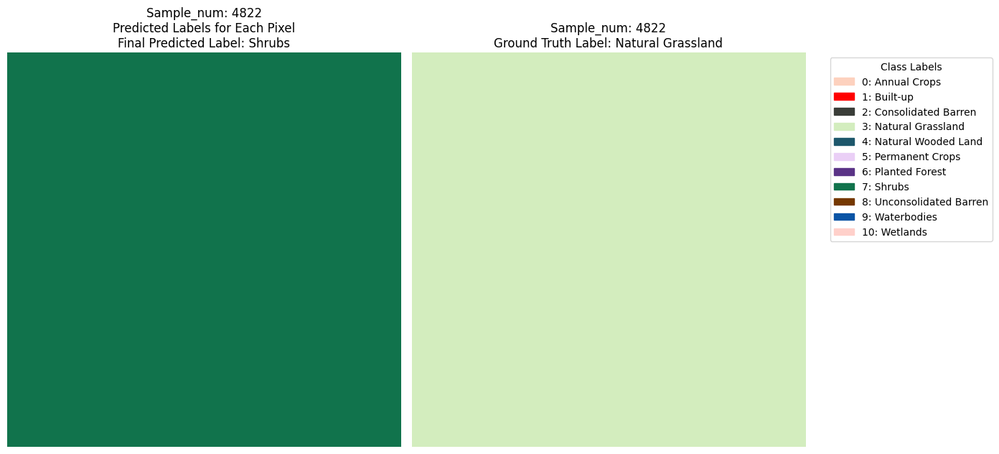

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


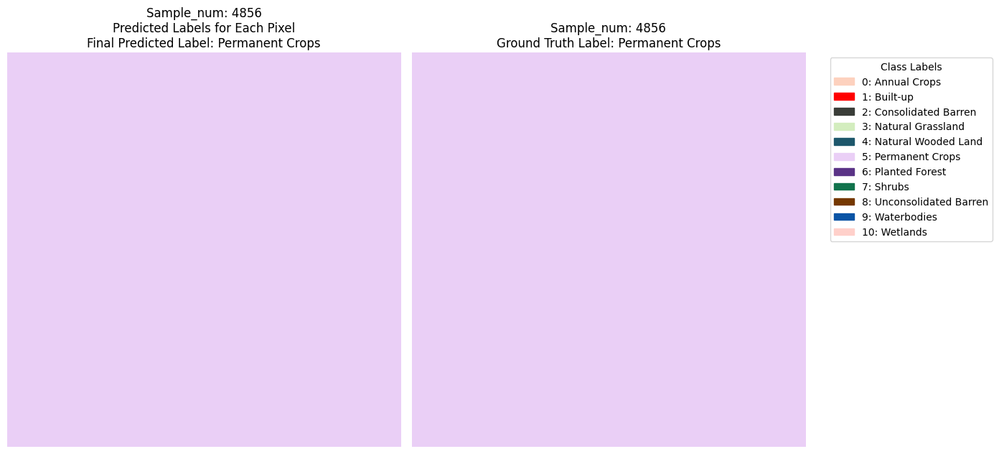

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


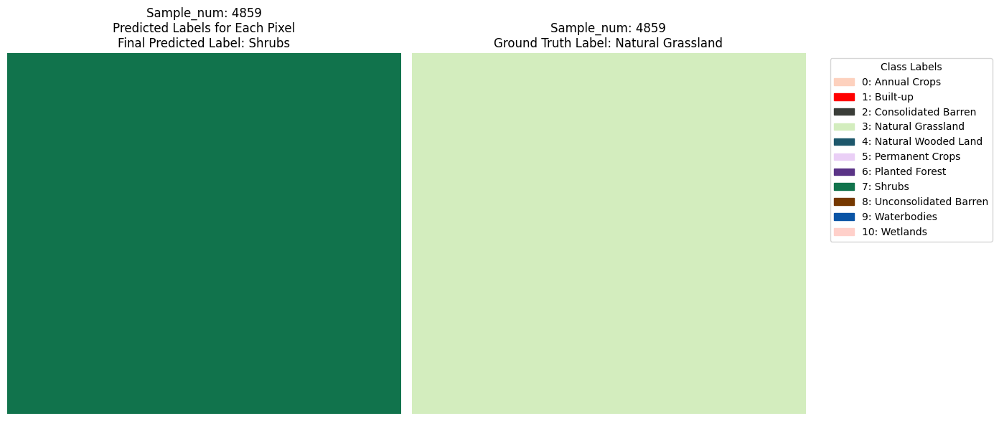

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


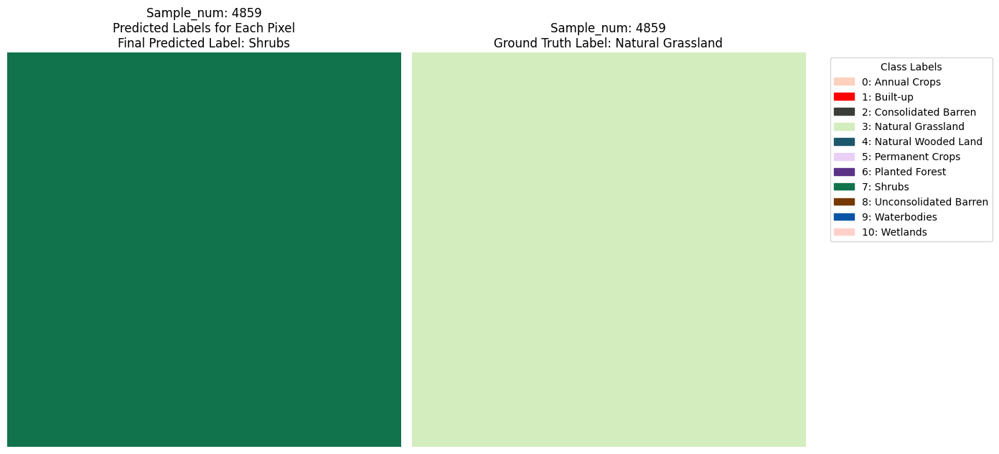

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


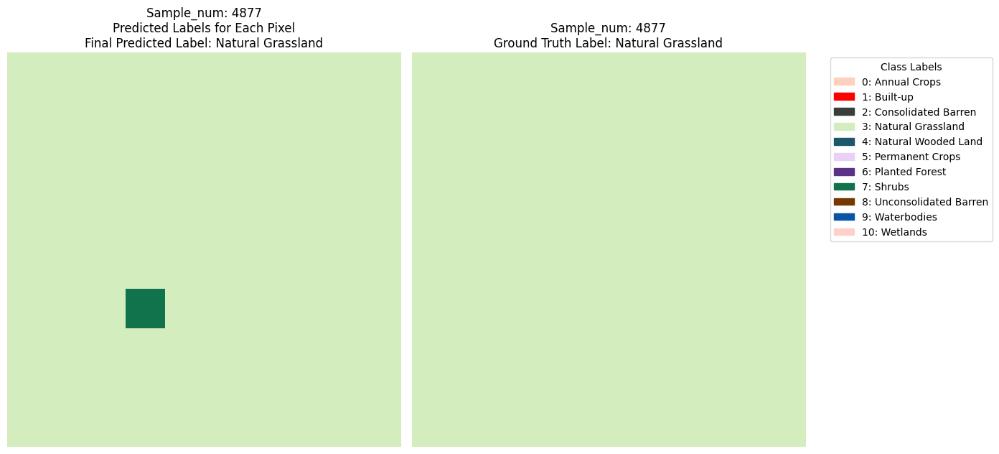

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


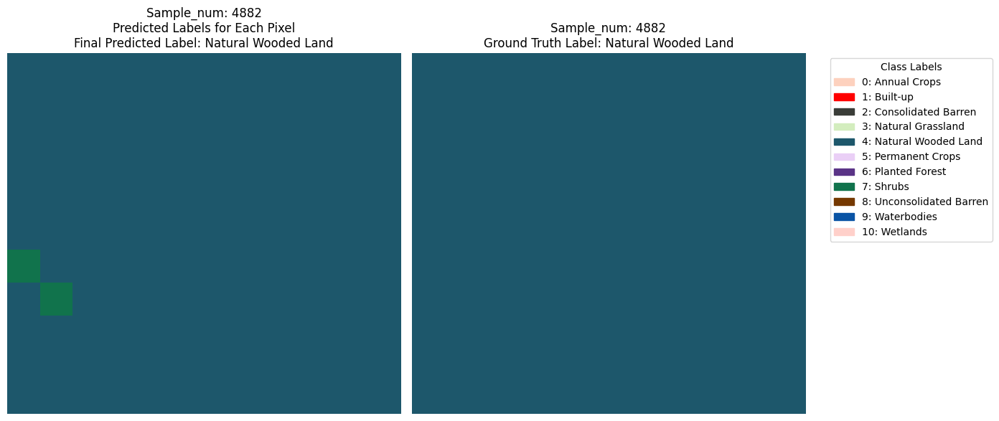

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


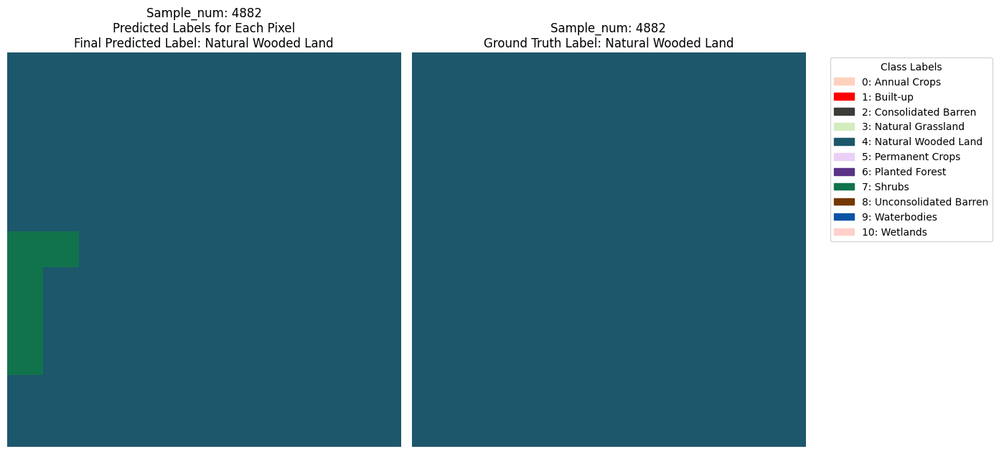

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


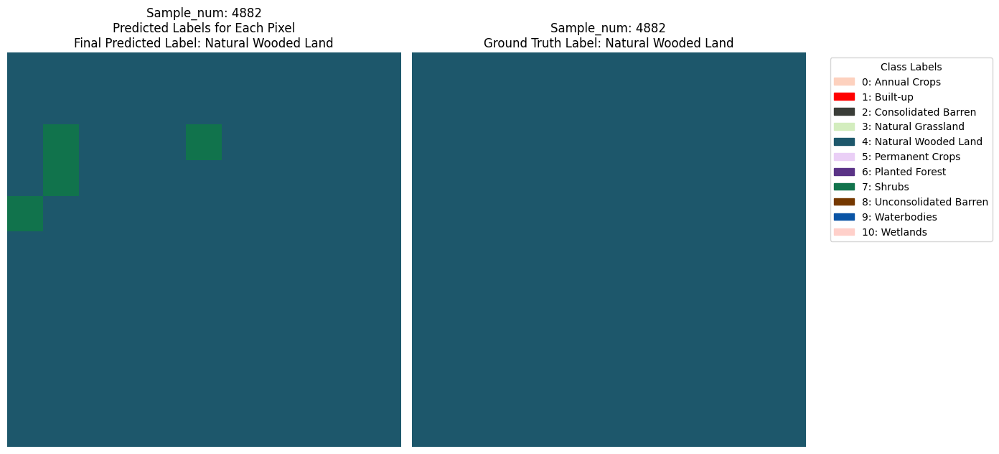

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


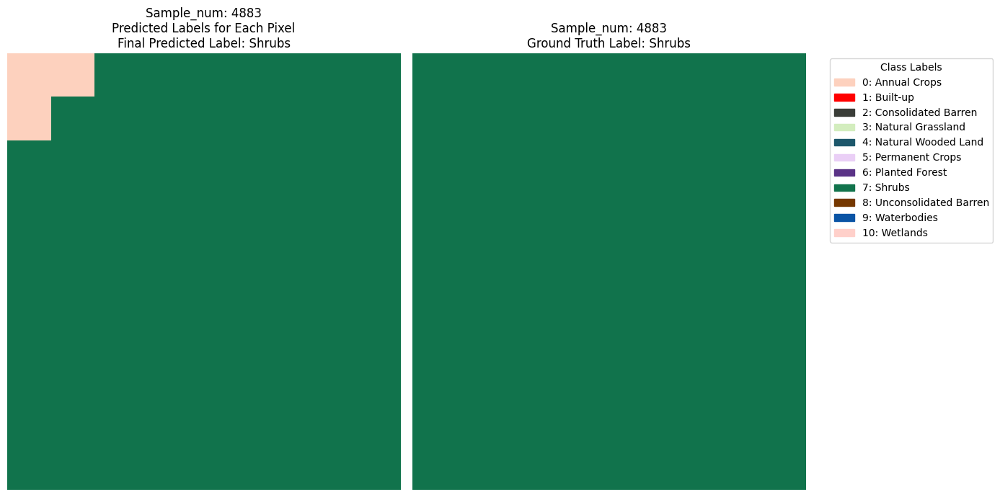

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


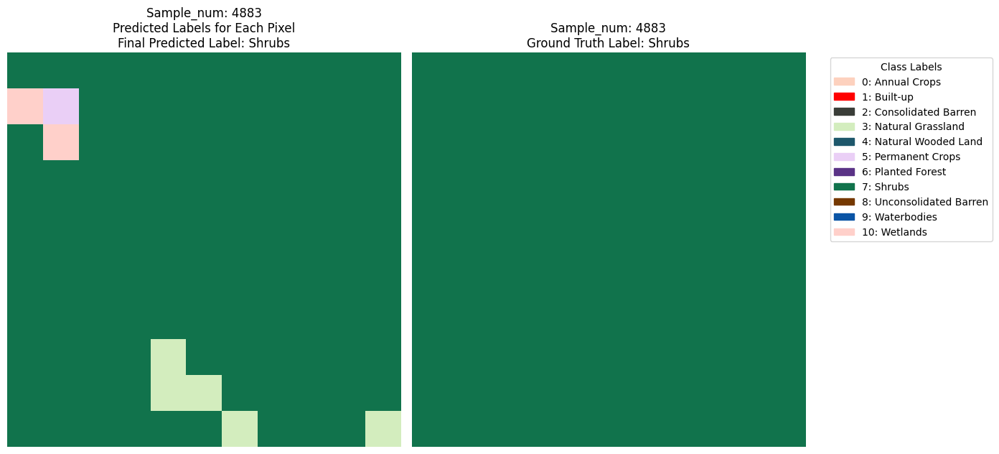

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


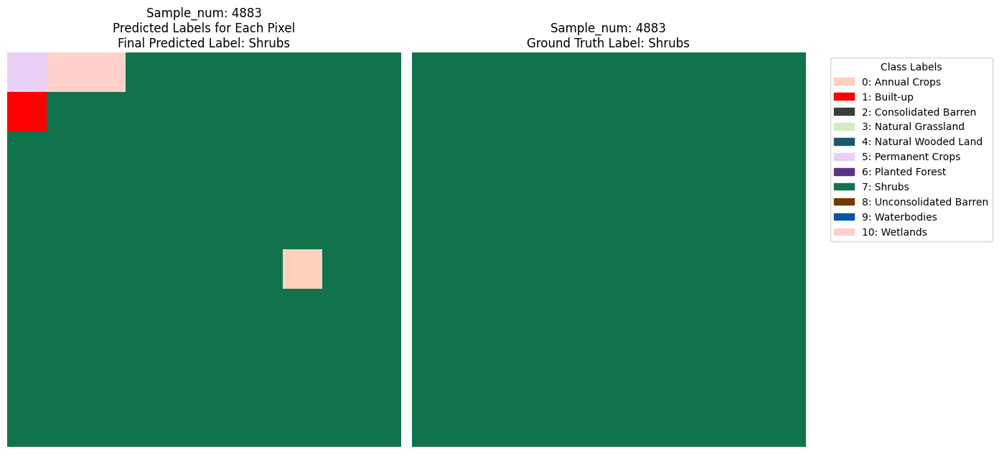

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


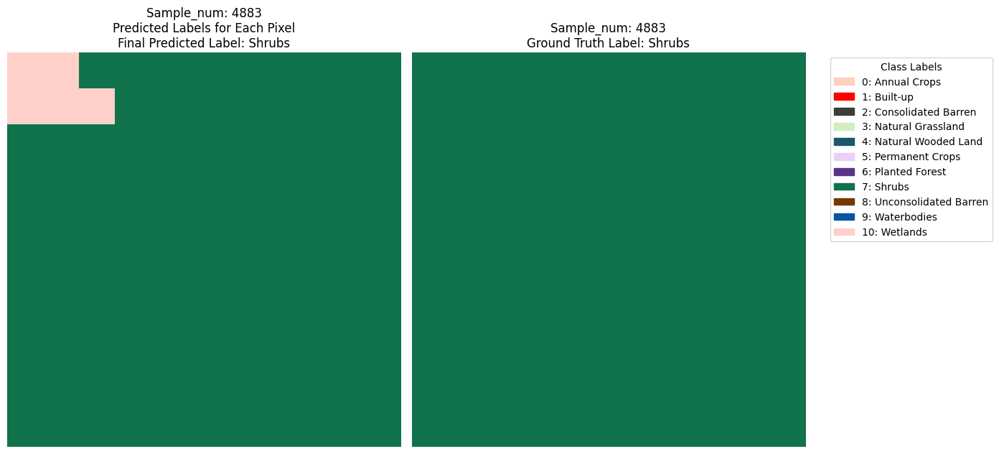

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


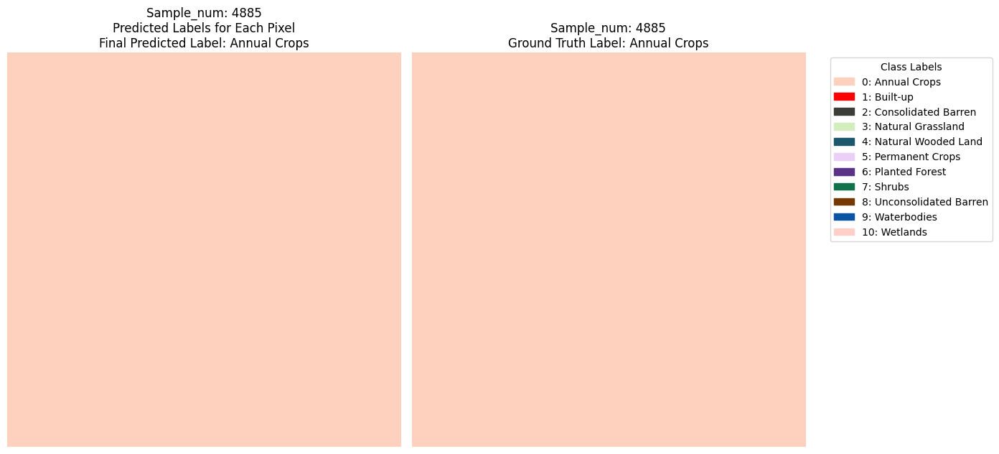

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


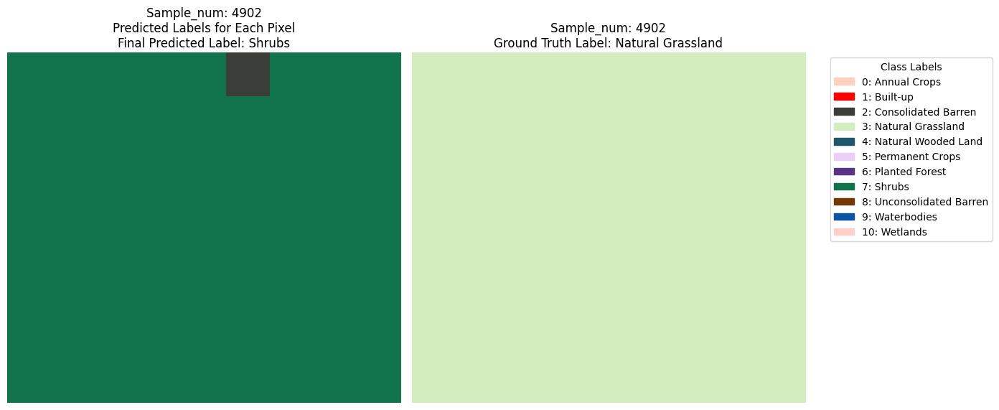

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


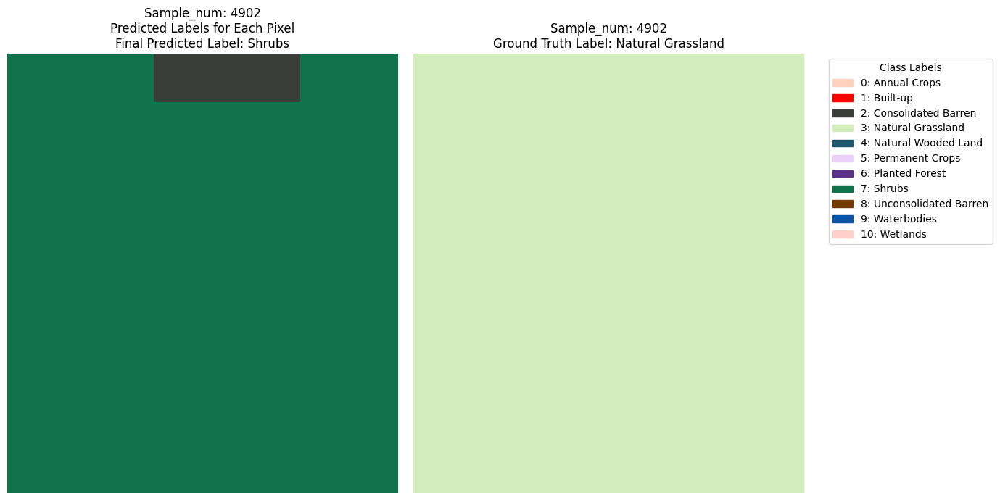

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


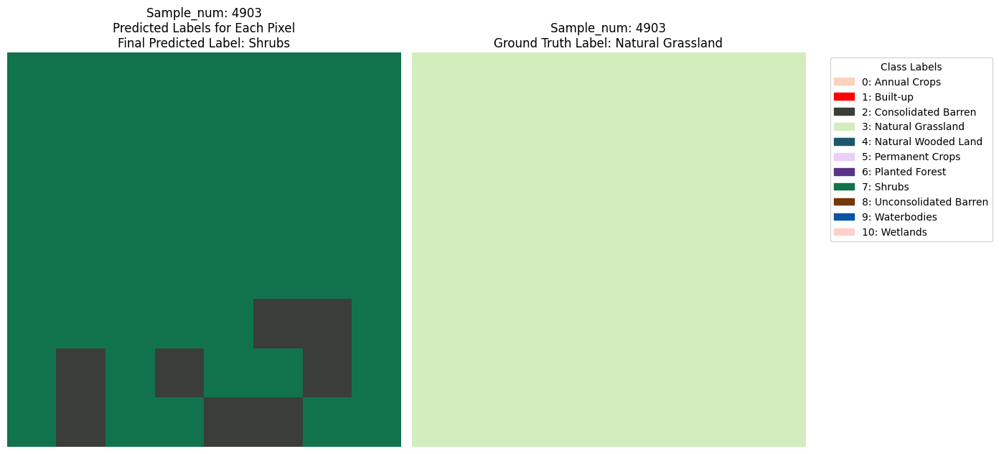

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


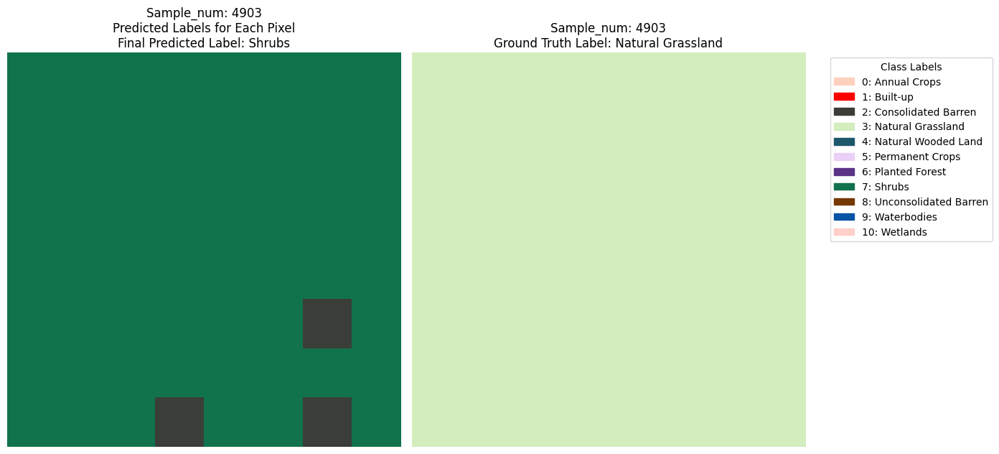

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


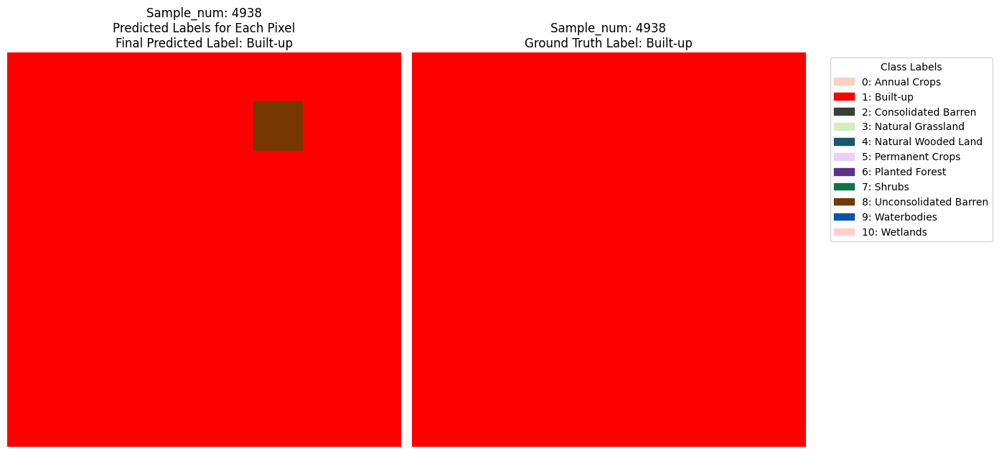

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


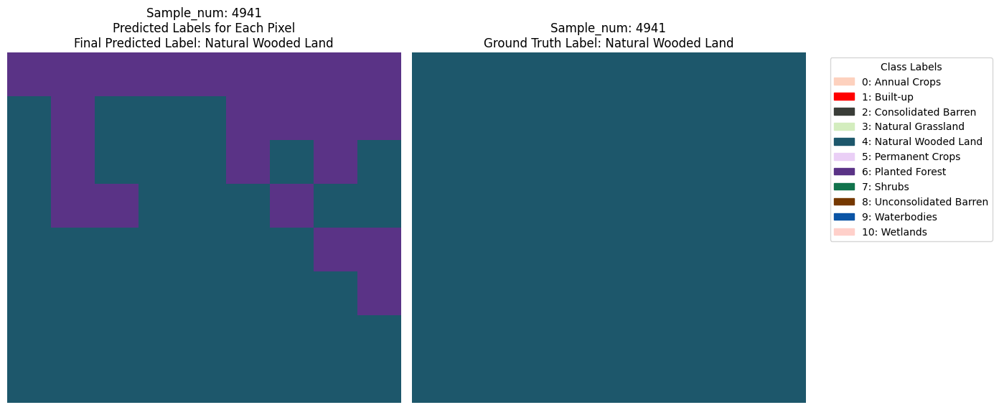

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


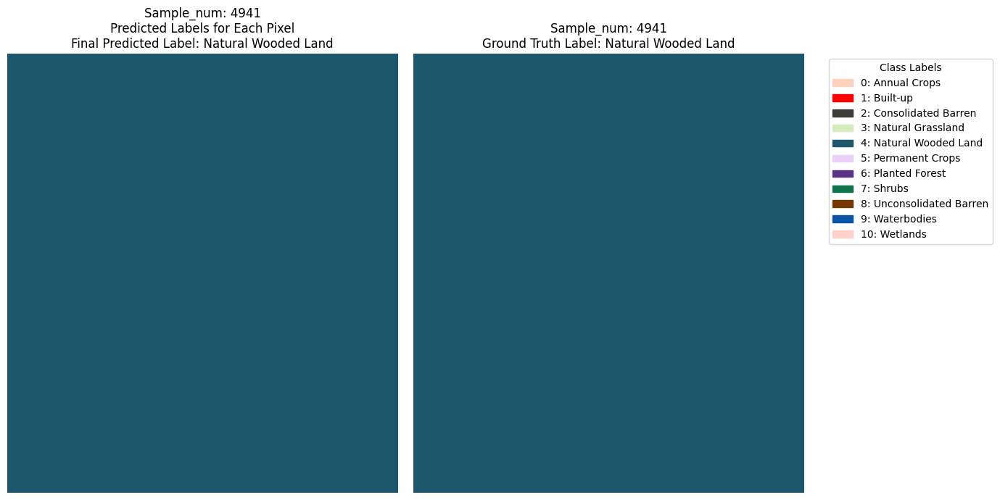

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


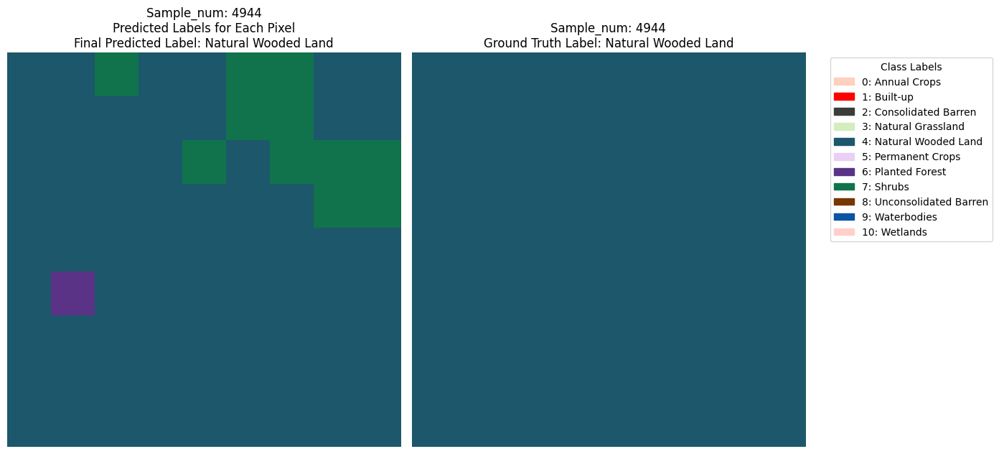

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


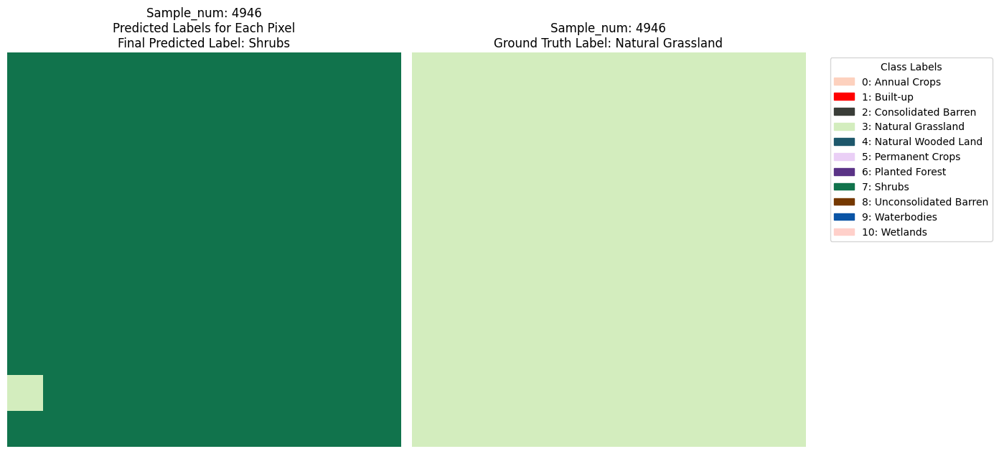

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


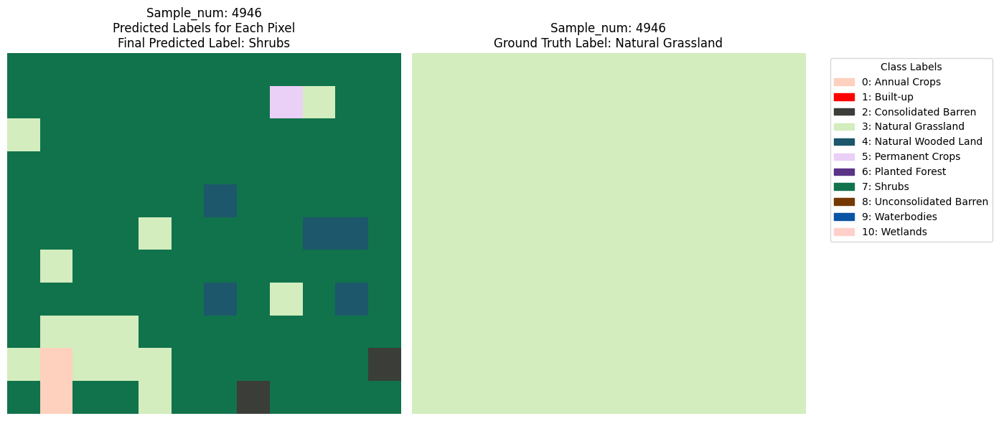

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


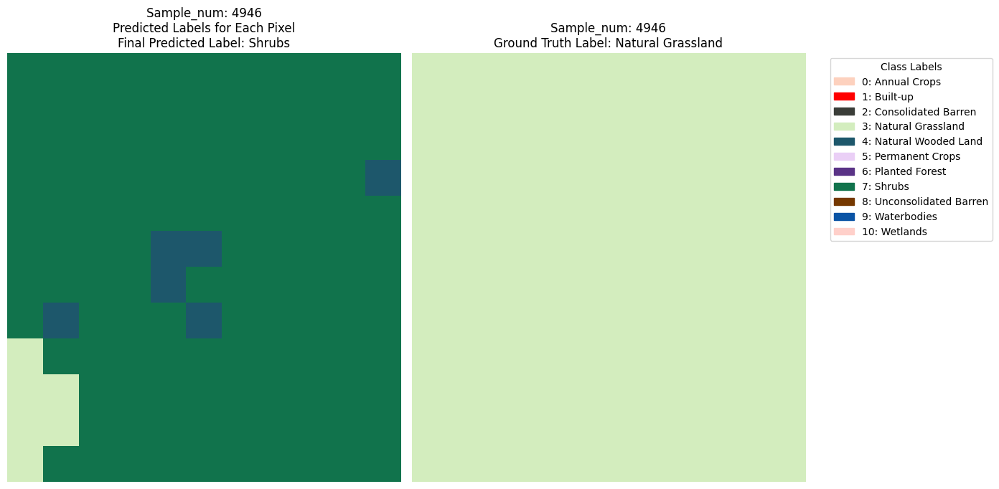

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


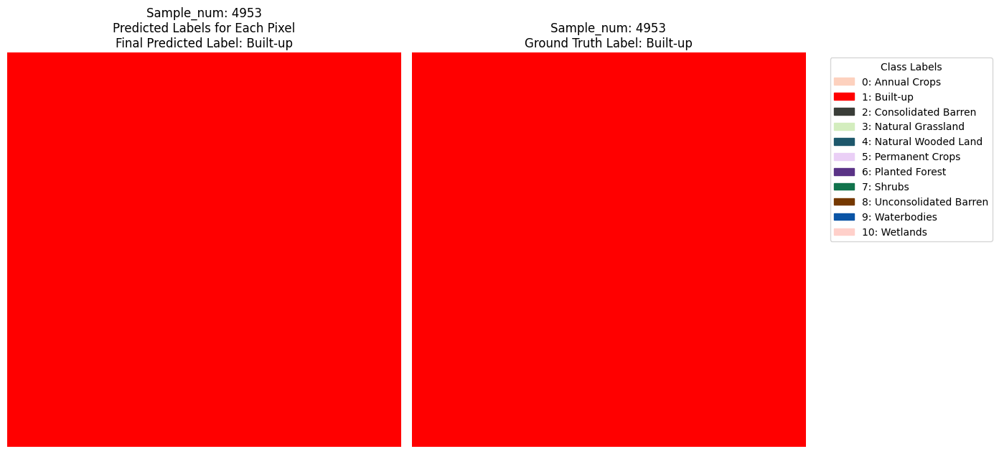

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


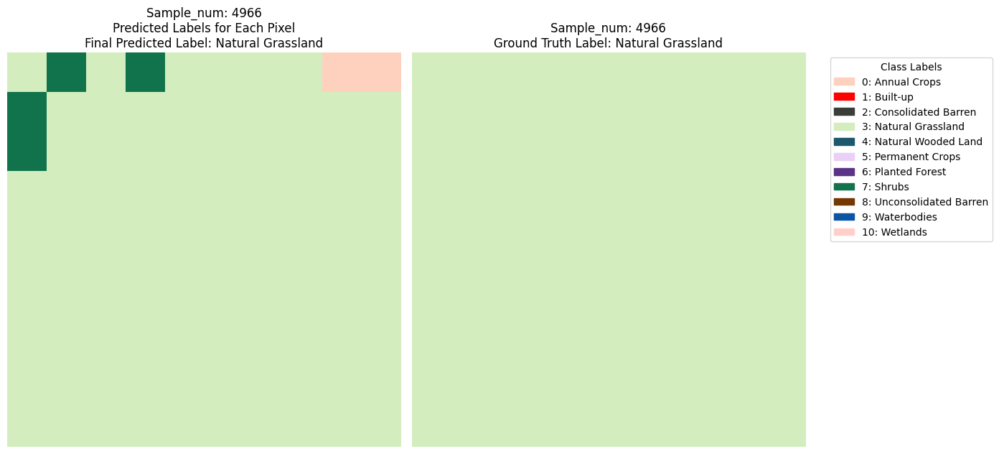

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


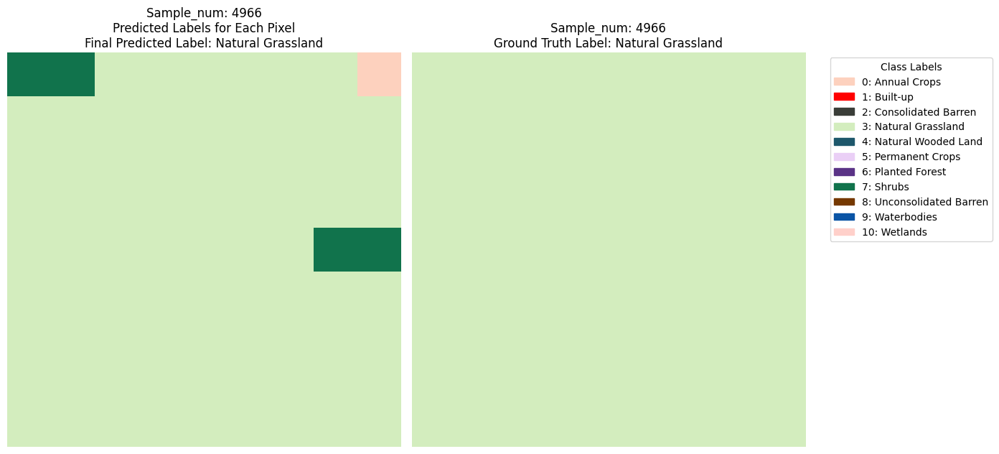

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


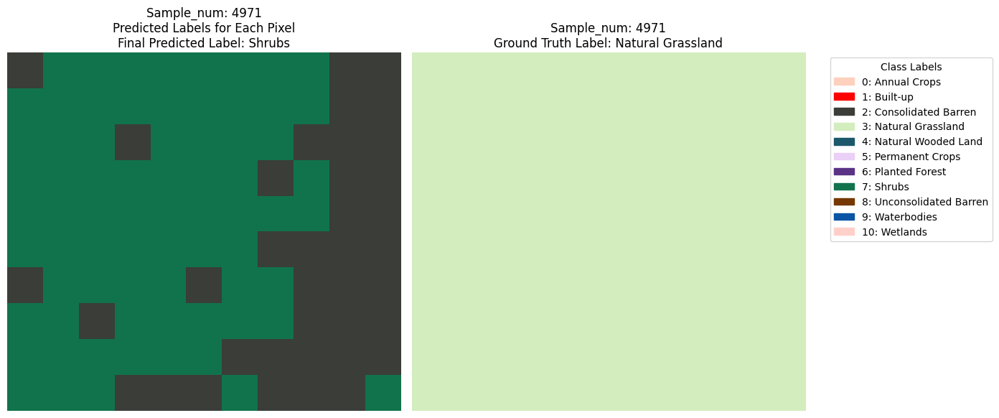

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


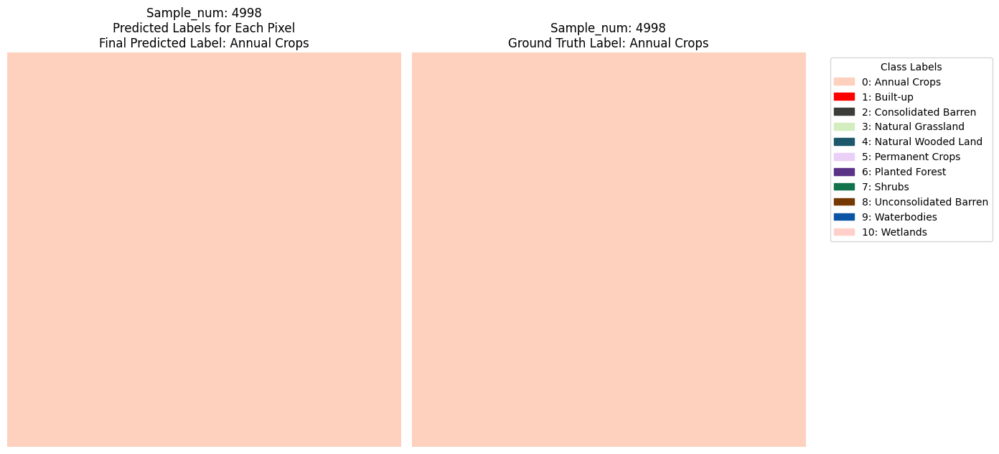

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


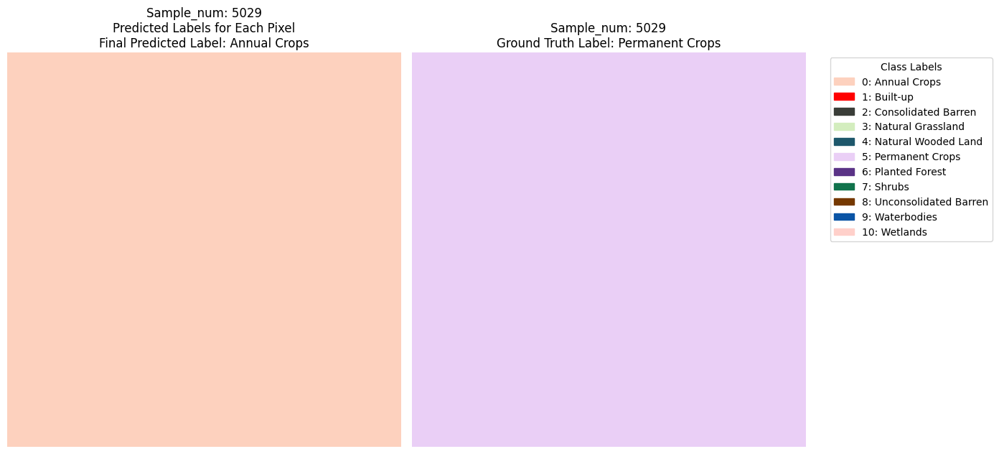

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


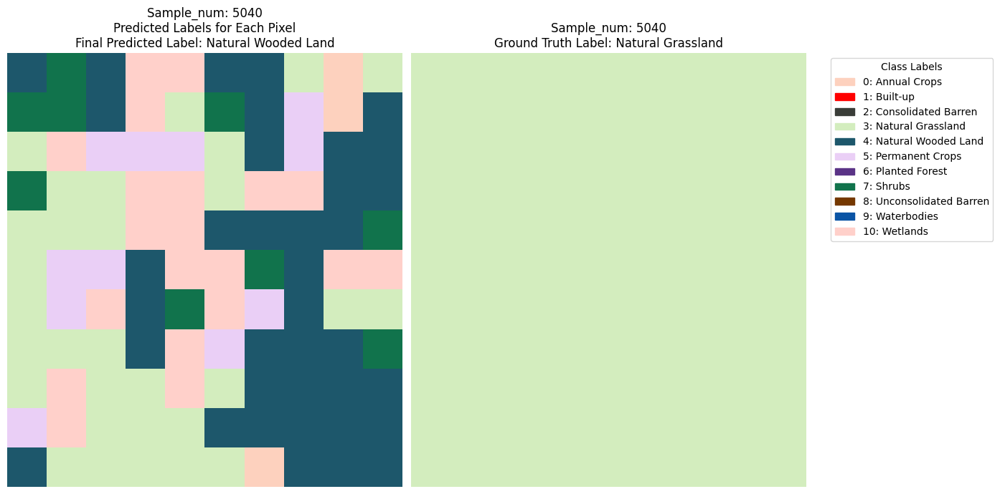

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


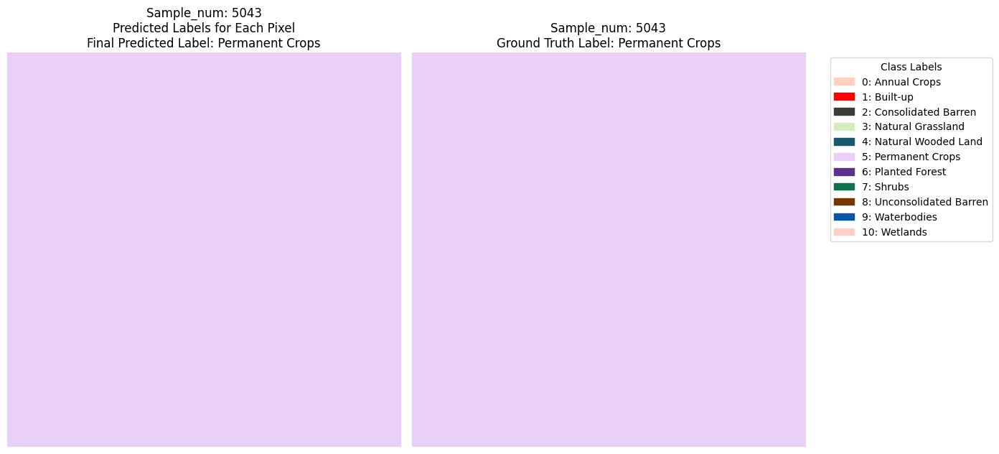

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


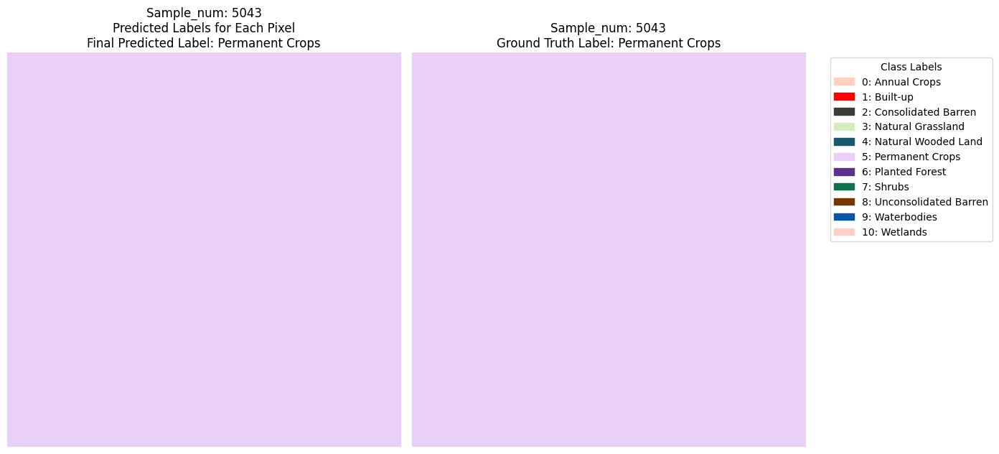

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


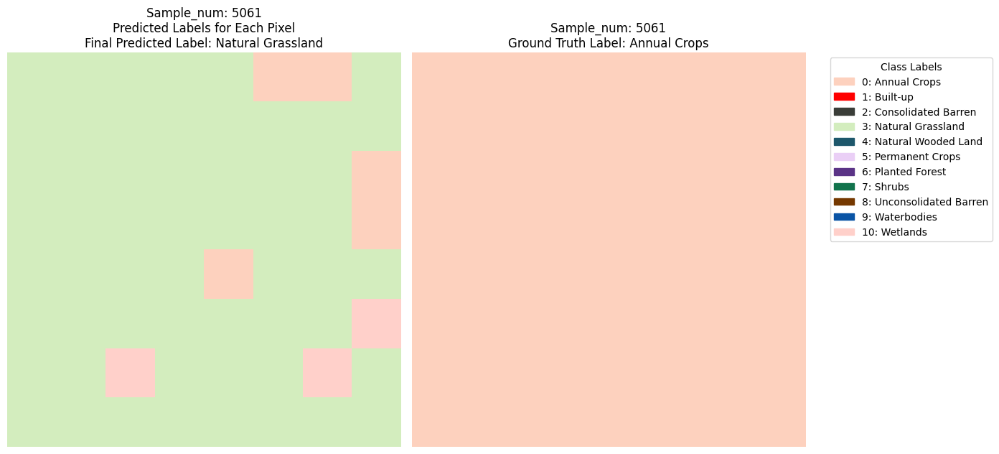

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


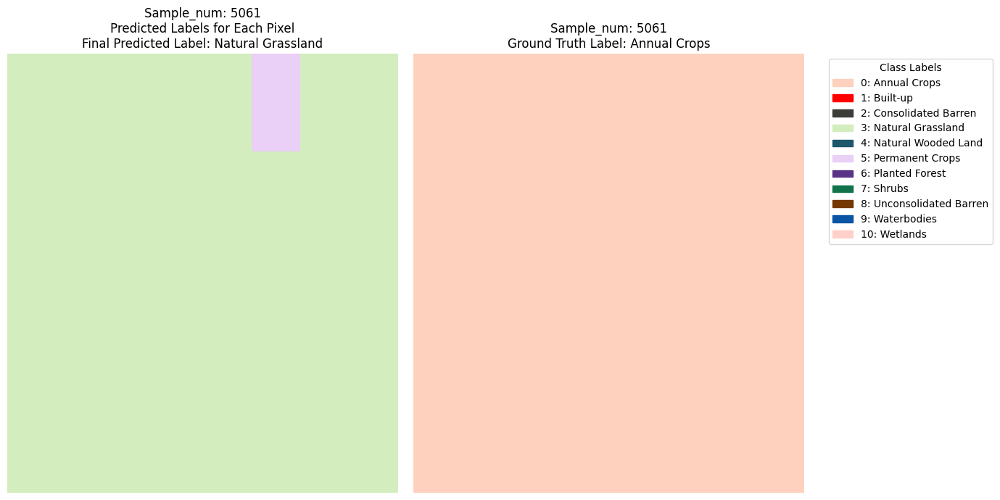

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


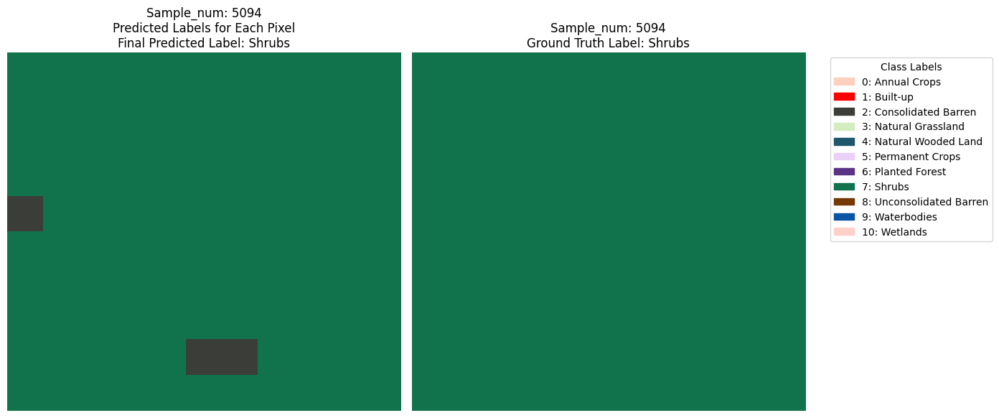

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


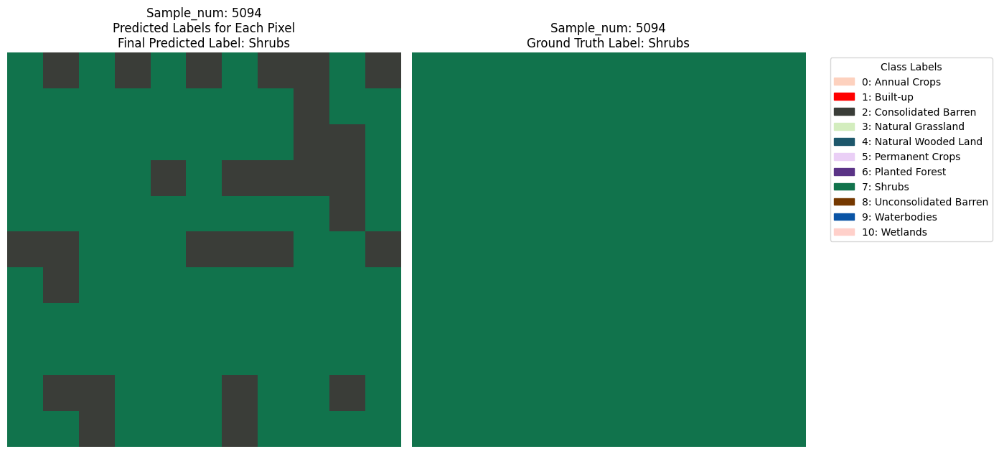

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


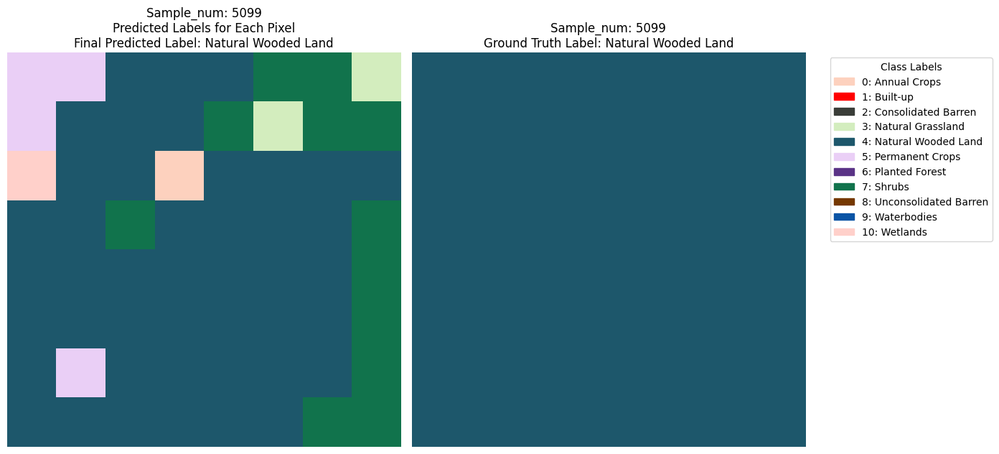

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


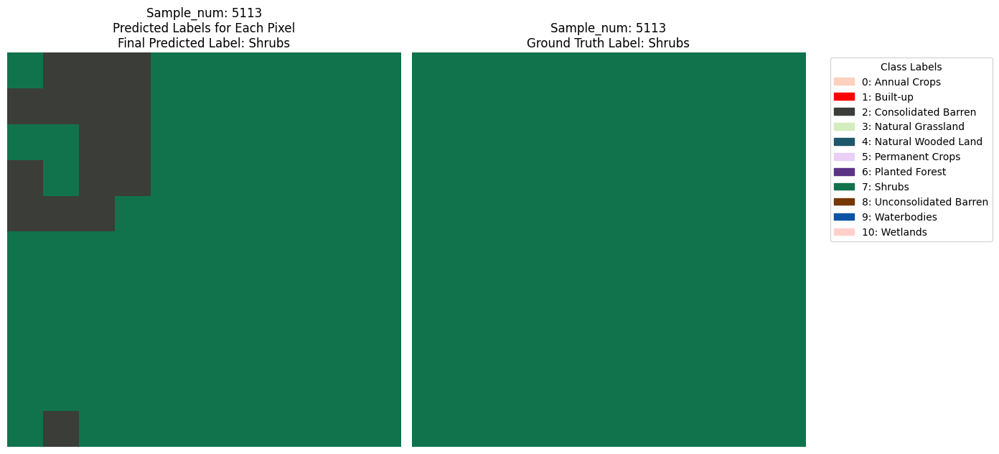

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


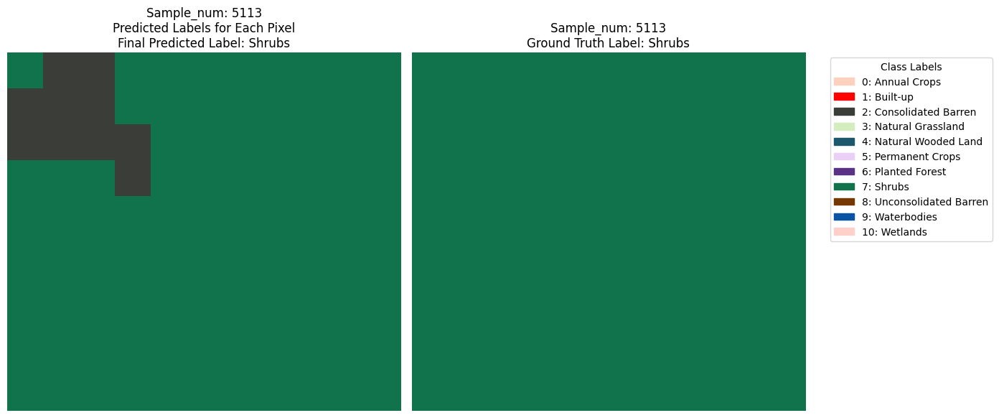

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


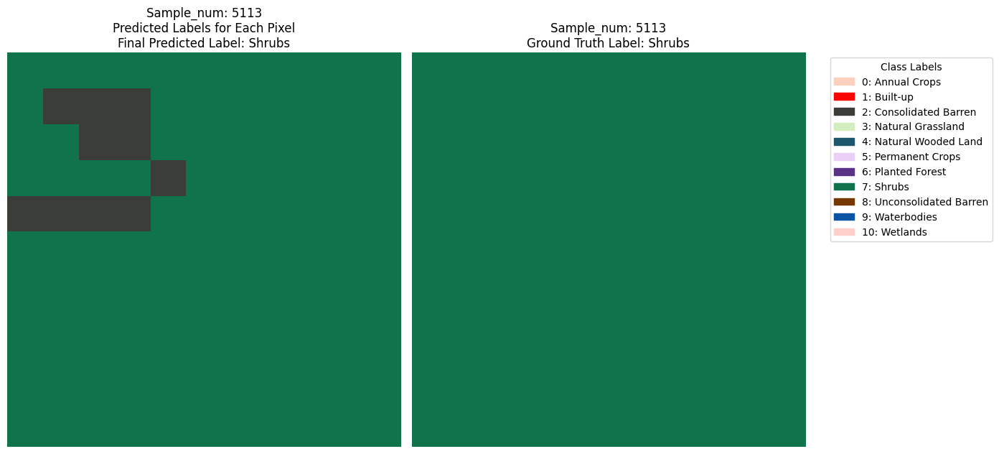

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


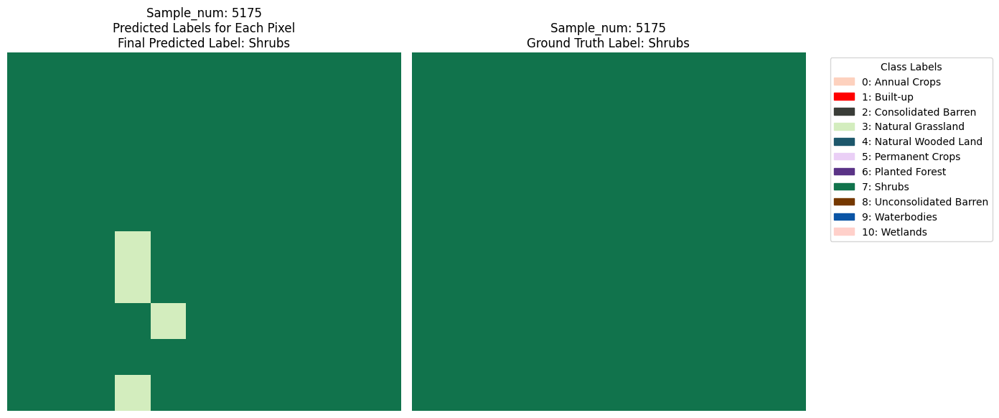

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


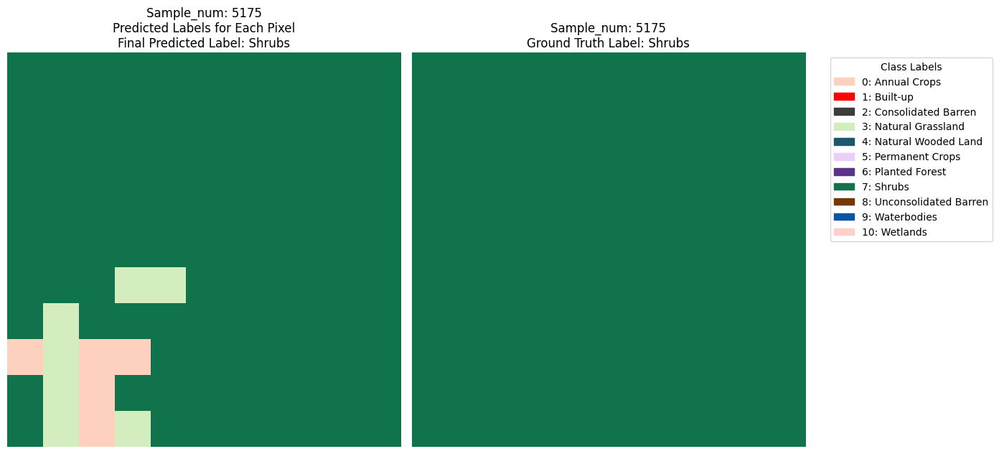

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


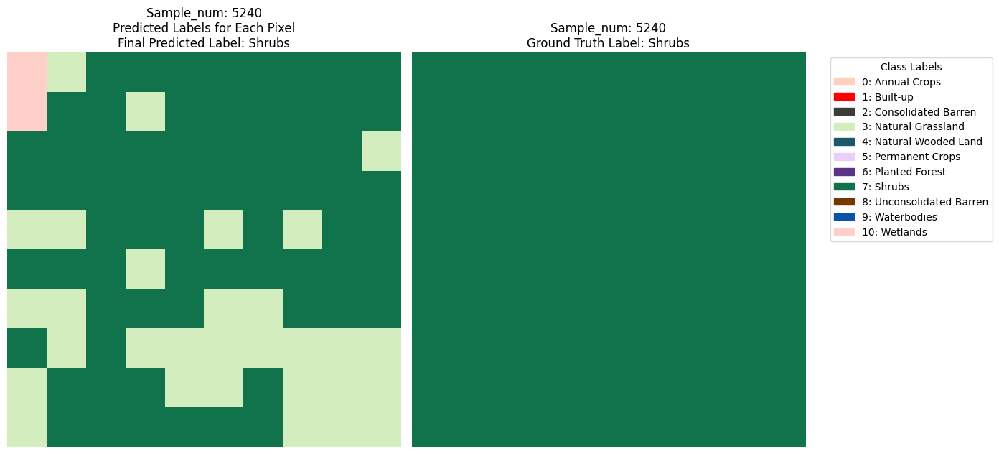

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


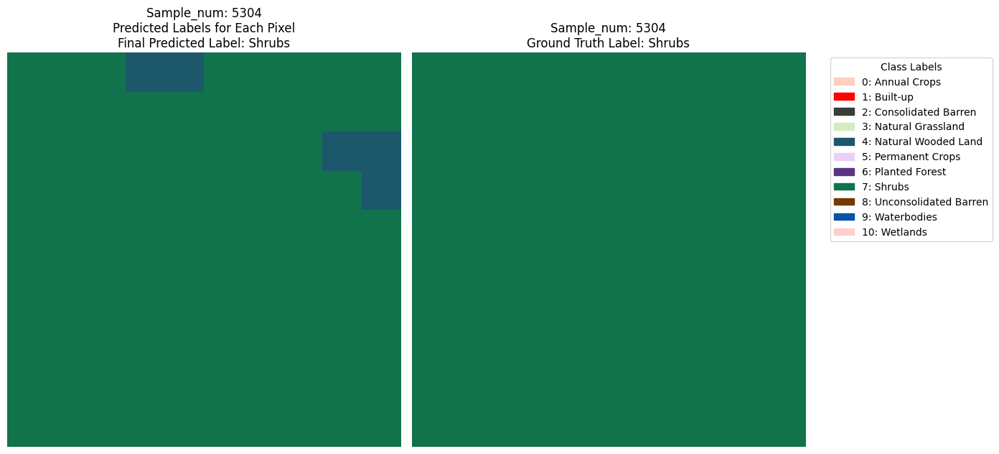

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


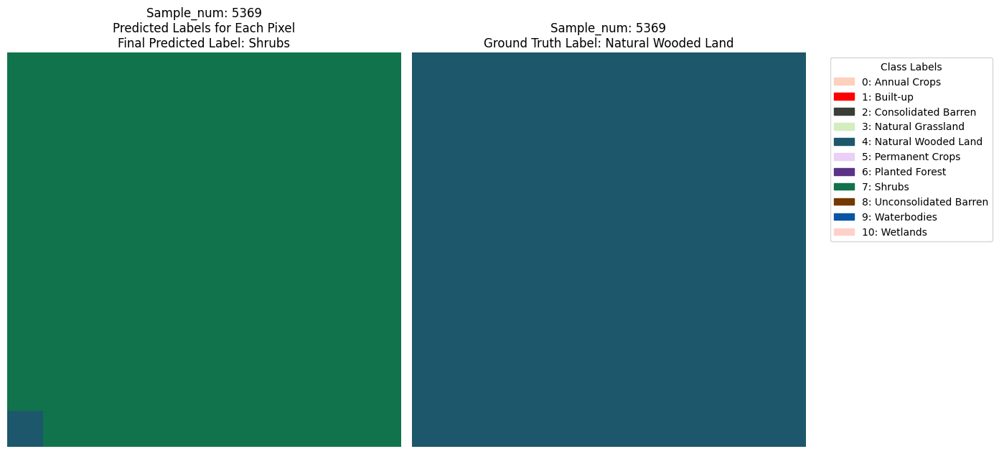

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


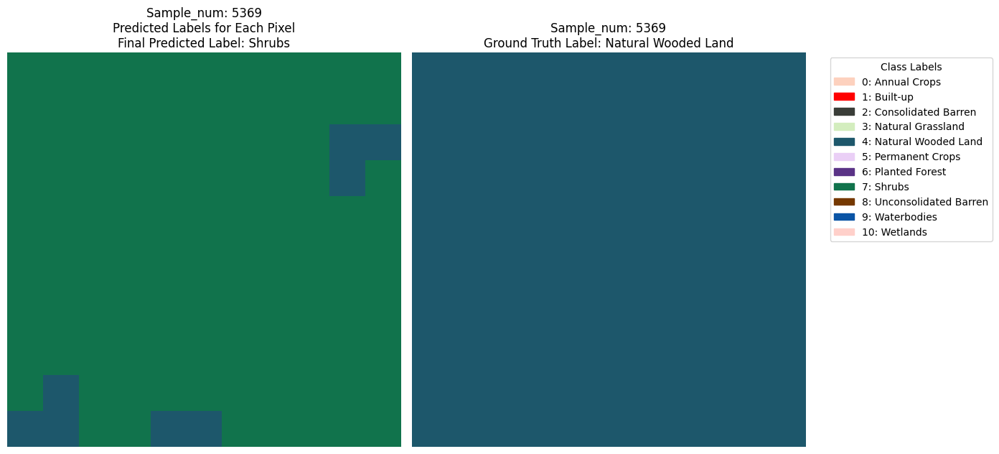

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


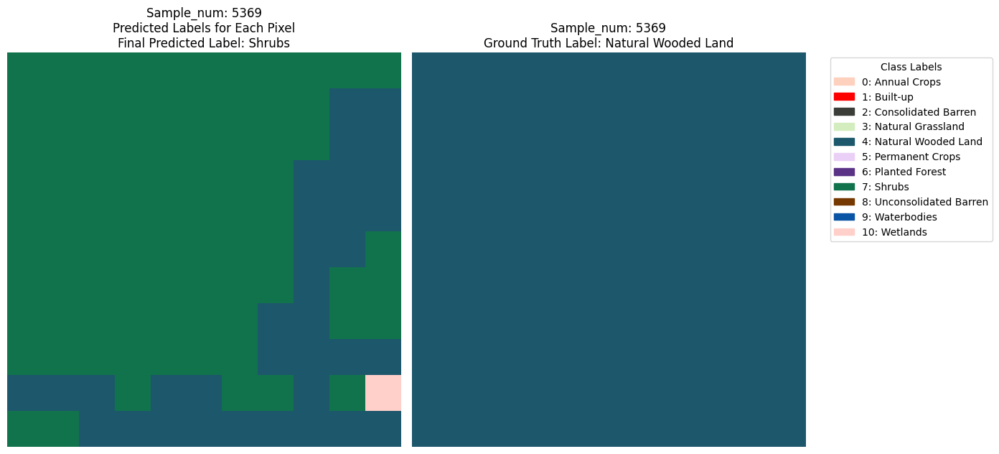

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


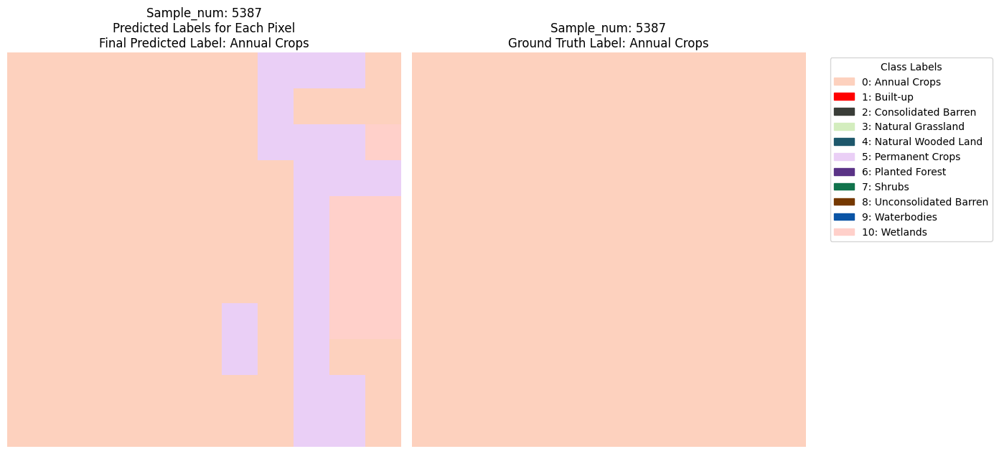

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


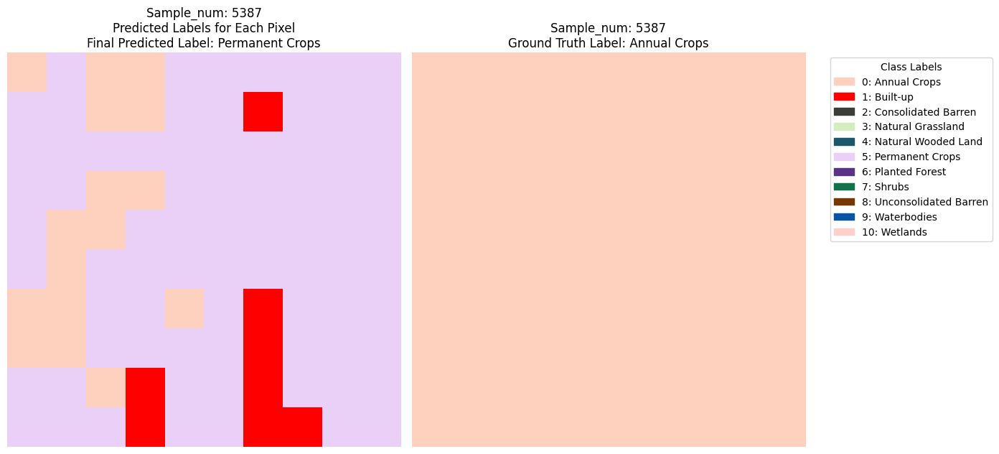

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


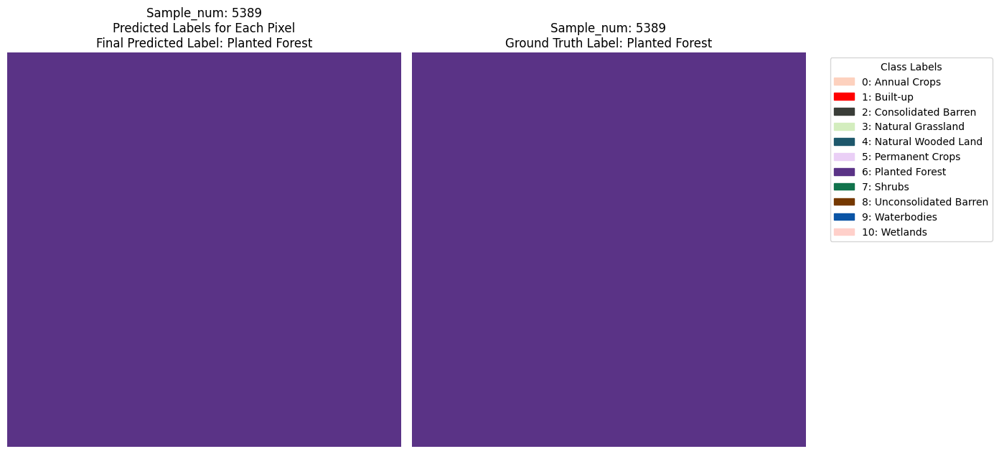

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


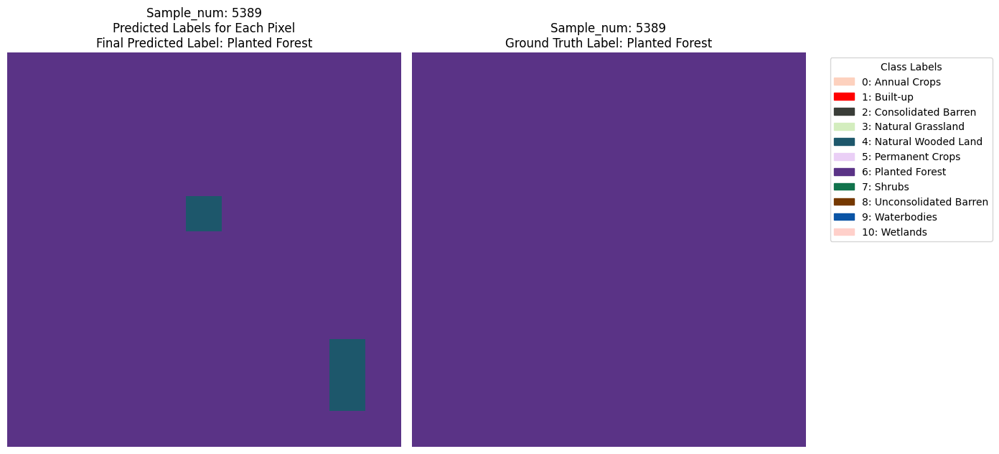

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


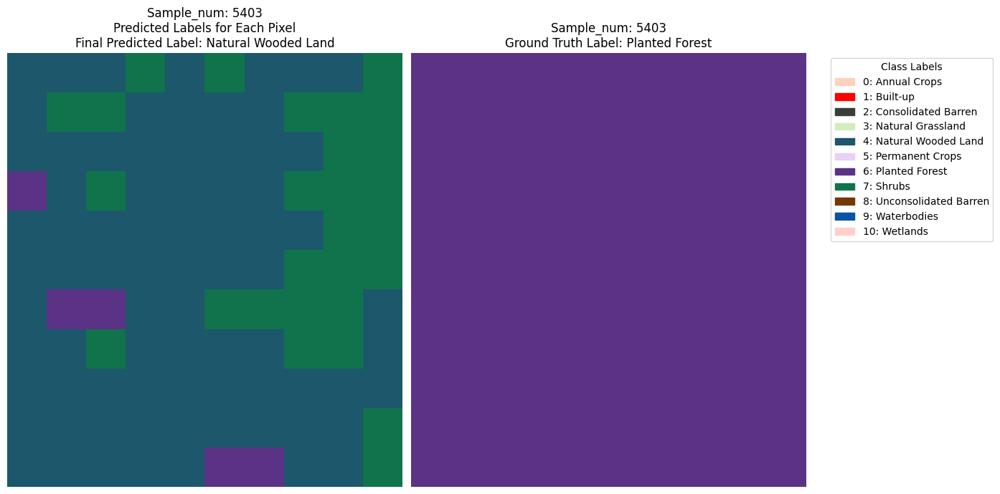

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


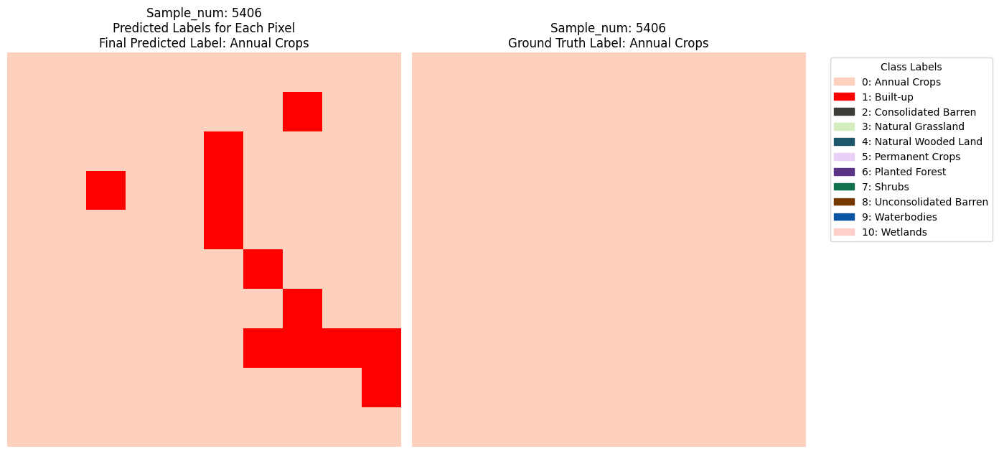

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


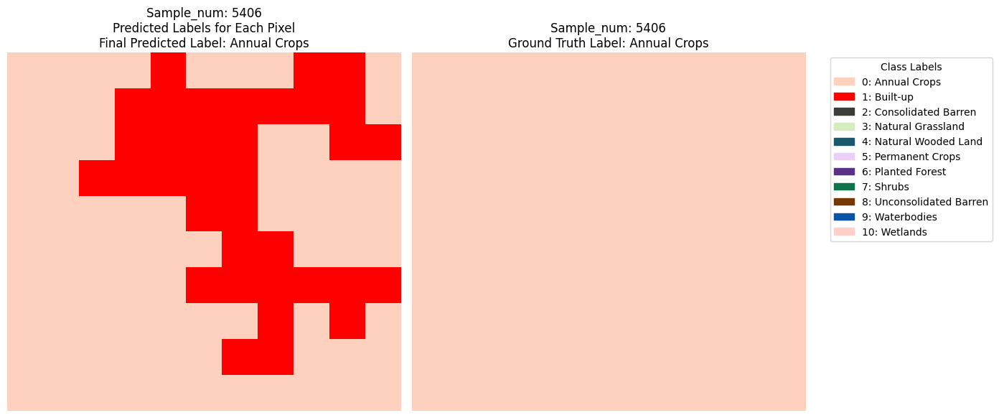

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


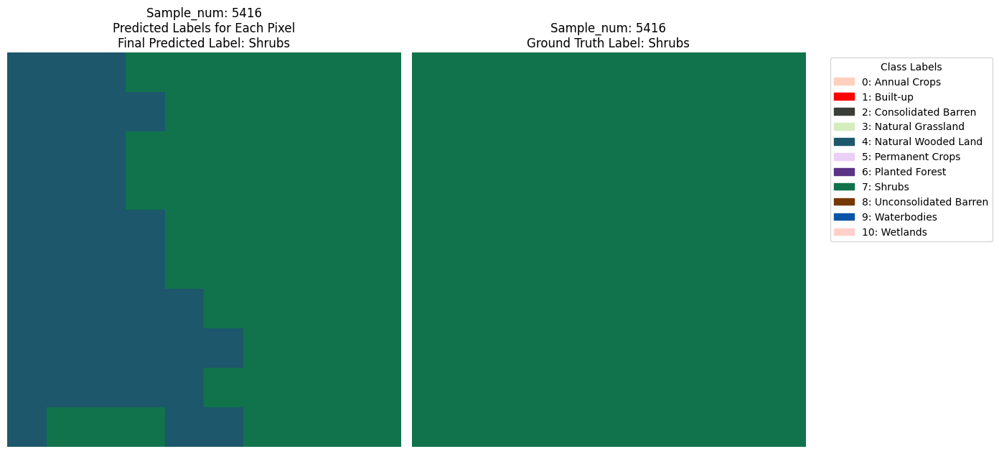

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


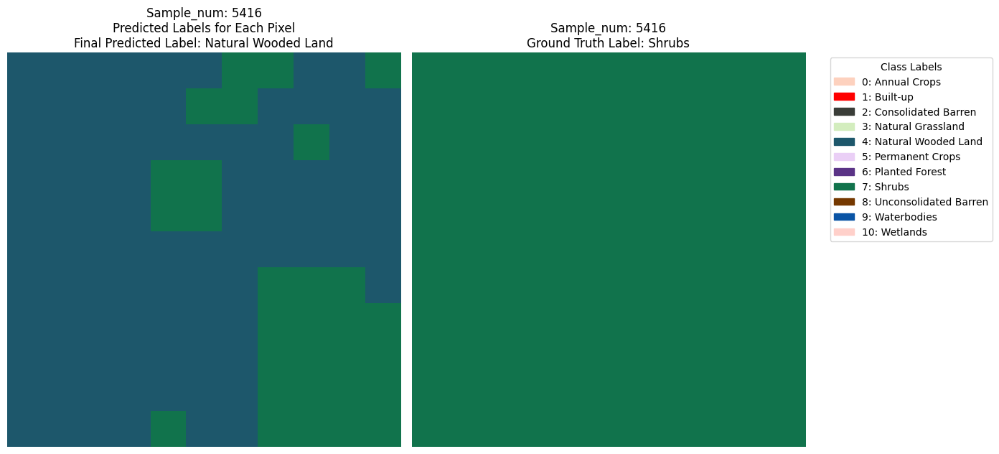

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


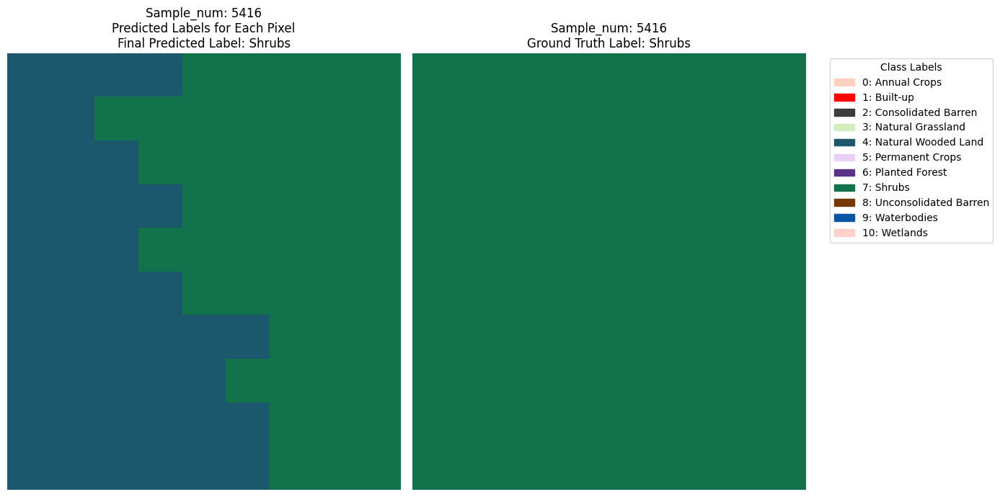

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


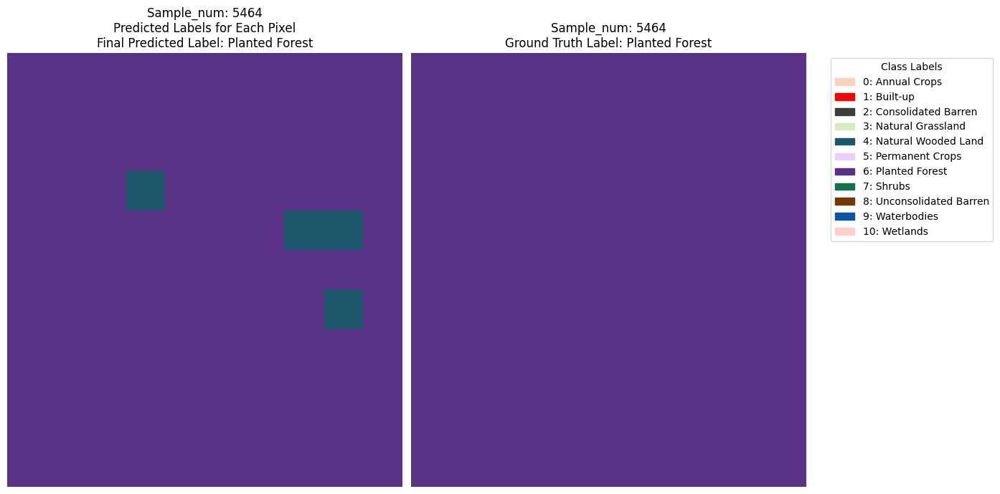

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


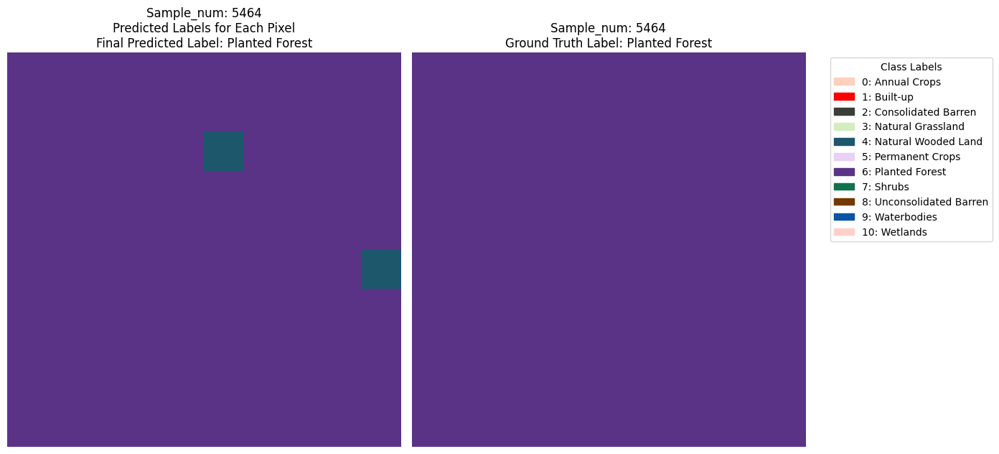

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


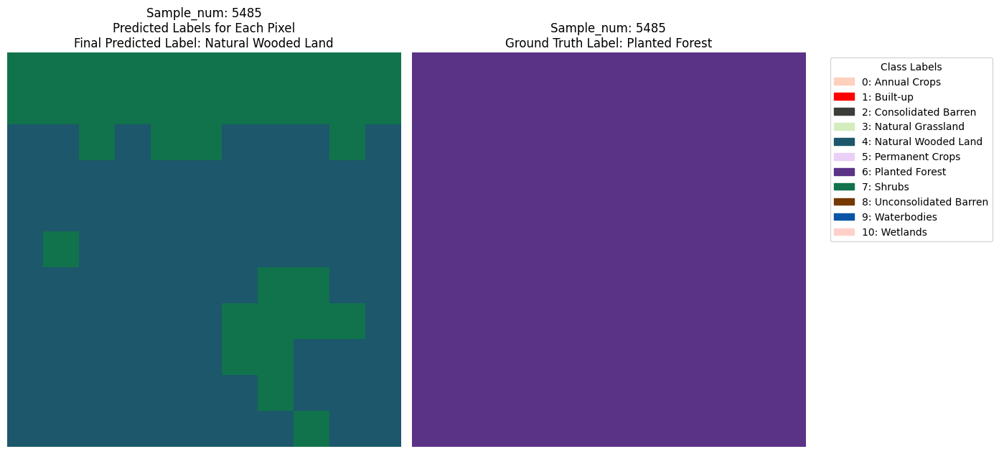

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


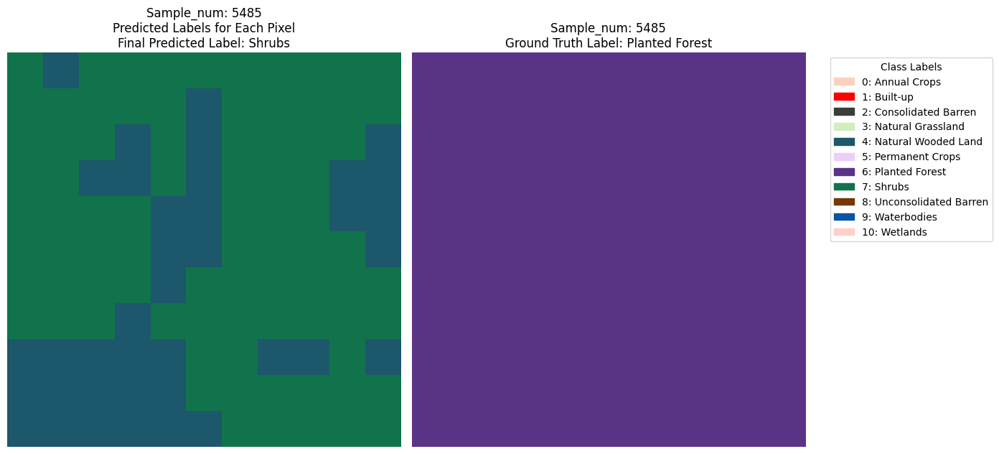

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


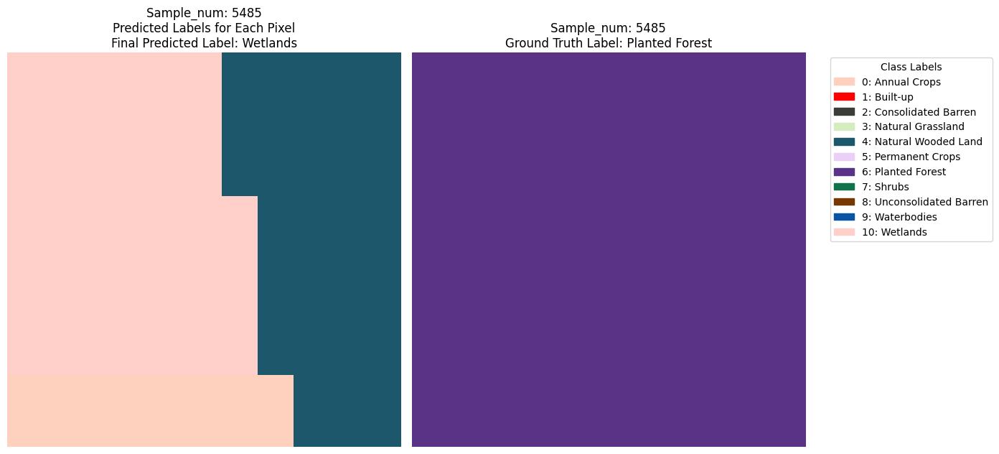

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


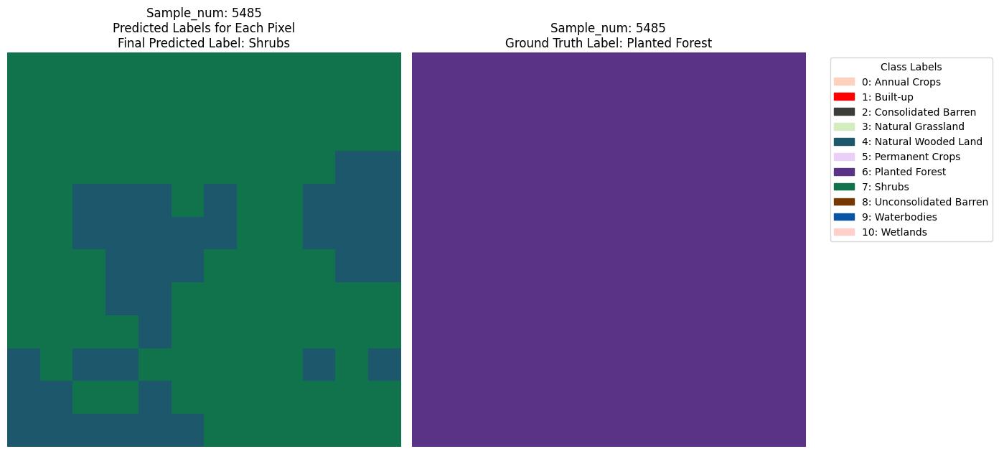

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


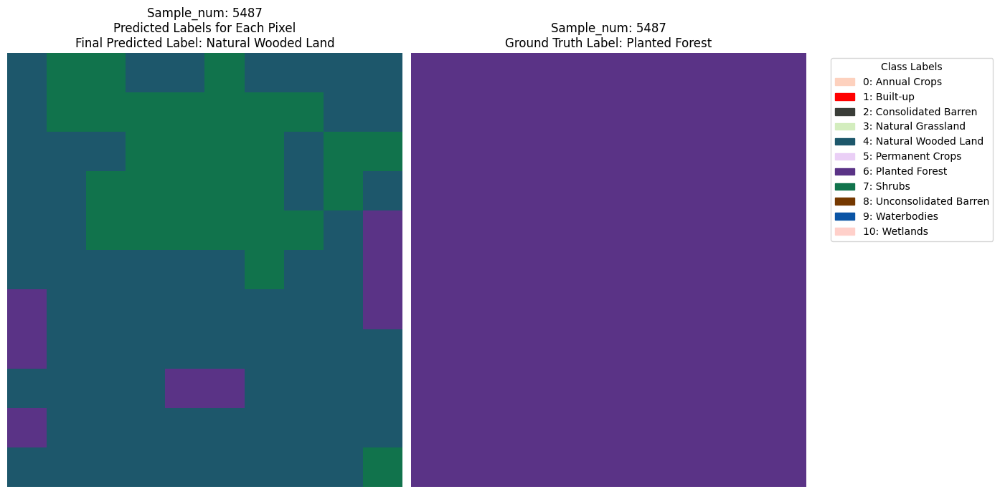

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


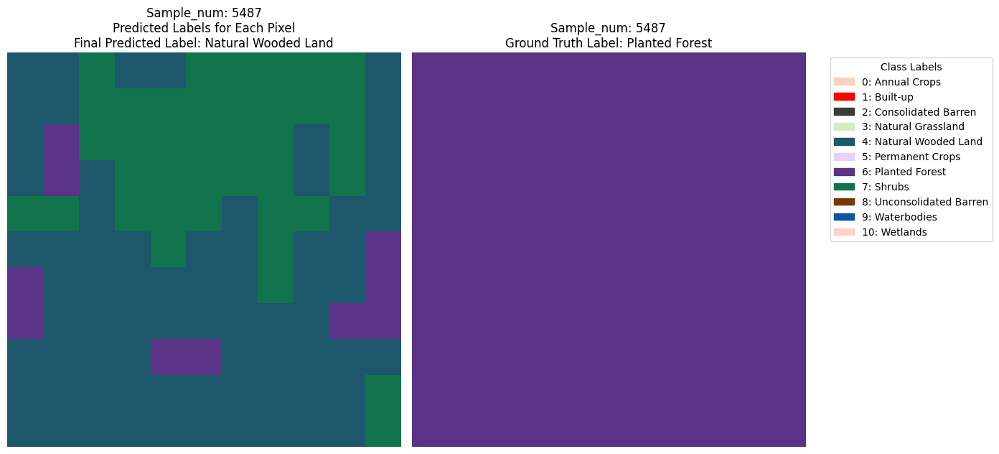

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


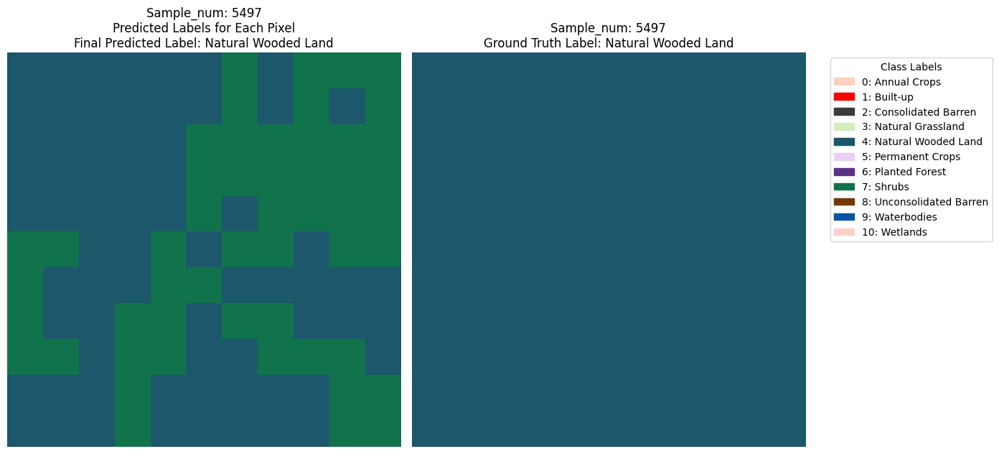

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


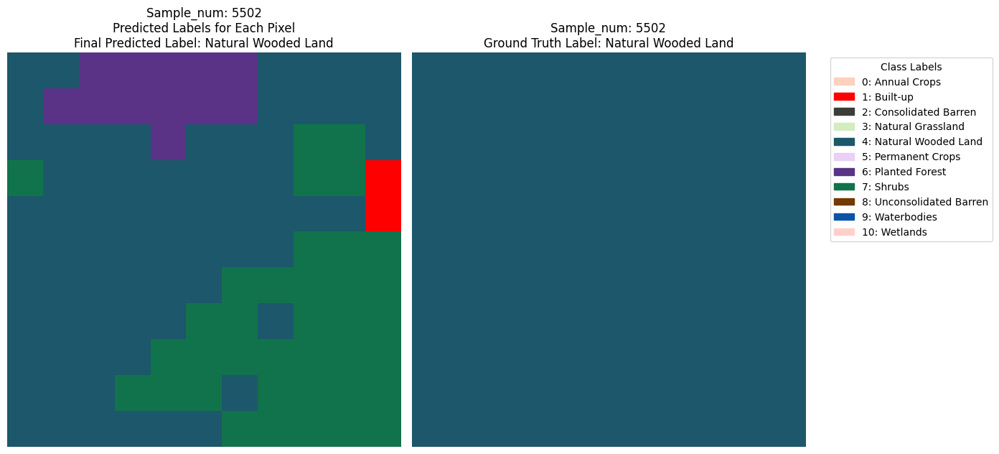

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


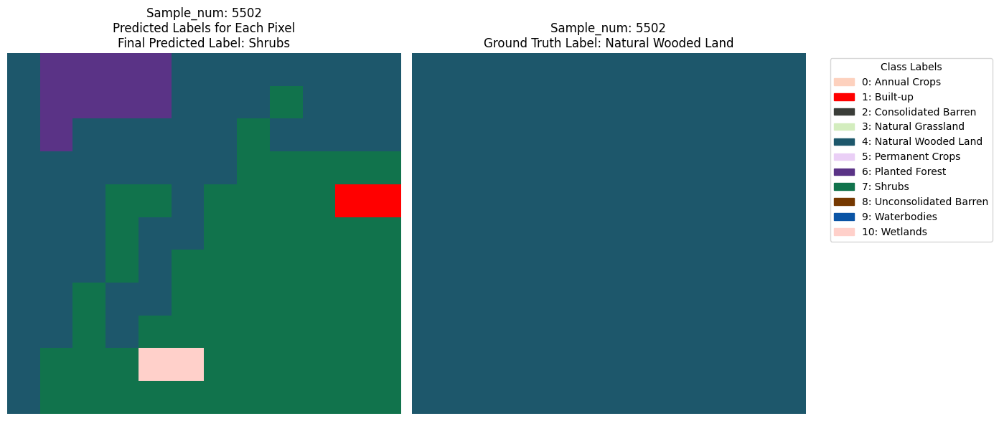

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


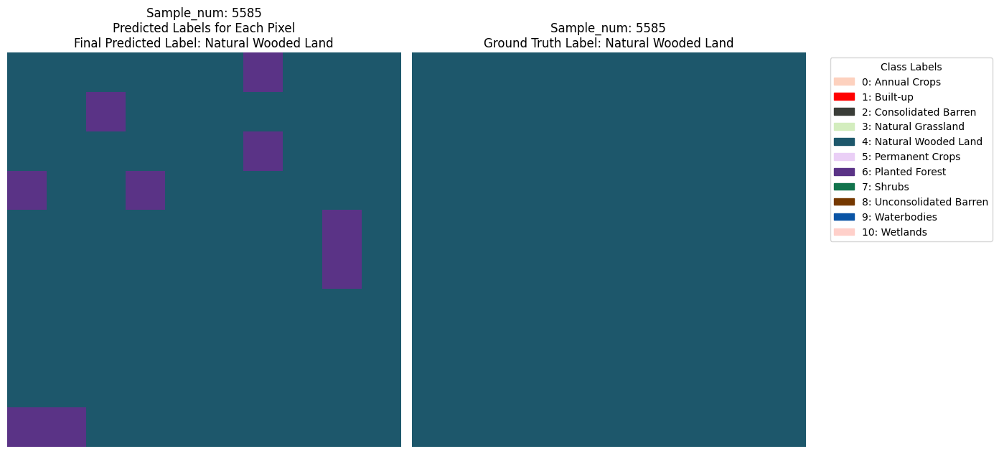

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


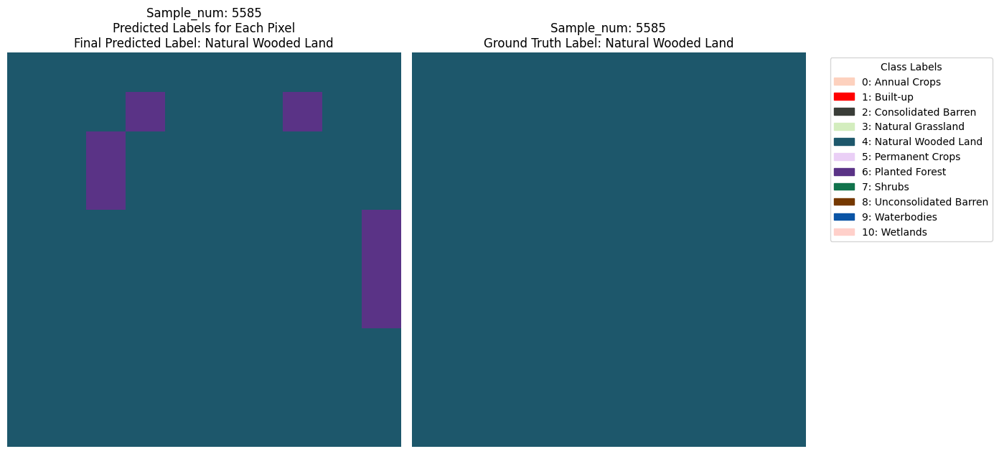

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


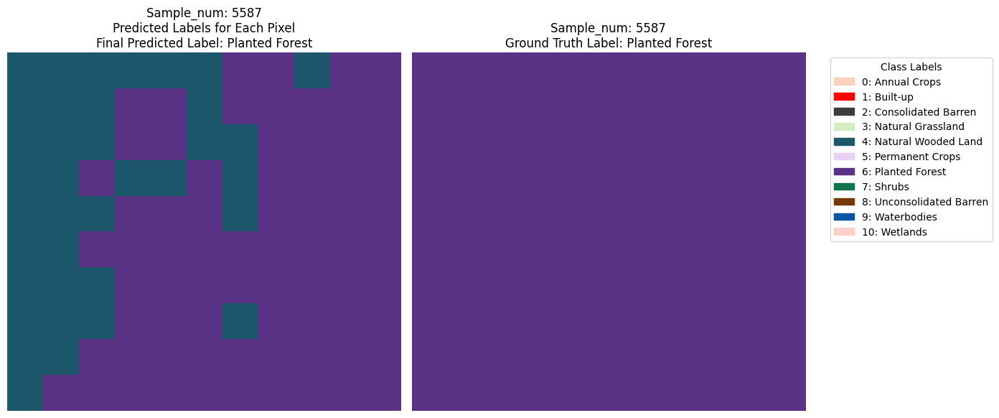

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


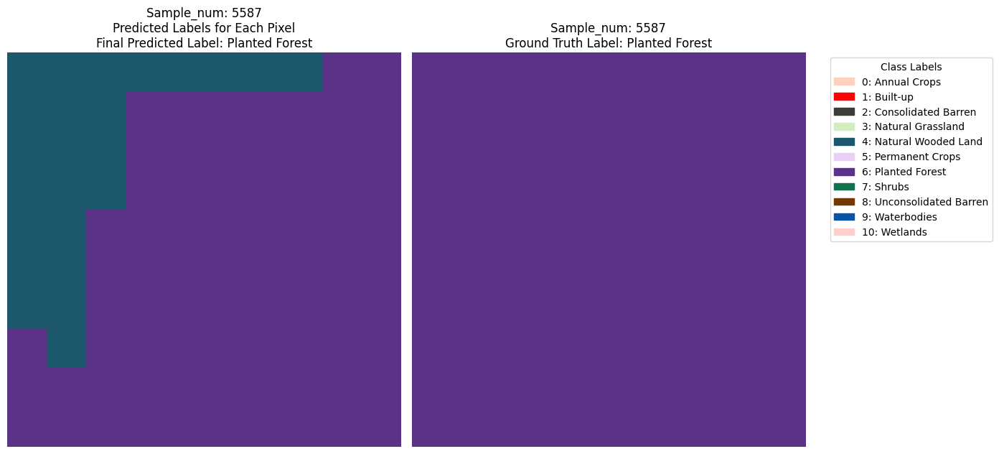

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


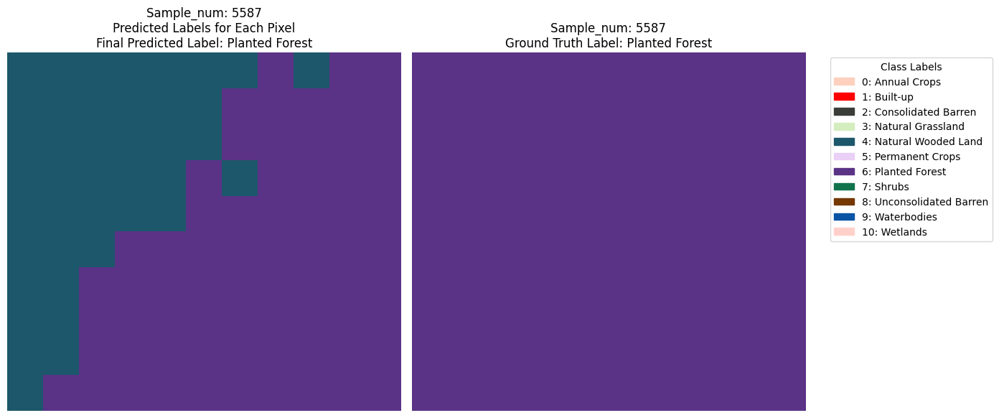

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


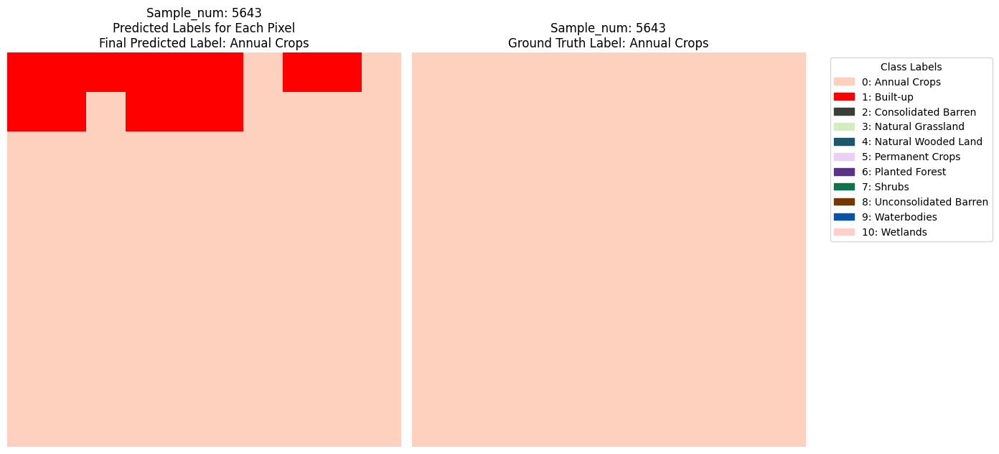

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


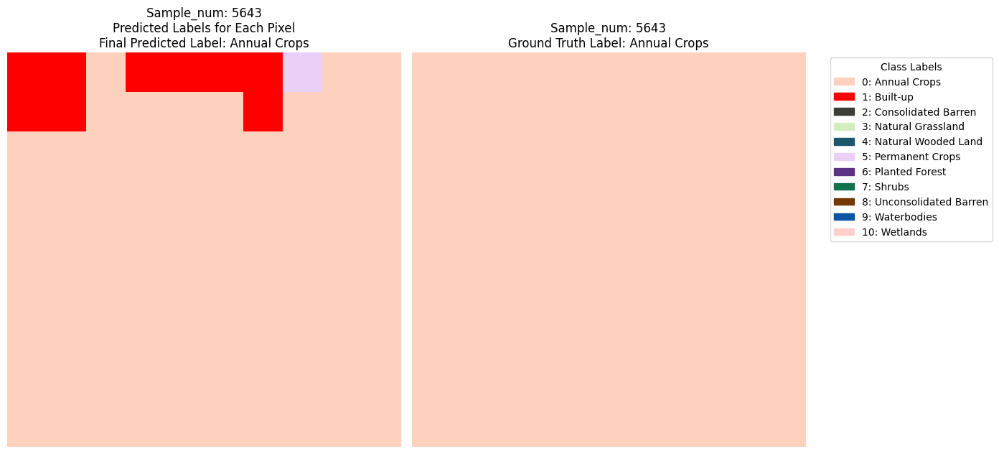

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


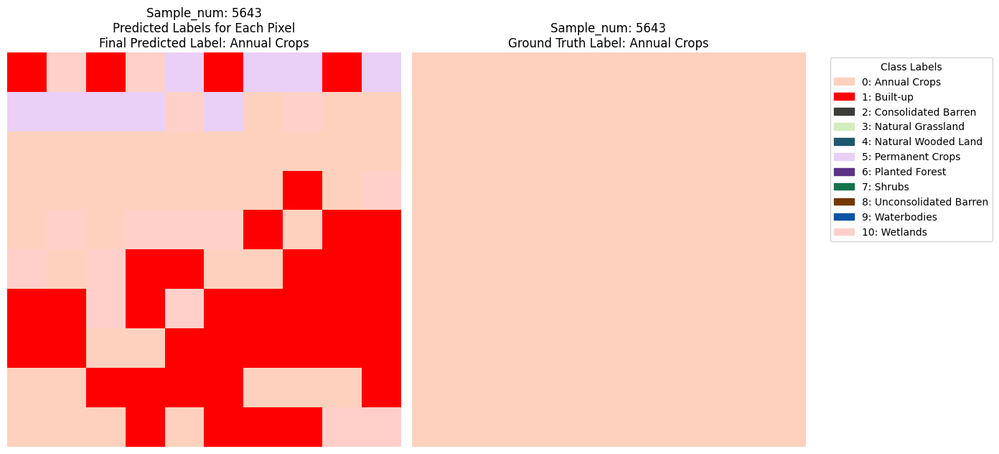

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


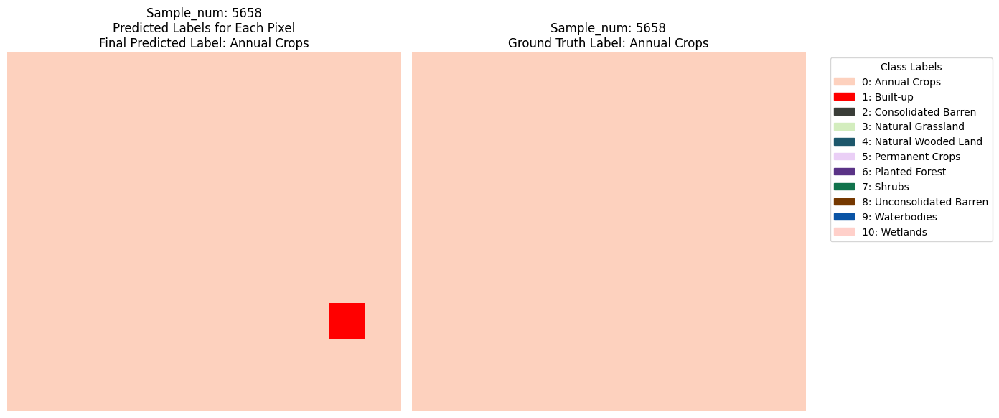

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


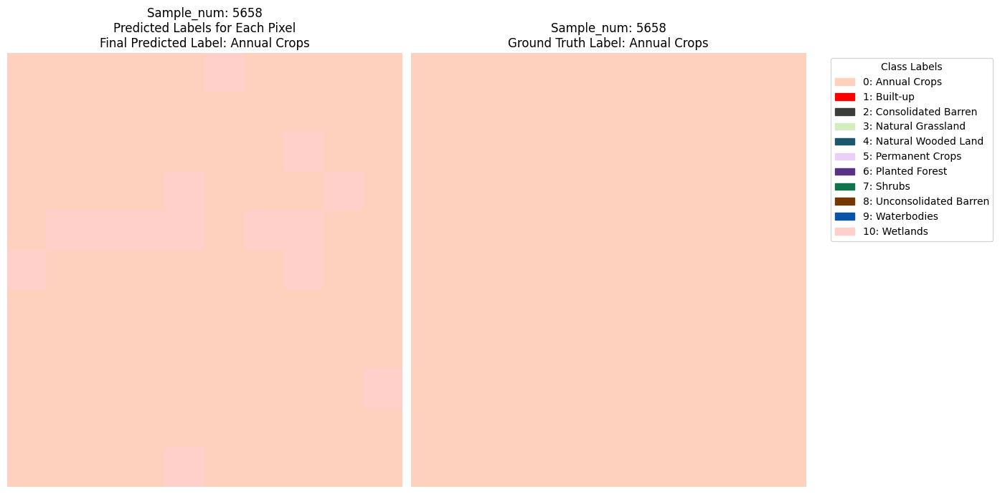

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


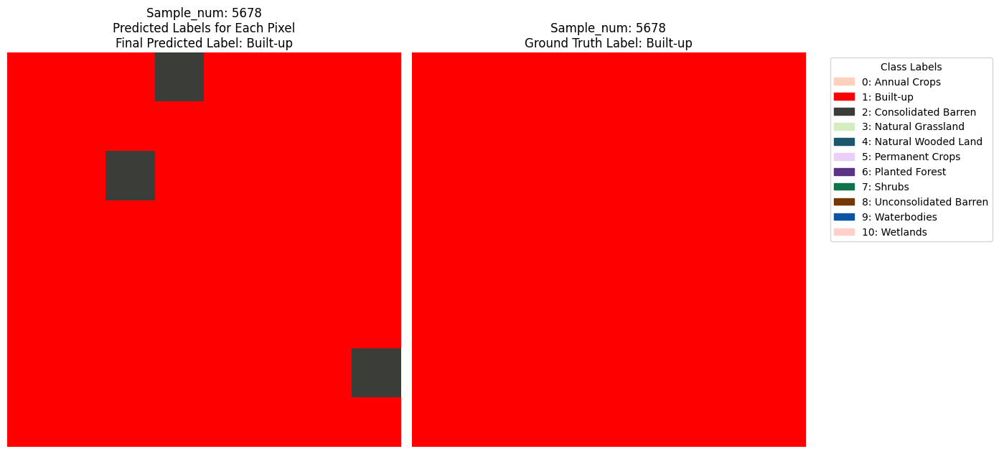

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


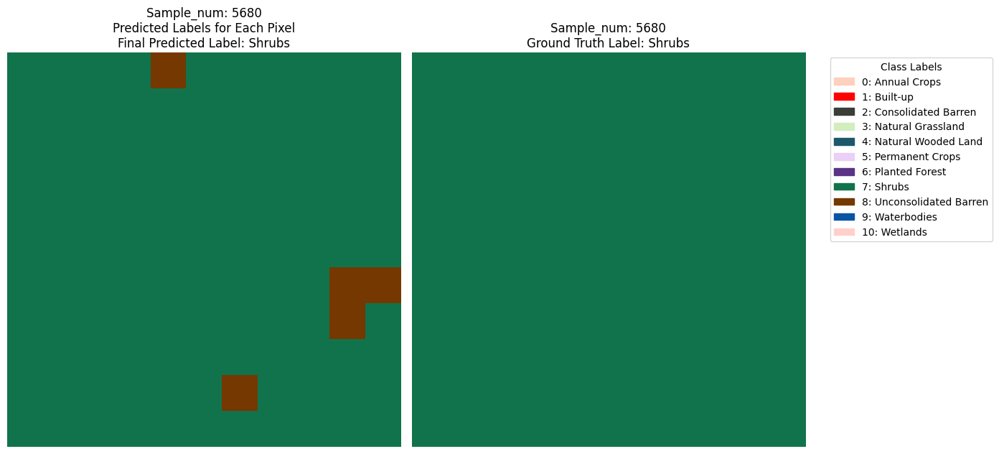

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


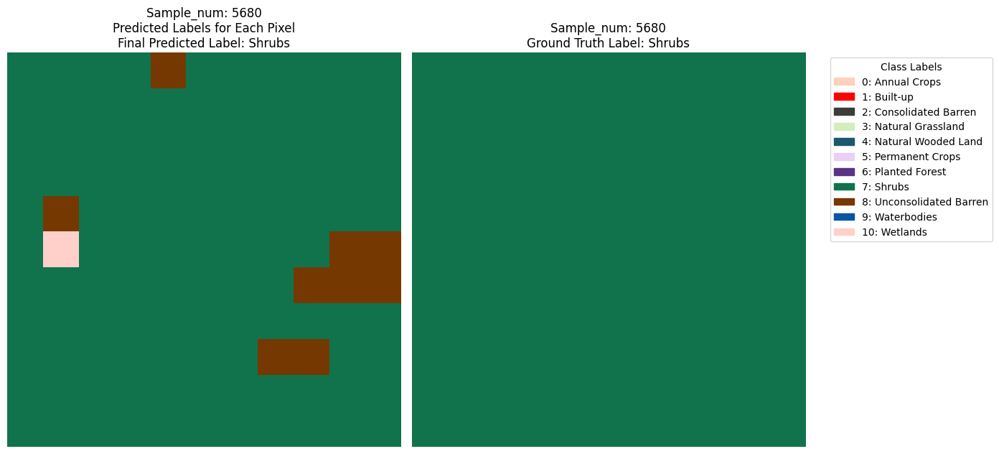

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


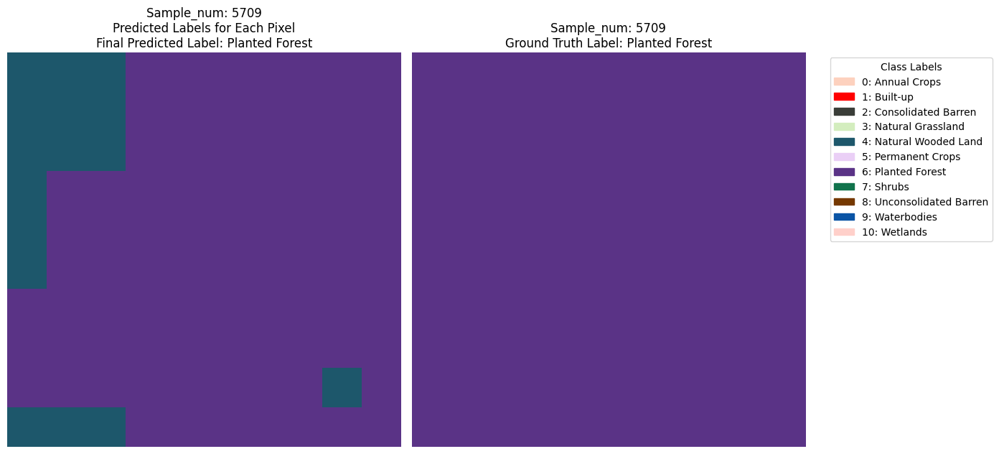

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


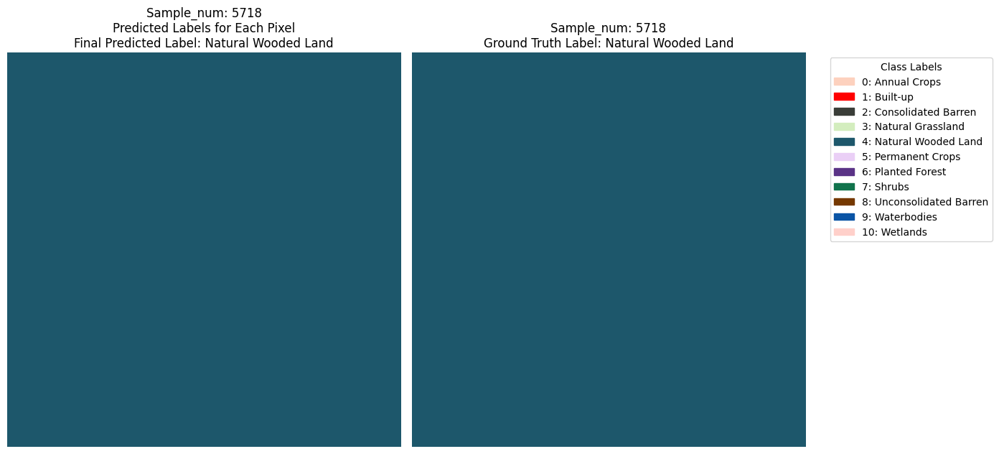

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


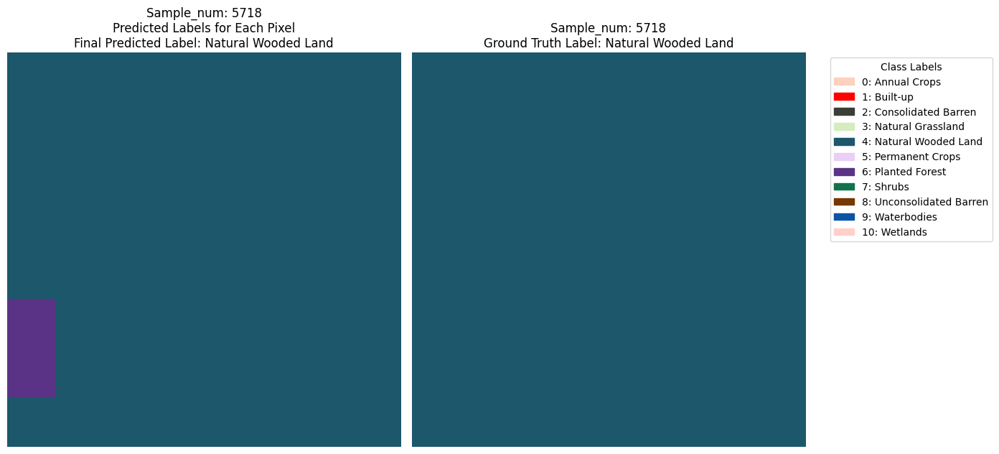

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


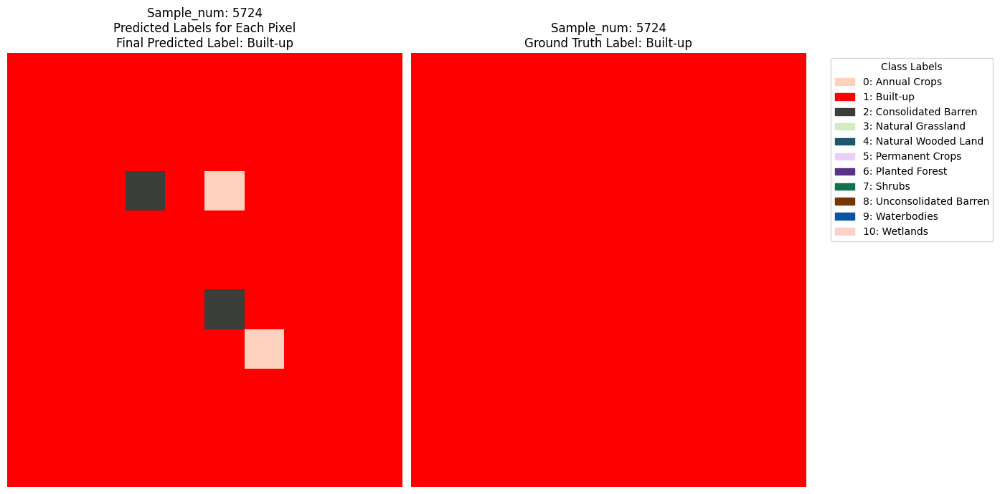

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


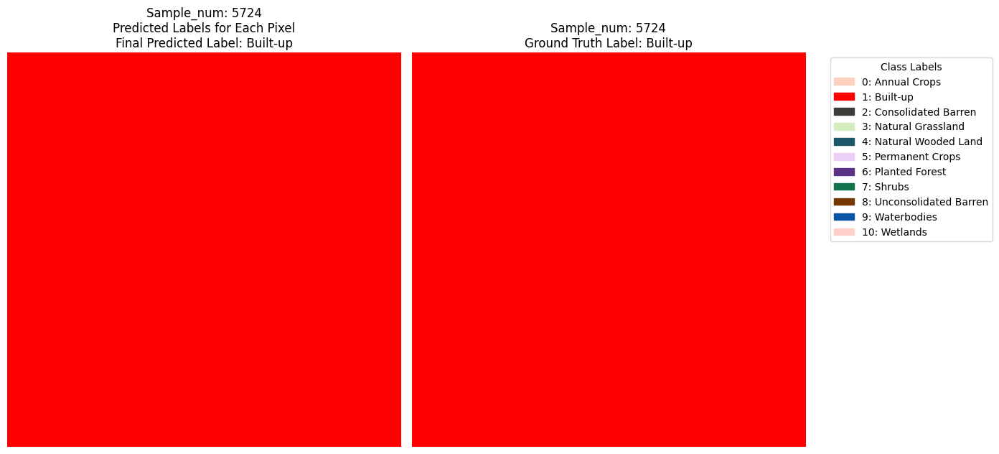

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


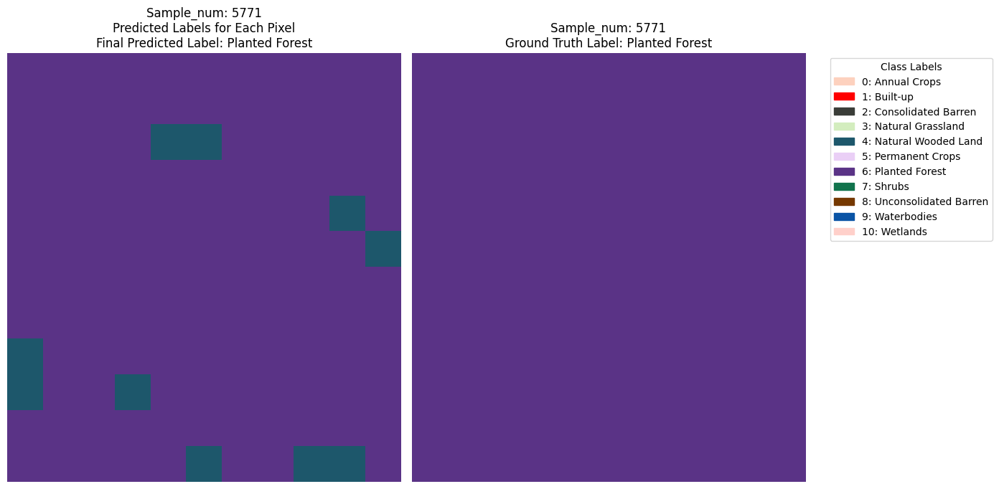

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


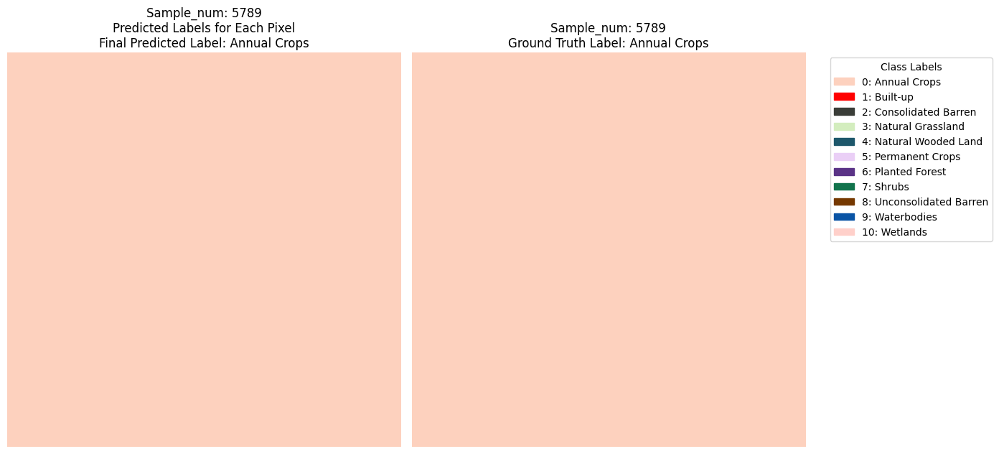

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


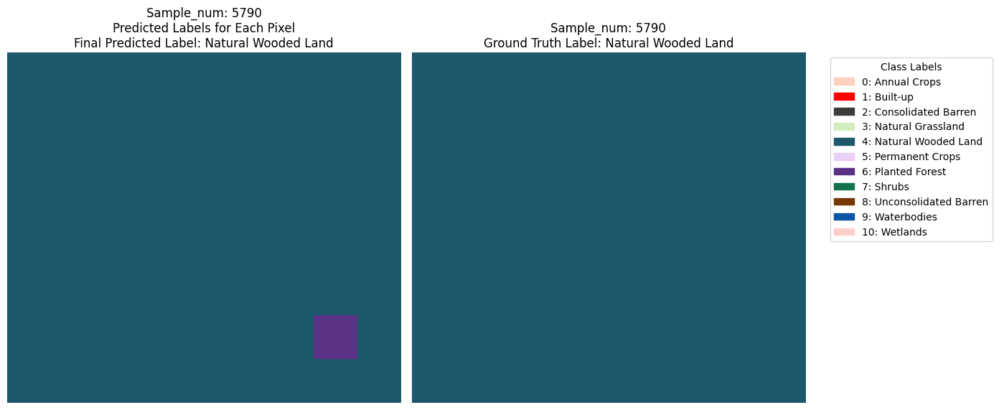

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


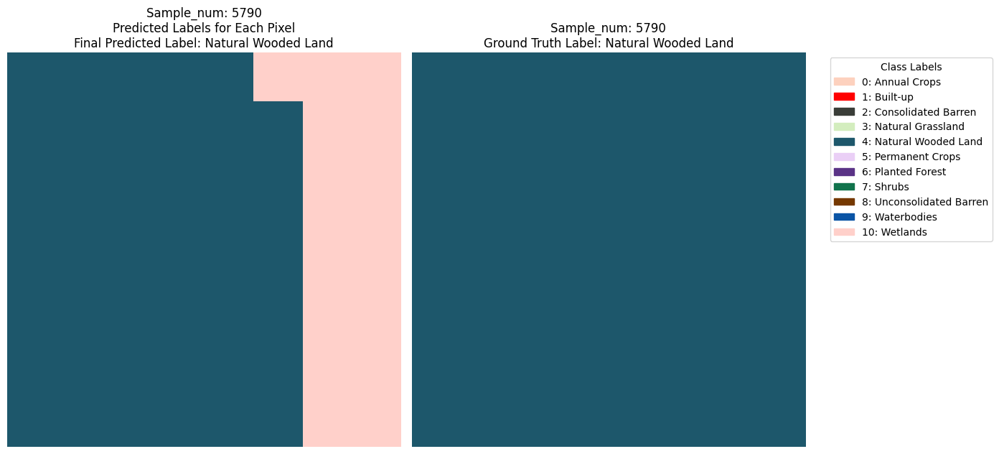

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


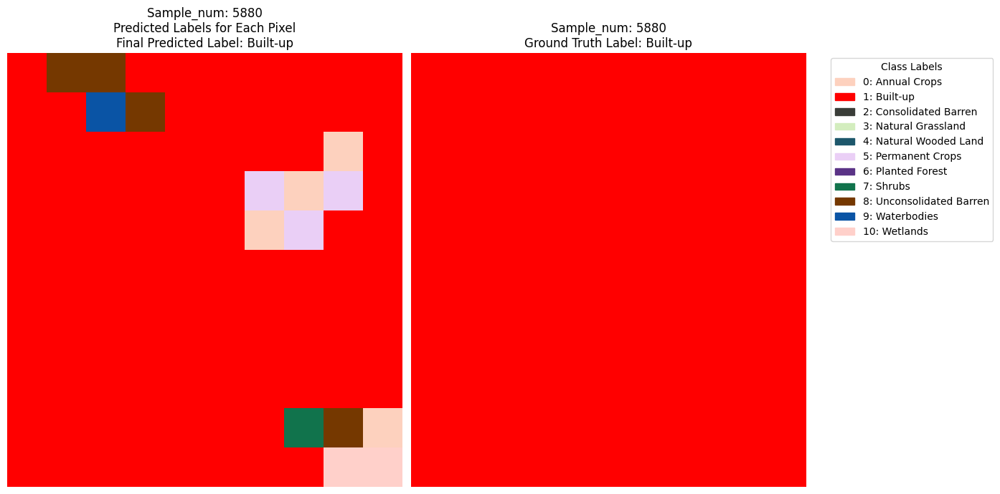

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


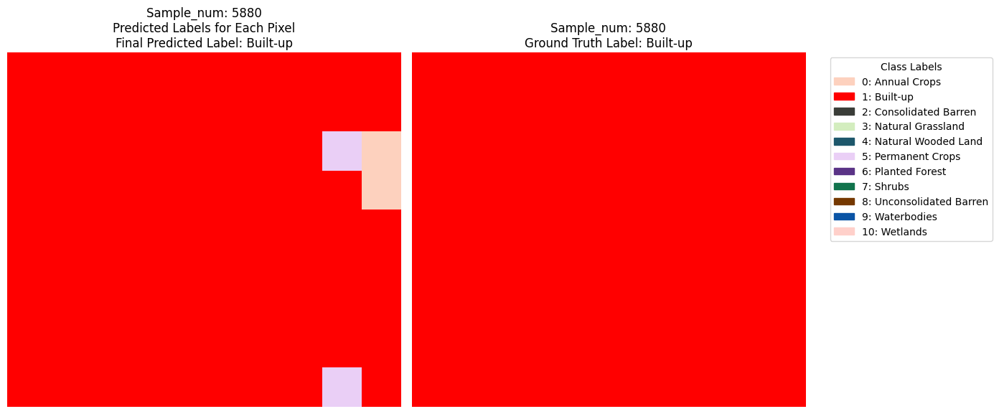

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


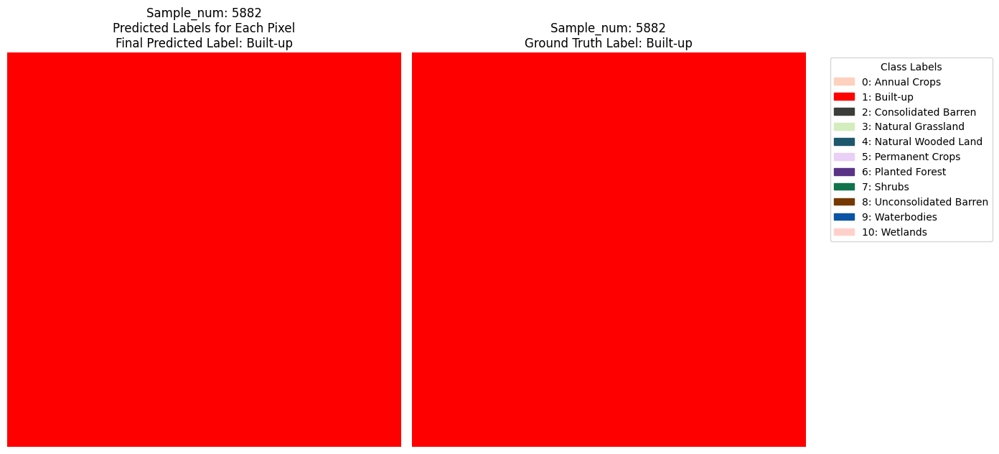

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


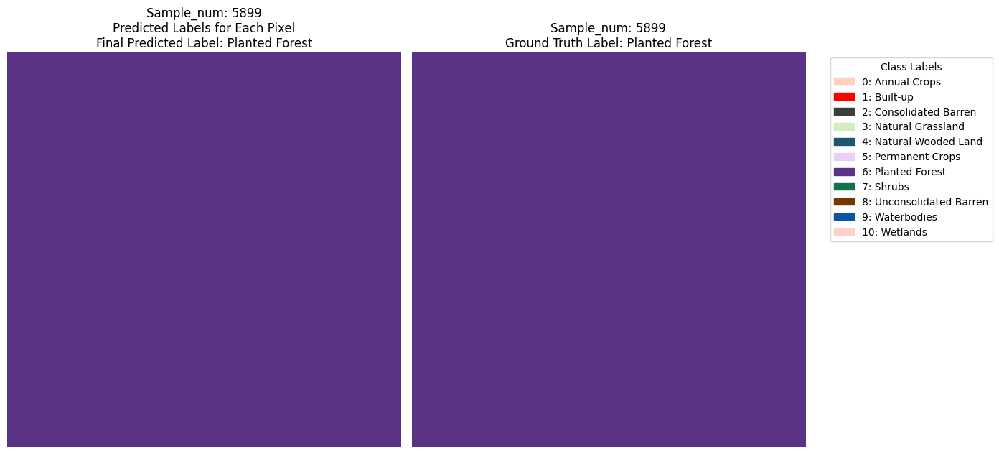

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


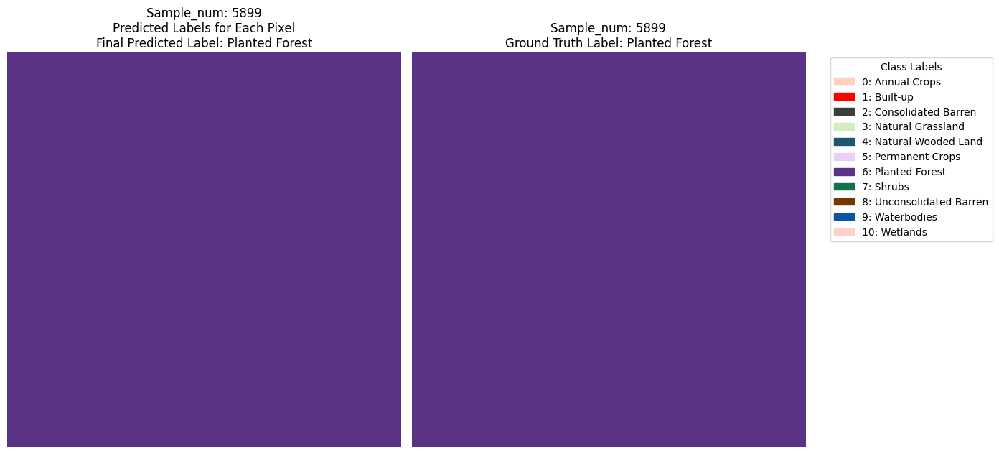

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


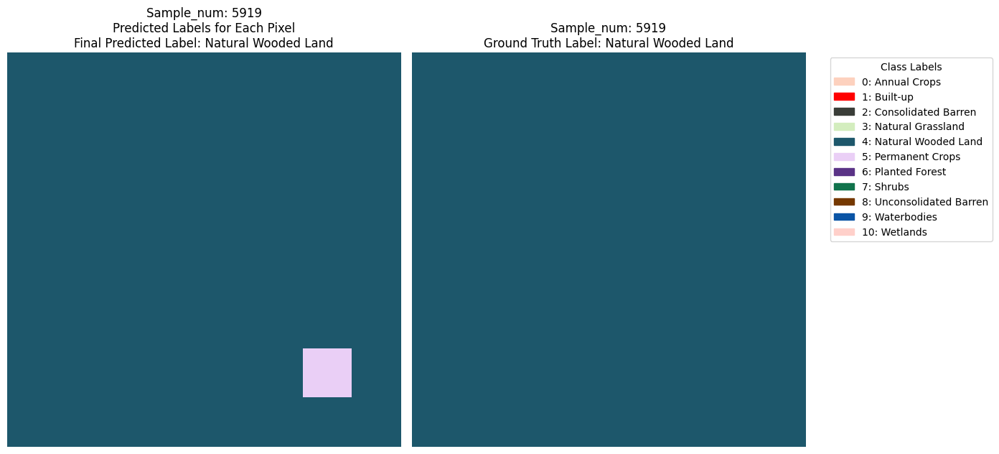

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


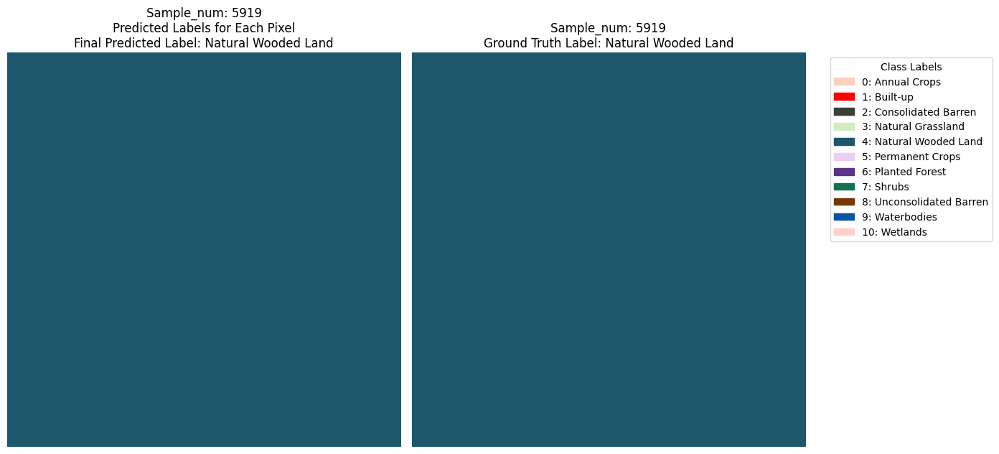

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


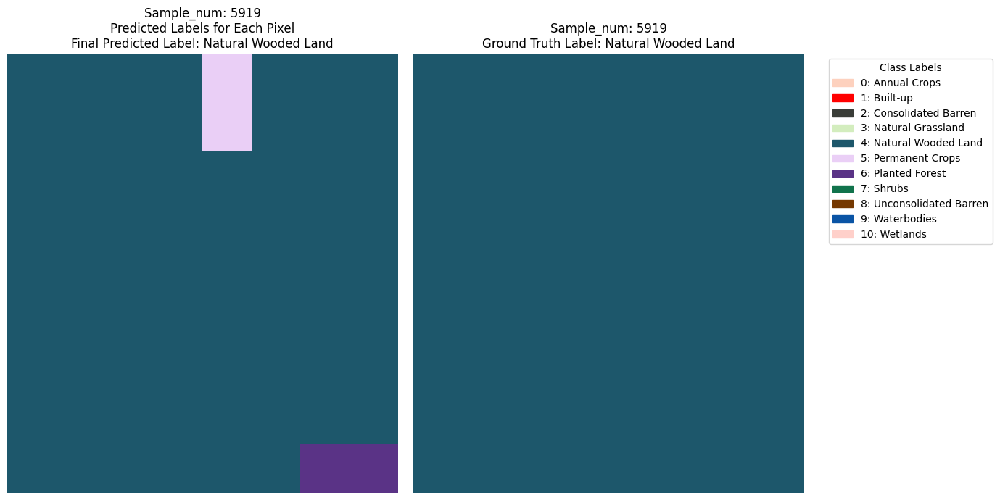

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


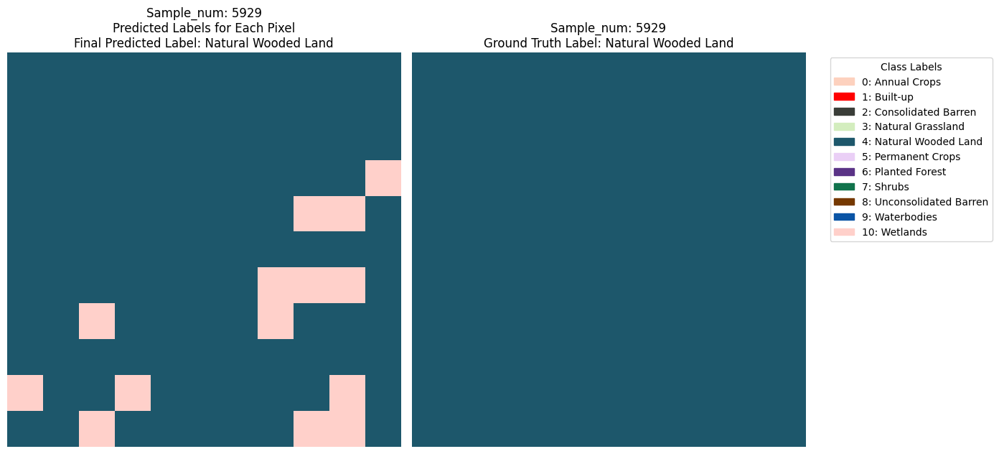

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


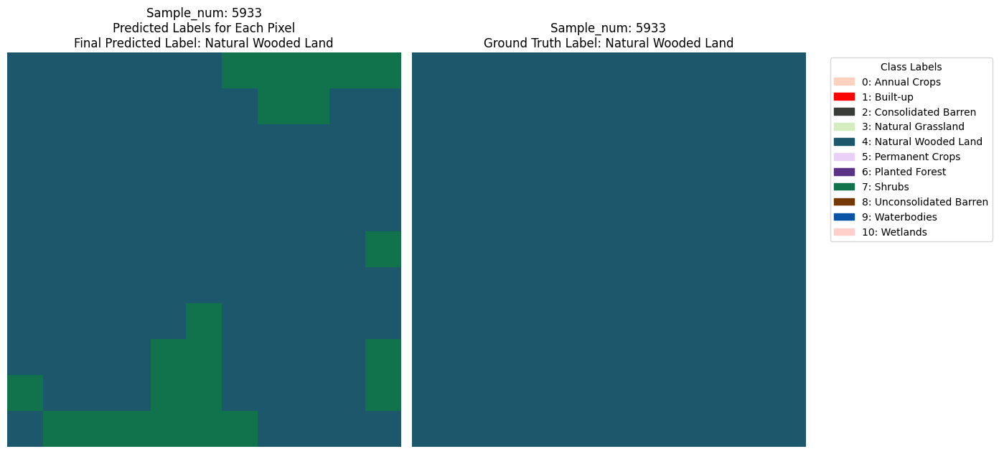

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


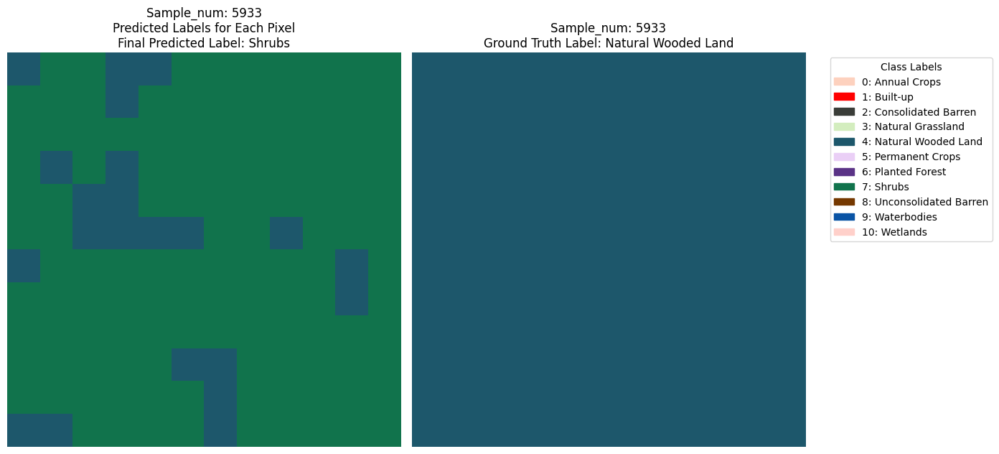

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


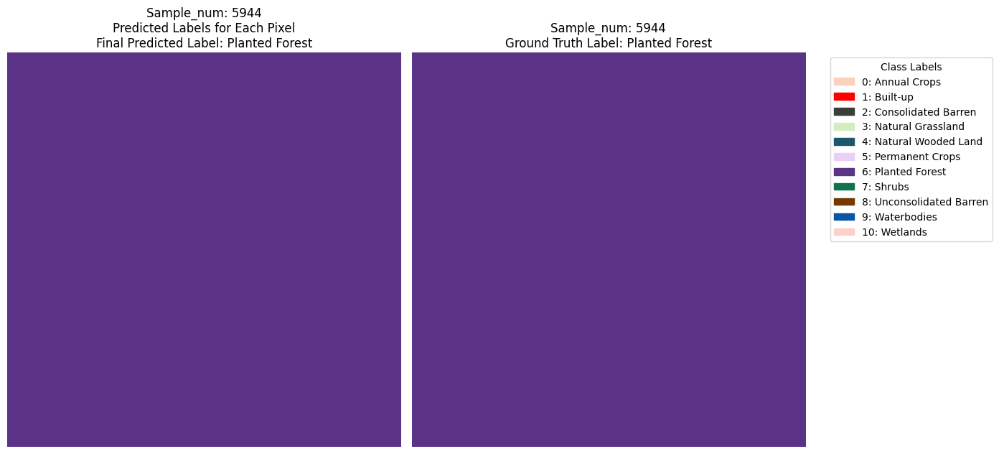

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


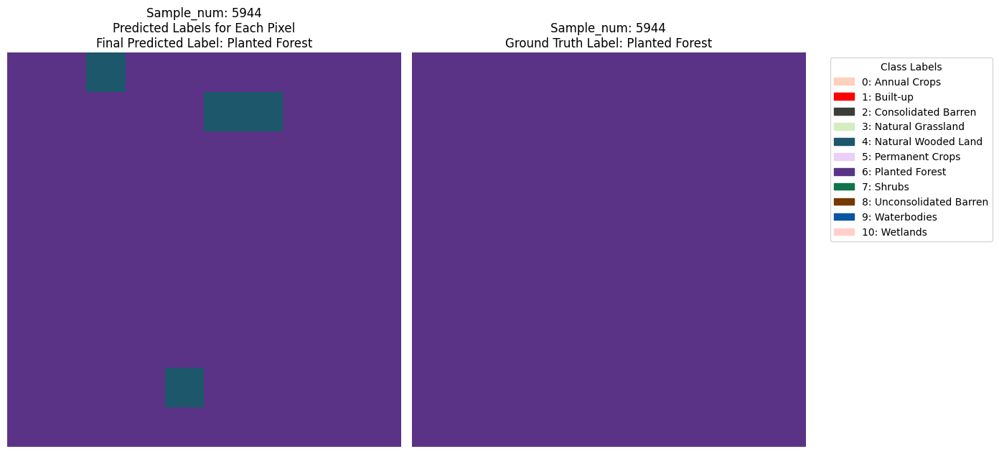

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


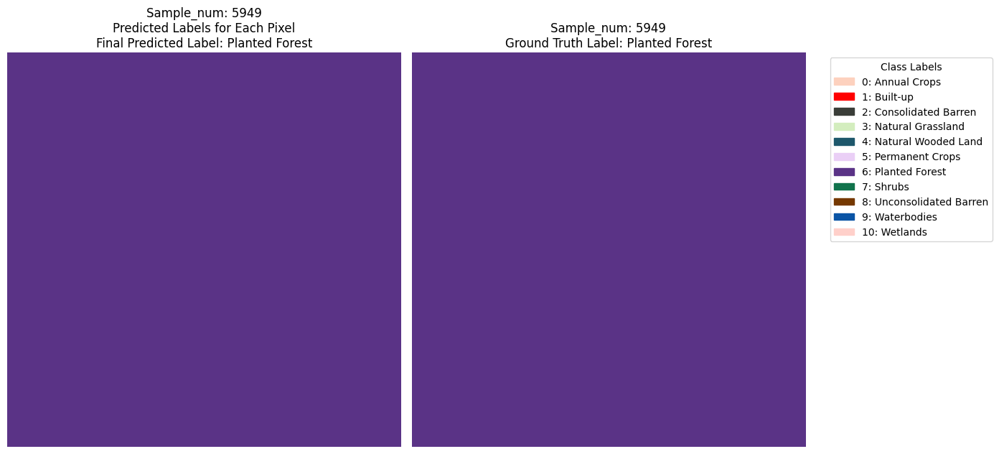

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


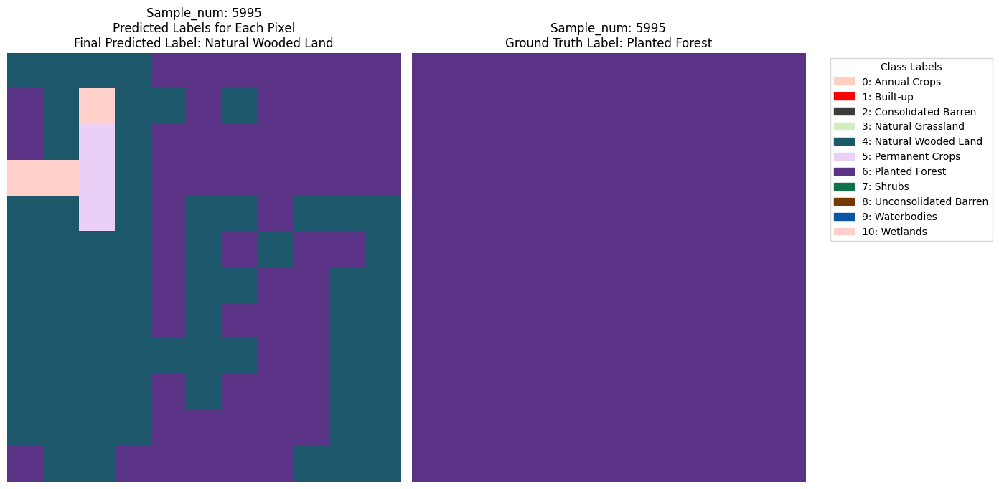

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


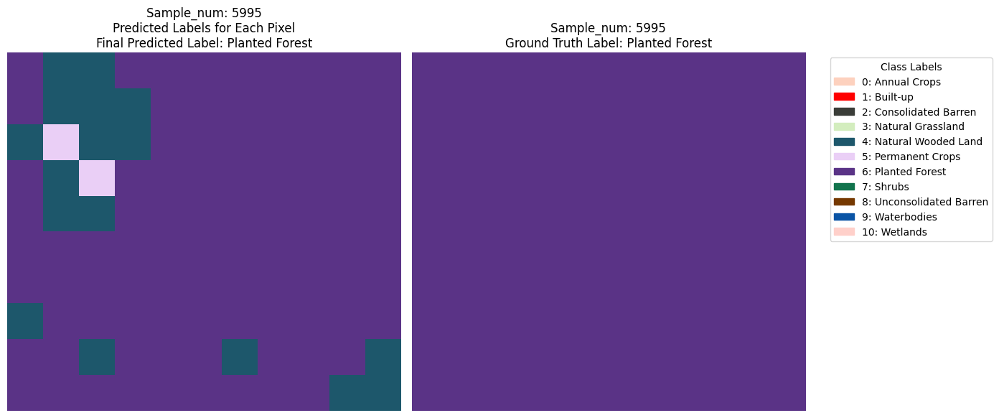

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


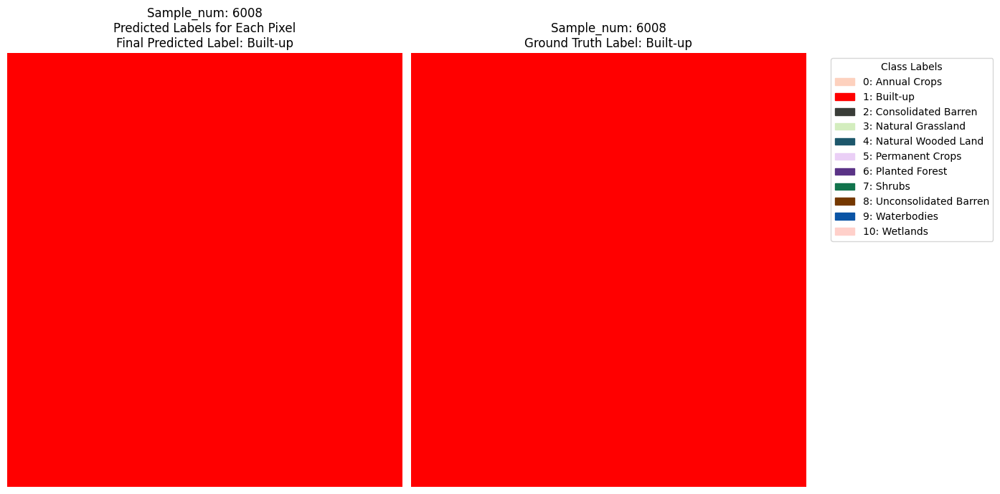

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


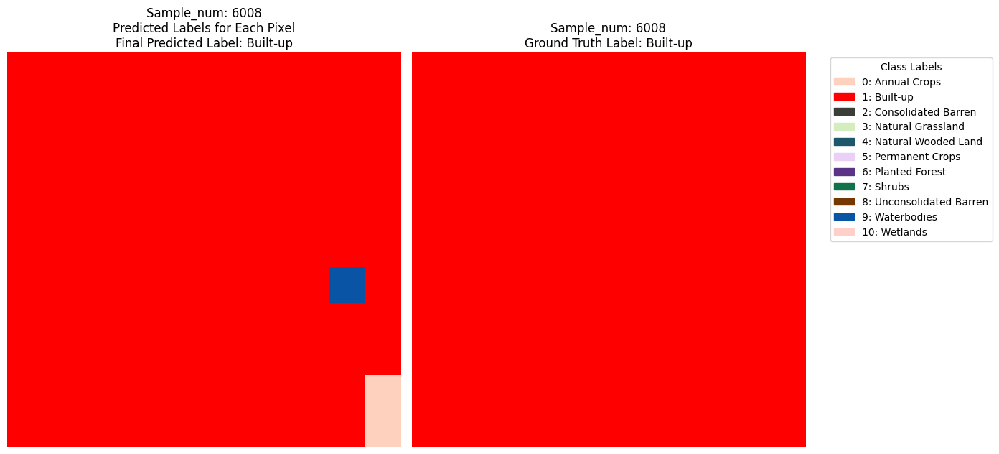

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


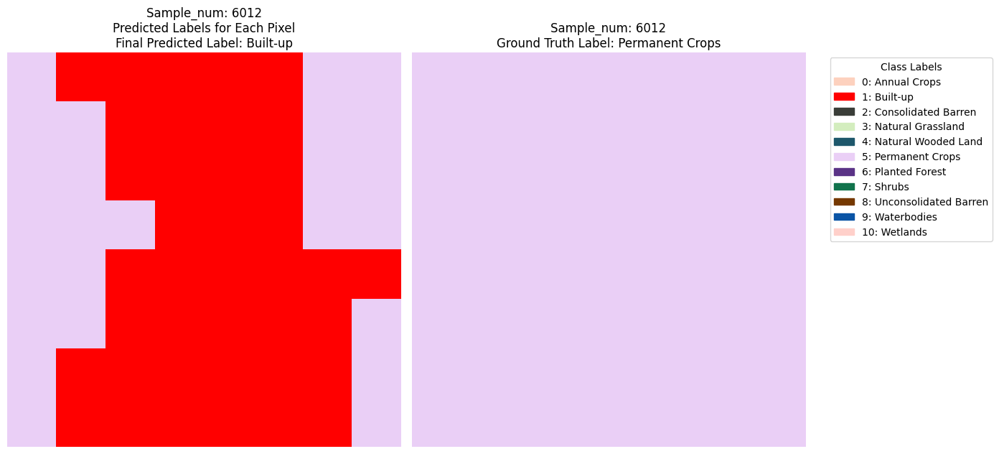

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


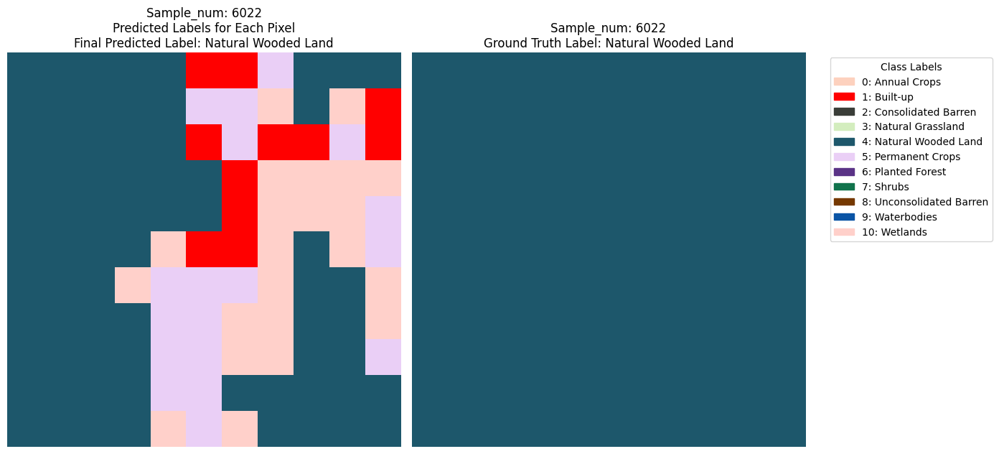

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


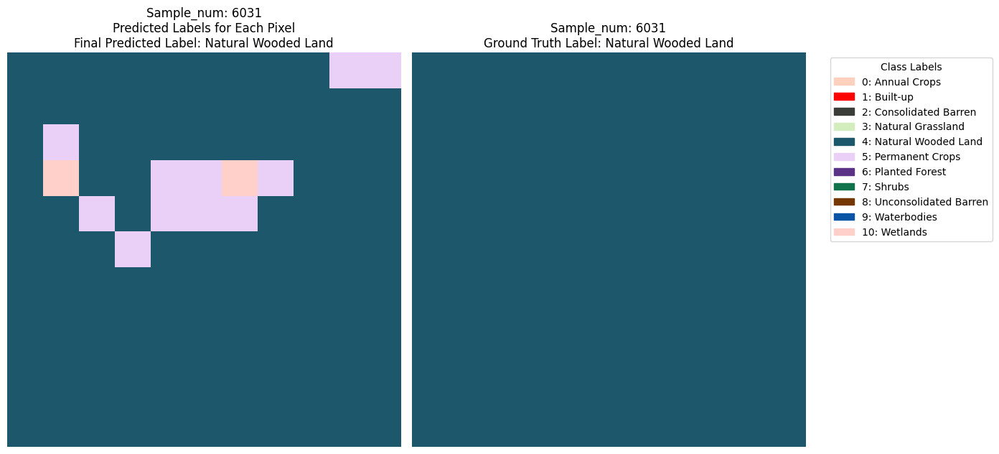

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


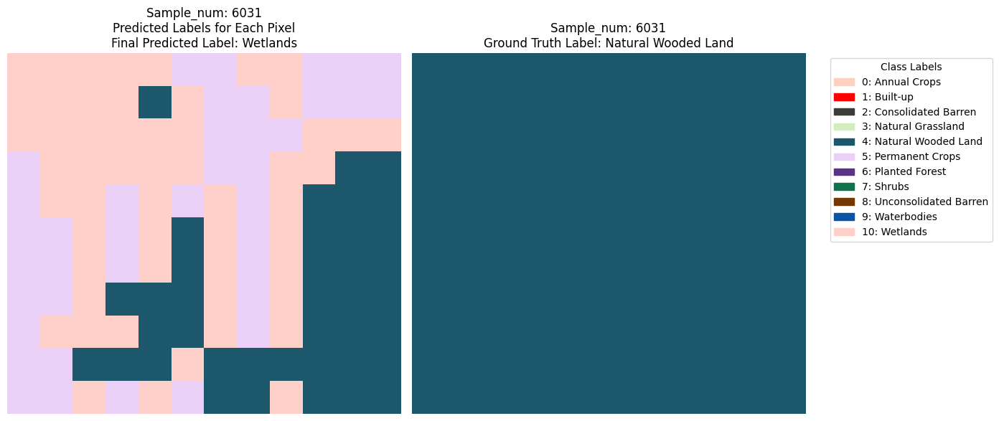

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


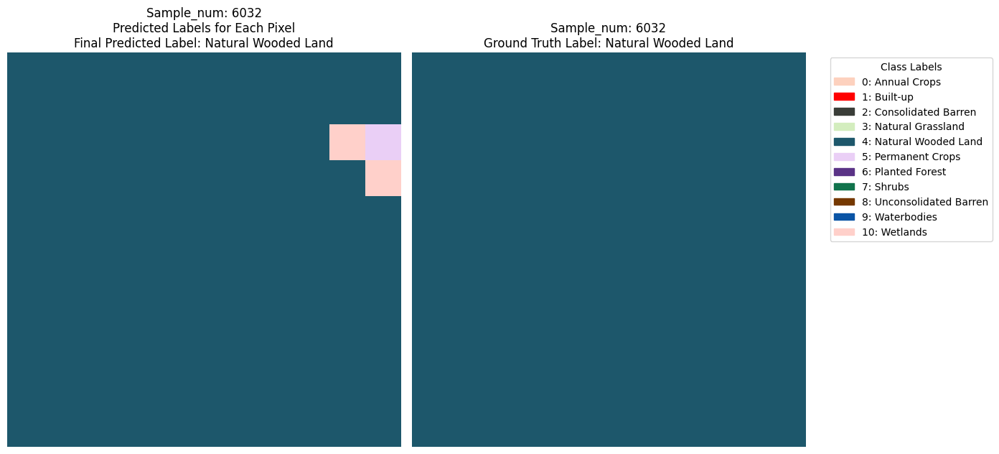

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


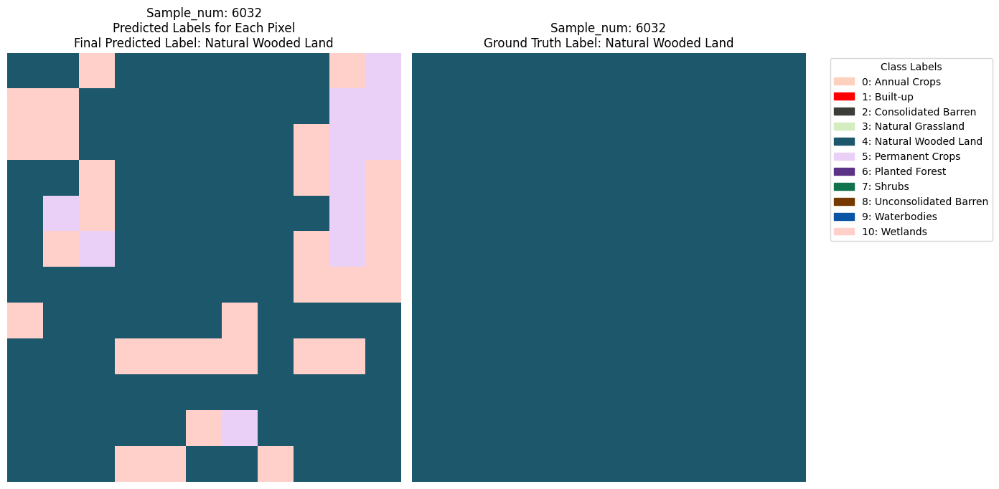

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


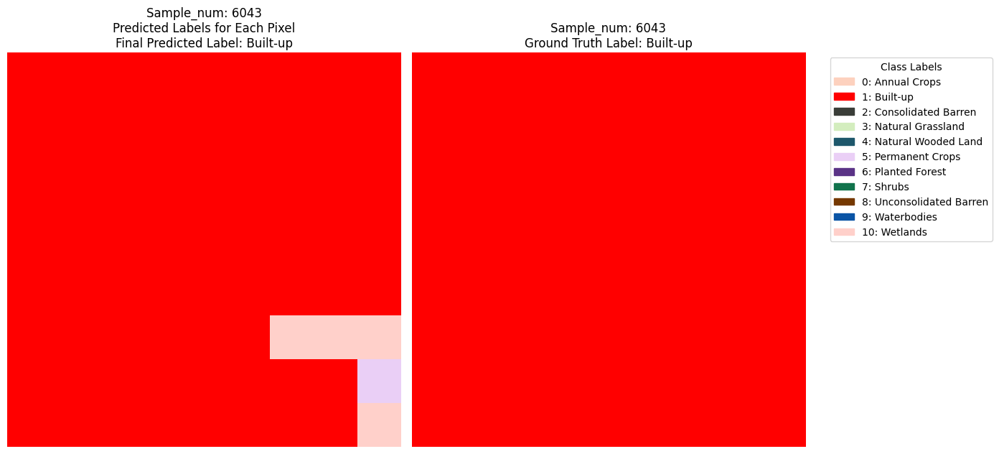

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


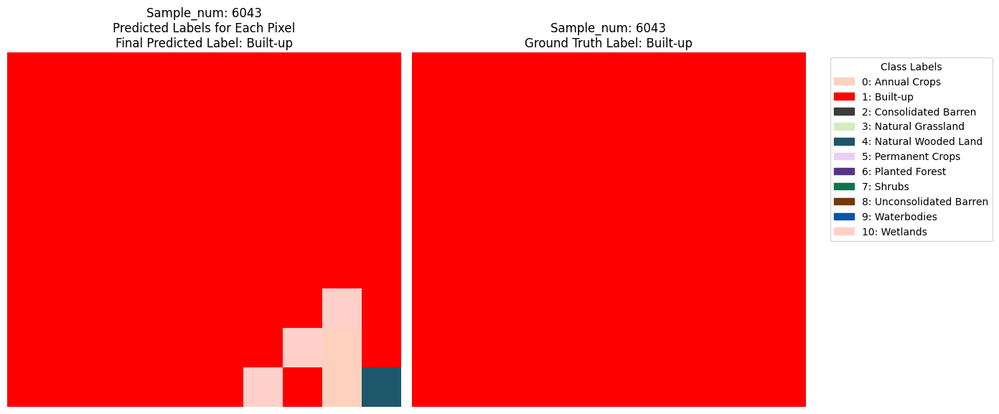

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


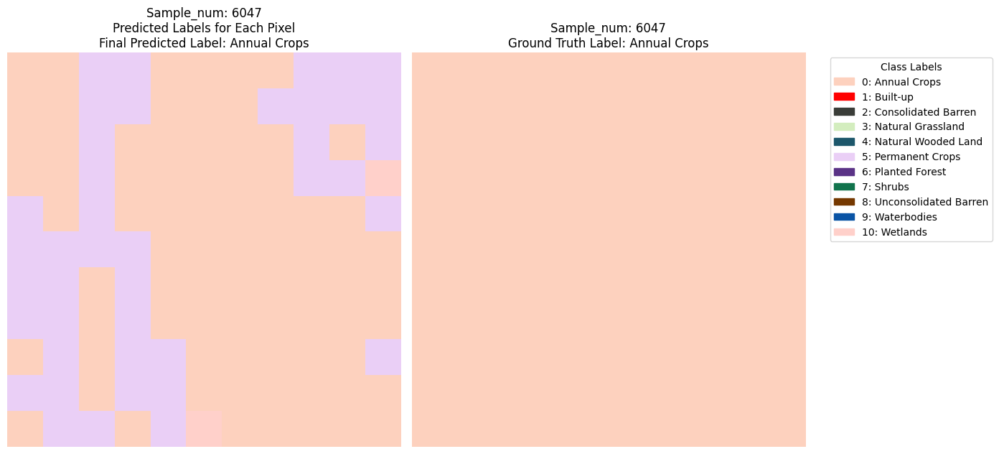

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


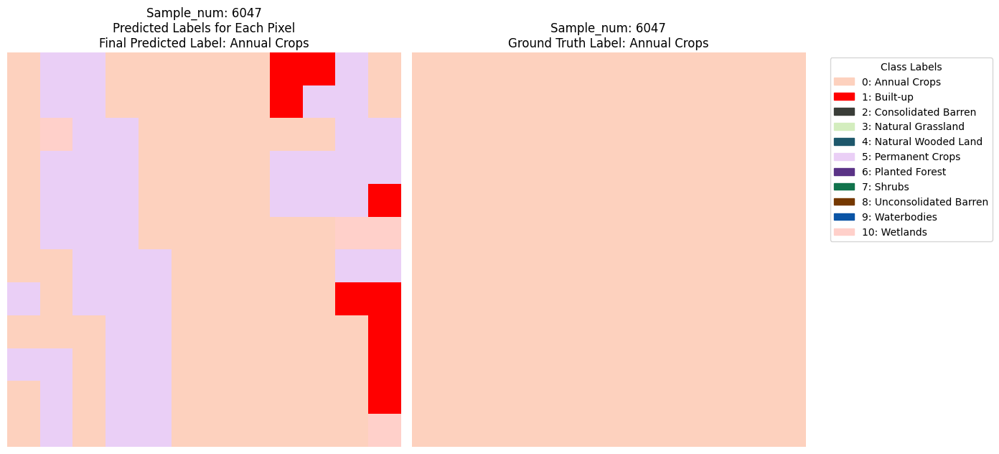

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


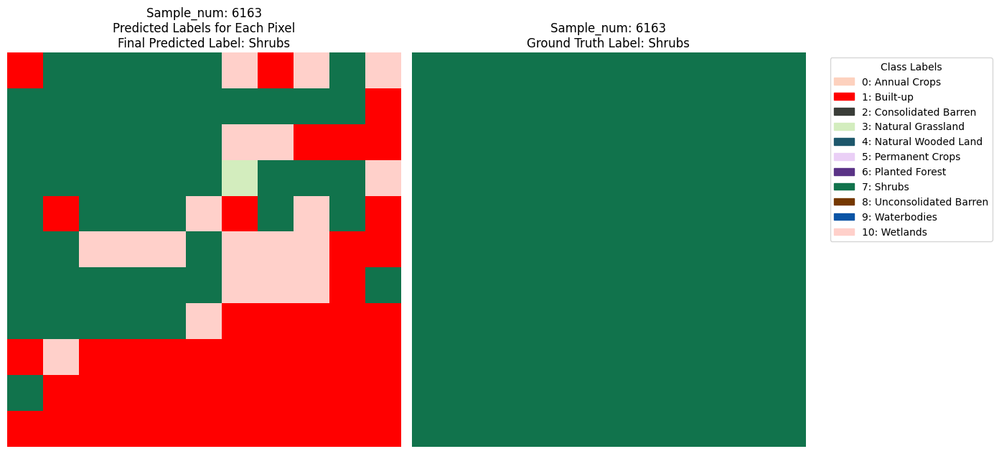

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


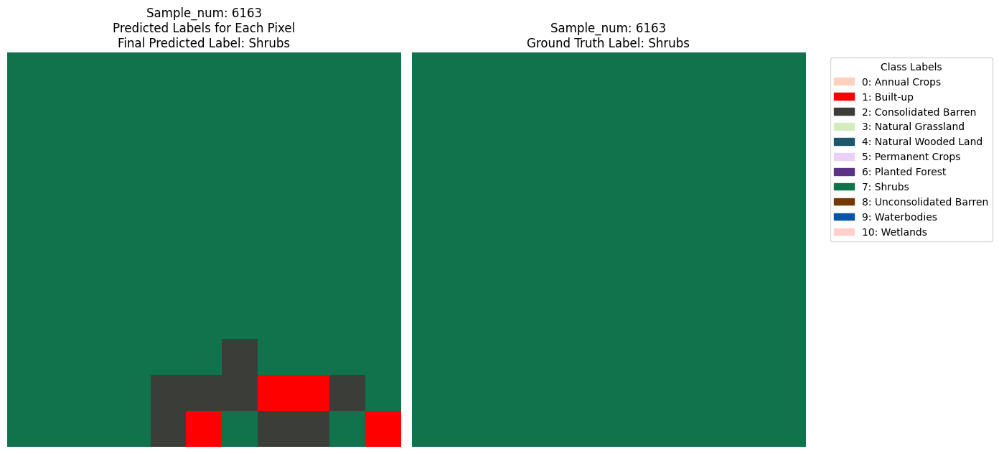

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


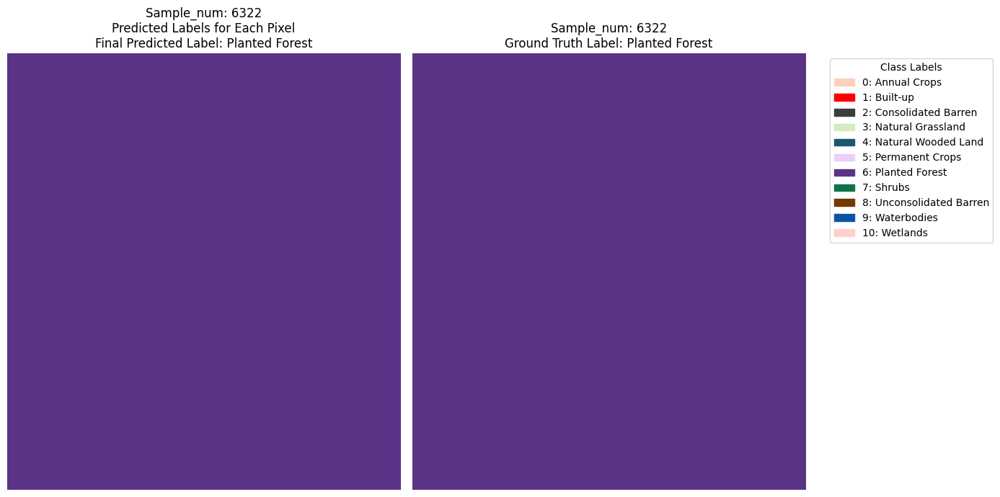

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


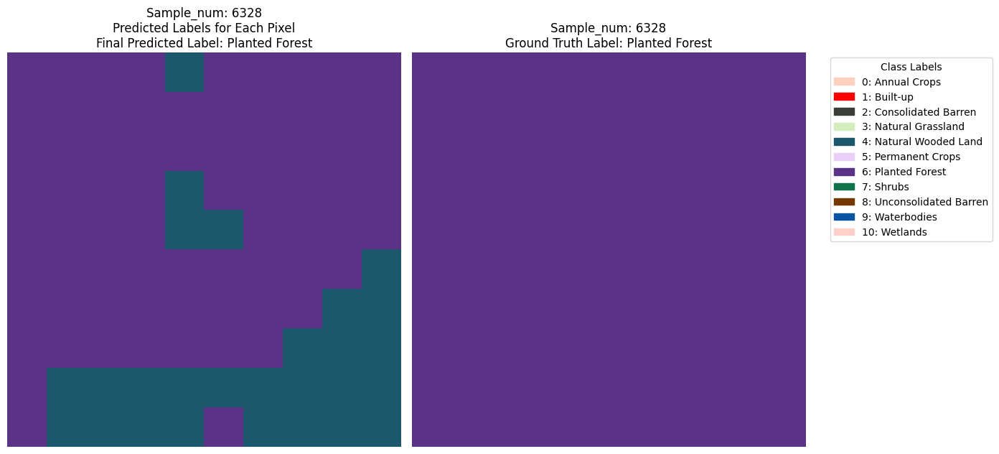

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


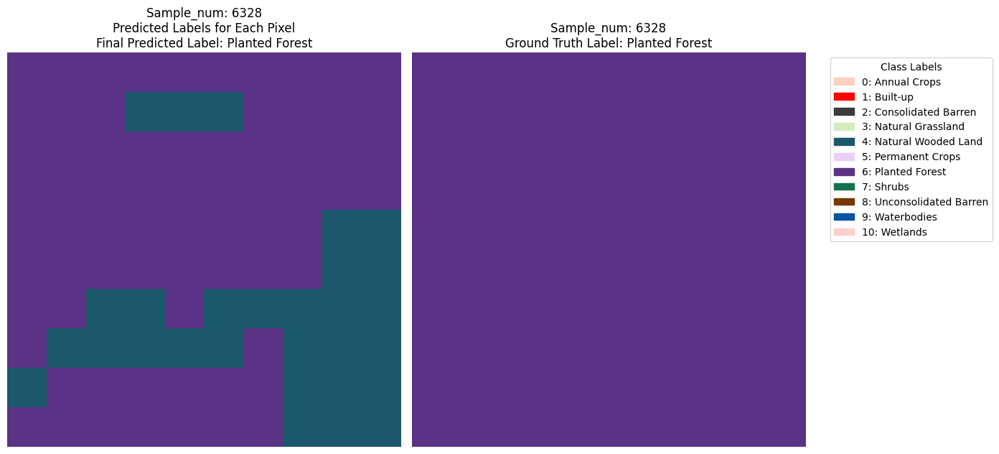

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


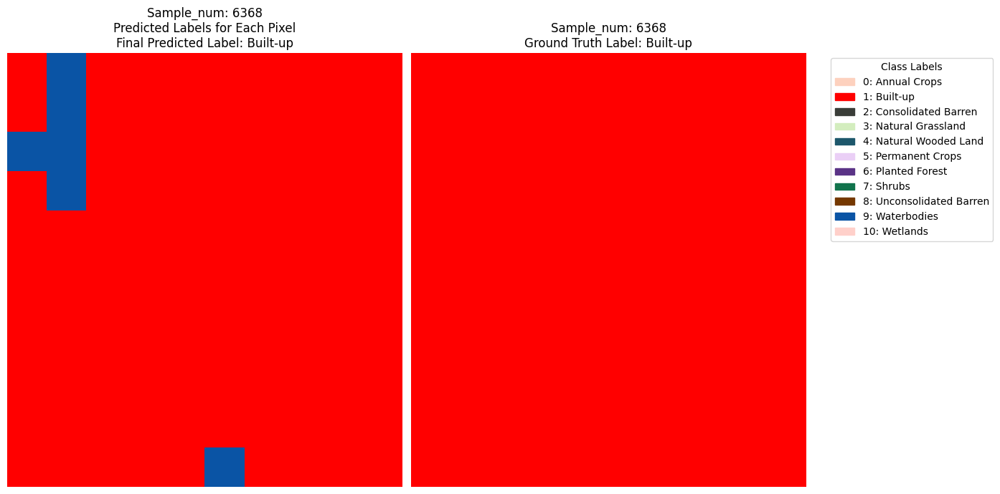

1/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step

In [ ]:
results_list = []

# Filter only test images
filtered_test_images_df = test_df[['Sample_num', 'Label', 'File']].drop_duplicates()

# Gather predictions
for index, row in filtered_test_images_df.iterrows():
    sample_num = row['Sample_num']
    image_path = os.path.join(images_path, row['File'])
    ground_truth_str = row['Label']

    if os.path.exists(image_path):
        final_predicted_label = load_predict_and_visualize(
            image_path=image_path,
            ground_truth_label=ground_truth_str,
            model=model,
            label_encoder=label_encoder,
            sample_num=sample_num
        )
        is_correct = (ground_truth_str == final_predicted_label)

        results_list.append({
            'sample_num': sample_num,
            'ground_truth_label': ground_truth_str,
            'final_predicted_label': final_predicted_label,
            'is_correct': is_correct
        })
    else:
        print(f"File not found: {image_path} for Sample_num: {sample_num}")

In [ ]:
# Convert to DataFrame
results_df = pd.DataFrame(results_list)

# Sort by sample_num (optional)
# results_df = results_df.sort_values(by='sample_num')

# Print entire results table
print("\n=== Full Results DF ===")
print(results_df)

# Show misclassifications & correct classification by class
print("\n=== Summary by Ground Truth Class ===")
all_ground_truth_classes = results_df['ground_truth_label'].unique()

for class_label in all_ground_truth_classes:
    subset = results_df[results_df['ground_truth_label'] == class_label]
    correct_subset = subset[subset['is_correct']]
    incorrect_subset = subset[~subset['is_correct']]

    correct_snums = list(correct_subset['sample_num'])

    print(f"\nGround Truth Class: {class_label}")
    print(f"  Correct Sample Nums: {correct_snums if len(correct_snums) > 0 else 'None'}")

    if not incorrect_subset.empty:
        print("  Misclassified Sample Nums:")
        for idx, row in incorrect_subset.iterrows():
            print(f"    Sample_num: {row['sample_num']} -> predicted '{row['final_predicted_label']}'")


### Plot the Image-Level Confusion Matrix


In [ ]:
image_accuracy, image_conf_matrix, image_predictions = compute_and_plot_image_level_confusion_matrix_with_returns(
    model,
    test_df,
    label_encoder
)

In [ ]:
# 1) Mark correctness
image_predictions['is_correct'] = (
    image_predictions['Encoded_Label'] == image_predictions['Encoded_Predicted_Label']
)

# 2) Print a summary for each image
print("=== Test Set Image-Level Predictions ===")
for idx, row in image_predictions.iterrows():
    sample_num = row['Sample_num']
    true_label_str = row['Label']

    pred_label_str = label_encoder.inverse_transform([row['Encoded_Predicted_Label']])[0]
    is_correct = row['is_correct']

    print(f"Sample_num: {sample_num} | True: {true_label_str} | Pred: {pred_label_str} | Correct?: {is_correct}")


=== Test Set Image-Level Predictions ===
Sample_num: 5 | True: Annual Crops | Pred: Annual Crops | Correct?: True
Sample_num: 18 | True: Shrubs | Pred: Annual Crops | Correct?: False
Sample_num: 28 | True: Annual Crops | Pred: Annual Crops | Correct?: True
Sample_num: 35 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 44 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 104 | True: Shrubs | Pred: Annual Crops | Correct?: False
Sample_num: 116 | True: Shrubs | Pred: Annual Crops | Correct?: False
Sample_num: 255 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 267 | True: Annual Crops | Pred: Annual Crops | Correct?: True
Sample_num: 282 | True: Annual Crops | Pred: Permanent Crops | Correct?: False
Sample_num: 441 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 706 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 759 | True: Shrubs | Pred: Shrubs | Correct?: True
Sample_num: 765 | True: Consolidated Barren | Pred: Consolidated Barren |

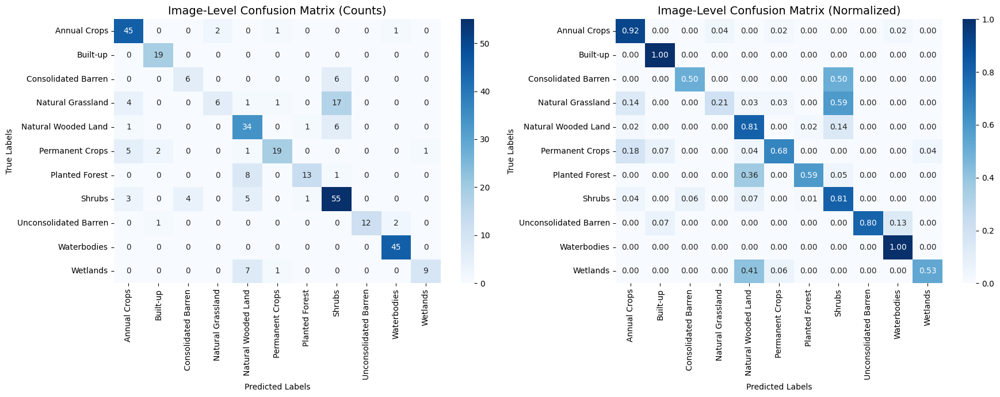

In [ ]:
# Extract string labels from image_predictions
y_true_images = label_encoder.inverse_transform(image_predictions['Encoded_Label'])
y_pred_images = label_encoder.inverse_transform(image_predictions['Encoded_Predicted_Label'])

conf_mat_counts_img, conf_mat_normalized_img = plot_confusion_matrices_with_counts_and_normalized(
    y_true=y_true_images,
    y_pred=y_pred_images,
    label_encoder=label_encoder,
    title_counts="Image-Level Confusion Matrix (Counts)",
    title_normalized="Image-Level Confusion Matrix (Normalized)"
)

### Morphology

In [ ]:
## Remeber to define your model first! Just load from some weights to make it easy...
## NOTE: This takes a long time to run!
color_mapping = generate_colors_for_labels(label_encoder)

results = process_samples_with_morphology(
  test_df,
  model,
  label_encoder,
  color_mapping,
  window_size=3,  # Using smallest window possbile lol
)

### Post-Processing Results

In [ ]:
metrics = compute_accuracy_and_confusion_matrices(**results)

In [ ]:
# Extrat per-pixel true labels and predicted labels after morphogy
y_true_pixels = results['y_true_pixels']  # Ground truth labels for pixels
y_pred_pixels_after = results['y_pred_pixels_after']  # Predicted labels after morphology

# Get per-pixel accuracy after morphology
accuracy_after_morphology = np.mean(np.array(y_true_pixels) == np.array(y_pred_pixels_after))
print(f"Per-pixel Accuracy After Morphology: {accuracy_after_morphology:.4f}")

# Get classification report after morphology
print("Per-pixel Classification Report After Morphology:")
print(classification_report(y_true_pixels, y_pred_pixels_after, target_names=label_encoder.classes_))

In [ ]:
# Extract per-image true labels and predicted labels after morphology
y_true_images = results['y_true_images']  # Ground truth labels for images
y_pred_images_after = results['y_pred_images_after']  # Predicted labels after morphology

# Get per-image classification report
print("Per-image Classification Report After Morphology:")
print(classification_report(y_true_images, y_pred_images_after, target_names=label_encoder.classes_))

In [ ]:
# fget confusion matrix using post-processed predictions
conf_matrix_after = confusion_matrix(
  results['y_true_pixels'],  # True labels
  results['y_pred_pixels_after'],  # Post-processed predicted labels
  labels=range(len(label_encoder.classes_))
)

# Plot the confusion matrix
plt.figure(figsize=(12, 10))
sns.heatmap(
  conf_matrix_after, annot=True, fmt="d", cmap="Blues",
  xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_
)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix After Morphology")
plt.show()


In [ ]:
# Use post-processed per-image predictions
image_predictions_after = pd.DataFrame({
    'Encoded_Ground_Truth': results['y_true_images'],
    'Encoded_Predicted_Label': results['y_pred_images_after']
})

# Geet normalized confusion matrix
cm_normalized_after = confusion_matrix(
    image_predictions_after['Encoded_Ground_Truth'],
    image_predictions_after['Encoded_Predicted_Label'],
    labels=range(len(label_encoder.classes_)),
    normalize='true'
)

# Plot the normalized confusion matrix
fig, ax = plt.subplots(figsize=(12, 10))
disp = ConfusionMatrixDisplay(confusion_matrix=cm_normalized_after, display_labels=label_encoder.classes_)

disp.plot(cmap="Blues", xticks_rotation=45, ax=ax, colorbar=True)
ax.set_xlabel("Predicted Label", fontsize=14, labelpad=15)
ax.set_ylabel("True Label", fontsize=14, labelpad=15)
ax.set_title("Image-Level Confusion Matrix After Morphology", fontsize=16, pad=20)

plt.tight_layout()
plt.show()


In [ ]:
# Get the testing Acc. after training
test_accuracy = evaluate_model(model, X_test, y_test_cat)
print("Final Test Accuracy:", test_accuracy)

## 1D - CNN (Combined Classes)

### Load Data

In [ ]:
# Load Data
samples_df = pd.read_csv(samples_path)
labels_df = pd.read_csv(labels_path)

#######################  TEMPORARILY COMBINE SHRUBS & GRASSLAND  #########################
samples_df = combine_classes (samples_df, ['Natural Grassland', 'Shrubs'], 'Shrubs and Natural Grassland')
#######################  TEMPORARILY COMBINE SHRUBS & GRASSLAND  #########################

Classes combined successfully.


### PreProcessing

In [ ]:
# Preprocess Data
samples_df, label_encoder = preprocess_data(samples_df)

# Clean the img_pos column
samples_df = clean_img_pos_column(samples_df)

# Define the frequency columns
freq_cols = [c for c in samples_df.columns if c.startswith('frq')]

In [ ]:
samples_df

,frq0,frq1,frq2,frq3,frq4,frq5,frq6,frq7,frq8,frq9,...,frq367,frq368,Sample_num,Label,Shape,File_UID_Num,File,img_pxl_index,img_pos,Label_Encoded
0,0.029069,0.033152,0.035469,0.041350,0.043226,0.045428,0.048409,0.049431,0.052631,0.054922,...,0.173310,0.171577,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,0,"(0, 0)",7
1,0.030087,0.034019,0.035511,0.041382,0.042764,0.045505,0.049077,0.049998,0.052073,0.055954,...,0.170324,0.193503,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,1,"(0, 1)",7
2,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170450,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,2,"(0, 2)",7
3,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170449,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,3,"(0, 3)",7
4,0.031720,0.040508,0.042270,0.042718,0.043992,0.049516,0.051002,0.052987,0.057484,0.058246,...,0.189454,0.180372,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,4,"(0, 4)",7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329528,0.008262,0.007249,0.010430,0.013172,0.014590,0.016147,0.017221,0.016435,0.020677,0.020636,...,0.067343,0.070380,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,59,"(7, 3)",3
329529,0.002546,0.009940,0.010392,0.014686,0.015467,0.015819,0.018658,0.021157,0.020507,0.019907,...,0.065229,0.067679,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,60,"(7, 4)",3
329530,0.003634,0.012806,0.014233,0.018610,0.017898,0.017720,0.022039,0.023810,0.023159,0.022642,...,0.096255,0.102634,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,61,"(7, 5)",3
329531,0.002516,0.013354,0.012534,0.015690,0.016293,0.016206,0.020137,0.022669,0.020269,0.020936,...,0.085134,0.089147,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,62,"(7, 6)",3


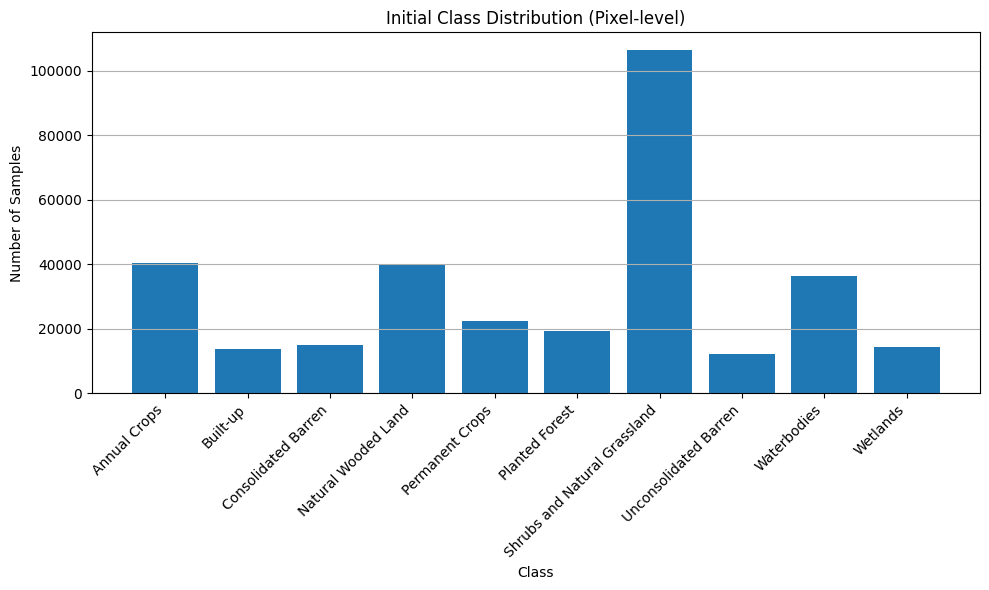

In [ ]:
# Show initial class distribution at pixel-level
plot_class_distribution(samples_df['Label'].values, label_encoder.classes_, "Initial Class Distribution (Pixel-level)")

### Outlier detection and removal

In [ ]:
cleaned_df, stats_info = pca_chi_square_outlier_pipeline_keep_freq(
    df=samples_df,
    frequency_cols=freq_cols,
    alpha=0.05,
    pca_variance=0.95,
    min_pixels=5,
    enable_debug=True,
    color_map=None
)

print("Original DF shape =>", samples_df.shape)
print("Cleaned DF shape  =>", cleaned_df.shape)
print("Stats =>", stats_info)

Original DF shape => (320853, 377)
Cleaned DF shape  => (306075, 377)
Stats => {'total_outliers': 14778, 'per_sample': {2: 7, 3: 11, 4: 4, 5: 7, 6: 6, 7: 13, 8: 3, 10: 8, 11: 4, 12: 5, 13: 5, 14: 10, 17: 7, 18: 3, 22: 6, 23: 8, 26: 8, 27: 5, 28: 5, 29: 3, 30: 8, 31: 3, 32: 2, 33: 12, 34: 8, 35: 6, 40: 4, 41: 6, 42: 2, 43: 8, 44: 7, 45: 4, 46: 10, 47: 6, 49: 3, 65: 7, 67: 7, 85: 12, 104: 11, 116: 8, 118: 11, 120: 14, 134: 6, 138: 2, 197: 6, 199: 4, 210: 8, 232: 5, 255: 6, 257: 6, 266: 11, 267: 13, 272: 16, 273: 19, 274: 26, 275: 30, 276: 18, 278: 4, 279: 14, 280: 11, 281: 25, 282: 16, 283: 13, 287: 17, 288: 6, 294: 6, 371: 10, 392: 4, 440: 12, 441: 13, 568: 17, 656: 13, 706: 7, 738: 10, 759: 21, 762: 12, 765: 23, 798: 23, 880: 17, 953: 9, 993: 32, 1065: 3, 1089: 5, 1090: 2, 1091: 3, 1092: 3, 1134: 2, 1149: 4, 1224: 2, 1254: 7, 1297: 4, 1302: 2, 1309: 4, 1310: 18, 1311: 6, 1312: 6, 1314: 3, 1357: 3, 1429: 5, 1470: 4, 1479: 8, 1480: 4, 1482: 5, 1483: 3, 1507: 1, 1585: 8, 1588: 4, 1604: 2,

In [ ]:
cleaned_df

,frq0,frq1,frq2,frq3,frq4,frq5,frq6,frq7,frq8,frq9,...,frq367,frq368,Sample_num,Label,Shape,File_UID_Num,File,img_pxl_index,img_pos,Label_Encoded
0,0.029069,0.033152,0.035469,0.041350,0.043226,0.045428,0.048409,0.049431,0.052631,0.054922,...,0.173310,0.171577,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,0,"(0, 0)",7
1,0.030087,0.034019,0.035511,0.041382,0.042764,0.045505,0.049077,0.049998,0.052073,0.055954,...,0.170324,0.193503,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,1,"(0, 1)",7
2,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170450,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,2,"(0, 2)",7
3,0.037750,0.037187,0.037512,0.041911,0.046044,0.045247,0.046976,0.050844,0.054013,0.057165,...,0.174815,0.170449,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,3,"(0, 3)",7
4,0.031720,0.040508,0.042270,0.042718,0.043992,0.049516,0.051002,0.052987,0.057484,0.058246,...,0.189454,0.180372,1,Unconsolidated Barren,"(11, 11)",1,1_ang20231028t101421_005.tif,4,"(0, 4)",7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306070,0.008262,0.007249,0.010430,0.013172,0.014590,0.016147,0.017221,0.016435,0.020677,0.020636,...,0.067343,0.070380,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,59,"(7, 3)",3
306071,0.002546,0.009940,0.010392,0.014686,0.015467,0.015819,0.018658,0.021157,0.020507,0.019907,...,0.065229,0.067679,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,60,"(7, 4)",3
306072,0.003634,0.012806,0.014233,0.018610,0.017898,0.017720,0.022039,0.023810,0.023159,0.022642,...,0.096255,0.102634,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,61,"(7, 5)",3
306073,0.002516,0.013354,0.012534,0.015690,0.016293,0.016206,0.020137,0.022669,0.020269,0.020936,...,0.085134,0.089147,28499,Natural Wooded Land,"(8, 8)",4652,28499_ang20231109t071216_006.tif,62,"(7, 6)",3


### Data Split

In [ ]:
# We'll base the split on 'cleaned_df'
image_samples_df = cleaned_df[['Sample_num', 'Label_Encoded']].drop_duplicates()

sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_indices, test_indices = next(sss.split(image_samples_df['Sample_num'], image_samples_df['Label_Encoded']))

train_sample_nums = image_samples_df['Sample_num'].iloc[train_indices]
test_sample_nums = image_samples_df['Sample_num'].iloc[test_indices]

train_df = cleaned_df[cleaned_df['Sample_num'].isin(train_sample_nums)]
test_df = cleaned_df[cleaned_df['Sample_num'].isin(test_sample_nums)]

# Re-check the freq_cols from the cleaned df
frequency_cols = [col for col in cleaned_df.columns if col.startswith('frq')]

# Build X, y
X_train = train_df[frequency_cols].values
y_train = train_df['Label_Encoded'].values

X_test = test_df[frequency_cols].values
y_test = test_df['Label_Encoded'].values

num_classes = len(cleaned_df['Label_Encoded'].unique())

# One-hot
y_train_cat = to_categorical(y_train, num_classes)
y_test_cat = to_categorical(y_test, num_classes)

# Reshape for Conv1D
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test  = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

print("X_train shape =>", X_train.shape)  # Should be (#pixels, #freq, 1)
print("X_test shape =>", X_test.shape)

X_train shape => (243796, 369, 1)
X_test shape => (62279, 369, 1)


### Data Visualization

In [ ]:
# Aggregate counts of labels for each Sample_num in training data
train_aggregated_counts = train_df.groupby(['Sample_num', 'Label']).size().reset_index(name='Pixel_Count')
train_label_counts_per_sample = train_aggregated_counts.groupby('Label')['Sample_num'].nunique()

# Aggregate counts of labels for each Sample_num in testing data
test_aggregated_counts = test_df.groupby(['Sample_num', 'Label']).size().reset_index(name='Pixel_Count')
test_label_counts_per_sample = test_aggregated_counts.groupby('Label')['Sample_num'].nunique()

In [ ]:
print("Aggregated Label Counts by Sample Number in Training Data:")
print(train_label_counts_per_sample)

print("\nAggregated Label Counts by Sample Number in Testing Data:")
print(test_label_counts_per_sample)

Aggregated Label Counts by Sample Number in Training Data:
Label
Annual Crops                    197
Built-up                         76
Consolidated Barren              49
Natural Wooded Land             166
Permanent Crops                 110
Planted Forest                   90
Shrubs and Natural Grassland    387
Unconsolidated Barren            58
Waterbodies                     181
Wetlands                         69
Name: Sample_num, dtype: int64

Aggregated Label Counts by Sample Number in Testing Data:
Label
Annual Crops                    49
Built-up                        19
Consolidated Barren             12
Natural Wooded Land             42
Permanent Crops                 28
Planted Forest                  22
Shrubs and Natural Grassland    97
Unconsolidated Barren           15
Waterbodies                     45
Wetlands                        17
Name: Sample_num, dtype: int64


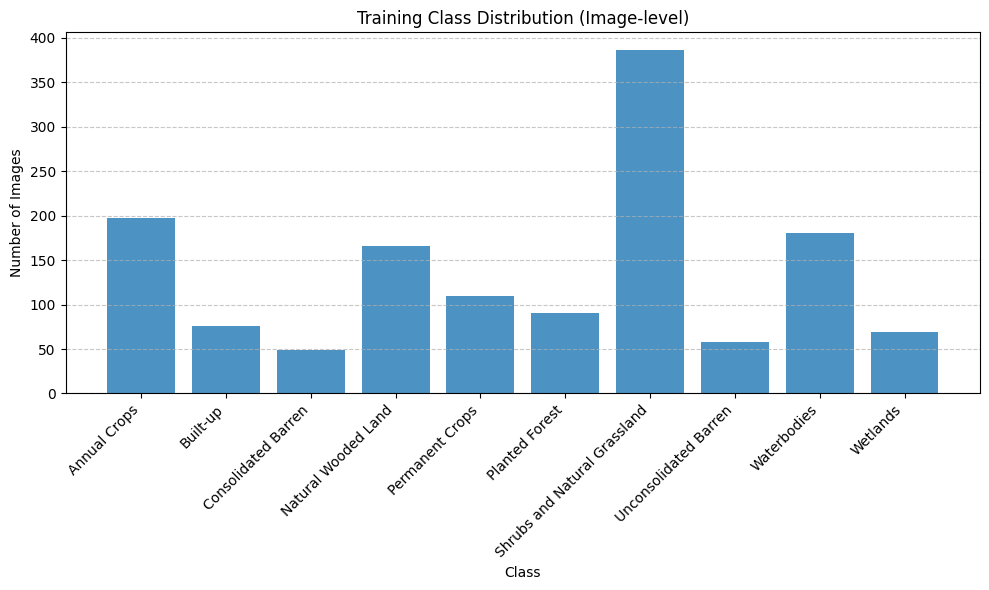

In [ ]:
# Plot the training class distribution (Image-level)
plot_image_level_distribution(
    aggregated_counts=train_label_counts_per_sample,
    title="Training Class Distribution (Image-level)"
)

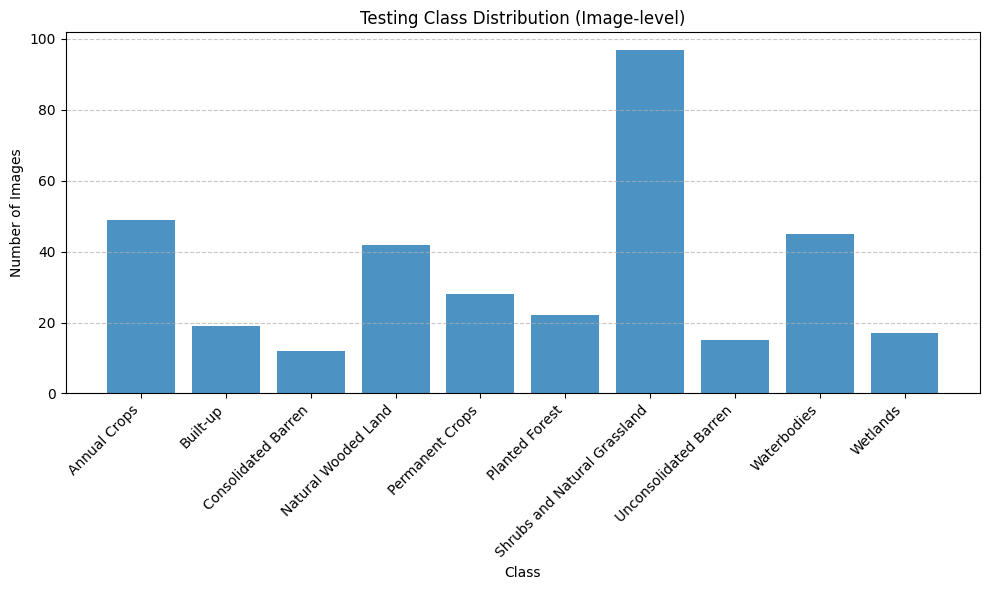

In [ ]:
# Plot the testing class distribution (Image-level)
plot_image_level_distribution(
    aggregated_counts=test_label_counts_per_sample,
    title="Testing Class Distribution (Image-level)"
)

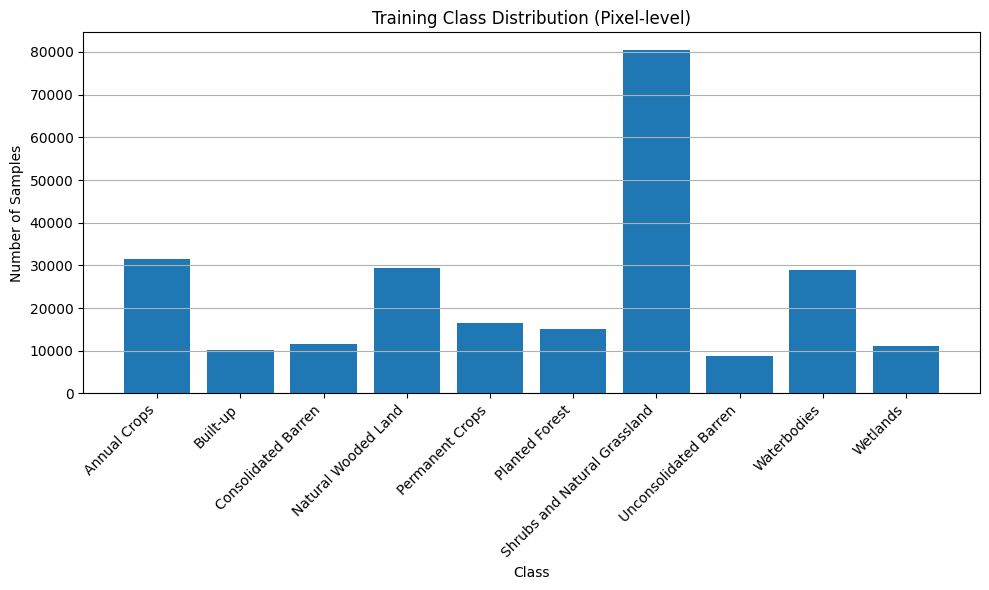

In [ ]:
plot_class_distribution(train_df['Label'].values, label_encoder.classes_, "Training Class Distribution (Pixel-level)")

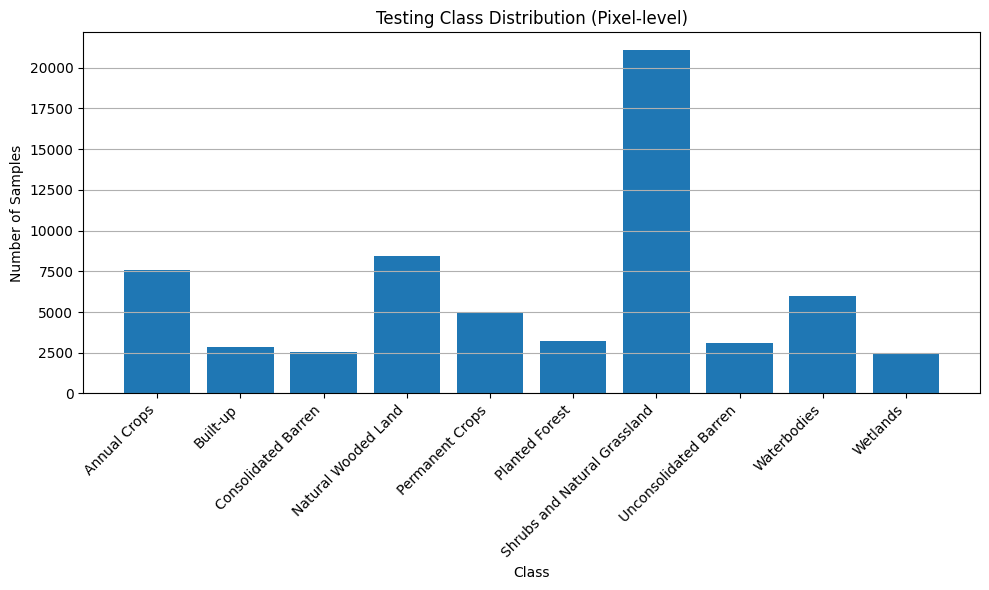

In [ ]:
plot_class_distribution(test_df['Label'].values, label_encoder.classes_, "Testing Class Distribution (Pixel-level)")

In [ ]:
print(X_train.shape, X_test.shape)
print(y_train_cat.shape, y_test_cat.shape)

(243796, 369, 1) (62279, 369, 1)
(243796, 10) (62279, 10)


### Define Model (Loading from weights)

In [ ]:
input_shape = (X_train.shape[1], 1)

# Create new instance of model
model = get_cnn_model(input_shape, num_classes, wd=1e-6, drop_rate=0.3, learning_rate=.0001)


# Load weights
checkpoint_path = checkpointDir + 'Testing/Combined_OutlierRemoval_NewData.weights.h5'
model.load_weights(checkpoint_path)

model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 38 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                      │ (None, 367, 512)            │           2,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d (MaxPooling1D)         │ (None, 183, 512)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_1 (Conv1D)                    │ (None, 181, 256)            │         393,472 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_1 (MaxPooling1D)       │ (None, 90, 256)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_2 (Conv1D)                    │ (None, 88, 256)             │         196,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_2 (MaxPooling1D)       │ (None, 44, 256)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_3 (Conv1D)                    │ (None, 42, 128)             │          98,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 42, 128)             │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 5376)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         688,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,390,250 (5.30 MB)

 Trainable params: 1,389,994 (5.30 MB)

 Non-trainable params: 256 (1.00 KB)

### Define & Train CNN (If not loading from wieghts!)


In [ ]:
# # Define callbacks
# checkpoint_path = checkpointDir + 'Testing/Combined_OutlierRemoval_NewData.weights.h5'
# callbacks = define_callbacks(checkpoint_path)

# input_shape = (X_train.shape[1], 1)

# # Initialize CNN model
# model = get_cnn_model(
#   input_shape=input_shape,
#   num_classes=num_classes,
#   wd=1e-6,
#   drop_rate=0.5,
#   learning_rate=1e-4
# )
# model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv1d (Conv1D)                      │ (None, 367, 512)            │           2,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d (MaxPooling1D)         │ (None, 183, 512)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_1 (Conv1D)                    │ (None, 181, 256)            │         393,472 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_1 (MaxPooling1D)       │ (None, 90, 256)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_2 (Conv1D)                    │ (None, 88, 256)             │         196,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_2 (MaxPooling1D)       │ (None, 44, 256)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_3 (Conv1D)                    │ (None, 42, 128)             │          98,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 42, 128)             │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 5376)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         688,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 10)                  │             330 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,390,250 (5.30 MB)

 Trainable params: 1,389,994 (5.30 MB)

 Non-trainable params: 256 (1.00 KB)

In [ ]:
# Train the model
history = train_model(model, X_train, y_train_cat, X_test, y_test_cat, epochs=30, batch_size=32, checkpoint_path=checkpoint_path)

Epoch 1/30
7619/7619 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.4339 - loss: 1.7153
Epoch 1: val_accuracy improved from -inf to 0.54131, saving model to /content/drive/My Drive/BioSCape/1DCheckpoints/Testing/Combined_OutlierRemoval_NewData.weights.h5
7619/7619 ━━━━━━━━━━━━━━━━━━━━ 115s 13ms/step - accuracy: 0.4340 - loss: 1.7153 - val_accuracy: 0.5413 - val_loss: 1.5677 - learning_rate: 1.0000e-04
Epoch 2/30
7616/7619 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6368 - loss: 1.0869
Epoch 2: val_accuracy improved from 0.54131 to 0.58750, saving model to /content/drive/My Drive/BioSCape/1DCheckpoints/Testing/Combined_OutlierRemoval_NewData.weights.h5
7619/7619 ━━━━━━━━━━━━━━━━━━━━ 121s 12ms/step - accuracy: 0.6368 - loss: 1.0869 - val_accuracy: 0.5875 - val_loss: 1.3883 - learning_rate: 1.0000e-04
Epoch 3/30
7618/7619 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.7056 - loss: 0.8704
Epoch 3: val_accuracy improved from 0.58750 to 0.65006, saving model to /content/drive/My Drive/

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from tensorflow.keras.models import Model

_ = model.predict(X_train_cnn[:1])
feature_layer_output = model.get_layer("feature_layer").output  # or model.layers[-2].output
# Rebuild the feature model without explicitly referencing model.input
feature_model = Model(inputs=model.inputs, outputs=feature_layer_output)
X_train_features = feature_model.predict(X_train_cnn)
X_test_features = feature_model.predict(X_test_cnn)

# Define the parameter grid for tuning
param_grid = {
    'n_estimators': [100, 200],
    #'max_depth': [None, 10, 20],
    #'min_samples_split': [2, 5, 10],
    #'min_samples_leaf': [1, 2, 4],
    #'max_features': ['auto', 'sqrt', 'log2']
}

# Create the RandomForestClassifier
rf = RandomForestClassifier(random_state=42)

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train, y_train)

# Get the best parameters and score
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-validation Score: {grid_search.best_score_}")

# Use the best estimator to make predictions
best_rf_model = grid_search.best_estimator_



# Evaluate on test set
test_accuracy = best_rf_model.score(X_test_features, y_test)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

### Test Model Performance

In [ ]:
# Get the testing Acc. after training
test_accuracy = evaluate_model(model, X_test, y_test_cat)
print("Final Test Accuracy:", test_accuracy)

1947/1947 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - accuracy: 0.8297 - loss: 0.6465
Test Accuracy: 0.7811
Final Test Accuracy: 0.7811461091041565


### Post-Training Visualization

In [ ]:
# Get predictions on the test set
y_test_labels, y_pred_labels, _, _  = get_predictions(model, X_test, y_test_cat, label_encoder)

1947/1947 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step


In [ ]:
# Plotting the training curves
plot_training_curves(history, "1D CNN")

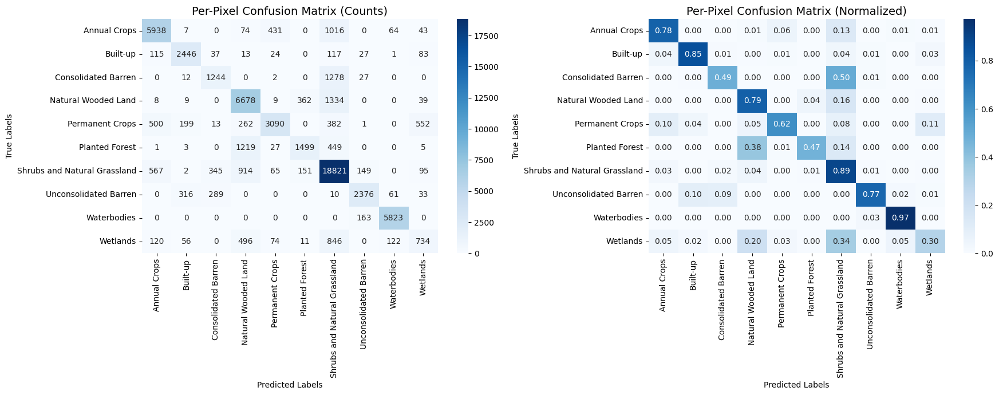

In [ ]:
# Create a CM
conf_mat_counts, conf_mat_normalized = plot_confusion_matrices_with_counts_and_normalized(
    y_true=y_test_labels,
    y_pred=y_pred_labels,
    label_encoder=label_encoder,
    title_counts="Per-Pixel Confusion Matrix (Counts)",
    title_normalized="Per-Pixel Confusion Matrix (Normalized)"
)

In [ ]:
# Get the Classification Report
print(classification_report(y_test_labels, y_pred_labels, target_names=label_encoder.classes_))

                              precision    recall  f1-score   support

                Annual Crops       0.82      0.78      0.80      7573
                    Built-up       0.80      0.85      0.83      2863
         Consolidated Barren       0.65      0.49      0.55      2563
         Natural Wooded Land       0.69      0.79      0.74      8439
             Permanent Crops       0.83      0.62      0.71      4999
              Planted Forest       0.74      0.47      0.57      3203
Shrubs and Natural Grassland       0.78      0.89      0.83     21109
       Unconsolidated Barren       0.87      0.77      0.82      3085
                 Waterbodies       0.96      0.97      0.97      5986
                    Wetlands       0.46      0.30      0.36      2459

                    accuracy                           0.78     62279
                   macro avg       0.76      0.69      0.72     62279
                weighted avg       0.78      0.78      0.77     62279



In [ ]:
results_list = []

# Filter only test images
filtered_test_images_df = test_df[['Sample_num', 'Label', 'File']].drop_duplicates()

# Gather predictions
for index, row in filtered_test_images_df.iterrows():
    sample_num = row['Sample_num']
    image_path = os.path.join(images_path, row['File'])
    ground_truth_str = row['Label']

    if os.path.exists(image_path):
        final_predicted_label = load_predict_and_visualize(
            image_path=image_path,
            ground_truth_label=ground_truth_str,
            model=model,
            label_encoder=label_encoder,
            sample_num=sample_num
        )
        is_correct = (ground_truth_str == final_predicted_label)

        results_list.append({
            'sample_num': sample_num,
            'ground_truth_label': ground_truth_str,
            'final_predicted_label': final_predicted_label,
            'is_correct': is_correct
        })
    else:
        print(f"File not found: {image_path} for Sample_num: {sample_num}")

In [ ]:
# Convert to DataFrame
results_df = pd.DataFrame(results_list)

# Sort by sample_num (optional)
# results_df = results_df.sort_values(by='sample_num')

# Print entire results table
print("\n=== Full Results DF ===")
print(results_df)

# Show misclassifications & correct classification by class
print("\n=== Summary by Ground Truth Class ===")
all_ground_truth_classes = results_df['ground_truth_label'].unique()

for class_label in all_ground_truth_classes:
    subset = results_df[results_df['ground_truth_label'] == class_label]
    correct_subset = subset[subset['is_correct']]
    incorrect_subset = subset[~subset['is_correct']]

    correct_snums = list(correct_subset['sample_num'])

    print(f"\nGround Truth Class: {class_label}")
    print(f"  Correct Sample Nums: {correct_snums if len(correct_snums) > 0 else 'None'}")

    if not incorrect_subset.empty:
        print("  Misclassified Sample Nums:")
        for idx, row in incorrect_subset.iterrows():
            print(f"    Sample_num: {row['sample_num']} -> predicted '{row['final_predicted_label']}'")


### Plot the Image-Level Confusion Matrix


<ipython-input-38-91329a45c060>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df['Predicted_Pixel_Label'] = np.argmax(y_pred_probs, axis=1)


Image-Level Accuracy: 0.8179


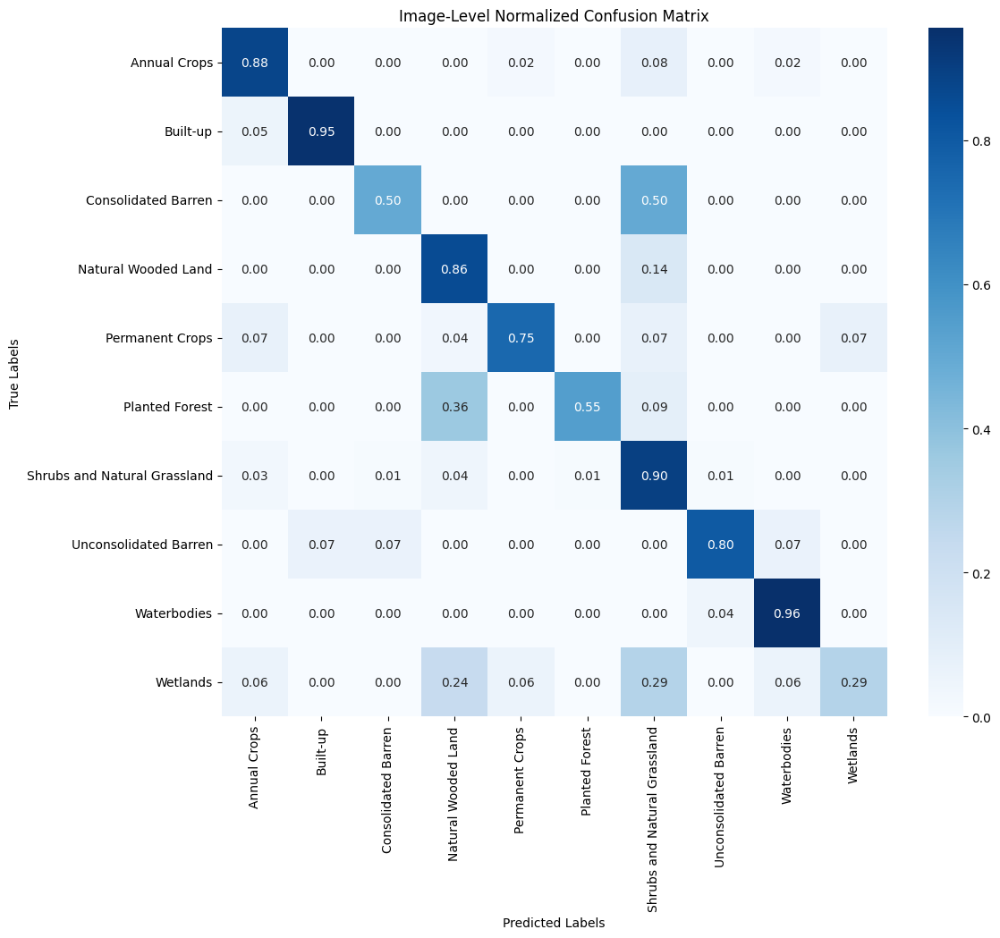

Image-Level Classification Report:
                              precision    recall  f1-score   support

                Annual Crops       0.86      0.88      0.87        49
                    Built-up       0.95      0.95      0.95        19
         Consolidated Barren       0.75      0.50      0.60        12
         Natural Wooded Land       0.68      0.86      0.76        42
             Permanent Crops       0.91      0.75      0.82        28
              Planted Forest       0.92      0.55      0.69        22
Shrubs and Natural Grassland       0.78      0.90      0.83        97
       Unconsolidated Barren       0.80      0.80      0.80        15
                 Waterbodies       0.93      0.96      0.95        45
                    Wetlands       0.71      0.29      0.42        17

                    accuracy                           0.82       346
                   macro avg       0.83      0.74      0.77       346
                weighted avg       0.82      0.82    

In [ ]:
image_accuracy, image_conf_matrix, image_predictions = compute_and_plot_image_level_confusion_matrix_with_returns(
    model,
    test_df,
    label_encoder
)

In [ ]:
# 1) Mark correctness
image_predictions['is_correct'] = (
    image_predictions['Encoded_Label'] == image_predictions['Encoded_Predicted_Label']
)

# 2) Print a summary for each image
print("=== Test Set Image-Level Predictions ===")
for idx, row in image_predictions.iterrows():
    sample_num = row['Sample_num']
    true_label_str = row['Label']

    pred_label_str = label_encoder.inverse_transform([row['Encoded_Predicted_Label']])[0]
    is_correct = row['is_correct']

    print(f"Sample_num: {sample_num} | True: {true_label_str} | Pred: {pred_label_str} | Correct?: {is_correct}")


=== Test Set Image-Level Predictions ===
Sample_num: 2 | True: Unconsolidated Barren | Pred: Unconsolidated Barren | Correct?: True
Sample_num: 5 | True: Annual Crops | Pred: Annual Crops | Correct?: True
Sample_num: 28 | True: Annual Crops | Pred: Annual Crops | Correct?: True
Sample_num: 31 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 33 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 35 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 40 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 41 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 67 | True: Shrubs and Natural Grassland | Pred: Shrubs and Natural Grassland | Correct?: True
Sample_num: 85 | True: Shrubs and Natural Grassland | Pred: Annual Crops | Correct?: 

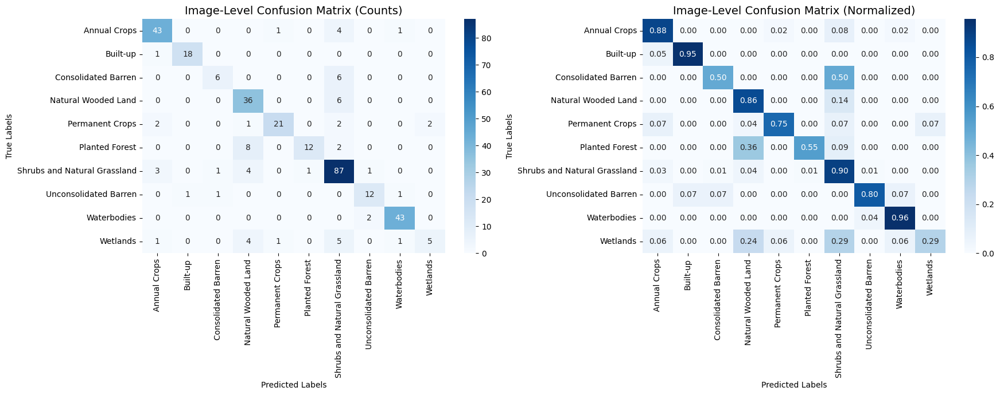

In [ ]:
# Extract string labels from image_predictions
y_true_images = label_encoder.inverse_transform(image_predictions['Encoded_Label'])
y_pred_images = label_encoder.inverse_transform(image_predictions['Encoded_Predicted_Label'])

conf_mat_counts_img, conf_mat_normalized_img = plot_confusion_matrices_with_counts_and_normalized(
    y_true=y_true_images,
    y_pred=y_pred_images,
    label_encoder=label_encoder,
    title_counts="Image-Level Confusion Matrix (Counts)",
    title_normalized="Image-Level Confusion Matrix (Normalized)"
)

### Morphology

In [ ]:
## Remeber to define your model first! Just load from some weights to make it easy...
## NOTE: This takes a long time to run!
color_mapping = generate_colors_for_labels(label_encoder)

results = process_samples_with_morphology(
  test_df,
  model,
  label_encoder,
  color_mapping,
  window_size=3,  # Using smallest window possbile lol
)

### Post-Processing Results

In [ ]:
metrics = compute_accuracy_and_confusion_matrices(**results)

In [ ]:
# Extrat per-pixel true labels and predicted labels after morphogy
y_true_pixels = results['y_true_pixels']  # Ground truth labels for pixels
y_pred_pixels_after = results['y_pred_pixels_after']  # Predicted labels after morphology

# Get per-pixel accuracy after morphology
accuracy_after_morphology = np.mean(np.array(y_true_pixels) == np.array(y_pred_pixels_after))
print(f"Per-pixel Accuracy After Morphology: {accuracy_after_morphology:.4f}")

# Get classification report after morphology
print("Per-pixel Classification Report After Morphology:")
print(classification_report(y_true_pixels, y_pred_pixels_after, target_names=label_encoder.classes_))

In [ ]:
# Extract per-image true labels and predicted labels after morphology
y_true_images = results['y_true_images']  # Ground truth labels for images
y_pred_images_after = results['y_pred_images_after']  # Predicted labels after morphology

# Get per-image classification report
print("Per-image Classification Report After Morphology:")
print(classification_report(y_true_images, y_pred_images_after, target_names=label_encoder.classes_))

In [ ]:
# fget confusion matrix using post-processed predictions
conf_matrix_after = confusion_matrix(
  results['y_true_pixels'],  # True labels
  results['y_pred_pixels_after'],  # Post-processed predicted labels
  labels=range(len(label_encoder.classes_))
)

# Plot the confusion matrix
plt.figure(figsize=(12, 10))
sns.heatmap(
  conf_matrix_after, annot=True, fmt="d", cmap="Blues",
  xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_
)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix After Morphology")
plt.show()


In [ ]:
# Use post-processed per-image predictions
image_predictions_after = pd.DataFrame({
    'Encoded_Ground_Truth': results['y_true_images'],
    'Encoded_Predicted_Label': results['y_pred_images_after']
})

# Geet normalized confusion matrix
cm_normalized_after = confusion_matrix(
    image_predictions_after['Encoded_Ground_Truth'],
    image_predictions_after['Encoded_Predicted_Label'],
    labels=range(len(label_encoder.classes_)),
    normalize='true'
)

# Plot the normalized confusion matrix
fig, ax = plt.subplots(figsize=(12, 10))
disp = ConfusionMatrixDisplay(confusion_matrix=cm_normalized_after, display_labels=label_encoder.classes_)

disp.plot(cmap="Blues", xticks_rotation=45, ax=ax, colorbar=True)
ax.set_xlabel("Predicted Label", fontsize=14, labelpad=15)
ax.set_ylabel("True Label", fontsize=14, labelpad=15)
ax.set_title("Image-Level Confusion Matrix After Morphology", fontsize=16, pad=20)

plt.tight_layout()
plt.show()


In [ ]:
# Get the testing Acc. after training
test_accuracy = evaluate_model(model, X_test, y_test_cat)
print("Final Test Accuracy:", test_accuracy)

# 2D - CNN

### Explanation of Model Differences
 - **MicroCNN & MacroCNN:** These models use PCA components (specifically PC2, PC3, PC4) as the three input channels.
   - The images are spatial arrays of pixels derived from the PCA-transformed spectral data.
   - MicroCNN is a smaller network with fewer layers and parameters
   - MacroCNN is deeper and includes more layers and dropout for potentially better generalization.

 - **RGB CNN:** Uses three selected frequency bands directly as input channels, analogous to standard RGB images.
  - This approach tests the model's ability to classify based on raw spectral channels chosen to mimic an RGB representation.


---


 In summary:
 - MicroCNN & MacroCNN inputs: PCA images (PC2, PC3, PC4).
 - RGB CNN input: Selected raw spectral bands arranged as RGB channels.

## 2D - CNN

### These cells contain functions to define the Pipeline

#### PreProcessing

In [ ]:
def resize_to_10x10(img_array):
    """
    Resizes any image to (10,10) while preserving the number of channels.
    """
    if img_array.shape[0:2] != (10,10):
        print(f"Resizing image from {img_array.shape[0:2]} to (10, 10)")
        channels = img_array.shape[2]
        resized_bands = []
        for c in range(channels):
            resized_band = resize(img_array[..., c], (10, 10), mode='constant', anti_aliasing=True)
            resized_bands.append(resized_band)
        img_array = np.stack(resized_bands, axis=-1)
    return img_array

In [ ]:
def reshape_to_images_using_img_pos(pca_df, selected_pcs):
    """
    Converts PCA-transformed pixel-level data back into images using 'img_pos' and 'Shape' metadata.
    Returns images as a list, plus their labels and sample numbers.
    This is flexible for images of varying shapes.
    """
    images = []
    labels = []
    sample_nums = []

    grouped = pca_df.groupby(['Sample_num', 'Shape'])
    for (sample_num, shape_str), group in grouped:
        shape_str_clean = shape_str.replace('(', '').replace(')', '')
        h, w = map(int, shape_str_clean.split(','))

        img_array = np.full((h, w, len(selected_pcs)), np.nan, dtype=np.float32)
        group = group.copy()
        group['row_col'] = group['img_pos'].apply(lambda x: ast.literal_eval(x))

        for _, row in group.iterrows():
            row_, col_ = row['row_col']
            if 0 <= row_ < h and 0 <= col_ < w:
                for c_idx, pc in enumerate(selected_pcs):
                    img_array[row_, col_, c_idx] = row[pc]

        img_array = np.nan_to_num(img_array, nan=0.0)
        label = group['Label_Encoded'].mode()[0]
        images.append(img_array)
        labels.append(label)
        sample_nums.append(sample_num)

    print(f"Created {len(images)} images from PCA components {selected_pcs}.")
    return images, np.array(labels), np.array(sample_nums)

In [ ]:
def remove_infrequent_image_labels(images, labels, sample_nums, label_encoder, min_frequency=50):
    """
    Removes classes that have fewer than `min_frequency` images at the image level.
    Ensures adequate representation for training.
    """
    label_counts = Counter(labels)
    valid_labels = {lbl for lbl, cnt in label_counts.items() if cnt >= min_frequency}
    kept_classes = label_encoder.inverse_transform(list(valid_labels)) if valid_labels else []
    print(f"Classes retained (≥ {min_frequency} images): {kept_classes}")

    if not valid_labels:
        raise ValueError("No classes meet the minimum frequency requirement.")

    mask = np.array([lbl in valid_labels for lbl in labels])
    images_filtered = [images[i] for i in range(len(images)) if mask[i]]
    labels_filtered = labels[mask]
    sample_nums_filtered = sample_nums[mask]

    print(f"Original image count: {len(images)}")
    print(f"Filtered image count: {len(images_filtered)}")

    return images_filtered, labels_filtered, sample_nums_filtered

#### Vizualization

In [ ]:
def plot_pca_variance(explained_variance_ratio, selected_n_components, threshold_line=0.95):
    """
    Plots explained variance per component and the cumulative explained variance.

    Parameters:
    - explained_variance_ratio (array): Array of explained variance ratios for each PCA component.
    - selected_n_components (int): The number of components selected based on criteria.
    - threshold_line (float): The variance threshold (e.g., 0.95) to highlight on the plot.
    """
    cum_variance = np.cumsum(explained_variance_ratio)
    n_components = len(explained_variance_ratio)

    fig, ax1 = plt.subplots(figsize=(10, 5))

    # Plot explained variance ratio
    ax1.bar(range(1, n_components + 1), explained_variance_ratio, alpha=0.7, label='Explained Variance per Component')
    ax1.set_xlabel('Principal Component')
    ax1.set_ylabel('Explained Variance Ratio', color='b')
    ax1.set_xticks(range(1, n_components + 1))
    ax1.tick_params(axis='y', labelcolor='b')

    # Plot cumulative variance on a secondary axis
    ax2 = ax1.twinx()
    ax2.plot(range(1, n_components + 1), cum_variance, color='r', marker='o', label='Cumulative Explained Variance')
    ax2.axhline(y=threshold_line, color='g', linestyle='--', label=f'{threshold_line*100}% Threshold')
    ax2.set_ylabel('Cumulative Explained Variance', color='r')
    ax2.tick_params(axis='y', labelcolor='r')

    # Highlight the selected number of components
    ax1.axvline(x=selected_n_components, color='k', linestyle='--', label=f'Selected: {selected_n_components} PCs')

    fig.legend(loc='upper left', bbox_to_anchor=(0.1, 0.95))
    plt.title('PCA Explained Variance and Cumulative Explained Variance')
    plt.tight_layout()
    plt.show()

#### Data Split

In [ ]:
def stratified_image_level_split(sample_nums, labels, test_size=0.2, random_state=42):
    """
    Performs a stratified split at the image level (Sample_num).
    Ensures no data leakage from the same area into both train and test sets.
    """
    unique_df = pd.DataFrame({'Sample_num': sample_nums, 'Label_Encoded': labels}).drop_duplicates()
    sss = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=random_state)
    train_idx, test_idx = next(sss.split(unique_df['Sample_num'], unique_df['Label_Encoded']))
    train_samples = unique_df['Sample_num'].iloc[train_idx].values
    test_samples = unique_df['Sample_num'].iloc[test_idx].values
    return train_samples, test_samples

In [ ]:
def split_data_by_samples(images, labels, sample_nums, train_samples, test_samples):
    """
    Splits data into train/test sets based on Sample_num.
    Also resizes all images to 10x10 and converts them into a uniform NumPy array.
    """
    train_mask = np.isin(sample_nums, train_samples)
    test_mask = np.isin(sample_nums, test_samples)

    X_train_list = [images[i] for i in range(len(images)) if train_mask[i]]
    y_train = labels[train_mask]
    X_test_list = [images[i] for i in range(len(images)) if test_mask[i]]
    y_test = labels[test_mask]

    print(f"Training set: {len(X_train_list)} images")
    print(f"Testing set: {len(X_test_list)} images")

    if len(X_test_list) == 0:
        raise ValueError("Test set is empty. Adjust your splitting or dataset.")

    # Resize all images to (10,10)
    X_train = np.array([resize_to_10x10(img) for img in X_train_list], dtype=np.float32)
    X_test = np.array([resize_to_10x10(img) for img in X_test_list], dtype=np.float32)

    return X_train, X_test, y_train, y_test

#### PCA

In [ ]:
def determine_pca_components(X_train_scaled, variance_threshold=0.9):
  """
  Determine the number of PCA components needed to explain at least `variance_threshold` of the variance.
  """
  pca_full = PCA()
  pca_full.fit(X_train_scaled)
  cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)
  n_components = np.searchsorted(cumulative_variance, variance_threshold) + 1
  print(f"Number of components to reach {variance_threshold*100}% variance: {n_components}")
  return n_components


In [ ]:
def apply_pca_pixel_level(train_df, test_df, frequency_cols):
    """
    Apply PCA at pixel level, fit only on training pixels to avoid data leakage, and transform the test set.

    Steps:
    1. Scale training data and fit PCA with all components (tbd).
    2. Analyze  cumulative explained variance and dynamically select components:
       - Get cumulative variance.
       - Use a 95% baseline threshold.
       - If remaining components contributes <2% added variance beyond 95%, limit to ~95%.
         Otherwise, keep all that cross  main threshold.
    3. Transform both train and test sets using selected components.
    4. Return updated DataFrames with selected principal components and fitted PCA object.
    """
    # Extract arrays
    X_train = train_df[frequency_cols].values
    X_test = test_df[frequency_cols].values

    # Scale the data
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Fit PCA with all components
    pca_full = PCA()
    pca_full.fit(X_train_scaled)

    explained_variance_ratio = pca_full.explained_variance_ratio_
    cum_variance = np.cumsum(explained_variance_ratio)

    # Set baseline thresholds
    main_threshold = 0.95  # Min desired cumulative variance
    additional_variance_cutoff = 0.01  # <1% added variance beyond main threshold

    # Find the min components to reach main threshold (95%)
    main_components = np.searchsorted(cum_variance, main_threshold) + 1

    # Plot variance analysis
    plot_pca_variance(explained_variance_ratio, main_components, threshold_line=main_threshold)

    # Refit PCA with selected num of components
    pca = PCA(n_components=main_components)
    X_train_pca = pca.fit_transform(X_train_scaled)
    X_test_pca = pca.transform(X_test_scaled)

    # Build PC column names
    pc_columns = [f'PC{i+1}' for i in range(main_components)]

    # Create DataFrames with selected PCs
    train_pca_df = pd.concat([train_df.reset_index(drop=True), pd.DataFrame(X_train_pca, columns=pc_columns)], axis=1)
    test_pca_df = pd.concat([test_df.reset_index(drop=True), pd.DataFrame(X_test_pca, columns=pc_columns)], axis=1)

    print(f"\nPCA completed with {main_components} components.")
    print(f"Total explained variance: {cum_variance[main_components-1]*100:.2f}%")

    return train_pca_df, test_pca_df, pca

#### RGB

In [ ]:
def create_rgb_images(samples_df, rgb_bands):
    images = []
    labels = []
    sample_nums = []

    grouped = samples_df.groupby(['Sample_num', 'Shape'])

    for (sample_num, shape_str), group in grouped:
        shape_str_clean = shape_str.replace('(', '').replace(')', '')
        h, w = map(int, shape_str_clean.split(','))

        img_array = np.full((h, w, 3), np.nan, dtype=np.float32)
        group = group.copy()
        group['row_col'] = group['img_pos'].apply(lambda x: ast.literal_eval(x))

        for i, row in group.iterrows():
            row_, col_ = row['row_col']
            if 0 <= row_ < h and 0 <= col_ < w:
                img_array[row_, col_, 0] = row[rgb_bands[0]]
                img_array[row_, col_, 1] = row[rgb_bands[1]]
                img_array[row_, col_, 2] = row[rgb_bands[2]]

        img_array = np.nan_to_num(img_array, nan=0.0)
        # No resizing yet

        label = group['Label_Encoded'].mode()[0]
        images.append(img_array)
        labels.append(label)
        sample_nums.append(sample_num)

    print(f"Created {len(images)} RGB images using bands {rgb_bands}.")
    return images, np.array(labels), np.array(sample_nums)

#### Models



In [ ]:
def get_micro_cnn(input_shape, num_classes, learning_rate=1e-4, drop_rate=0.2):
  model = models.Sequential([
    layers.Input(shape=input_shape),

    # Block 3
    layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.Conv2D(512, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(drop_rate),

    # Fully Connected Layers
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(drop_rate),

    layers.Dense(64, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(drop_rate),

    # Output Layer
    layers.Dense(num_classes, activation='softmax')
  ])
  model.compile(optimizer=Adam(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])

  return model

In [ ]:
def get_macro_cnn(input_shape, num_classes, learning_rate=1e-4, drop_rate=.2):
  model = models.Sequential([
    layers.Input(shape=input_shape),
    # Block 2
    layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(drop_rate),

    # Block 3
    layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.Conv2D(512, (3, 3), activation='relu', padding='same'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Dropout(drop_rate),

    # Fully Connected Layers
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(drop_rate),

    layers.Dense(64, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(drop_rate),

    # Output Layer
    layers.Dense(num_classes, activation='softmax')
  ])
  model.compile(optimizer=Adam(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])

  return model

In [ ]:
def get_rgb_cnn(input_shape, num_classes, learning_rate=5e-4):
  model = models.Sequential([
      layers.Input(shape=input_shape),
      layers.Conv2D(32, (3, 3), activation='relu'),
      layers.BatchNormalization(),
      layers.MaxPooling2D((2, 2)),
      layers.Conv2D(64, (3, 3), activation='relu'),
      layers.BatchNormalization(),
      layers.Flatten(),
      layers.Dense(128, activation='relu'),
      layers.Dropout(0.5),
      layers.Dense(num_classes, activation='softmax')
  ])

  model.compile(optimizer=Adam(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])

  return model

In [ ]:
def train_and_evaluate_2d_model(model, X_train, y_train_cat, X_test, y_test_cat, model_name, checkpoint_path, epochs=10, batch_size=32):
    callbacks = define_callbacks(checkpoint_path)
    history = model.fit(X_train, y_train_cat, validation_data=(X_test, y_test_cat),
                        epochs=epochs, batch_size=batch_size, callbacks=callbacks)
    test_loss, test_acc = model.evaluate(X_test, y_test_cat, verbose=1)
    print(f"{model_name} Test Accuracy: {test_acc:.4f}")
    return model, history, test_acc

### Execute Pipeline
---

In [ ]:
# Load and preprocess data
samples_df = pd.read_csv(samples_path)

# Preprocess data (remove NaNs, -9999, label encode)
samples_df, label_encoder = preprocess_data(samples_df)

# Get the Freq. cols
frequency_cols = [c for c in samples_df.columns if c.startswith('frq')]

# Set number of classes
num_classes=len(label_encoder.classes_)

#### Stratified Split

In [ ]:
# Image-level splitting before PCA to avoid data leakage
# We have pixel-level data with Sample_num and Label_Encoded.
unique_samples = samples_df[['Sample_num', 'Label_Encoded']].drop_duplicates()
train_samples, test_samples = stratified_image_level_split(
    unique_samples['Sample_num'].values,
    unique_samples['Label_Encoded'].values,
    test_size=0.2
)

# Filter the original DataFrame into train and test sets
train_df = samples_df[samples_df['Sample_num'].isin(train_samples)].copy()
test_df  = samples_df[samples_df['Sample_num'].isin(test_samples)].copy()

#### Apply PCA & reconstruct Images from PCA DataFrames

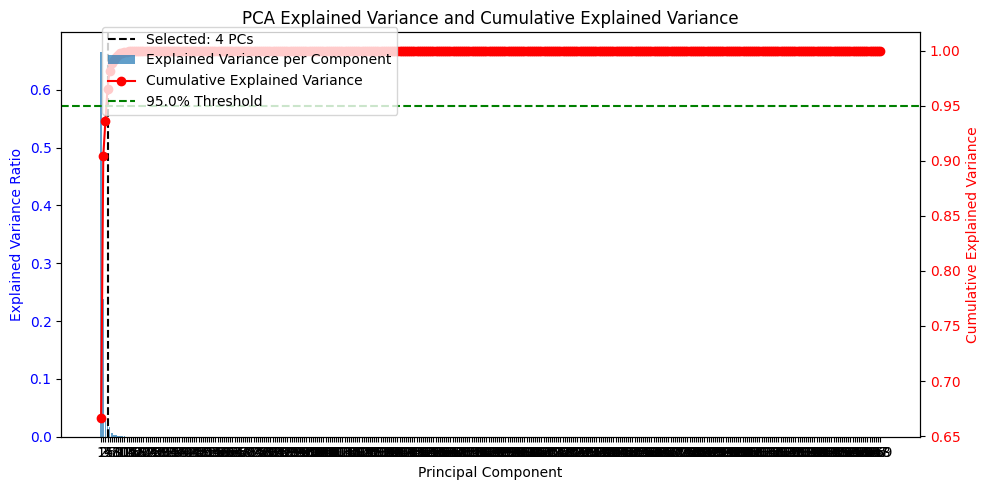


PCA completed with 4 components.
Total explained variance: 96.55%
Selected Principal Components: ['PC1', 'PC2', 'PC3', 'PC4']


In [ ]:
# Apply PCA on pixel-level data (training only), then transform test
train_pca_df, test_pca_df, pca = apply_pca_pixel_level(train_df, test_df, frequency_cols)

# Determine available PCs
available_pcs = [c for c in train_pca_df.columns if c.startswith('PC')]
selected_pcs = available_pcs  # you can choose fewer if desired
print("Selected Principal Components:", selected_pcs)

In [ ]:
# Reconstruct images from PCA DataFrames
X_train_pca_images, y_train_labels, train_image_sample_nums = reshape_to_images_using_img_pos(
    train_pca_df, selected_pcs=selected_pcs
)
X_test_pca_images, y_test_labels, test_image_sample_nums = reshape_to_images_using_img_pos(
    test_pca_df, selected_pcs=selected_pcs
)

Created 2182 images from PCA components ['PC1', 'PC2', 'PC3', 'PC4'].
Created 539 images from PCA components ['PC1', 'PC2', 'PC3', 'PC4'].


#### Final Split at Image Level and Resize to (10,10)

In [ ]:
X_train = np.array([resize_to_10x10(img) for img in X_train_pca_images], dtype=np.float32)
X_test  = np.array([resize_to_10x10(img) for img in X_test_pca_images], dtype=np.float32)

# The labels are the arrays returned by 'reshape_to_images_using_img_pos'
y_train = y_train_labels
y_test  = y_test_labels

Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (12, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image f

In [ ]:
# Verify shapes
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
assert X_train.shape[1:] == (10, 10, len(selected_pcs)), f"Invalid X_train shape: {X_train.shape}"
if X_test.shape[0] > 0:
    assert X_test.shape[1:] == (10, 10, len(selected_pcs)), f"Invalid X_test shape: {X_test.shape}"

X_train shape: (2182, 10, 10, 4)
X_test shape: (539, 10, 10, 4)


In [ ]:
# Convert labels to categorical
y_train_cat = to_categorical(y_train, num_classes=num_classes)
y_test_cat = to_categorical(y_test, num_classes=num_classes)

#### Get Class Weights


In [ ]:
class_weights = get_class_weights(y_train)


Class Weights:
Consolidated Barren    Weight: 2.3614718614718613
Unconsolidated Barren  Weight: 2.306553911205074
Built-up               Weight: 1.963996399639964
Wetlands               Weight: 1.8367003367003367
Planted Forest         Weight: 1.5377026074700493
Permanent Crops        Weight: 1.194961664841183
Natural Grassland      Weight: 1.0959316926167755
Natural Wooded Land    Weight: 0.731969137873197
Annual Crops           Weight: 0.6770089978281104
Waterbodies            Weight: 0.6634235329887503
Shrubs                 Weight: 0.42750783699059564


### Micro CNN


---



In [ ]:
# Get the CNN model and Train
micro_model = get_micro_cnn(X_train.shape[1:], num_classes, drop_rate=.2)

In [ ]:
micro_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 10, 10, 128)         │           4,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 10, 10, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 10, 10, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 10, 10, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 10, 10, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 10, 10, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 5, 5, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 5, 5, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 12800)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │       3,277,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 11)                  │             715 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,779,147 (18.23 MB)

 Trainable params: 4,776,715 (18.22 MB)

 Non-trainable params: 2,432 (9.50 KB)

#### Train without weights

In [ ]:
# micro_history = train_model(micro_model, X_train, y_train_cat, X_test, y_test_cat,
#                             epochs=100, batch_size=32, checkpoint_path=microcnn_checkpoint_path)

Epoch 1/100
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.3569 - loss: 2.1168
Epoch 1: val_accuracy improved from -inf to 0.17811, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/microcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 26s 200ms/step - accuracy: 0.3580 - loss: 2.1125 - val_accuracy: 0.1781 - val_loss: 2.2251 - learning_rate: 1.0000e-04
Epoch 2/100
68/69 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.5197 - loss: 1.4690
Epoch 2: val_accuracy did not improve from 0.17811
69/69 ━━━━━━━━━━━━━━━━━━━━ 21s 12ms/step - accuracy: 0.5193 - loss: 1.4694 - val_accuracy: 0.1373 - val_loss: 2.3894 - learning_rate: 1.0000e-04
Epoch 3/100
67/69 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.5389 - loss: 1.3722
Epoch 3: val_accuracy improved from 0.17811 to 0.22078, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/microcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - accuracy: 0.5385 - loss: 1.3732 - val_accuracy: 0.2208 - v

#### Train Using Class Weights

In [ ]:
micro_history = train_model_with_class_weights(
    micro_model,
    X_train,
    y_train_cat,
    X_test,
    y_test_cat,
    class_weights=class_weights,
    epochs=100,
    batch_size=32
)

Epoch 1/100
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - accuracy: 0.3347 - loss: 2.1768
Epoch 1: val_accuracy improved from -inf to 0.26345, saving model to /content/drive/My Drive/BioSCape/1DCheckpoints/Testing/my_weights.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 22s 149ms/step - accuracy: 0.3353 - loss: 2.1740 - val_accuracy: 0.2635 - val_loss: 28.4135 - learning_rate: 1.0000e-04
Epoch 2/100
67/69 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.4155 - loss: 1.6894
Epoch 2: val_accuracy did not improve from 0.26345
69/69 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - accuracy: 0.4158 - loss: 1.6890 - val_accuracy: 0.2152 - val_loss: 21.5557 - learning_rate: 1.0000e-04
Epoch 3/100
67/69 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.4637 - loss: 1.5769
Epoch 3: val_accuracy did not improve from 0.26345
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.4635 - loss: 1.5750 - val_accuracy: 0.1707 - val_loss: 32.2125 - learning_rate: 1.0000e-04
Epoch 4/100
67/69 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accu

In [ ]:
# Get the testing accuracy
micro_test_acc = evaluate_model(micro_model, X_test, y_test_cat)

17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.1620 - loss: 24.6618
Test Accuracy: 0.1800


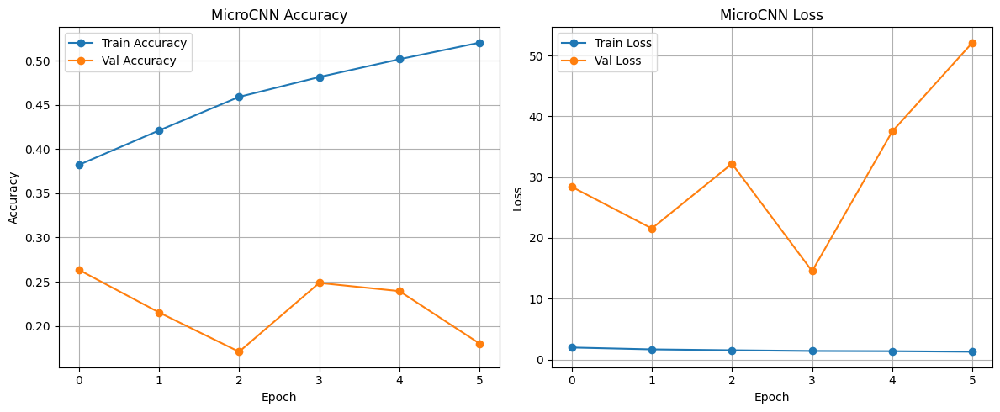

In [ ]:
# Plotting the training curves
plot_training_curves(micro_history, "MicroCNN")

17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step


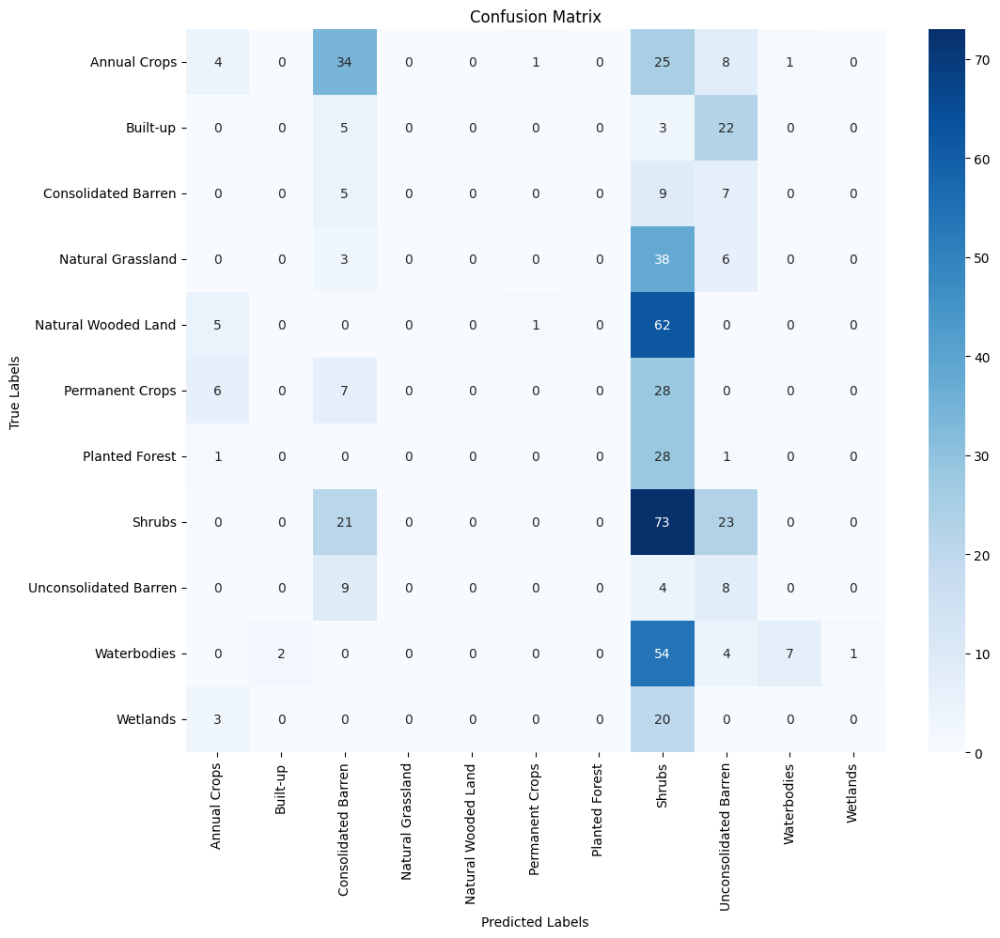

In [ ]:
# Get the predictions and create a CM
y_true_labels, y_pred_labels, _, _ = get_predictions(micro_model, X_test, y_test_cat, label_encoder)
plot_confusion_matrix(y_true_labels, y_pred_labels, label_encoder)

In [ ]:
print("Classification Report (MicroCNN):")
print(classification_report(y_true_labels, y_pred_labels, target_names=label_encoder.classes_))

Classification Report (MicroCNN):
                       precision    recall  f1-score   support

         Annual Crops       0.21      0.05      0.09        73
             Built-up       0.00      0.00      0.00        30
  Consolidated Barren       0.06      0.24      0.10        21
    Natural Grassland       0.00      0.00      0.00        47
  Natural Wooded Land       0.00      0.00      0.00        68
      Permanent Crops       0.00      0.00      0.00        41
       Planted Forest       0.00      0.00      0.00        30
               Shrubs       0.21      0.62      0.32       117
Unconsolidated Barren       0.10      0.38      0.16        21
          Waterbodies       0.88      0.10      0.18        68
             Wetlands       0.00      0.00      0.00        23

             accuracy                           0.18       539
            macro avg       0.13      0.13      0.08       539
         weighted avg       0.19      0.18      0.11       539



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### MacroCNN


---



In [ ]:
# Train MacroCNN
macro_model = get_macro_cnn(X_train.shape[1:], len(label_encoder.classes_))
macro_history = train_model(macro_model, X_train, y_train_cat, X_test, y_test_cat, epochs=50, batch_size=32, checkpoint_path=macrocnn_checkpoint_path)

Epoch 1/50
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - accuracy: 0.3072 - loss: 2.2514
Epoch 1: val_accuracy improved from -inf to 0.22078, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/macrocnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 25s 179ms/step - accuracy: 0.3085 - loss: 2.2468 - val_accuracy: 0.2208 - val_loss: 2.2252 - learning_rate: 1.0000e-04
Epoch 2/50
67/69 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.4603 - loss: 1.6760
Epoch 2: val_accuracy did not improve from 0.22078
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.4606 - loss: 1.6747 - val_accuracy: 0.2208 - val_loss: 2.1686 - learning_rate: 1.0000e-04
Epoch 3/50
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4765 - loss: 1.5551
Epoch 3: val_accuracy improved from 0.22078 to 0.29128, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/macrocnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4766 - loss: 1.5550 - val_accuracy: 0.2913 - val_los

In [ ]:
macro_test_acc = evaluate_model(macro_model, X_test, y_test_cat)

17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.2172 - loss: 2.4756 
Test Accuracy: 0.2022


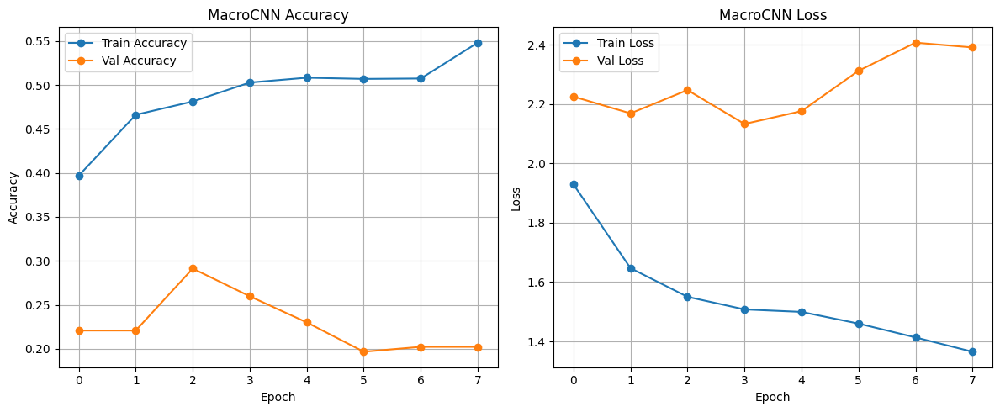

In [ ]:
plot_training_curves(macro_history, "MacroCNN")

17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step


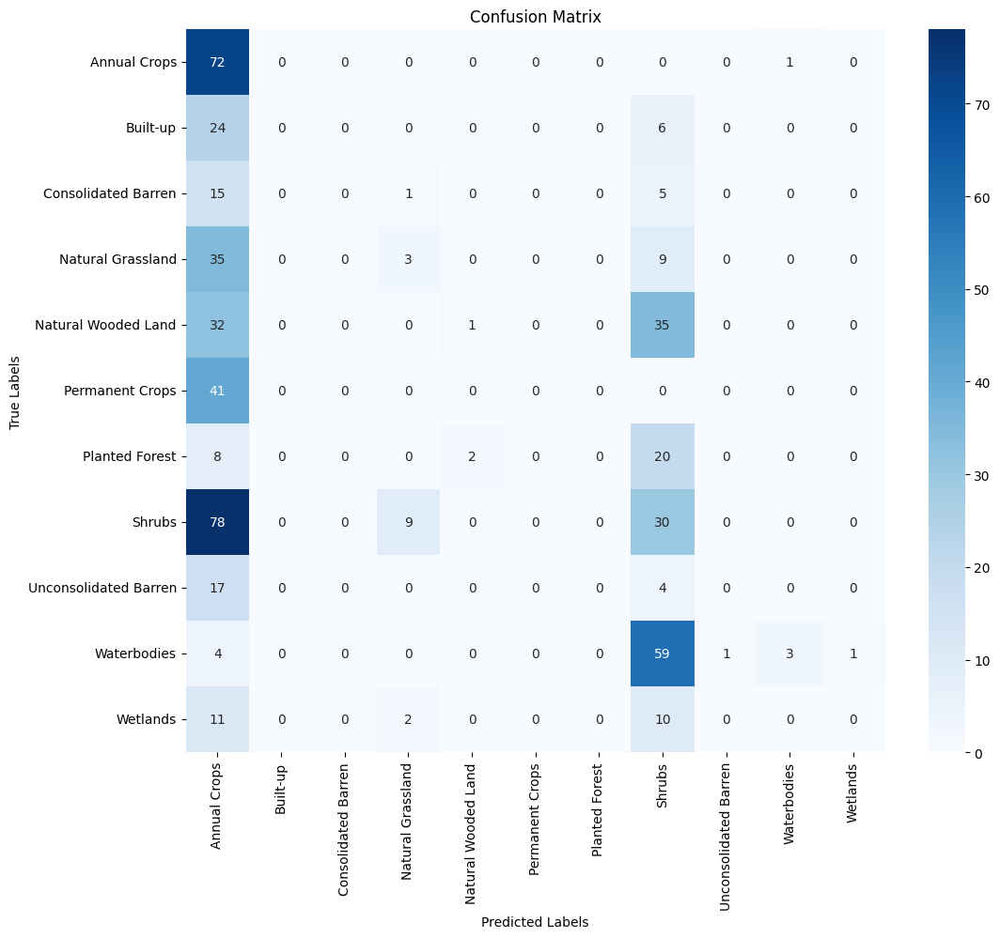

In [ ]:
y_true_labels_macro, y_pred_labels_macro, _, _ = get_predictions(macro_model, X_test, y_test_cat, label_encoder)
plot_confusion_matrix(y_true_labels_macro, y_pred_labels_macro, label_encoder)

In [ ]:
print("Classification Report (MacroCNN):")
print(classification_report(y_true_labels_macro, y_pred_labels_macro, target_names=label_encoder.classes_))

Classification Report (MacroCNN):
                       precision    recall  f1-score   support

         Annual Crops       0.21      0.99      0.35        73
             Built-up       0.00      0.00      0.00        30
  Consolidated Barren       0.00      0.00      0.00        21
    Natural Grassland       0.20      0.06      0.10        47
  Natural Wooded Land       0.33      0.01      0.03        68
      Permanent Crops       0.00      0.00      0.00        41
       Planted Forest       0.00      0.00      0.00        30
               Shrubs       0.17      0.26      0.20       117
Unconsolidated Barren       0.00      0.00      0.00        21
          Waterbodies       0.75      0.04      0.08        68
             Wetlands       0.00      0.00      0.00        23

             accuracy                           0.20       539
            macro avg       0.15      0.12      0.07       539
         weighted avg       0.22      0.20      0.11       539



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


### RGB CNN

RGB CNN (No PCA, uses RGB-like bands)
 - Idea is that data is an array of shape (num_images,10,10,3)
 extracted from three specific frequency bands chosen.
---



Created 2721 RGB images using bands ['frq21', 'frq35', 'frq57'].


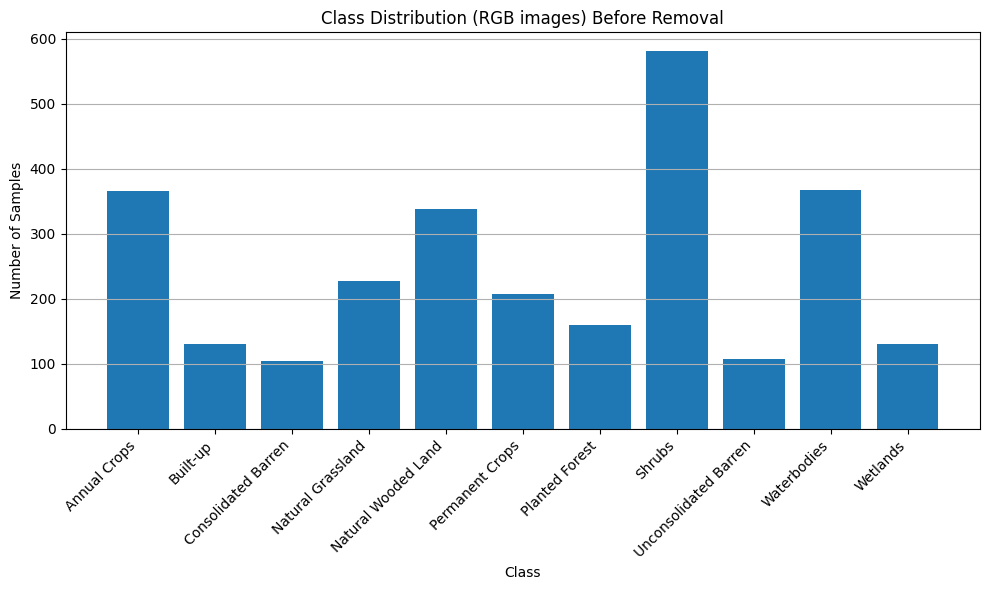

Classes retained (≥ 50 images): ['Annual Crops' 'Built-up' 'Consolidated Barren' 'Natural Grassland'
 'Natural Wooded Land' 'Permanent Crops' 'Planted Forest' 'Shrubs'
 'Unconsolidated Barren' 'Waterbodies' 'Wetlands']
Original image count: 2721
Filtered image count: 2721
Training set: 2182 images
Testing set: 539 images
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (12, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (

In [ ]:
### RGB CNN (No PCA, uses RGB-like bands)
# Extracted from three specific frequency bands: 'frq21', 'frq35', 'frq57'

# Step 1: Create RGB Images
rgb_bands = ['frq21', 'frq35', 'frq57']
rgb_images, rgb_labels, rgb_sample_nums = create_rgb_images(samples_df, rgb_bands)

# Step 2: Show class distribution at image-level before removal
plot_class_distribution(rgb_labels, label_encoder.classes_, "Class Distribution (RGB images) Before Removal")

# Step 3: Combine Train and Test Samples Before Filtering Infrequent Classes
# Ensure uniform filtering process across train and test sets
rgb_images_combined, rgb_labels_combined, rgb_sample_nums_combined = remove_infrequent_image_labels(
    rgb_images, rgb_labels, rgb_sample_nums, label_encoder, min_frequency=50
)

# Step 4: Stratified Split After Filtering
train_samples_rgb, test_samples_rgb = stratified_image_level_split(
    rgb_sample_nums_combined, rgb_labels_combined, test_size=0.2
)

# Step 5: Split into Train/Test Sets and Resize Images
X_train_rgb, X_test_rgb, y_train_rgb, y_test_rgb = split_data_by_samples(
    rgb_images_combined, rgb_labels_combined, rgb_sample_nums_combined,
    train_samples_rgb, test_samples_rgb
)

X_train_rgb shape: (2182, 10, 10, 3)
X_test_rgb shape: (539, 10, 10, 3)


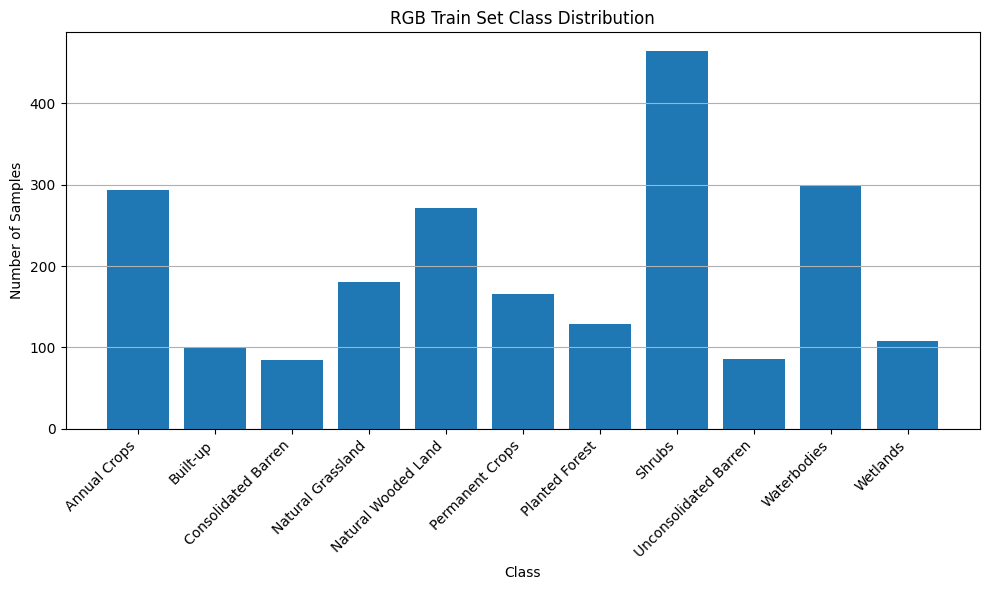

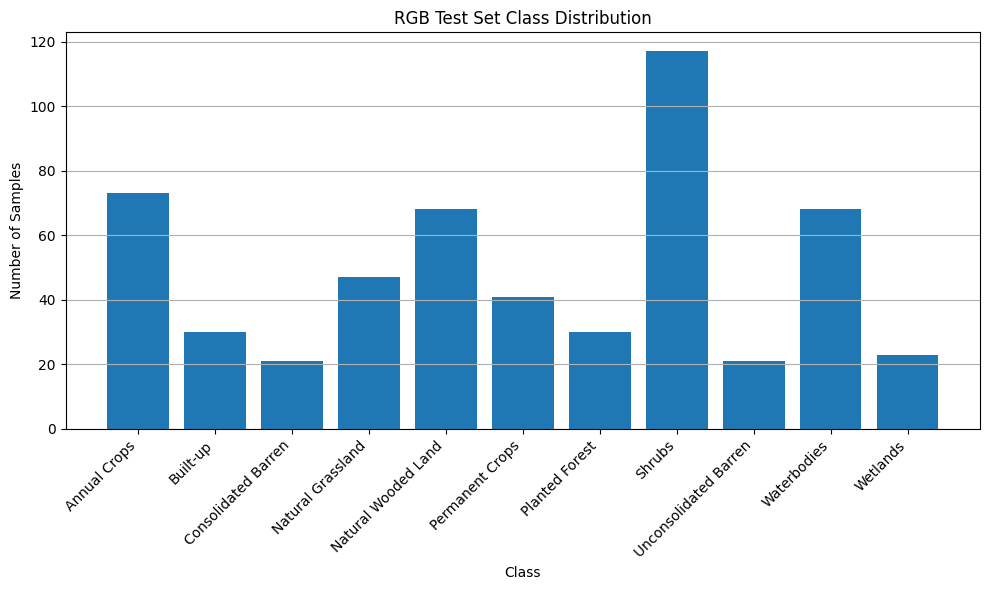

In [ ]:
# Step 6: Verify Shapes and Resize Check
assert X_train_rgb.shape[1:] == (10, 10, 3), f"Invalid X_train shape: {X_train_rgb.shape}"
assert X_test_rgb.shape[1:] == (10, 10, 3), f"Invalid X_test shape: {X_test_rgb.shape}"

print("X_train_rgb shape:", X_train_rgb.shape)
print("X_test_rgb shape:", X_test_rgb.shape)

# Step 7: Show Class Distribution in Train/Test Sets
plot_class_distribution(y_train_rgb, label_encoder.classes_, "RGB Train Set Class Distribution")
plot_class_distribution(y_test_rgb, label_encoder.classes_, "RGB Test Set Class Distribution")

# Step 8: Convert Labels to Categorical
y_train_rgb_cat = to_categorical(y_train_rgb, num_classes=len(label_encoder.classes_))
y_test_rgb_cat = to_categorical(y_test_rgb, num_classes=len(label_encoder.classes_))

In [ ]:
# Step 10: Train and Evaluate the RGB CNN
# Step 9: Get the RGB CNN Model
rgb_model = get_rgb_cnn(X_train_rgb.shape[1:], len(label_encoder.classes_))

rgb_history = train_model(rgb_model, X_train_rgb, y_train_rgb_cat, X_test_rgb, y_test_rgb_cat, epochs=50,
                            batch_size=32, checkpoint_path=rgbcnn_checkpoint_path)

Epoch 1/50
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - accuracy: 0.2472 - loss: 2.4609
Epoch 1: val_accuracy improved from -inf to 0.23006, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/rgbcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 9s 66ms/step - accuracy: 0.2482 - loss: 2.4568 - val_accuracy: 0.2301 - val_loss: 2.3242 - learning_rate: 5.0000e-04
Epoch 2/50
58/69 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4069 - loss: 1.7949
Epoch 2: val_accuracy did not improve from 0.23006
69/69 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.4102 - loss: 1.7878 - val_accuracy: 0.2226 - val_loss: 2.2560 - learning_rate: 5.0000e-04
Epoch 3/50
50/69 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4796 - loss: 1.6127
Epoch 3: val_accuracy did not improve from 0.23006
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.4748 - loss: 1.6194 - val_accuracy: 0.2226 - val_loss: 2.2559 - learning_rate: 5.0000e-04
Epoch 4/50
66/69 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4614

17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5741 - loss: 1.2683 
Test Accuracy: 0.5492
RGB CNN Test Accuracy: 0.5492


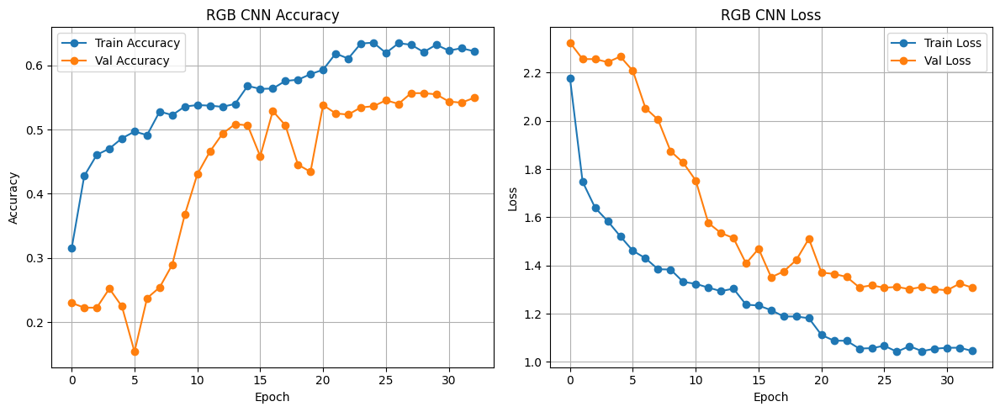

In [ ]:
# Step 11: Evaluate Model Accuracy
rgb_test_accuracy = evaluate_model(rgb_model, X_test_rgb, y_test_rgb_cat)
print(f"RGB CNN Test Accuracy: {rgb_test_accuracy:.4f}")

# Step 12: Plot Training Curves
plot_training_curves(rgb_history, "RGB CNN")

17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step


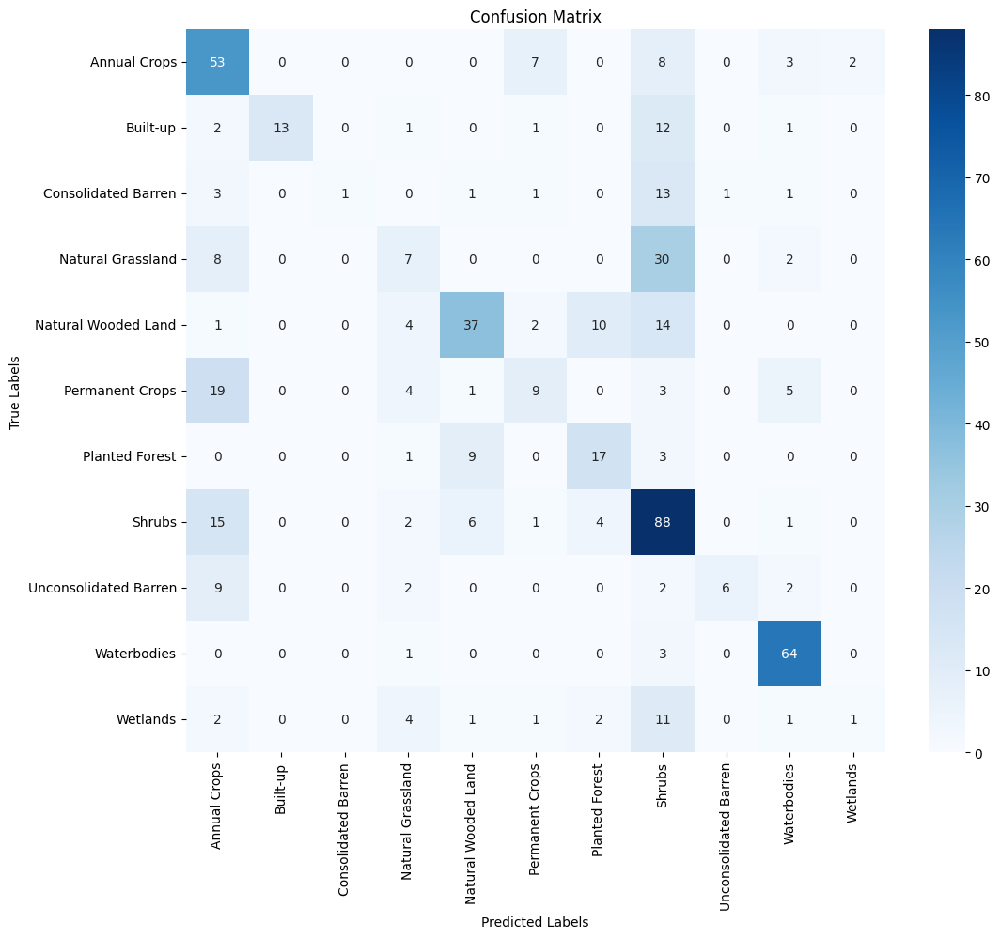

Classification Report (RGB CNN):
                       precision    recall  f1-score   support

         Annual Crops       0.47      0.73      0.57        73
             Built-up       1.00      0.43      0.60        30
  Consolidated Barren       1.00      0.05      0.09        21
    Natural Grassland       0.27      0.15      0.19        47
  Natural Wooded Land       0.67      0.54      0.60        68
      Permanent Crops       0.41      0.22      0.29        41
       Planted Forest       0.52      0.57      0.54        30
               Shrubs       0.47      0.75      0.58       117
Unconsolidated Barren       0.86      0.29      0.43        21
          Waterbodies       0.80      0.94      0.86        68
             Wetlands       0.33      0.04      0.08        23

             accuracy                           0.55       539
            macro avg       0.62      0.43      0.44       539
         weighted avg       0.58      0.55      0.51       539



In [ ]:
# Step 13: Generate Predictions and Confusion Matrix
y_true_labels_rgb, y_pred_labels_rgb, _, _ = get_predictions(
    rgb_model, X_test_rgb, y_test_rgb_cat, label_encoder
)
plot_confusion_matrix(y_true_labels_rgb, y_pred_labels_rgb, label_encoder)

# Step 14: Print Classification Report
print("Classification Report (RGB CNN):")
print(classification_report(y_true_labels_rgb, y_pred_labels_rgb, target_names=label_encoder.classes_))

## 2D - CNN (Combined Classes)

### Execute Pipeline
---

In [ ]:
# Load and preprocess data
samples_df = pd.read_csv(samples_path)

# Combine classes
samples_df = combine_classes(samples_df, ['Natural Grassland', 'Shrubs'], 'Shrubs and Natural Grassland')

# Preprocess data (remove NaNs, -9999, label encode)
samples_df, label_encoder = preprocess_data(samples_df)

# Get the Freq. cols
frequency_cols = [c for c in samples_df.columns if c.startswith('frq')]

# Set number of classes
num_classes=len(label_encoder.classes_)

Classes combined successfully.
Successfully removed 'Planted Forest' from the dataset.


#### Stratified Split

In [ ]:
# Image-level splitting before PCA to avoid data leakage
# We have pixel-level data with Sample_num and Label_Encoded.
unique_samples = samples_df[['Sample_num', 'Label_Encoded']].drop_duplicates()
train_samples, test_samples = stratified_image_level_split(unique_samples['Sample_num'].values,
                                                           unique_samples['Label_Encoded'].values,
                                                           test_size=0.2)

# Ridding warnings
train_df = samples_df[samples_df['Sample_num'].isin(train_samples)].copy()
test_df = samples_df[samples_df['Sample_num'].isin(test_samples)].copy()

#### Apply PCA & reconstruct Images from PCA DataFrames

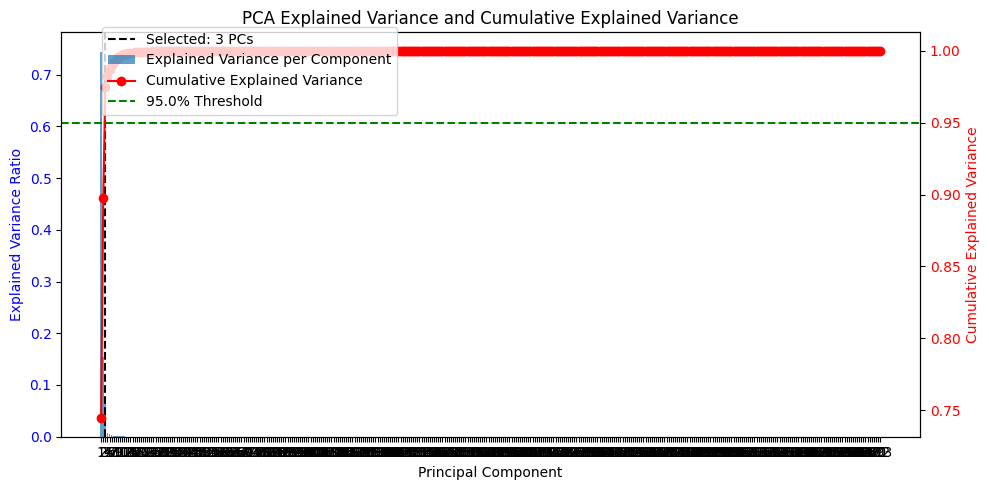


PCA completed with 3 components.
Total explained variance: 97.47%
Selected Principal Components: ['PC1', 'PC2', 'PC3']


In [ ]:
# Apply PCA on pixel-level data (training only), then transform test
train_pca_df, test_pca_df, pca = apply_pca_pixel_level(train_df, test_df, frequency_cols)

# Determine available PCs
available_pcs = [c for c in train_pca_df.columns if c.startswith('PC')]

# Using ALL selected_pcs = available_pcs (Jsut trying it out...)
selected_pcs = available_pcs
print("Selected Principal Components:", selected_pcs)

In [ ]:
# Reconstruct images from PCA DataFrames
X_train_pca_images, y_train_labels, train_image_sample_nums = reshape_to_images_using_img_pos(train_pca_df, selected_pcs=selected_pcs)
X_test_pca_images, y_test_labels, test_image_sample_nums = reshape_to_images_using_img_pos(test_pca_df, selected_pcs=selected_pcs)

Created 2177 images from PCA components ['PC1', 'PC2', 'PC3'].
Created 560 images from PCA components ['PC1', 'PC2', 'PC3'].


#### Filter categories with < 50 images

In [ ]:
# Combine train and test sets before filtering infrequent classes
X_all_pca_images = X_train_pca_images + X_test_pca_images
y_all_labels = np.concatenate([y_train_labels, y_test_labels])
all_image_sample_nums = np.concatenate([train_image_sample_nums, test_image_sample_nums])

In [ ]:
# Remove infrequent classes at the image level
X_all_pca_images, y_all_labels, all_image_sample_nums = remove_infrequent_image_labels(
    X_all_pca_images, y_all_labels, all_image_sample_nums, label_encoder, min_frequency=50
)

Classes retained (≥ 50 images): ['Annual Crops' 'Built-up' 'Consolidated Barren' 'Natural Wooded Land'
 'Permanent Crops' 'Shrubs and Natural Grassland' 'Unconsolidated Barren'
 'Waterbodies' 'Wetlands']
Original image count: 2737
Filtered image count: 2737


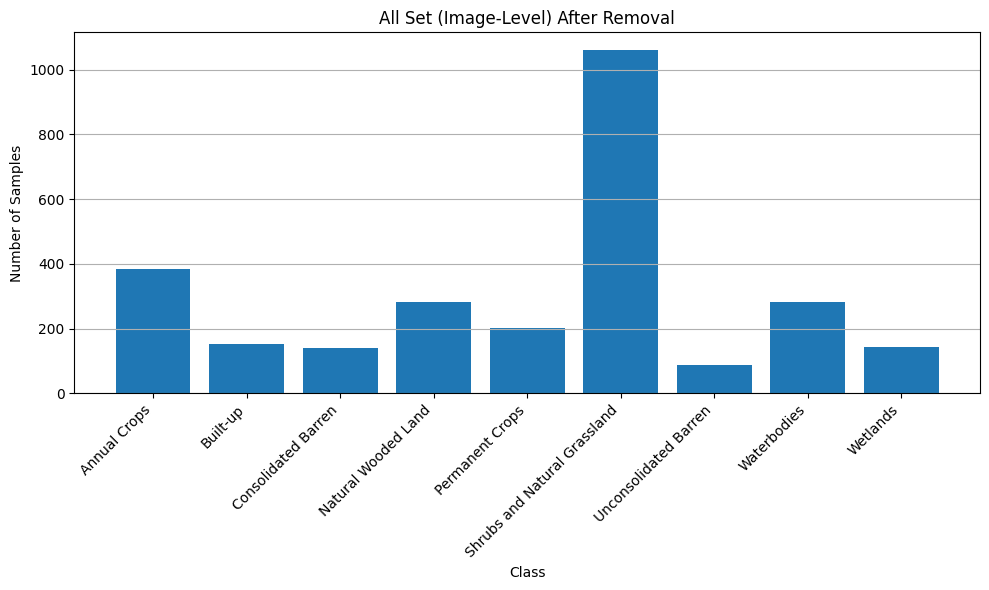

In [ ]:
# Check distribution after removal
plot_class_distribution(y_all_labels, label_encoder.classes_, "All Set (Image-Level) After Removal")

#### Final Split at Image Level and Resize to (10,10)

In [ ]:
# Now split & resize data into train/test sets, ensuring distinct Sample_nums
X_train, X_test, y_train, y_test = split_data_by_samples(
    X_all_pca_images, y_all_labels, all_image_sample_nums,
    train_samples, test_samples
)

Training set: 2177 images
Testing set: 560 images
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (12, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (12, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizin

In [ ]:
# Verify shapes
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
assert X_train.shape[1:] == (10, 10, len(selected_pcs)), f"Invalid X_train shape: {X_train.shape}"
if X_test.shape[0] > 0:
    assert X_test.shape[1:] == (10, 10, len(selected_pcs)), f"Invalid X_test shape: {X_test.shape}"

X_train shape: (2177, 10, 10, 3)
X_test shape: (560, 10, 10, 3)


In [ ]:
# Convert labels to categorical
y_train_cat = to_categorical(y_train, num_classes=num_classes)
y_test_cat = to_categorical(y_test, num_classes=num_classes)

#### Get Class Weights


In [ ]:
class_weights = get_class_weights(y_train)


Class Weights:
Unconsolidated Barren  Weight: 3.505636070853462
Consolidated Barren    Weight: 2.2191641182466872
Wetlands               Weight: 2.085249042145594
Built-up               Weight: 1.9990817263544536
Permanent Crops        Weight: 1.4571619812583667
Waterbodies            Weight: 1.0847035376183358
Natural Wooded Land    Weight: 1.0703048180924286
Annual Crops           Weight: 0.7879116901918205
Shrubs and Natural Grassland Weight: 0.287962962962963


### Micro CNN


---



In [ ]:
# Get the CNN model and Train
micro_model = get_micro_cnn(X_train.shape[1:], num_classes, drop_rate=.2)

In [ ]:
micro_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 10, 10, 128)         │           3,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 10, 10, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 10, 10, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 10, 10, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 10, 10, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 10, 10, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 5, 5, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 5, 5, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 12800)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │       3,277,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 9)                   │             585 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,777,865 (18.23 MB)

 Trainable params: 4,775,433 (18.22 MB)

 Non-trainable params: 2,432 (9.50 KB)

#### Train without weights

In [ ]:
micro_history = train_model(micro_model, X_train, y_train_cat, X_test, y_test_cat,
                            epochs=100, batch_size=32, checkpoint_path=microcnn_checkpoint_path)

Epoch 1/100
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - accuracy: 0.4997 - loss: 1.6788
Epoch 1: val_accuracy improved from -inf to 0.53214, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/microcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 24s 200ms/step - accuracy: 0.5005 - loss: 1.6754 - val_accuracy: 0.5321 - val_loss: 1.5440 - learning_rate: 1.0000e-04
Epoch 2/100
64/69 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6520 - loss: 1.1676
Epoch 2: val_accuracy improved from 0.53214 to 0.61786, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/microcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 22s 25ms/step - accuracy: 0.6520 - loss: 1.1653 - val_accuracy: 0.6179 - val_loss: 1.2257 - learning_rate: 1.0000e-04
Epoch 3/100
64/69 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6842 - loss: 0.9906
Epoch 3: val_accuracy improved from 0.61786 to 0.67679, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/microcnn_best.weights.h

#### Train Using Class Weights

In [ ]:
# micro_history = train_model_with_class_weights(
#     micro_model,
#     X_train,
#     y_train_cat,
#     X_test,
#     y_test_cat,
#     class_weights=class_weights,
#     epochs=100,
#     batch_size=32
# )

In [ ]:
# Get the testing accuracy
micro_test_acc = evaluate_model(micro_model, X_test, y_test_cat)

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7156 - loss: 0.8721
Test Accuracy: 0.7089


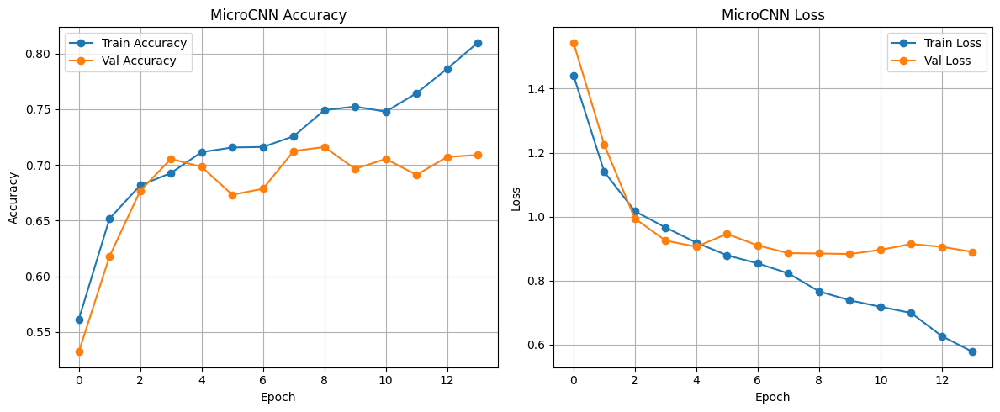

In [ ]:
# Plotting the training curves
plot_training_curves(micro_history, "MicroCNN")

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step


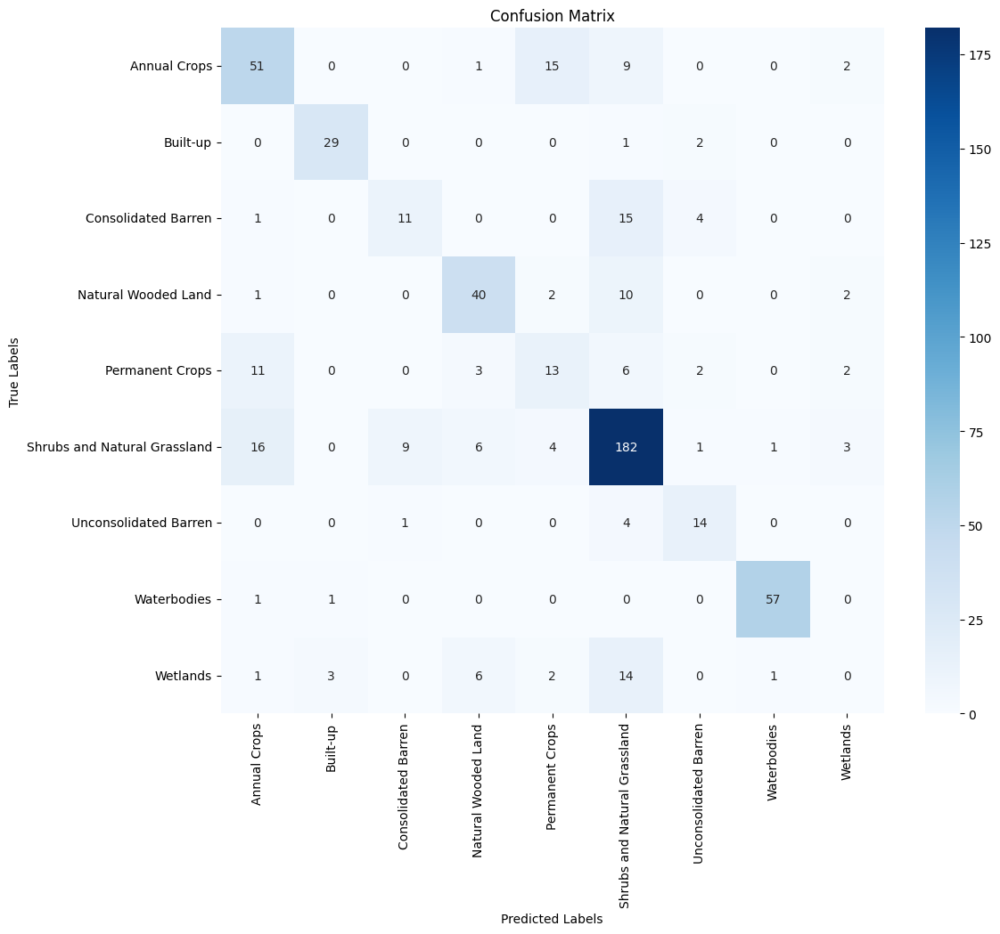

In [ ]:
# Get the predictions and create a CM
y_true_labels, y_pred_labels, _, _ = get_predictions(micro_model, X_test, y_test_cat, label_encoder)
plot_confusion_matrix(y_true_labels, y_pred_labels, label_encoder)

In [ ]:
print("Classification Report (MicroCNN):")
print(classification_report(y_true_labels, y_pred_labels, target_names=label_encoder.classes_))

Classification Report (MicroCNN):
                              precision    recall  f1-score   support

                Annual Crops       0.62      0.65      0.64        78
                    Built-up       0.88      0.91      0.89        32
         Consolidated Barren       0.52      0.35      0.42        31
         Natural Wooded Land       0.71      0.73      0.72        55
             Permanent Crops       0.36      0.35      0.36        37
Shrubs and Natural Grassland       0.76      0.82      0.79       222
       Unconsolidated Barren       0.61      0.74      0.67        19
                 Waterbodies       0.97      0.97      0.97        59
                    Wetlands       0.00      0.00      0.00        27

                    accuracy                           0.71       560
                   macro avg       0.60      0.61      0.61       560
                weighted avg       0.68      0.71      0.69       560



### MacroCNN


---



In [ ]:
# Train MacroCNN
macro_model = get_macro_cnn(X_train.shape[1:], len(label_encoder.classes_))
macro_history = train_model(macro_model, X_train, y_train_cat, X_test, y_test_cat, epochs=50, batch_size=32, checkpoint_path=macrocnn_checkpoint_path)

Epoch 1/50
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - accuracy: 0.3714 - loss: 2.1299
Epoch 1: val_accuracy improved from -inf to 0.37143, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/macrocnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 20s 154ms/step - accuracy: 0.3729 - loss: 2.1244 - val_accuracy: 0.3714 - val_loss: 1.9036 - learning_rate: 1.0000e-04
Epoch 2/50
66/69 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.5993 - loss: 1.3111
Epoch 2: val_accuracy improved from 0.37143 to 0.55893, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/macrocnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.5995 - loss: 1.3104 - val_accuracy: 0.5589 - val_loss: 1.5132 - learning_rate: 1.0000e-04
Epoch 3/50
64/69 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6277 - loss: 1.2149
Epoch 3: val_accuracy improved from 0.55893 to 0.60000, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/macrocnn_best.weights.h5
69/6

In [ ]:
macro_test_acc = evaluate_model(macro_model, X_test, y_test_cat)

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6703 - loss: 0.8401 
Test Accuracy: 0.6875


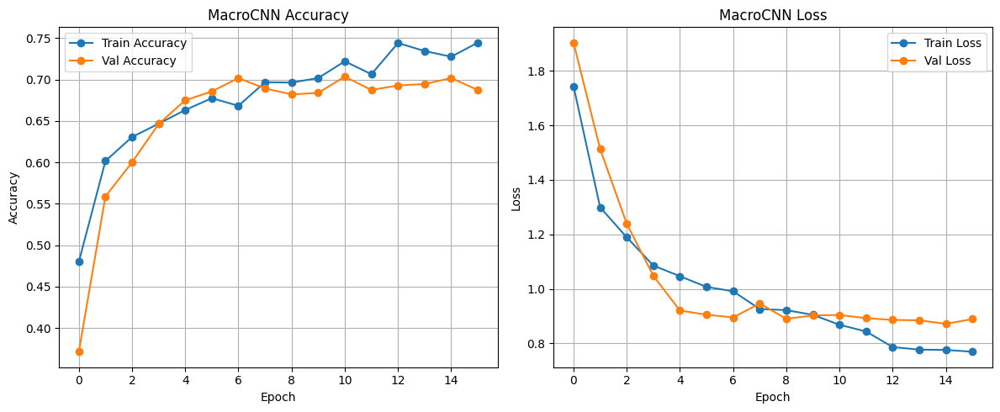

In [ ]:
plot_training_curves(macro_history, "MacroCNN")

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step


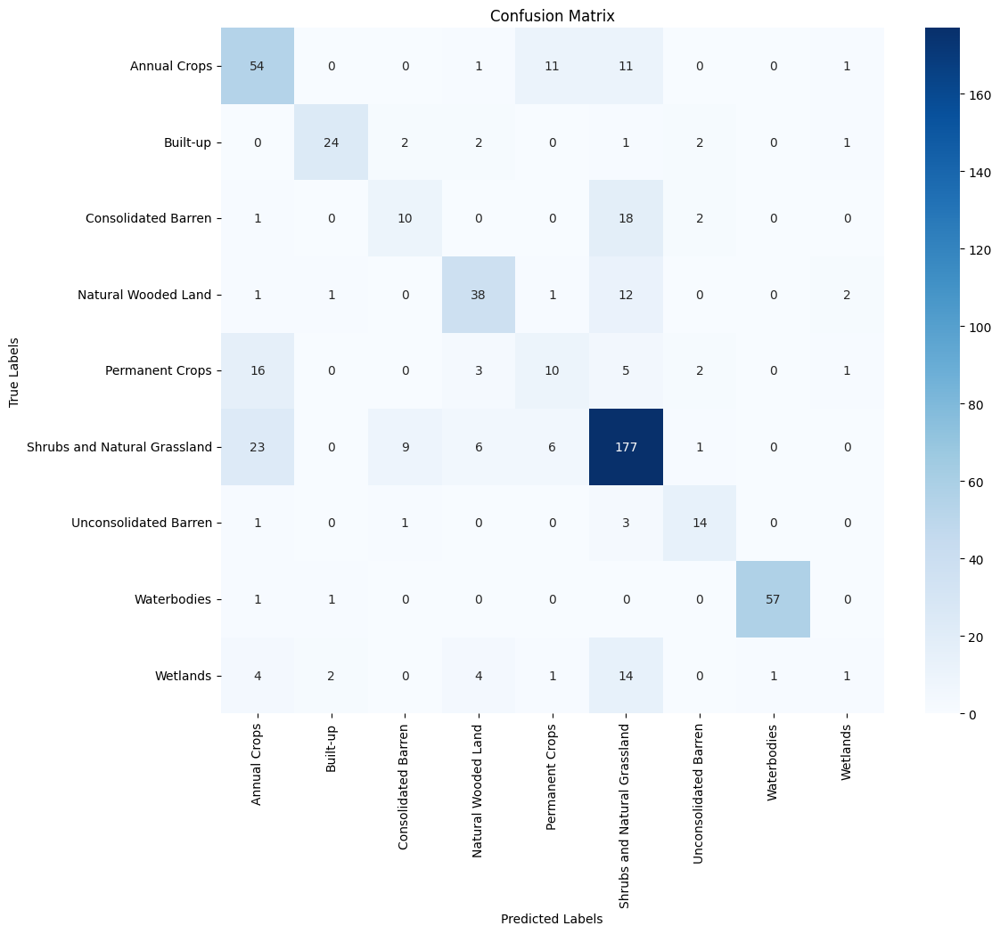

In [ ]:
y_true_labels_macro, y_pred_labels_macro, _, _ = get_predictions(macro_model, X_test, y_test_cat, label_encoder)
plot_confusion_matrix(y_true_labels_macro, y_pred_labels_macro, label_encoder)

In [ ]:
print("Classification Report (MacroCNN):")
print(classification_report(y_true_labels_macro, y_pred_labels_macro, target_names=label_encoder.classes_))

Classification Report (MacroCNN):
                              precision    recall  f1-score   support

                Annual Crops       0.53      0.69      0.60        78
                    Built-up       0.86      0.75      0.80        32
         Consolidated Barren       0.45      0.32      0.38        31
         Natural Wooded Land       0.70      0.69      0.70        55
             Permanent Crops       0.34      0.27      0.30        37
Shrubs and Natural Grassland       0.73      0.80      0.76       222
       Unconsolidated Barren       0.67      0.74      0.70        19
                 Waterbodies       0.98      0.97      0.97        59
                    Wetlands       0.17      0.04      0.06        27

                    accuracy                           0.69       560
                   macro avg       0.61      0.58      0.59       560
                weighted avg       0.67      0.69      0.67       560



### RGB CNN

RGB CNN (No PCA, uses RGB-like bands)
 - Idea is that data is an array of shape (num_images,10,10,3)
 extracted from three specific frequency bands chosen.
---



Created 2737 RGB images using bands ['frq21', 'frq35', 'frq57'].


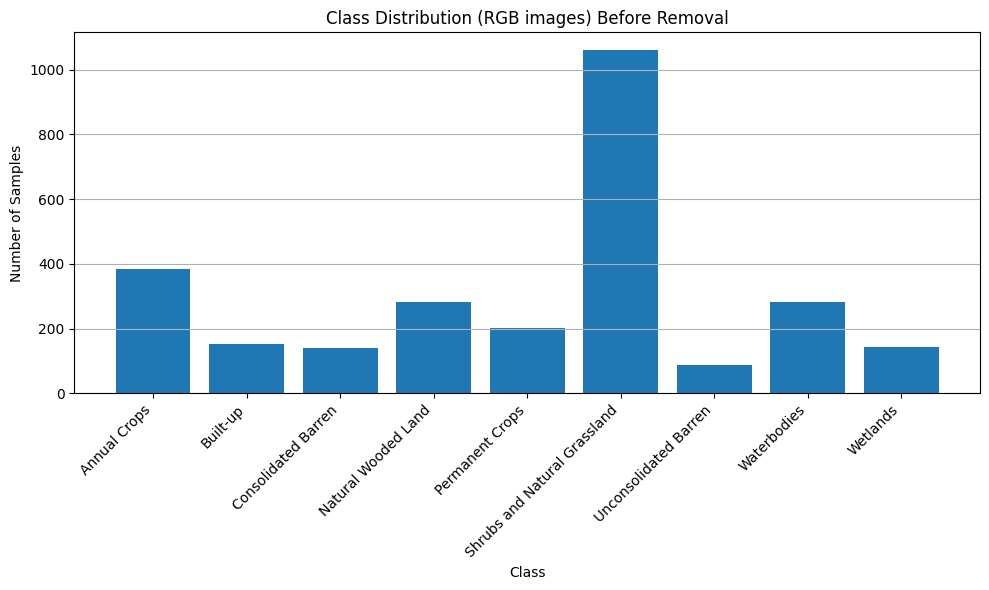

Classes retained (≥ 50 images): ['Annual Crops' 'Built-up' 'Consolidated Barren' 'Natural Wooded Land'
 'Permanent Crops' 'Shrubs and Natural Grassland' 'Unconsolidated Barren'
 'Waterbodies' 'Wetlands']
Original image count: 2737
Filtered image count: 2737
Training set: 2178 images
Testing set: 559 images
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 10) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (12, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (10, 11) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 12) to (10, 10)
Resizing image from (11, 11) to (10, 10)
Resizing image from (11, 11) to (10,

In [ ]:
### RGB CNN (No PCA, uses RGB-like bands)
# Extracted from three specific frequency bands: 'frq21', 'frq35', 'frq57'

# Step 1: Create RGB Images
rgb_bands = ['frq21', 'frq35', 'frq57']
rgb_images, rgb_labels, rgb_sample_nums = create_rgb_images(samples_df, rgb_bands)

# Step 2: Show class distribution at image-level before removal
plot_class_distribution(rgb_labels, label_encoder.classes_, "Class Distribution (RGB images) Before Removal")

# Step 3: Combine Train and Test Samples Before Filtering Infrequent Classes
# Ensure uniform filtering process across train and test sets
rgb_images_combined, rgb_labels_combined, rgb_sample_nums_combined = remove_infrequent_image_labels(
    rgb_images, rgb_labels, rgb_sample_nums, label_encoder, min_frequency=50
)

# Step 4: Stratified Split After Filtering
train_samples_rgb, test_samples_rgb = stratified_image_level_split(
    rgb_sample_nums_combined, rgb_labels_combined, test_size=0.2
)

# Step 5: Split into Train/Test Sets and Resize Images
X_train_rgb, X_test_rgb, y_train_rgb, y_test_rgb = split_data_by_samples(
    rgb_images_combined, rgb_labels_combined, rgb_sample_nums_combined,
    train_samples_rgb, test_samples_rgb
)

X_train_rgb shape: (2178, 10, 10, 3)
X_test_rgb shape: (559, 10, 10, 3)


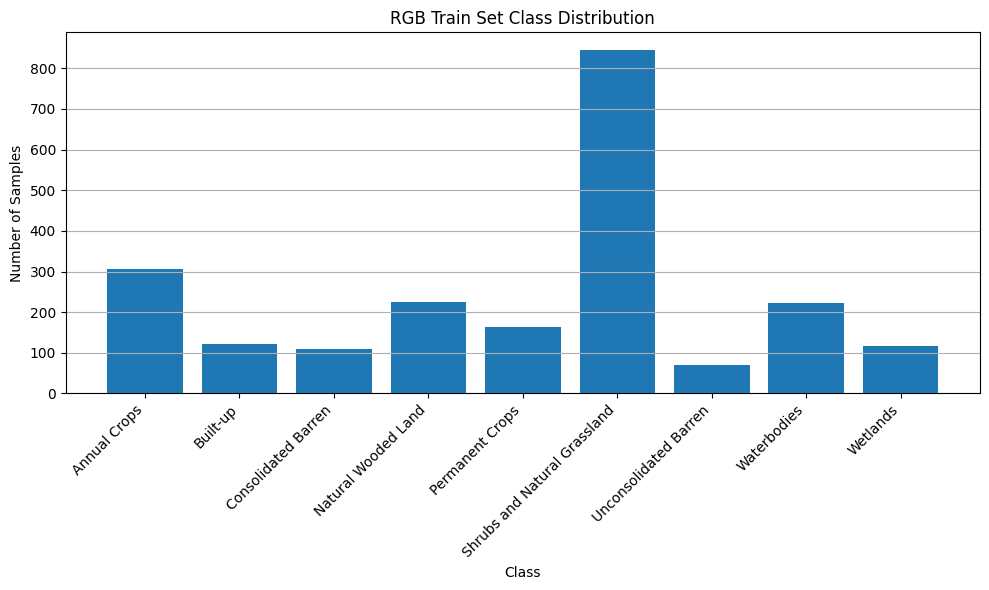

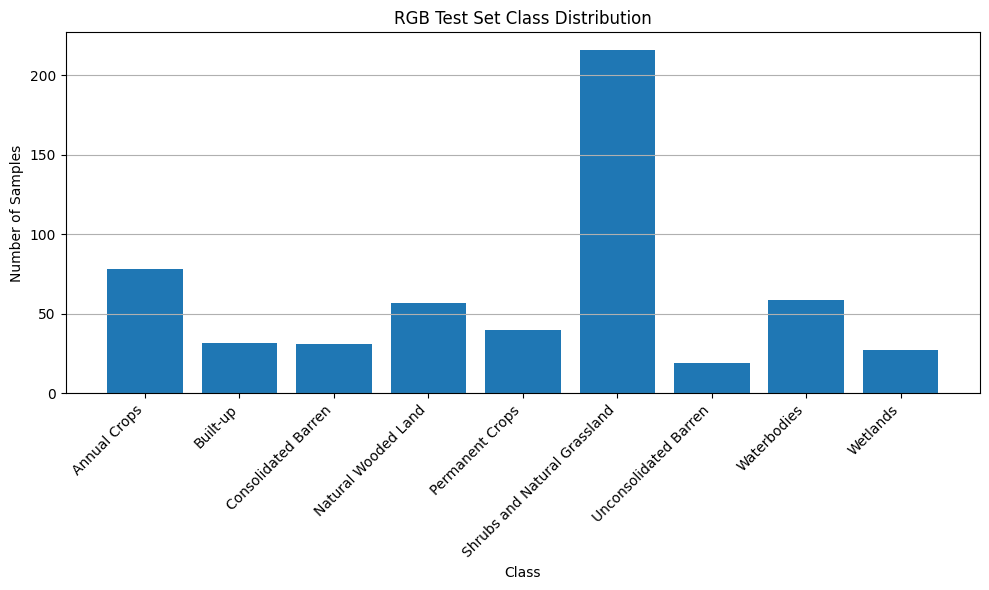

In [ ]:
# Step 6: Verify Shapes and Resize Check
assert X_train_rgb.shape[1:] == (10, 10, 3), f"Invalid X_train shape: {X_train_rgb.shape}"
assert X_test_rgb.shape[1:] == (10, 10, 3), f"Invalid X_test shape: {X_test_rgb.shape}"

print("X_train_rgb shape:", X_train_rgb.shape)
print("X_test_rgb shape:", X_test_rgb.shape)

# Step 7: Show Class Distribution in Train/Test Sets
plot_class_distribution(y_train_rgb, label_encoder.classes_, "RGB Train Set Class Distribution")
plot_class_distribution(y_test_rgb, label_encoder.classes_, "RGB Test Set Class Distribution")

# Step 8: Convert Labels to Categorical
y_train_rgb_cat = to_categorical(y_train_rgb, num_classes=len(label_encoder.classes_))
y_test_rgb_cat = to_categorical(y_test_rgb, num_classes=len(label_encoder.classes_))

In [ ]:
# Step 10: Train and Evaluate the RGB CNN
# Step 9: Get the RGB CNN Model
rgb_model = get_rgb_cnn(X_train_rgb.shape[1:], len(label_encoder.classes_))

rgb_history = train_model(rgb_model, X_train_rgb, y_train_rgb_cat, X_test_rgb, y_test_rgb_cat, epochs=50,
                            batch_size=32, checkpoint_path=rgbcnn_checkpoint_path)

Epoch 1/50
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.3053 - loss: 2.1684
Epoch 1: val_accuracy improved from -inf to 0.38640, saving model to /content/drive/My Drive/BioSCape/2DCheckpoints/Testing/rgbcnn_best.weights.h5
69/69 ━━━━━━━━━━━━━━━━━━━━ 8s 55ms/step - accuracy: 0.3066 - loss: 2.1640 - val_accuracy: 0.3864 - val_loss: 2.0208 - learning_rate: 5.0000e-04
Epoch 2/50
53/69 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4942 - loss: 1.5342
Epoch 2: val_accuracy did not improve from 0.38640
69/69 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.4993 - loss: 1.5197 - val_accuracy: 0.3864 - val_loss: 1.9161 - learning_rate: 5.0000e-04
Epoch 3/50
52/69 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5485 - loss: 1.3527
Epoch 3: val_accuracy did not improve from 0.38640
69/69 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5473 - loss: 1.3626 - val_accuracy: 0.3864 - val_loss: 1.8527 - learning_rate: 5.0000e-04
Epoch 4/50
51/69 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5542

18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6849 - loss: 0.8941 
Test Accuracy: 0.6422
RGB CNN Test Accuracy: 0.6422


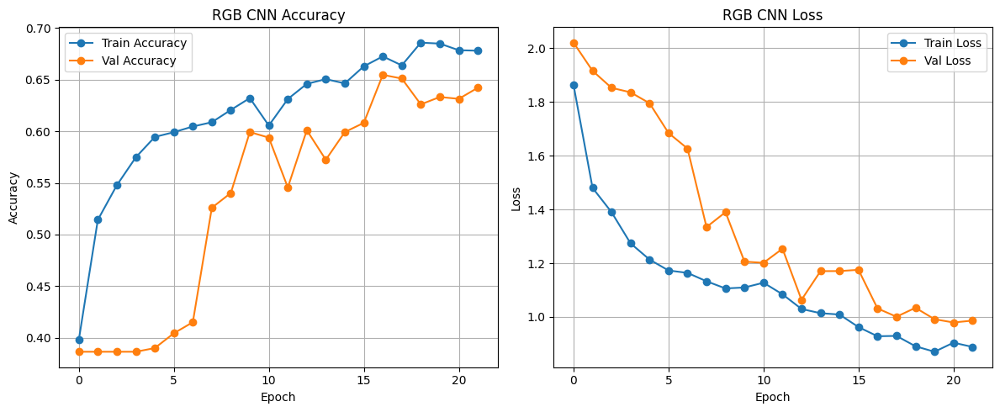

In [ ]:
# Step 11: Evaluate Model Accuracy
rgb_test_accuracy = evaluate_model(rgb_model, X_test_rgb, y_test_rgb_cat)
print(f"RGB CNN Test Accuracy: {rgb_test_accuracy:.4f}")

# Step 12: Plot Training Curves
plot_training_curves(rgb_history, "RGB CNN")

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step


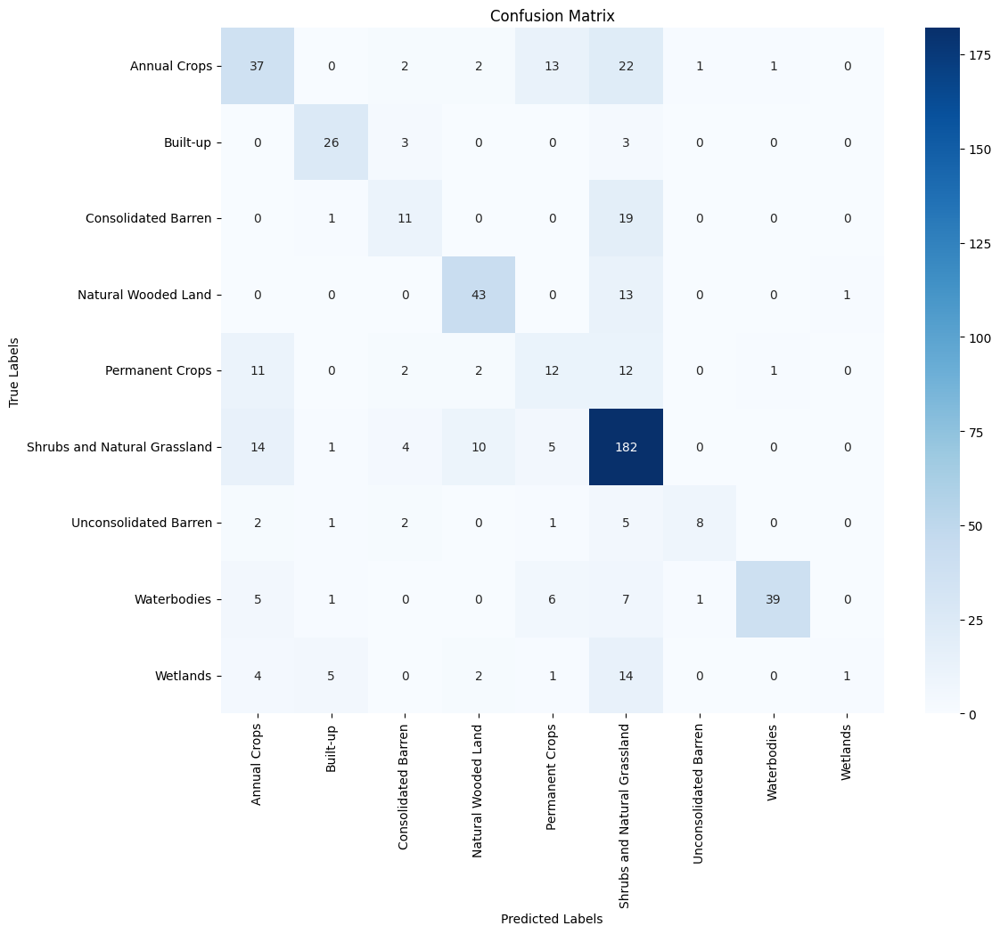

Classification Report (RGB CNN):
                              precision    recall  f1-score   support

                Annual Crops       0.51      0.47      0.49        78
                    Built-up       0.74      0.81      0.78        32
         Consolidated Barren       0.46      0.35      0.40        31
         Natural Wooded Land       0.73      0.75      0.74        57
             Permanent Crops       0.32      0.30      0.31        40
Shrubs and Natural Grassland       0.66      0.84      0.74       216
       Unconsolidated Barren       0.80      0.42      0.55        19
                 Waterbodies       0.95      0.66      0.78        59
                    Wetlands       0.50      0.04      0.07        27

                    accuracy                           0.64       559
                   macro avg       0.63      0.52      0.54       559
                weighted avg       0.64      0.64      0.62       559



In [ ]:
# Step 13: Generate Predictions and Confusion Matrix
y_true_labels_rgb, y_pred_labels_rgb, _, _ = get_predictions(
    rgb_model, X_test_rgb, y_test_rgb_cat, label_encoder
)
plot_confusion_matrix(y_true_labels_rgb, y_pred_labels_rgb, label_encoder)

# Step 14: Print Classification Report
print("Classification Report (RGB CNN):")
print(classification_report(y_true_labels_rgb, y_pred_labels_rgb, target_names=label_encoder.classes_))

<a href="https://colab.research.google.com/github/harrisb002/Hyperspectral-Landcover-Classification/blob/main/CombinedCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>